In [ ]:
!pip3 install backtrader[plotting]
!pip3 install pyfolio

     |████████████████████████████████| 410 kB 4.3 MB/s 
     |████████████████████████████████| 91 kB 4.1 MB/s 
     |████████████████████████████████| 52 kB 1.3 MB/s 
  Created wheel for pyfolio: filename=pyfolio-0.9.2-py3-none-any.whl size=88681 sha256=151cc952ff21d40f4e4253aef4c52b546e561e4205647489cf466d08977da4f5
  Stored in directory: /root/.cache/pip/wheels/e4/96/9b/0dfff5453e702fd780a099b7c850521099c5ec0dfafae189f9
  Created wheel for empyrical: filename=empyrical-0.5.5-py3-none-any.whl size=39777 sha256=7e323c414e63c8c8cb57831f2ba04a39dc10b2322f2790c7c444007bbdc95138
  Stored in directory: /root/.cache/pip/wheels/d9/91/4b/654fcff57477efcf149eaca236da2fce991526cbab431bf312
Successfully built pyfolio empyrical


In [ ]:
import matplotlib.pyplot as plt
from datetime import datetime
import backtrader as bt
import pandas as pd
import numpy as np
import math 
import statistics
from sklearn.metrics import mean_squared_error, mean_absolute_error
import scipy.stats as st
import datetime as dt
import pyfolio as pf
from scipy.optimize import minimize

from sklearn.linear_model import LinearRegression

# Connect to google drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)


/usr/local/lib/python3.7/dist-packages/pyfolio/pos.py:27: UserWarning: Module "zipline.assets" not found; mutltipliers will not be applied to position notionals.
  'Module "zipline.assets" not found; mutltipliers will not be applied' +


Mounted at /content/drive


# Build time series

In [ ]:
def build_timeseries(mat, input_cols, output_col, time_steps, target_time_steps):
    # input_cols is a list of columns that would act as input columns
    # output_col is the column that would act as output column
    # total number of time-series samples = len(mat) - time_steps - target_time_steps + 1
    dim_0 = mat.shape[0] - time_steps - target_time_steps + 1
    dim_1 = len(input_cols)
    
    x = np.zeros((dim_0, time_steps))
    y = np.zeros((dim_0,))
    
    for i in range(dim_0):  
        x[i] = mat[i: time_steps + i]
        y[i] = mat[time_steps + target_time_steps + i - 1]

    return x, y

def convert_price(pred, sc, feature_num, out_col):
# Return predicted price for given input
    pred_reverted = np.zeros(shape=(pred.shape[0], feature_num))
    pred_reverted[:, out_col] = pred
    pred_reverted = sc.inverse_transform(pred_reverted)
    predicted_price = pred_reverted[:, out_col]
    return predicted_price

In [ ]:
TIME_STEPS = 24 # How far in the past you want to use past data as features
TARGET_TIME_STEPS = 12 # How far in the future you want to make predictions
#INP_COLS = [0, 1, 2, 3, 4]
INP_COLS = [1]
OUT_COL = 1

In [ ]:
# Expected growth function

def growth_function(f, p, q, risk_free, mu, sigma):
  return -1 * (p * (math.log(1 + risk_free + f * (mu - risk_free + sigma) )) + q * (math.log(1 + risk_free + f * (mu - risk_free - sigma))) )

def optimal_f(p, q, risk_free, mu, sigma):
  #cons = ({'type': 'eq', 'fun': lambda x: 1 - sum(x)}) 
  bnds = [(0,4)]
  f = 0.5
  res = minimize(growth_function, x0 = f, args = (p, q, risk_free, mu, sigma), method = 'SLSQP', bounds = bnds, tol = 1e-30)
  return res

# Backtrader test using linear regression with discrete probability



In [ ]:
class Discrete_Probability_Strategy(bt.Strategy):
    params = dict(log_period = 1)

    def log(self, txt, dt=None):
        ''' Logging function fot this strategy'''
        dt = dt or self.datas[0].datetime.datetime(0)
        print('%s, %s' % (dt.isoformat(), txt))

    def notify_order(self, order):
        if order.status in [order.Submitted, order.Accepted]:
            # Buy/Sell order submitted/accepted to/by broker - Nothing to do
            return

        # Check if an order has been completed
        # Attention: broker could reject order if not enough cash
        if order.status in [order.Completed]:
            if order.isbuy():
                self.log(
                    'BUY EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                    (order.executed.price,
                     order.executed.value,
                     order.executed.comm))

                self.buyprice = order.executed.price
                self.buycomm = order.executed.comm
            else:  # Sell
                self.log('SELL EXECUTED, Price: %.2f, Cost: %.2f, Comm %.2f' %
                         (order.executed.price,
                          order.executed.value,
                          order.executed.comm))

            self.bar_executed = len(self)

        elif order.status in [order.Canceled, order.Margin, order.Rejected]:
            self.log('Order Canceled/Margin/Rejected')

        # Write down: no pending order
        self.order = None
    def start(self):
        self.order = None 

    def __init__(self):
        self.data_close = self.datas[0].close
        self.log_return_list = []
        self.init_price = 0 
        self.current_f = 0
        self.reg = None
        self.sxx = np.zeros((TIME_STEPS, TIME_STEPS)) # S = S_xx
        self.sigma = 0
        self.x_mean = None
        self.dof = 0
        self.n = 0
        self.current_price = 0
        self.predicted_price = 0
        self.a = 0
        self.b = 0

    def next(self):
        # Simply log the closing price of the series from the reference
        #self.log('')
        if (len(self) == 1):
          self.init_price = self.datas[0].close.get(size = 1)
        
        
        if (len(self) == train_len):
          current_data = pd.Series(list(self.datas[0].close.get(size=train_len)))
          #print(current_data)
          #Build time series model for linear regression
          x_train_lr, y_train_lr = build_timeseries(mat=current_data.values, input_cols=INP_COLS, output_col=OUT_COL, 
                                          time_steps=TIME_STEPS, target_time_steps=TARGET_TIME_STEPS)
          
          # Train Linear Regression models
          self.reg = LinearRegression()
          self.reg.fit(x_train_lr, y_train_lr)

          self.n = len(x_train_lr) # n = number of training samples
          self.dof = self.n - TIME_STEPS - 1 # dof = Degree of Freedom

          # Calculate Sxx
          self.x_mean = x_train_lr.mean(axis=0)
          self.x_mean = self.x_mean.reshape((TIME_STEPS, 1))
          for x in x_train_lr:
              d = x.reshape((TIME_STEPS, 1)) - self.x_mean
              self.sxx += np.matmul(d, d.T)

          # Calculate estimated standard deviation
          pred_train = self.reg.predict(x_train_lr)
          sum = np.sum((y_train_lr - pred_train) ** 2) # sum = residual sum of squares
          self.sigma = np.sqrt(sum / self.dof) # sd = sigma, ie, estimated standard deviation

          #pred = reg.predict(x_test_lr)
          self.b = np.mean((current_data.loc[current_data > current_data.shift(1)] / current_data.shift(1)).dropna() - 1)
          print(self.a)
          self.a = np.mean(1 - (current_data.loc[current_data < current_data.shift(1)] / current_data.shift(1)).dropna())
          print(self.b)

        if (len(self) >= train_len + 60):
          current_data = pd.Series(list(self.datas[0].close.get(size=TIME_STEPS + TARGET_TIME_STEPS)))
          
          x_test_lr, y_test_lr = build_timeseries(mat=current_data.values, input_cols=INP_COLS, output_col=OUT_COL, 
                                          time_steps=TIME_STEPS, target_time_steps=TARGET_TIME_STEPS)
          
          pred = self.reg.predict(x_test_lr)
          self.log('')
          #print('Root Mean Squared Error =', math.sqrt(mean_squared_error(y_test_lr, pred)))
          #print('Mean Absolute Error =', mean_absolute_error(y_test_lr, pred))
          
          # Calculate standard error
          standard_error_lr = np.zeros(len(y_test_lr))
          for idx in range(len(standard_error_lr)):
              d = x_test_lr[idx].reshape((TIME_STEPS, 1)) - self.x_mean
              inversed_S = np.linalg.inv(self.sxx)
              standard_error_lr[idx] = self.sigma * np.sqrt(1 + 1/self.n + d.T @ inversed_S @ d)
          # np.matmul(np.matmul(d.T, inversed_S), d)
          # Calculate certainty level of prediction
          current_price_lr = pd.Series(list(self.datas[0].close.get(size=1)))
          current_date = self.datas[0].datetime.datetime(0)
          # time_data['predicted_price'].loc[current_date.strftime("%Y-%m-%d")] = self.predicted_price
 
          self.predicted_price = pred[0]
          diff_lr = np.abs(pred - current_price_lr)
          t_score = diff_lr / standard_error_lr
          #probs_lr = st.t.cdf(t_score, self.dof) # probs_lr = estimated probability of correct trend prediction
          print('Today\'s price = ', current_price_lr[0])
          print('Predicted price = ', pred[0])
          #print('Probability ', probs_lr[0])

          f_data = pd.Series(list(self.datas[0].close.get(size=15)))
          
          if pred - current_price_lr[0] > 0:
            expected_profit = (pred - current_price_lr[0]) / current_price_lr[0]
            current_f = 0.5 * (1/self.a - 1/expected_profit )
          else:
            expected_loss = (current_price_lr[0] - pred) / current_price_lr[0]
            current_f = 0.5 * (1/expected_loss - 1/self.b)
          if current_f < 0 :
              current_f = 0
          elif current_f > 1 :
              current_f = 1
          print('Current f : ', current_f)

          self.order = self.order_target_percent(target = current_f)

          '''
          current_log = np.log(f_data/ f_data.shift(1))
          current_mu = (np.mean(current_log) * 252)
          print('Current mu = ', current_mu)
          current_sigma = (np.std(current_log) * 252 ** 0.5)
          print('Current sigma = ', current_sigma)
          
        if (len(self) >= 60):
            current_data = pd.Series(list(self.data_close.get(size=60)))
            current_ret = current_data.pct_change().dropna()
            current_log = np.log(current_data/ current_data.iloc[0])

            self.current_mu = (np.mean(current_log) * 252 )
            self.current_sigma = (np.std(current_log) * 252 ** 0.5)
            if self.current_sigma != 0 :
              self.current_f = 1/2 * (self.current_mu/(self.current_sigma ** 2))
            if self.current_f < 0 :
              self.current_f = 0
            elif self.current_f > 1 :
              self.current_f = 1
            print(self.current_f)
            #self.log('Current f %.4f' %self.current_f)
            self.order = self.order_target_percent(target = self.current_f)
            self.log('%04d - Order Target Percent: %.4f' %(len(self), self.current_f))
            #self.log(self.broker.getvalue())
            #self.log('Portfolio value %.2f' %data_value)
        '''


## Cryptocurrency 

### USD - BTC

In [ ]:
btc_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/BTC-USD.csv', index_col=0, parse_dates=True)
btc_data.dropna(inplace=True)
train_len = int(0.7 * len(btc_data))
time_data = btc_data[train_len+59:].copy()
time_data['predicted_price'] = 0
print(train_len)

1276


In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=btc_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.027279451690162007
2020-01-24T00:00:00, 
Today's price =  8445.43457
Predicted price =  8185.369404102017
Current f :  0
2020-01-25T00:00:00, 
Today's price =  8367.847656
Predicted price =  8089.429743294319
Current f :  0
2020-01-26T00:00:00, 
Today's price =  8596.830078
Predicted price =  8982.99673181085
Current f :  1
2020-01-27T00:00:00, BUY EXECUTED, Price: 8596.83, Cost: 997232.29, Comm 0.00
2020-01-27T00:00:00, 
Today's price =  8909.819336
Predicted price =  8773.779598456378
Current f :  1
2020-01-28T00:00:00, 
Today's price =  9358.589844
Predicted price =  8629.205445755266
Current f :  0
2020-01-29T00:00:00, SELL EXECUTED, Price: 9358.59, Cost: 997232.29, Comm 0.00
2020-01-29T00:00:00, 
Today's price =  9316.629883
Predicted price =  8806.071349073138
Current f :  0
2020-01-30T00:00:00, 
Today's price =  9508.993164
Predicted price =  8754.702895114464
Current f :  0
2020-01-31T00:00:00, 
Today's price =  9350.529297
Predicted pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Today's price =  9795.943359
Predicted price =  8399.02553650419
Current f :  0
2020-02-08T00:00:00, 
Today's price =  9865.119141
Predicted price =  8765.025510448655
Current f :  0
2020-02-09T00:00:00, 
Today's price =  10116.673828
Predicted price =  9403.305833863253
Current f :  0
2020-02-10T00:00:00, 
Today's price =  9856.611328
Predicted price =  9256.661342791065
Current f :  0
2020-02-11T00:00:00, 
Today's price =  10208.236328
Predicted price =  9486.926872988373
Current f :  0
2020-02-12T00:00:00, 
Today's price =  10326.054688
Predicted price =  9222.438354004154
Current f :  0
2020-02-13T00:00:00, 
Today's price =  10214.379883
Predicted price =  9190.197492454326
Current f :  0
2020-02-14T00:00:00, 
Today's price =  10312.116211
Predicted price =  9129.499444318884
Current f :  0
2020-02-15T00:00:00, 
Today's price =  9889.424805
Predicted price =  9044.806996749096
Current f :  0
2020-02-16T00:00:00, 
Today's price =  9934.433594
Predicted price =  9093.713291883127
Cur

In [ ]:
time_data[:10]

,Open,High,Low,Close,Adj Close,Volume,predicted_price
Date,,,,,,,
2020-01-24,8405.567383,8514.666992,8266.840820,8445.434570,8445.434570,2.439791e+10,0.000000
2020-01-25,8440.119141,8458.453125,8296.218750,8367.847656,8367.847656,1.964733e+10,8185.369404
2020-01-26,8364.410156,8602.401367,8325.498047,8596.830078,8596.830078,2.217768e+10,8089.429743
2020-01-27,8597.308594,8977.726563,8597.308594,8909.819336,8909.819336,2.864734e+10,8982.996732
2020-01-28,8912.524414,9358.589844,8908.447266,9358.589844,9358.589844,3.439874e+10,8773.779598
2020-01-29,9357.470703,9406.431641,9269.467773,9316.629883,9316.629883,3.068260e+10,8629.205446
2020-01-30,9316.016602,9553.125977,9230.897461,9508.993164,9508.993164,3.237879e+10,8806.071349
2020-01-31,9508.313477,9521.706055,9230.776367,9350.529297,9350.529297,2.943249e+10,8754.702895
2020-02-01,9346.357422,9439.323242,9313.239258,9392.875000,9392.875000,2.592266e+10,8577.825002


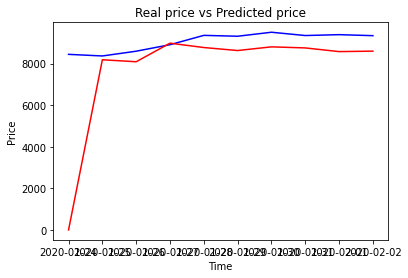

In [ ]:
# mean-var graph
plt.xlabel('Time')
plt.ylabel('Price')
plt.title('Real price vs Predicted price')
plt.plot(time_data['Close'].loc['2020-01-24':'2020-02-2'], color='blue')
plt.plot(time_data['predicted_price'].loc['2020-01-24':'2020-02-2'], color='red')
plt.show()

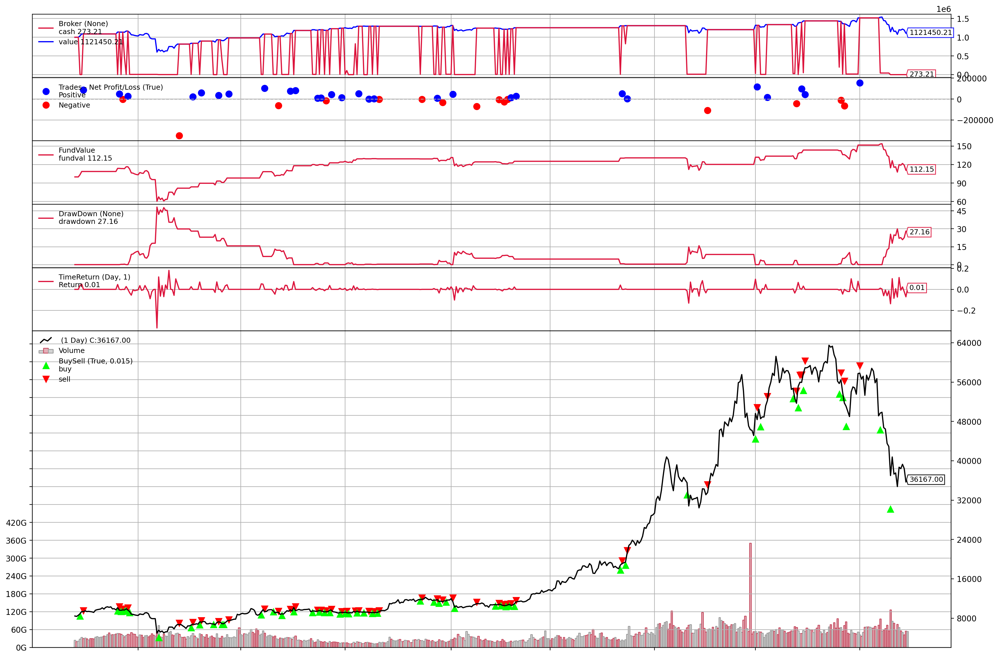

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - ETH

In [ ]:
eth_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/ETH-USD.csv', index_col=0, parse_dates=True)
eth_data.dropna(inplace=True)
train_len = int(0.7 * len(eth_data))
time_data = eth_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=eth_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.04269473495270385
2020-01-24T00:00:00, 
Today's price =  163.051178
Predicted price =  157.2453467655138
Current f :  1
2020-01-25T00:00:00, BUY EXECUTED, Price: 163.05, Cost: 999992.87, Comm 0.00
2020-01-25T00:00:00, 
Today's price =  161.283936
Predicted price =  155.37732849614233
Current f :  1
2020-01-26T00:00:00, 
Today's price =  168.077103
Predicted price =  179.7122470810857
Current f :  1
2020-01-27T00:00:00, 
Today's price =  170.930893
Predicted price =  177.2118554187909
Current f :  1
2020-01-28T00:00:00, 
Today's price =  176.370316
Predicted price =  175.78837070797414
Current f :  1
2020-01-29T00:00:00, 
Today's price =  175.05033899999998
Predicted price =  182.48012541431467
Current f :  1
2020-01-30T00:00:00, 
Today's price =  184.690475
Predicted price =  187.54988261302245
Current f :  0
2020-01-31T00:00:00, SELL EXECUTED, Price: 184.69, Cost: 999992.87, Comm 0.00
2020-01-31T00:00:00, 
Today's price =  180.160172
Predicted 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Today's price =  235.851196
Predicted price =  199.85904205275736
Current f :  0
2020-02-12T00:00:00, 
Today's price =  265.40612799999997
Predicted price =  190.1113381769666
Current f :  0
2020-02-13T00:00:00, 
Today's price =  268.099243
Predicted price =  189.25010925216083
Current f :  0
2020-02-14T00:00:00, 
Today's price =  284.21749900000003
Predicted price =  192.09703960020272
Current f :  0
2020-02-15T00:00:00, 
Today's price =  264.72857700000003
Predicted price =  193.0933200834563
Current f :  0
2020-02-16T00:00:00, 
Today's price =  259.894714
Predicted price =  193.52740570337875
Current f :  0
2020-02-17T00:00:00, 
Today's price =  266.363434
Predicted price =  207.94631381441792
Current f :  0
2020-02-18T00:00:00, 
Today's price =  281.94458
Predicted price =  219.26904279039252
Current f :  0
2020-02-19T00:00:00, 
Today's price =  259.763977
Predicted price =  230.87623098314103
Current f :  0
2020-02-20T00:00:00, 
Today's price =  257.949463
Predicted price =  231.6

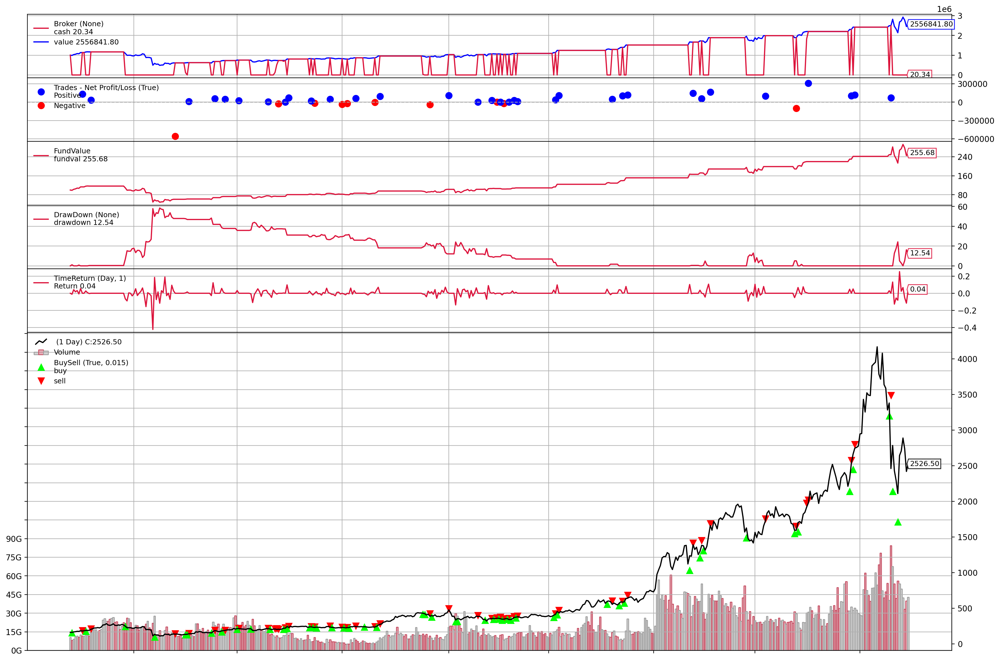

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: divide by zero encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - DOGE

In [ ]:
doge_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/DOGE-USD.csv', index_col=0, parse_dates=True)
doge_data.dropna(inplace=True)
train_len = int(0.7 * len(doge_data))
time_data = doge_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=doge_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.04536834138293266
2020-01-24T00:00:00, 
Today's price =  0.0022760000000000002
Predicted price =  0.0024605940518201857
Current f :  1
2020-01-25T00:00:00, BUY EXECUTED, Price: 0.00, Cost: 1000000.00, Comm 0.00
2020-01-25T00:00:00, 
Today's price =  0.002257
Predicted price =  0.002471288482899863
Current f :  1
2020-01-26T00:00:00, 
Today's price =  0.002305
Predicted price =  0.002678507237336824
Current f :  1
2020-01-27T00:00:00, 
Today's price =  0.002368
Predicted price =  0.002537543529725338
Current f :  1
2020-01-28T00:00:00, 
Today's price =  0.00245
Predicted price =  0.002445046629233876
Current f :  1
2020-01-29T00:00:00, 
Today's price =  0.0023899999999999998
Predicted price =  0.0025485027956787757
Current f :  1
2020-01-30T00:00:00, 
Today's price =  0.00244
Predicted price =  0.0025277029873897305
Current f :  [0.04060372]
2020-01-31T00:00:00, SELL EXECUTED, Price: 0.00, Cost: 959396.28, Comm 0.00
2020-01-31T00:00:00, 
Today's 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Today's price =  0.003232
Predicted price =  0.0025434373781205713
Current f :  0
2020-02-10T00:00:00, 
Today's price =  0.002986
Predicted price =  0.0024436207945890444
Current f :  0
2020-02-11T00:00:00, 
Today's price =  0.003041
Predicted price =  0.0024819774734385147
Current f :  0
2020-02-12T00:00:00, 
Today's price =  0.003093
Predicted price =  0.00236818076013712
Current f :  0
2020-02-13T00:00:00, 
Today's price =  0.003026
Predicted price =  0.0023811865764381355
Current f :  0
2020-02-14T00:00:00, 
Today's price =  0.00313
Predicted price =  0.002501595220478438
Current f :  0
2020-02-15T00:00:00, 
Today's price =  0.00292
Predicted price =  0.0023636342931480114
Current f :  0
2020-02-16T00:00:00, 
Today's price =  0.002774
Predicted price =  0.0025147365745780575
Current f :  0
2020-02-17T00:00:00, 
Today's price =  0.002712
Predicted price =  0.002643115087468595
Current f :  1
2020-02-18T00:00:00, BUY EXECUTED, Price: 0.00, Cost: 1079196.89, Comm 0.00
2020-02-18T00:00

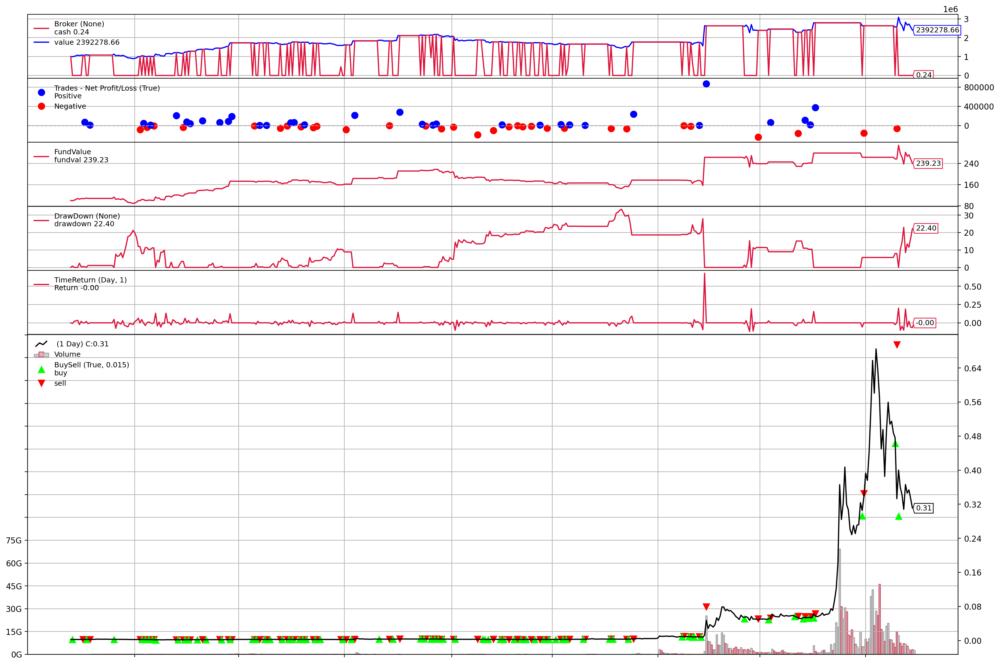

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - XRP

In [ ]:
xrp_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/XRP-USD.csv', index_col=0, parse_dates=True)
xrp_data.dropna(inplace=True)
time_data = xrp_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(xrp_data))
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=xrp_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.052404953354769225
2020-01-24T00:00:00, 
Today's price =  0.223041
Predicted price =  0.2346991513310724
Current f :  1
2020-01-25T00:00:00, BUY EXECUTED, Price: 0.22, Cost: 999999.86, Comm 0.00
2020-01-25T00:00:00, 
Today's price =  0.220427
Predicted price =  0.2292178003408258
Current f :  1
2020-01-26T00:00:00, 
Today's price =  0.230686
Predicted price =  0.25669266809682006
Current f :  1
2020-01-27T00:00:00, 
Today's price =  0.23122199999999998
Predicted price =  0.2590968806384737
Current f :  1
2020-01-28T00:00:00, 
Today's price =  0.238488
Predicted price =  0.26137355407700985
Current f :  1
2020-01-29T00:00:00, 
Today's price =  0.23573000000000002
Predicted price =  0.2693669329152558
Current f :  1
2020-01-30T00:00:00, 
Today's price =  0.243642
Predicted price =  0.27381657011101157
Current f :  1
2020-01-31T00:00:00, 
Today's price =  0.239233
Predicted price =  0.26502985638777454
Current f :  1
2020-02-01T00:00:00, 
Today's p

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Today's price =  0.28221399999999996
Predicted price =  0.23625514848066226
Current f :  0
2020-02-07T00:00:00, 
Today's price =  0.27928400000000003
Predicted price =  0.25347911343475027
Current f :  0
2020-02-08T00:00:00, 
Today's price =  0.27724299999999996
Predicted price =  0.25279112771861023
Current f :  0
2020-02-09T00:00:00, 
Today's price =  0.282457
Predicted price =  0.2626052954283352
Current f :  0
2020-02-10T00:00:00, 
Today's price =  0.27408000000000005
Predicted price =  0.2669383910042663
Current f :  1
2020-02-11T00:00:00, BUY EXECUTED, Price: 0.27, Cost: 1177939.11, Comm 0.00
2020-02-11T00:00:00, 
Today's price =  0.280141
Predicted price =  0.27460292900253147
Current f :  1
2020-02-12T00:00:00, 
Today's price =  0.30439299999999997
Predicted price =  0.26246816719519495
Current f :  0
2020-02-13T00:00:00, SELL EXECUTED, Price: 0.30, Cost: 1177939.11, Comm 0.00
2020-02-13T00:00:00, 
Today's price =  0.326706
Predicted price =  0.2608810970850962
Current f :  0
2

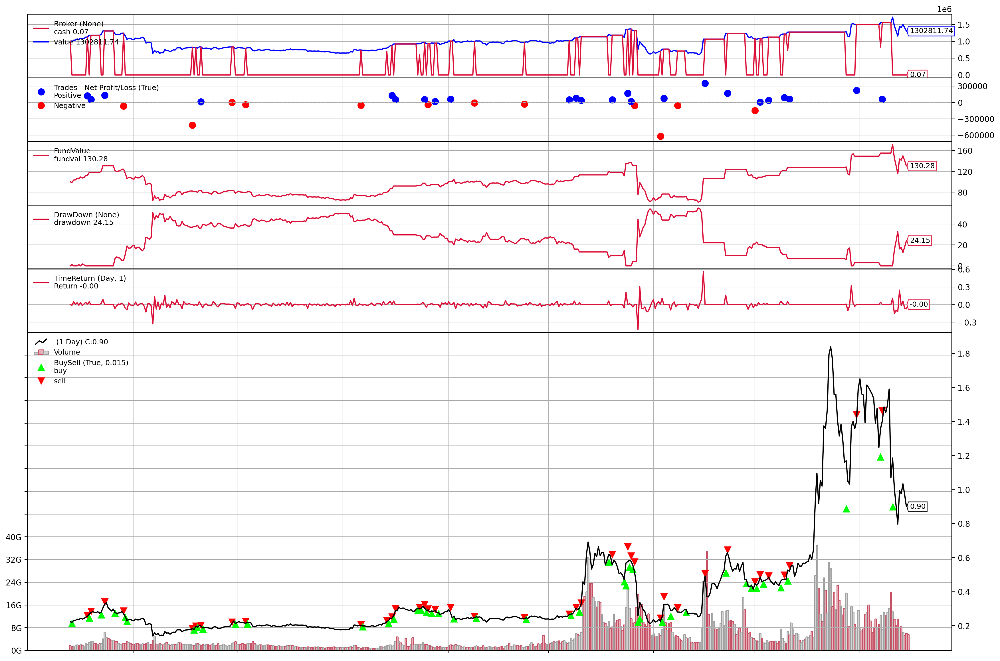

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - LTC

In [ ]:
ltc_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/LTC-USD.csv', index_col=0, parse_dates=True)
ltc_data.dropna(inplace=True)
time_data = ltc_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ltc_data))
train_len

1276

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=ltc_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.0431688702169354
2020-01-24T00:00:00, 
Today's price =  54.531788
Predicted price =  53.59691155616079
Current f :  1
2020-01-25T00:00:00, BUY EXECUTED, Price: 54.53, Cost: 999949.40, Comm 0.00
2020-01-25T00:00:00, 
Today's price =  53.697788
Predicted price =  50.83565947821133
Current f :  0
2020-01-26T00:00:00, SELL EXECUTED, Price: 53.70, Cost: 999949.40, Comm 0.00
2020-01-26T00:00:00, 
Today's price =  56.212715
Predicted price =  61.32970799456226
Current f :  1
2020-01-27T00:00:00, BUY EXECUTED, Price: 56.21, Cost: 984678.13, Comm 0.00
2020-01-27T00:00:00, 
Today's price =  58.763268000000004
Predicted price =  58.24459631391071
Current f :  1
2020-01-28T00:00:00, 
Today's price =  60.671818
Predicted price =  59.58901815216397
Current f :  1
2020-01-29T00:00:00, 
Today's price =  60.077934
Predicted price =  63.66117381423243
Current f :  1
2020-01-30T00:00:00, 
Today's price =  68.159065
Predicted price =  59.875928282357485
Current f :

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


2020-02-07T00:00:00, 
Today's price =  74.356117
Predicted price =  58.3753473419255
Current f :  0
2020-02-08T00:00:00, 
Today's price =  76.467567
Predicted price =  63.45487063175507
Current f :  0
2020-02-09T00:00:00, 
Today's price =  77.09258299999999
Predicted price =  63.89298515492243
Current f :  0
2020-02-10T00:00:00, 
Today's price =  74.335098
Predicted price =  62.49473643748287
Current f :  0
2020-02-11T00:00:00, 
Today's price =  76.597397
Predicted price =  73.23537612589371
Current f :  0
2020-02-12T00:00:00, 
Today's price =  81.29744699999999
Predicted price =  69.2846721924754
Current f :  0
2020-02-13T00:00:00, 
Today's price =  80.40342700000001
Predicted price =  72.22298859606705
Current f :  0
2020-02-14T00:00:00, 
Today's price =  82.990349
Predicted price =  69.00142686699547
Current f :  0
2020-02-15T00:00:00, 
Today's price =  76.513245
Predicted price =  68.03444232970563
Current f :  0
2020-02-16T00:00:00, 
Today's price =  75.152588
Predicted price =  6

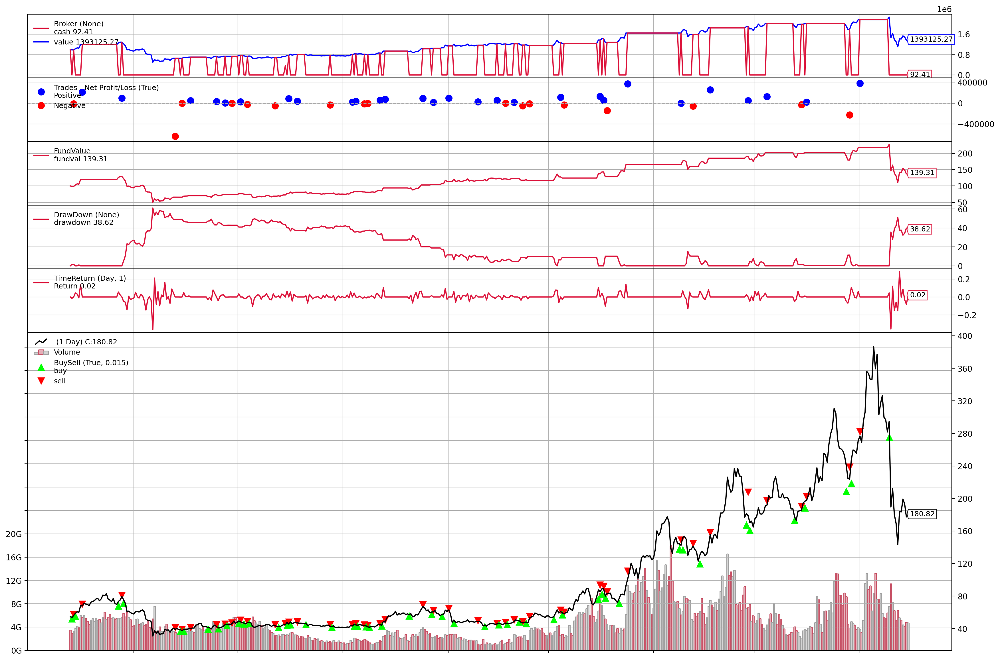

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 1, 24), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-1-24',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - BCH

In [ ]:
bch_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/BCH-USD.csv', index_col=0, parse_dates=True)
bch_data.dropna(inplace=True)
time_data = bch_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(bch_data))
train_len

982

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=bch_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.058610096867221975
2020-05-30T00:00:00, 
Today's price =  251.29952999999998
Predicted price =  286.96970830312
Current f :  1
2020-05-31T00:00:00, BUY EXECUTED, Price: 251.30, Cost: 999920.83, Comm 0.00
2020-05-31T00:00:00, 
Today's price =  239.877029
Predicted price =  282.75226384914316
Current f :  1
2020-06-01T00:00:00, 
Today's price =  255.35218799999998
Predicted price =  279.94163545550236
Current f :  1
2020-06-02T00:00:00, 
Today's price =  249.053223
Predicted price =  269.05171361029977
Current f :  1
2020-06-03T00:00:00, 
Today's price =  252.063614
Predicted price =  278.0644130282725
Current f :  1
2020-06-04T00:00:00, 
Today's price =  256.684814
Predicted price =  272.27474203971406
Current f :  1
2020-06-05T00:00:00, 
Today's price =  256.755402
Predicted price =  260.5897505984414
Current f :  0
2020-06-06T00:00:00, SELL EXECUTED, Price: 256.76, Cost: 999920.83, Comm 0.00
2020-06-06T00:00:00, 
Today's price =  253.2701569999

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Today's price =  543.237854
Predicted price =  538.9120601764432
Current f :  1
2021-04-01T00:00:00, BUY EXECUTED, Price: 543.24, Cost: 1421653.46, Comm 0.00
2021-04-01T00:00:00, 
Today's price =  561.6582639999999
Predicted price =  541.9487567421193
Current f :  1
2021-04-02T00:00:00, 
Today's price =  585.707458
Predicted price =  532.9086783436622
Current f :  0
2021-04-03T00:00:00, SELL EXECUTED, Price: 585.71, Cost: 1421653.46, Comm 0.00
2021-04-03T00:00:00, 
Today's price =  536.678833
Predicted price =  542.5708717544702
Current f :  0
2021-04-04T00:00:00, 
Today's price =  566.513062
Predicted price =  526.8577087374514
Current f :  0
2021-04-05T00:00:00, 
Today's price =  648.560974
Predicted price =  491.72915185767135
Current f :  0
2021-04-06T00:00:00, 
Today's price =  667.748596
Predicted price =  481.3295959279418
Current f :  0
2021-04-07T00:00:00, 
Today's price =  618.597534
Predicted price =  507.6488825882989
Current f :  0
2021-04-08T00:00:00, 
Today's price =  64

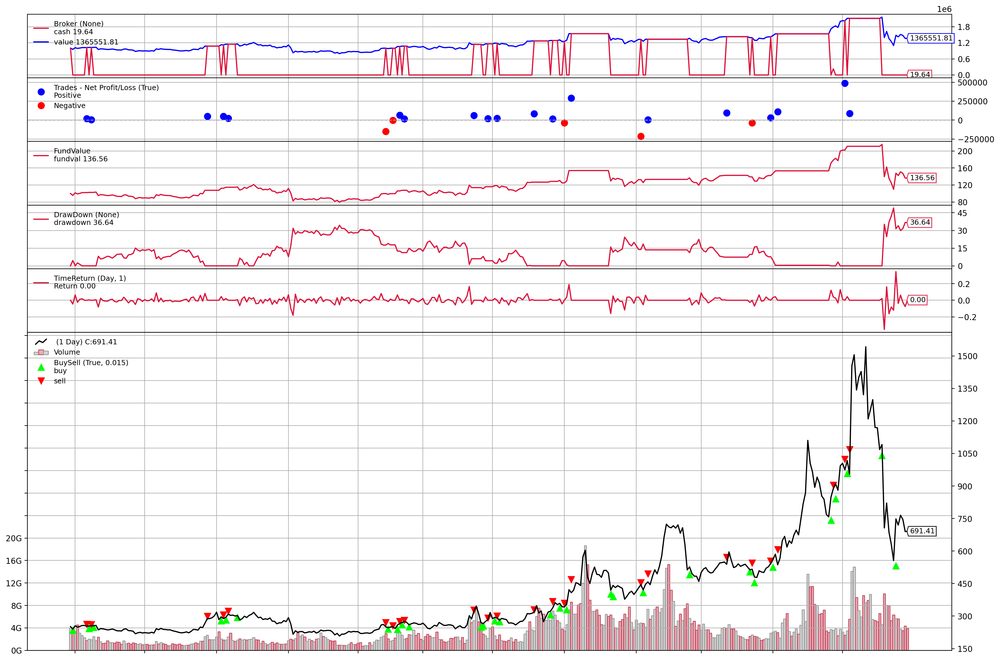

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 5, 30), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-5-30',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - ADA

In [ ]:
ada_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/ADA-USD.csv', index_col=0, parse_dates=True)
ada_data.dropna(inplace=True)
time_data = ada_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ada_data))
train_len

933

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=ada_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.05369355489984414
2020-06-20T00:00:00, 
Today's price =  0.07933899999999999
Predicted price =  0.10409484332349045
Current f :  1
2020-06-21T00:00:00, BUY EXECUTED, Price: 0.08, Cost: 999999.94, Comm 0.00
2020-06-21T00:00:00, 
Today's price =  0.078475
Predicted price =  0.1024812211057552
Current f :  1
2020-06-22T00:00:00, 
Today's price =  0.08361
Predicted price =  0.10366705982524133
Current f :  1
2020-06-23T00:00:00, 
Today's price =  0.08295
Predicted price =  0.09655309421118792
Current f :  1
2020-06-24T00:00:00, 
Today's price =  0.082583
Predicted price =  0.10301326349774673
Current f :  1
2020-06-25T00:00:00, 
Today's price =  0.081691
Predicted price =  0.0955699194756653
Current f :  1
2020-06-26T00:00:00, 
Today's price =  0.08056100000000001
Predicted price =  0.097201678557843
Current f :  1
2020-06-27T00:00:00, 
Today's price =  0.077679
Predicted price =  0.09116250040881574
Current f :  1
2020-06-28T00:00:00, 
Today's pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Today's price =  0.138303
Predicted price =  0.14314369192552534
Current f :  0
2020-08-16T00:00:00, SELL EXECUTED, Price: 0.14, Cost: 1355055.85, Comm 0.00
2020-08-16T00:00:00, 
Today's price =  0.138471
Predicted price =  0.14436047043576863
Current f :  0
2020-08-17T00:00:00, 
Today's price =  0.14092000000000002
Predicted price =  0.14612574118617122
Current f :  0
2020-08-18T00:00:00, 
Today's price =  0.137427
Predicted price =  0.14712011793961047
Current f :  1
2020-08-19T00:00:00, BUY EXECUTED, Price: 0.14, Cost: 1354713.04, Comm 0.00
2020-08-19T00:00:00, 
Today's price =  0.129275
Predicted price =  0.1470600143636697
Current f :  1
2020-08-20T00:00:00, 
Today's price =  0.133642
Predicted price =  0.1476150197084217
Current f :  1
2020-08-21T00:00:00, 
Today's price =  0.12376
Predicted price =  0.1475955475961413
Current f :  1
2020-08-22T00:00:00, 
Today's price =  0.125276
Predicted price =  0.14827150890222732
Current f :  1
2020-08-23T00:00:00, 
Today's price =  0.12159

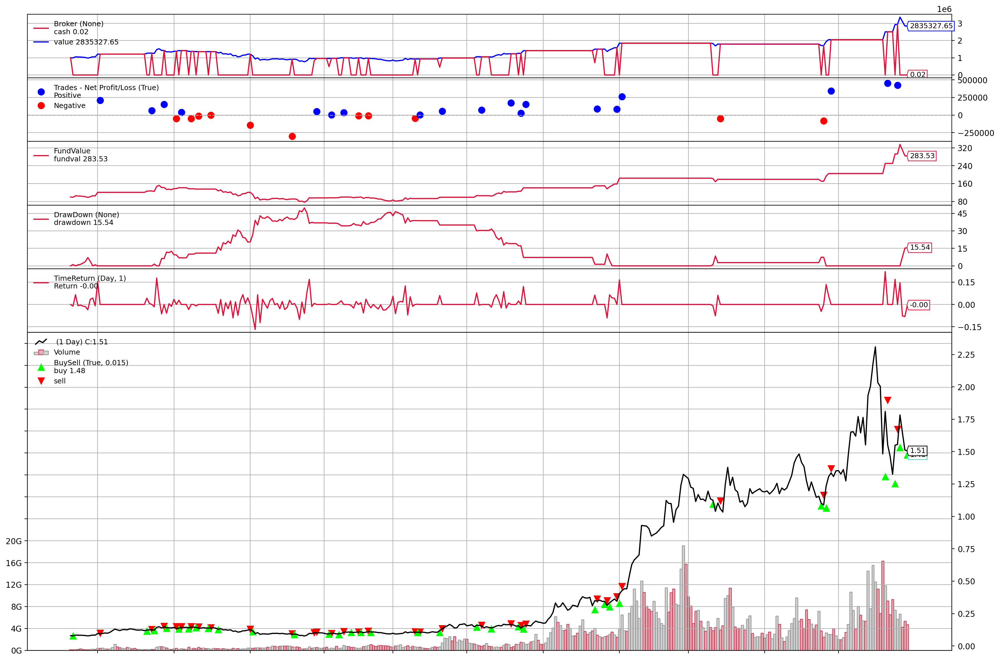

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 6, 20), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-6-20',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: divide by zero encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### USD - BNB

In [ ]:
bnb_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/BNB-USD.csv', index_col=0, parse_dates=True)
bnb_data.dropna(inplace=True)
time_data = bnb_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(bnb_data))
train_len

980

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=bnb_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.056327167563938976
2020-05-30T00:00:00, 
Today's price =  17.743418
Predicted price =  16.64428356470042
Current f :  0
2020-05-31T00:00:00, 
Today's price =  17.040472
Predicted price =  17.07835266679949
Current f :  0
2020-06-01T00:00:00, 
Today's price =  17.914942
Predicted price =  16.683821828000013
Current f :  0
2020-06-02T00:00:00, 
Today's price =  17.239304
Predicted price =  16.034696602433613
Current f :  0
2020-06-03T00:00:00, 
Today's price =  17.545404
Predicted price =  16.528982152527874
Current f :  0
2020-06-04T00:00:00, 
Today's price =  17.565873999999997
Predicted price =  16.589642225251083
Current f :  [0.12006314]
2020-06-05T00:00:00, BUY EXECUTED, Price: 17.57, Cost: 120062.75, Comm 0.00
2020-06-05T00:00:00, 
Today's price =  17.688786
Predicted price =  15.906327996806986
Current f :  0
2020-06-06T00:00:00, SELL EXECUTED, Price: 17.69, Cost: 120062.75, Comm 0.00
2020-06-06T00:00:00, 
Today's price =  17.535934
Predic

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


Today's price =  16.308926
Predicted price =  17.456583182591096
Current f :  1
2020-06-12T00:00:00, 
Today's price =  16.66914
Predicted price =  16.620648511265138
Current f :  1
2020-06-13T00:00:00, 
Today's price =  16.823733999999998
Predicted price =  17.756790286454887
Current f :  1
2020-06-14T00:00:00, 
Today's price =  16.656242000000002
Predicted price =  17.23617059753882
Current f :  0
2020-06-15T00:00:00, SELL EXECUTED, Price: 16.66, Cost: 1000825.51, Comm 0.00
2020-06-15T00:00:00, 
Today's price =  16.384802
Predicted price =  17.569995600945376
Current f :  1
2020-06-16T00:00:00, BUY EXECUTED, Price: 16.38, Cost: 956102.35, Comm 0.00
2020-06-16T00:00:00, 
Today's price =  16.421957
Predicted price =  17.44604783023687
Current f :  1
2020-06-17T00:00:00, 
Today's price =  16.402542
Predicted price =  17.56968914277305
Current f :  1
2020-06-18T00:00:00, 
Today's price =  16.20859
Predicted price =  17.409084523480864
Current f :  1
2020-06-19T00:00:00, 
Today's price =  

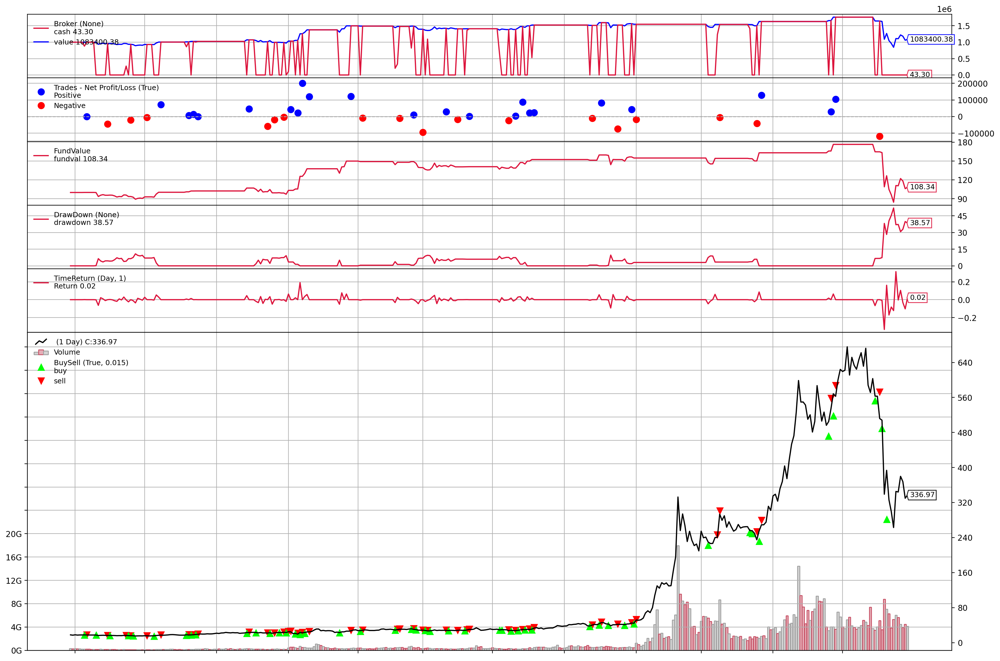

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 5, 30), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-5-30',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


## Stocks (S&P 500 big cap)

### AAPL


In [ ]:
aapl_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/AAPL.csv', index_col=0, parse_dates=True)
aapl_data.dropna(inplace=True)
time_data = aapl_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.9 * len(aapl_data))
train_len

2264

In [ ]:
aapl_data.iloc[train_len:]

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2020-05-11,77.025002,79.262497,76.809998,78.752502,78.225410,145946400
2020-05-12,79.457497,79.922501,77.727501,77.852501,77.331436,162301200
2020-05-13,78.037498,78.987503,75.802498,76.912498,76.397720,200622400
2020-05-14,76.127502,77.447502,75.382500,77.385002,76.867065,158929200
2020-05-15,75.087502,76.974998,75.052498,76.927498,76.412621,166348400
...,...,...,...,...,...,...
2021-05-04,131.190002,131.490005,126.699997,127.849998,127.633202,137564700
2021-05-05,129.199997,130.449997,127.970001,128.100006,127.882790,84000900
2021-05-06,127.889999,129.750000,127.129997,129.740005,129.520004,78128300


In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=aapl_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.012546397070879062
2020-08-04T00:00:00, 
Today's price =  109.665001
Predicted price =  97.74757708258409
Current f :  0
2020-08-05T00:00:00, 
Today's price =  110.0625
Predicted price =  99.34022252562252
Current f :  0
2020-08-06T00:00:00, 
Today's price =  113.902496
Predicted price =  97.71052483849533
Current f :  0
2020-08-07T00:00:00, 
Today's price =  111.112503
Predicted price =  98.1261077788362
Current f :  0
2020-08-10T00:00:00, 
Today's price =  112.727501
Predicted price =  93.04454234170083
Current f :  0
2020-08-11T00:00:00, 
Today's price =  109.375
Predicted price =  93.18723245366425
Current f :  0
2020-08-12T00:00:00, 
Today's price =  113.010002
Predicted price =  95.02714002303662
Current f :  0
2020-08-13T00:00:00, 
Today's price =  115.010002
Predicted price =  92.70575800112871
Current f :  0
2020-08-14T00:00:00, 
Today's price =  114.907501
Predicted price =  94.56192662746261
Current f :  0
2020-08-17T00:00:00, 
Today'

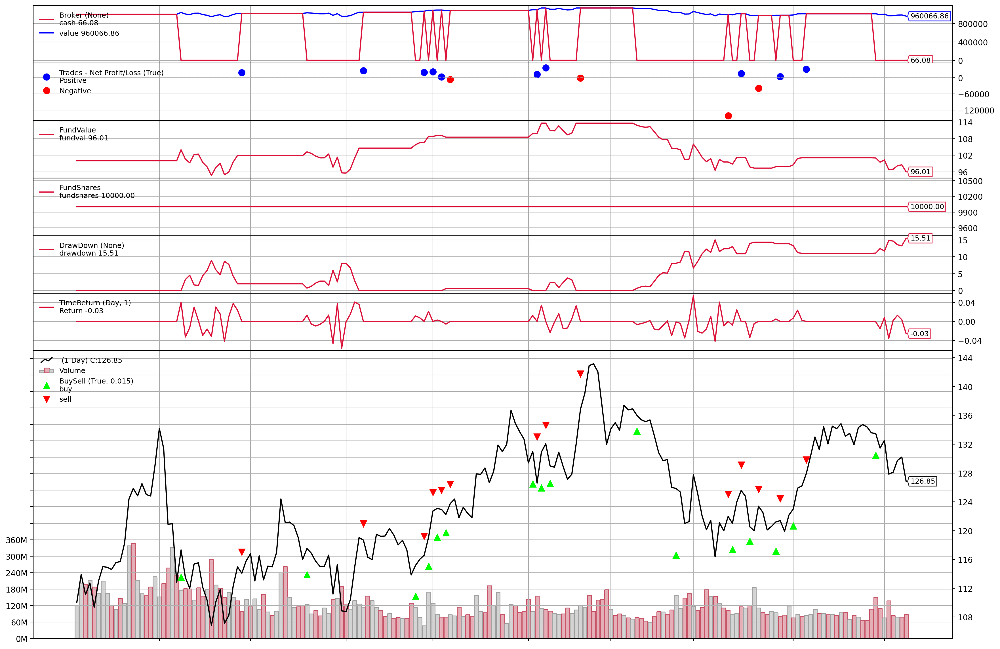

[[<Figure size 3600x2400 with 8 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2020, 8, 5), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-8-5',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### FB

In [ ]:
fb_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/FB.csv', index_col=0, parse_dates=True)
fb_data.dropna(inplace=True)
time_data = fb_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(fb_data))
train_len

1584

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=fb_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.015360506477807512
2018-11-28T00:00:00, 
Today's price =  136.759995
Predicted price =  147.2001284829777
Current f :  1
2018-11-29T00:00:00, BUY EXECUTED, Price: 136.76, Cost: 999989.08, Comm 0.00
2018-11-29T00:00:00, 
Today's price =  138.679993
Predicted price =  145.0165813975315
Current f :  1
2018-11-30T00:00:00, 
Today's price =  140.610001
Predicted price =  144.79213019769057
Current f :  1
2018-12-03T00:00:00, 
Today's price =  141.08999599999999
Predicted price =  146.4744698894831
Current f :  1
2018-12-04T00:00:00, 
Today's price =  137.929993
Predicted price =  146.3809053709032
Current f :  1
2018-12-06T00:00:00, 
Today's price =  139.630005
Predicted price =  143.56687857291044
Current f :  1
2018-12-07T00:00:00, 
Today's price =  137.419998
Predicted price =  136.89185996403262
Current f :  1
2018-12-10T00:00:00, 
Today's price =  141.850006
Predicted price =  137.98141347892522
Current f :  0
2018-12-11T00:00:00, SELL EXECUTED,

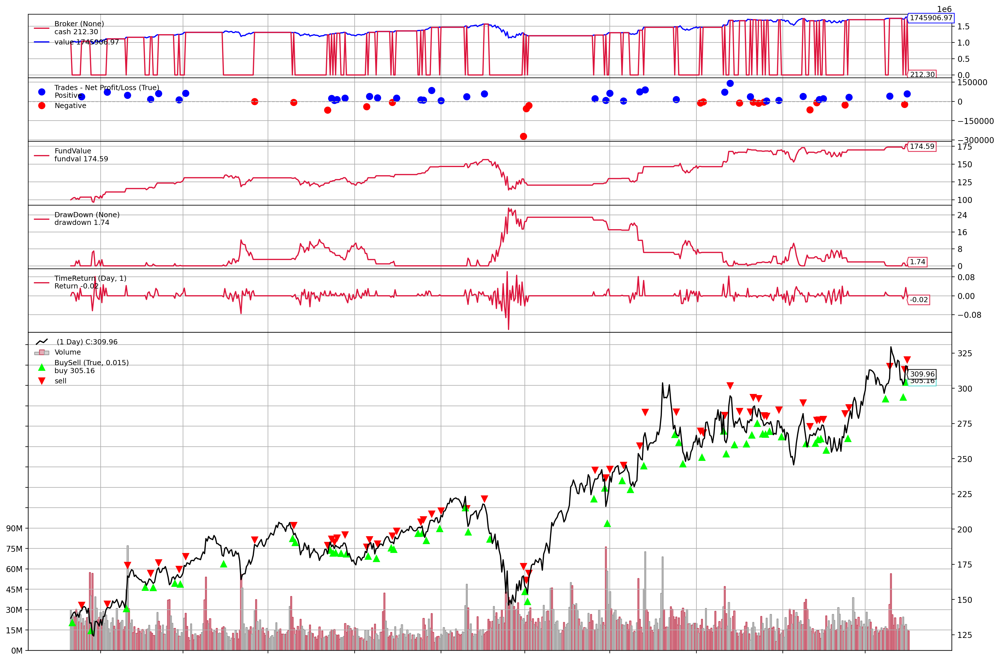

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 11, 28), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-11-28',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: divide by zero encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### TSLA

In [ ]:
tsla_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/TSLA.csv', index_col=0, parse_dates=True)
tsla_data.dropna(inplace=True)
time_data = tsla_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(tsla_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=tsla_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.022505136547682617
2018-08-13T00:00:00, 
Today's price =  71.281998
Predicted price =  62.03802410323616
Current f :  0
2018-08-14T00:00:00, 
Today's price =  69.528
Predicted price =  60.193538936609905
Current f :  0
2018-08-15T00:00:00, 
Today's price =  67.737999
Predicted price =  58.97230124325053
Current f :  0
2018-08-16T00:00:00, 
Today's price =  67.089996
Predicted price =  60.120942947071136
Current f :  0
2018-08-17T00:00:00, 
Today's price =  61.099998
Predicted price =  60.31403711756588
Current f :  1
2018-08-20T00:00:00, BUY EXECUTED, Price: 61.10, Cost: 999962.57, Comm 0.00
2018-08-20T00:00:00, 
Today's price =  61.688
Predicted price =  69.22962263109369
Current f :  1
2018-08-21T00:00:00, 
Today's price =  64.379997
Predicted price =  68.53023952594356
Current f :  1
2018-08-22T00:00:00, 
Today's price =  64.32800300000001
Predicted price =  67.41907176179808
Current f :  1
2018-08-23T00:00:00, 
Today's price =  64.019997
Pre

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  56.147999
Predicted price =  61.83539811483383
Current f :  1
2018-09-06T00:00:00, 
Today's price =  56.189999
Predicted price =  62.61500275322803
Current f :  1
2018-09-07T00:00:00, 
Today's price =  52.647999
Predicted price =  64.30944978807149
Current f :  1
2018-09-10T00:00:00, 
Today's price =  57.099998
Predicted price =  64.34097020050828
Current f :  1
2018-09-11T00:00:00, 
Today's price =  55.888
Predicted price =  63.73941754916708
Current f :  1
2018-09-12T00:00:00, 
Today's price =  58.108002
Predicted price =  63.62360000852392
Current f :  1
2018-09-13T00:00:00, 
Today's price =  57.891998
Predicted price =  62.425676271411895
Current f :  1
2018-09-14T00:00:00, 
Today's price =  59.040001000000004
Predicted price =  60.7827969197359
Current f :  1
2018-09-17T00:00:00, 
Today's price =  58.967999
Predicted price =  59.56609827842638
Current f :  0
2018-09-18T00:00:00, SELL EXECUTED, Price: 58.97, Cost: 999962.57, Comm 0.00
2018-09-18T00:00:00, 
Today's 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2018-10-08T00:00:00, BUY EXECUTED, Price: 52.39, Cost: 1112606.41, Comm 0.00
2018-10-08T00:00:00, 
Today's price =  50.112
Predicted price =  59.832869360442636
Current f :  1
2018-10-09T00:00:00, 
Today's price =  52.560001
Predicted price =  60.41975709097728
Current f :  1
2018-10-10T00:00:00, 
Today's price =  51.375999
Predicted price =  59.99466360135606
Current f :  1
2018-10-11T00:00:00, 
Today's price =  50.445999
Predicted price =  60.80145385862785
Current f :  1
2018-10-12T00:00:00, 
Today's price =  51.756001
Predicted price =  62.153994346091636
Current f :  1
2018-10-15T00:00:00, 
Today's price =  51.917999
Predicted price =  61.895586846515656
Current f :  1
2018-10-16T00:00:00, 
Today's price =  55.318001
Predicted price =  53.70972251031488
Current f :  0
2018-10-17T00:00:00, SELL EXECUTED, Price: 55.32, Cost: 1112606.41, Comm 0.00
2018-10-17T00:00:00, 
Today's price =  54.355999
Predicted price =  62.861222045942135
Current f :  1
2018-10-18T00:00:00, BUY EXECUTED, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  67.746002
Predicted price =  65.2859255597827
Current f :  0
2018-11-14T00:00:00, 
Today's price =  68.800003
Predicted price =  66.22844807167866
Current f :  0
2018-11-15T00:00:00, 
Today's price =  69.688004
Predicted price =  65.78969588987391
Current f :  0
2018-11-16T00:00:00, 
Today's price =  70.862
Predicted price =  67.7168760839894
Current f :  0
2018-11-19T00:00:00, 
Today's price =  70.694
Predicted price =  69.41304379692588
Current f :  1
2018-11-20T00:00:00, BUY EXECUTED, Price: 70.69, Cost: 1271431.59, Comm 0.00
2018-11-20T00:00:00, 
Today's price =  69.498001
Predicted price =  69.64738680165615
Current f :  0
2018-11-21T00:00:00, SELL EXECUTED, Price: 69.50, Cost: 1271431.59, Comm 0.00
2018-11-21T00:00:00, 
Today's price =  67.638
Predicted price =  68.33243282963915
Current f :  0
2018-11-23T00:00:00, 
Today's price =  65.166
Predicted price =  67.61038967943156
Current f :  1
2018-11-26T00:00:00, BUY EXECUTED, Price: 65.17, Cost: 1249949.05, Comm 0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

63.953998999999996
Predicted price =  71.46612815637698
Current f :  1
2018-12-24T00:00:00, 
Today's price =  59.077999
Predicted price =  72.1693929947399
Current f :  1
2018-12-26T00:00:00, 
Today's price =  65.218002
Predicted price =  71.24142961920492
Current f :  1
2018-12-27T00:00:00, 
Today's price =  63.226002
Predicted price =  73.00332027563852
Current f :  1
2018-12-28T00:00:00, 
Today's price =  66.774002
Predicted price =  72.94868314644111
Current f :  1
2018-12-31T00:00:00, 
Today's price =  66.559998
Predicted price =  72.9515680437699
Current f :  1
2019-01-02T00:00:00, 
Today's price =  62.023998
Predicted price =  74.53338821608969
Current f :  1
2019-01-03T00:00:00, 
Today's price =  60.071999
Predicted price =  72.85120068151537
Current f :  1
2019-01-04T00:00:00, 
Today's price =  63.537997999999995
Predicted price =  69.6350041569919
Current f :  1
2019-01-07T00:00:00, 
Today's price =  66.991997
Predicted price =  67.6904087933786
Current f :  0
2019-01-08T00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-02-01T00:00:00, 
Today's price =  62.442001
Predicted price =  69.85758888272659
Current f :  1
2019-02-04T00:00:00, 
Today's price =  62.577999
Predicted price =  70.31569924884286
Current f :  1
2019-02-05T00:00:00, 
Today's price =  64.269997
Predicted price =  70.28939201715866
Current f :  1
2019-02-06T00:00:00, 
Today's price =  63.444
Predicted price =  61.11381623125453
Current f :  0
2019-02-07T00:00:00, SELL EXECUTED, Price: 63.44, Cost: 1266718.96, Comm 0.00
2019-02-07T00:00:00, 
Today's price =  61.501999
Predicted price =  60.30579828772266
Current f :  1
2019-02-08T00:00:00, BUY EXECUTED, Price: 61.50, Cost: 1397202.41, Comm 0.00
2019-02-08T00:00:00, 
Today's price =  61.16
Predicted price =  58.11722006441284
Current f :  0
2019-02-11T00:00:00, SELL EXECUTED, Price: 61.16, Cost: 1397202.41, Comm 0.00
2019-02-11T00:00:00, 
Today's price =  62.568001
Predicted price =  58.863981258082056
Current f :  0
2019-02-12T00:00:00, 
Today's price =  62.362
Predicted price =  5

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  56.827999
Predicted price =  60.55705005098122
Current f :  1
2019-03-11T00:00:00, 
Today's price =  58.183997999999995
Predicted price =  58.26902055211233
Current f :  0
2019-03-12T00:00:00, SELL EXECUTED, Price: 58.18, Cost: 1475670.46, Comm 0.00
2019-03-12T00:00:00, 
Today's price =  56.672001
Predicted price =  58.84304515090282
Current f :  1
2019-03-13T00:00:00, BUY EXECUTED, Price: 56.67, Cost: 1342106.33, Comm 0.00
2019-03-13T00:00:00, 
Today's price =  57.792
Predicted price =  59.63555163768356
Current f :  1
2019-03-14T00:00:00, 
Today's price =  57.992001
Predicted price =  59.2718388267267
Current f :  1
2019-03-15T00:00:00, 
Today's price =  55.085999
Predicted price =  62.31115105713513
Current f :  1
2019-03-18T00:00:00, 
Today's price =  53.897999
Predicted price =  63.228421560067154
Current f :  1
2019-03-19T00:00:00, 
Today's price =  53.493999
Predicted price =  58.631667210316024
Current f :  1
2019-03-20T00:00:00, 
Today's price =  54.720001
Pre

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  55.212002000000005
Predicted price =  52.17362575894625
Current f :  0
2019-04-11T00:00:00, 
Today's price =  53.683997999999995
Predicted price =  53.81869277812085
Current f :  0
2019-04-12T00:00:00, 
Today's price =  53.540001000000004
Predicted price =  55.2811497873507
Current f :  1
2019-04-15T00:00:00, BUY EXECUTED, Price: 53.54, Cost: 1396376.77, Comm 0.00
2019-04-15T00:00:00, 
Today's price =  53.276001
Predicted price =  56.446683798271835
Current f :  1
2019-04-16T00:00:00, 
Today's price =  54.672001
Predicted price =  56.61747009159752
Current f :  1
2019-04-17T00:00:00, 
Today's price =  54.245998
Predicted price =  57.82878680694436
Current f :  1
2019-04-18T00:00:00, 
Today's price =  54.652
Predicted price =  56.92759676984601
Current f :  1
2019-04-22T00:00:00, 
Today's price =  52.549999
Predicted price =  57.87712681568154
Current f :  1
2019-04-23T00:00:00, 
Today's price =  52.779999
Predicted price =  53.31949129690244
Current f :  0
2019-04-24T0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  42.206001
Predicted price =  47.40935320243122
Current f :  1
2019-05-20T00:00:00, 
Today's price =  41.071999
Predicted price =  49.44753271969817
Current f :  1
2019-05-21T00:00:00, 
Today's price =  41.015999
Predicted price =  51.083679383867135
Current f :  1
2019-05-22T00:00:00, 
Today's price =  38.546001000000004
Predicted price =  50.937939302411806
Current f :  1
2019-05-23T00:00:00, 
Today's price =  39.098
Predicted price =  49.31055347210813
Current f :  1
2019-05-24T00:00:00, 
Today's price =  38.125999
Predicted price =  49.026265552788324
Current f :  1
2019-05-28T00:00:00, 
Today's price =  37.740002000000004
Predicted price =  48.723486824079146
Current f :  1
2019-05-29T00:00:00, 
Today's price =  37.972
Predicted price =  48.56795267156898
Current f :  1
2019-05-30T00:00:00, 
Today's price =  37.644001
Predicted price =  45.99938954940109
Current f :  1
2019-05-31T00:00:00, 
Today's price =  37.032001
Predicted price =  47.13055564817877
Current f :

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-06-26T00:00:00, 
Today's price =  43.854
Predicted price =  43.0685365602602
Current f :  1
2019-06-27T00:00:00, BUY EXECUTED, Price: 43.85, Cost: 1132924.24, Comm 0.00
2019-06-27T00:00:00, 
Today's price =  44.568001
Predicted price =  43.75880627358847
Current f :  1
2019-06-28T00:00:00, 
Today's price =  44.692001
Predicted price =  42.34659861361195
Current f :  0
2019-07-01T00:00:00, SELL EXECUTED, Price: 44.69, Cost: 1132924.24, Comm 0.00
2019-07-01T00:00:00, 
Today's price =  45.433997999999995
Predicted price =  43.678923294271364
Current f :  0
2019-07-02T00:00:00, 
Today's price =  44.91
Predicted price =  44.067820679127664
Current f :  1
2019-07-03T00:00:00, BUY EXECUTED, Price: 44.91, Cost: 1154591.19, Comm 0.00
2019-07-03T00:00:00, 
Today's price =  46.98
Predicted price =  46.05852845084616
Current f :  1
2019-07-05T00:00:00, 
Today's price =  46.619999
Predicted price =  45.35397267707658
Current f :  0
2019-07-08T00:00:00, SELL EXECUTED, Price: 46.62, Cost: 115459

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  48.321999
Predicted price =  50.42626214295615
Current f :  1
2019-08-01T00:00:00, BUY EXECUTED, Price: 48.32, Cost: 1237671.36, Comm 0.00
2019-08-01T00:00:00, 
Today's price =  46.77
Predicted price =  50.175601076038944
Current f :  1
2019-08-02T00:00:00, 
Today's price =  46.868
Predicted price =  50.96154541863839
Current f :  1
2019-08-05T00:00:00, 
Today's price =  45.664001
Predicted price =  50.65531944531477
Current f :  1
2019-08-06T00:00:00, 
Today's price =  46.150002
Predicted price =  51.73463514821668
Current f :  1
2019-08-07T00:00:00, 
Today's price =  46.683997999999995
Predicted price =  51.17668911326702
Current f :  1
2019-08-08T00:00:00, 
Today's price =  47.66
Predicted price =  52.23426896016614
Current f :  1
2019-08-09T00:00:00, 
Today's price =  47.001999
Predicted price =  52.89021083174703
Current f :  1
2019-08-12T00:00:00, 
Today's price =  45.801998
Predicted price =  45.92156413827849
Current f :  0
2019-08-13T00:00:00, SELL EXECUTED, P

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 45.122002
Predicted price =  44.077999573707274
Current f :  0
2019-09-03T00:00:00, SELL EXECUTED, Price: 45.12, Cost: 1173135.72, Comm 0.00
2019-09-03T00:00:00, 
Today's price =  45.001999
Predicted price =  43.87952676347331
Current f :  0
2019-09-04T00:00:00, 
Today's price =  44.136002000000005
Predicted price =  44.86958300856547
Current f :  0
2019-09-05T00:00:00, 
Today's price =  45.916
Predicted price =  46.28336802656373
Current f :  0
2019-09-06T00:00:00, 
Today's price =  45.490002000000004
Predicted price =  45.7497952484478
Current f :  0
2019-09-09T00:00:00, 
Today's price =  46.358002
Predicted price =  45.00331025401071
Current f :  0
2019-09-10T00:00:00, 
Today's price =  47.108002
Predicted price =  44.87413431172397
Current f :  0
2019-09-11T00:00:00, 
Today's price =  49.419998
Predicted price =  42.32163384060488
Current f :  0
2019-09-12T00:00:00, 
Today's price =  49.174
Predicted price =  43.391105158244656
Current f :  0
2019-09-13T00:00:00, 
Today's price = 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2019-10-07T00:00:00, 
Today's price =  47.543999
Predicted price =  49.673473977213234
Current f :  1
2019-10-08T00:00:00, 
Today's price =  48.009997999999996
Predicted price =  48.568499727280916
Current f :  0
2019-10-09T00:00:00, SELL EXECUTED, Price: 48.01, Cost: 1279172.76, Comm 0.00
2019-10-09T00:00:00, 
Today's price =  48.905998
Predicted price =  48.40776692327215
Current f :  1
2019-10-10T00:00:00, BUY EXECUTED, Price: 48.91, Cost: 1268181.43, Comm 0.00
2019-10-10T00:00:00, 
Today's price =  48.948002
Predicted price =  44.83325354529741
Current f :  0
2019-10-11T00:00:00, SELL EXECUTED, Price: 48.95, Cost: 1268181.43, Comm 0.00
2019-10-11T00:00:00, 
Today's price =  49.577999
Predicted price =  45.91144124634232
Current f :  0
2019-10-14T00:00:00, 
Today's price =  51.391998
Predicted price =  48.54191410198724
Current f :  0
2019-10-15T00:00:00, 
Today's price =  51.577999
Predicted price =  48.3656144648909
Current f :  0
2019-10-16T00:00:00, 
Today's price =  51.950001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  69.986
Predicted price =  64.89584508237746
Current f :  0
2019-11-13T00:00:00, 
Today's price =  69.222
Predicted price =  64.32222082206296
Current f :  0
2019-11-14T00:00:00, 
Today's price =  69.870003
Predicted price =  62.06526718721603
Current f :  0
2019-11-15T00:00:00, 
Today's price =  70.433998
Predicted price =  62.26214042163029
Current f :  0
2019-11-18T00:00:00, 
Today's price =  69.998001
Predicted price =  62.59054609118709
Current f :  0
2019-11-19T00:00:00, 
Today's price =  71.903999
Predicted price =  62.625217795753784
Current f :  0
2019-11-20T00:00:00, 
Today's price =  70.444
Predicted price =  63.696173425303186
Current f :  0
2019-11-21T00:00:00, 
Today's price =  70.966003
Predicted price =  63.454702924044064
Current f :  0
2019-11-22T00:00:00, 
Today's price =  66.608002
Predicted price =  65.17786701168274
Current f :  1
2019-11-25T00:00:00, BUY EXECUTED, Price: 66.61, Cost: 1269282.09, Comm 0.00
2019-11-25T00:00:00, 
Today's price =  67.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 75.797997
Predicted price =  65.83785496799916
Current f :  0
2019-12-18T00:00:00, 
Today's price =  78.629997
Predicted price =  66.48205319766552
Current f :  0
2019-12-19T00:00:00, 
Today's price =  80.807999
Predicted price =  66.50616298562255
Current f :  0
2019-12-20T00:00:00, 
Today's price =  81.11799599999999
Predicted price =  65.5149864003618
Current f :  0
2019-12-23T00:00:00, 
Today's price =  83.844002
Predicted price =  65.28421778828607
Current f :  0
2019-12-24T00:00:00, 
Today's price =  85.050003
Predicted price =  66.40028244475585
Current f :  0
2019-12-26T00:00:00, 
Today's price =  86.188004
Predicted price =  67.61377046221651
Current f :  0
2019-12-27T00:00:00, 
Today's price =  86.07599599999999
Predicted price =  69.15078292804299
Current f :  0
2019-12-30T00:00:00, 
Today's price =  82.940002
Predicted price =  70.12610902272601
Current f :  0
2019-12-31T00:00:00, 
Today's price =  83.666
Predicted price =  71.2252362658237
Current f :  0
2020-01-02T00:00:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  113.379997
Predicted price =  93.87347555938095
Current f :  0
2020-01-29T00:00:00, 
Today's price =  116.197998
Predicted price =  93.53852291199527
Current f :  0
2020-01-30T00:00:00, 
Today's price =  128.162003
Predicted price =  102.7481878476062
Current f :  0
2020-01-31T00:00:00, 
Today's price =  130.113998
Predicted price =  105.31721429341161
Current f :  0
2020-02-03T00:00:00, 
Today's price =  156.0
Predicted price =  101.57542929176404
Current f :  0
2020-02-04T00:00:00, 
Today's price =  177.412003
Predicted price =  100.76602029924089
Current f :  0
2020-02-05T00:00:00, 
Today's price =  146.940002
Predicted price =  100.26866988657497
Current f :  0
2020-02-06T00:00:00, 
Today's price =  149.792007
Predicted price =  107.85423931419865
Current f :  0
2020-02-07T00:00:00, 
Today's price =  149.613998
Predicted price =  112.12805211137558
Current f :  0
2020-02-10T00:00:00, 
Today's price =  154.255997
Predicted price =  112.46152319307606
Current f :  0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  144.908005
Predicted price =  166.18352236662554
Current f :  1
2020-03-06T00:00:00, 
Today's price =  140.695999
Predicted price =  176.22429701946132
Current f :  1
2020-03-09T00:00:00, 
Today's price =  121.599998
Predicted price =  176.47397772149327
Current f :  1
2020-03-10T00:00:00, 
Today's price =  129.065994
Predicted price =  175.64103546508997
Current f :  1
2020-03-11T00:00:00, 
Today's price =  126.846001
Predicted price =  163.24309817374254
Current f :  1
2020-03-12T00:00:00, 
Today's price =  112.110001
Predicted price =  155.8094444449259
Current f :  1
2020-03-13T00:00:00, 
Today's price =  109.32399699999999
Predicted price =  151.4749054593776
Current f :  1
2020-03-16T00:00:00, 
Today's price =  89.014
Predicted price =  133.5633001345896
Current f :  1
2020-03-17T00:00:00, 
Today's price =  86.040001
Predicted price =  132.25991433407938
Current f :  1
2020-03-18T00:00:00, 
Today's price =  72.244003
Predicted price =  146.53850348029633
Current 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-05-19T00:00:00, 
Today's price =  161.602005
Predicted price =  136.6376656835089
Current f :  0
2020-05-20T00:00:00, 
Today's price =  163.112
Predicted price =  147.7331684229443
Current f :  0
2020-05-21T00:00:00, 
Today's price =  165.520004
Predicted price =  150.06429435618423
Current f :  0
2020-05-22T00:00:00, 
Today's price =  163.37600700000002
Predicted price =  151.70136879529434
Current f :  0
2020-05-26T00:00:00, 
Today's price =  163.774002
Predicted price =  150.87096714583714
Current f :  0
2020-05-27T00:00:00, 
Today's price =  164.046005
Predicted price =  157.27552606042727
Current f :  0
2020-05-28T00:00:00, 
Today's price =  161.162003
Predicted price =  154.9542002676997
Current f :  0
2020-05-29T00:00:00, 
Today's price =  167.0
Predicted price =  157.93633052638705
Current f :  0
2020-06-01T00:00:00, 
Today's price =  179.619995
Predicted price =  155.29048023337126
Current f :  0
2020-06-02T00:00:00, 
Today's price =  176.311996
Predicted price =  159.11

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

197.195999
Predicted price =  185.66678054107882
Current f :  0
2020-06-26T00:00:00, 
Today's price =  191.94799799999998
Predicted price =  201.53786165299425
Current f :  1
2020-06-29T00:00:00, BUY EXECUTED, Price: 191.95, Cost: 952445.97, Comm 0.00
2020-06-29T00:00:00, 
Today's price =  201.869995
Predicted price =  190.52073794617198
Current f :  0
2020-06-30T00:00:00, SELL EXECUTED, Price: 201.87, Cost: 952445.97, Comm 0.00
2020-06-30T00:00:00, 
Today's price =  215.962006
Predicted price =  183.51285474537184
Current f :  0
2020-07-01T00:00:00, 
Today's price =  223.92599500000003
Predicted price =  193.97690139920059
Current f :  0
2020-07-02T00:00:00, 
Today's price =  241.731995
Predicted price =  193.91379430893792
Current f :  0
2020-07-06T00:00:00, 
Today's price =  274.31601
Predicted price =  196.09848704252477
Current f :  0
2020-07-07T00:00:00, 
Today's price =  277.971985
Predicted price =  198.5577267577593
Current f :  0
2020-07-08T00:00:00, 
Today's price =  273.175

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 297.49798599999997
Predicted price =  297.70268690175453
Current f :  0
2020-07-31T00:00:00, SELL EXECUTED, Price: 297.50, Cost: 805868.25, Comm 0.00
2020-07-31T00:00:00, 
Today's price =  286.152008
Predicted price =  303.5845366539996
Current f :  1
2020-08-03T00:00:00, BUY EXECUTED, Price: 286.15, Cost: 1010688.89, Comm 0.00
2020-08-03T00:00:00, 
Today's price =  297.0
Predicted price =  295.29434838735796
Current f :  1
2020-08-04T00:00:00, 
Today's price =  297.399994
Predicted price =  295.96999929939096
Current f :  1
2020-08-05T00:00:00, 
Today's price =  297.003998
Predicted price =  322.4861948967876
Current f :  1
2020-08-06T00:00:00, 
Today's price =  297.91598500000003
Predicted price =  308.11981231810535
Current f :  1
2020-08-07T00:00:00, 
Today's price =  290.541992
Predicted price =  312.6304855600587
Current f :  1
2020-08-10T00:00:00, 
Today's price =  283.713989
Predicted price =  296.0654043245298
Current f :  1
2020-08-11T00:00:00, 
Today's price =  274.877991
P

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  407.0
Predicted price =  367.70678008386676
Current f :  0
2020-09-04T00:00:00, 
Today's price =  418.320007
Predicted price =  366.3248463711946
Current f :  0
2020-09-08T00:00:00, 
Today's price =  330.209991
Predicted price =  391.7507872090014
Current f :  1
2020-09-09T00:00:00, BUY EXECUTED, Price: 330.21, Cost: 970817.37, Comm 0.00
2020-09-09T00:00:00, 
Today's price =  366.27999900000003
Predicted price =  400.69586091426186
Current f :  1
2020-09-10T00:00:00, 
Today's price =  371.339996
Predicted price =  395.15386667500667
Current f :  1
2020-09-11T00:00:00, 
Today's price =  372.72000099999997
Predicted price =  400.193962661313
Current f :  1
2020-09-14T00:00:00, 
Today's price =  419.619995
Predicted price =  422.4895469317644
Current f :  0
2020-09-15T00:00:00, SELL EXECUTED, Price: 419.62, Cost: 970817.37, Comm 0.00
2020-09-15T00:00:00, 
Today's price =  449.76000999999997
Predicted price =  439.3259364565766
Current f :  0
2020-09-16T00:00:00, 
Today's 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  446.64999400000005
Predicted price =  405.59905180744494
Current f :  0
2020-10-14T00:00:00, 
Today's price =  461.299988
Predicted price =  416.5065016808662
Current f :  0
2020-10-15T00:00:00, 
Today's price =  448.880005
Predicted price =  417.7991945233492
Current f :  0
2020-10-16T00:00:00, 
Today's price =  439.670013
Predicted price =  432.0099739063131
Current f :  1
2020-10-19T00:00:00, BUY EXECUTED, Price: 439.67, Cost: 1341433.21, Comm 0.00
2020-10-19T00:00:00, 
Today's price =  430.829987
Predicted price =  447.9501612529984
Current f :  1
2020-10-20T00:00:00, 
Today's price =  421.94000199999994
Predicted price =  410.33404299180984
Current f :  0
2020-10-21T00:00:00, SELL EXECUTED, Price: 421.94, Cost: 1341433.21, Comm 0.00
2020-10-21T00:00:00, 
Today's price =  422.64001500000006
Predicted price =  421.2579002819668
Current f :  1
2020-10-22T00:00:00, BUY EXECUTED, Price: 422.64, Cost: 1287361.49, Comm 0.00
2020-10-22T00:00:00, 
Today's price =  425.790

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  441.60998499999994
Predicted price =  384.4314597633934
Current f :  0
2020-11-18T00:00:00, SELL EXECUTED, Price: 441.61, Cost: 1247939.21, Comm 0.00
2020-11-18T00:00:00, 
Today's price =  486.64001500000006
Predicted price =  395.66652164930593
Current f :  0
2020-11-19T00:00:00, 
Today's price =  499.26998899999995
Predicted price =  416.3895993822767
Current f :  0
2020-11-20T00:00:00, 
Today's price =  489.60998499999994
Predicted price =  410.9474975189902
Current f :  0
2020-11-23T00:00:00, 
Today's price =  521.849976
Predicted price =  426.26067707037953
Current f :  0
2020-11-24T00:00:00, 
Today's price =  555.380005
Predicted price =  418.2728966372004
Current f :  0
2020-11-25T00:00:00, 
Today's price =  574.0
Predicted price =  412.53502423939955
Current f :  0
2020-11-27T00:00:00, 
Today's price =  585.76001
Predicted price =  403.6416751272367
Current f :  0
2020-11-30T00:00:00, 
Today's price =  567.599976
Predicted price =  416.1769841928913
Current f :

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-12-24T00:00:00, BUY EXECUTED, Price: 645.98, Cost: 1350744.14, Comm 0.00
2020-12-24T00:00:00, 
Today's price =  661.77002
Predicted price =  635.7552821117442
Current f :  0
2020-12-28T00:00:00, SELL EXECUTED, Price: 661.77, Cost: 1350744.14, Comm 0.00
2020-12-28T00:00:00, 
Today's price =  663.6900019999999
Predicted price =  588.2112629683575
Current f :  0
2020-12-29T00:00:00, 
Today's price =  665.98999
Predicted price =  608.9442251751775
Current f :  0
2020-12-30T00:00:00, 
Today's price =  694.780029
Predicted price =  592.2398029953354
Current f :  0
2020-12-31T00:00:00, 
Today's price =  705.669983
Predicted price =  625.0087708406594
Current f :  0
2021-01-04T00:00:00, 
Today's price =  729.77002
Predicted price =  612.1137989898098
Current f :  0
2021-01-05T00:00:00, 
Today's price =  735.1099849999999
Predicted price =  603.1696093527918
Current f :  0
2021-01-06T00:00:00, 
Today's price =  755.97998
Predicted price =  632.344361760467
Current f :  0
2021-01-07T00:00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

0
2021-01-29T00:00:00, SELL EXECUTED, Price: 835.43, Cost: 1383520.12, Comm 0.00
2021-01-29T00:00:00, 
Today's price =  793.530029
Predicted price =  825.1715585647827
Current f :  1
2021-02-01T00:00:00, BUY EXECUTED, Price: 793.53, Cost: 1337098.10, Comm 0.00
2021-02-01T00:00:00, 
Today's price =  839.8099980000001
Predicted price =  832.2416643895257
Current f :  1
2021-02-02T00:00:00, 
Today's price =  872.7899779999999
Predicted price =  829.1996653056915
Current f :  0
2021-02-03T00:00:00, SELL EXECUTED, Price: 872.79, Cost: 1337098.10, Comm 0.00
2021-02-03T00:00:00, 
Today's price =  854.6900019999999
Predicted price =  811.56823518487
Current f :  0
2021-02-04T00:00:00, 
Today's price =  849.98999
Predicted price =  830.1427725348565
Current f :  0
2021-02-05T00:00:00, 
Today's price =  852.2299800000001
Predicted price =  840.8000094321014
Current f :  1
2021-02-08T00:00:00, BUY EXECUTED, Price: 852.23, Cost: 1470948.95, Comm 0.00
2021-02-08T00:00:00, 
Today's price =  863.4199

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  621.4400019999999
Predicted price =  783.4337094553895
Current f :  1
2021-03-05T00:00:00, 
Today's price =  597.950012
Predicted price =  781.6771493034141
Current f :  1
2021-03-08T00:00:00, 
Today's price =  563.0
Predicted price =  774.366837335501
Current f :  1
2021-03-09T00:00:00, 
Today's price =  673.580017
Predicted price =  769.4961393793565
Current f :  1
2021-03-10T00:00:00, 
Today's price =  668.0599980000001
Predicted price =  705.9884118383759
Current f :  1
2021-03-11T00:00:00, 
Today's price =  699.599976
Predicted price =  694.6025235525545
Current f :  1
2021-03-12T00:00:00, 
Today's price =  693.72998
Predicted price =  738.4779448101621
Current f :  1
2021-03-15T00:00:00, 
Today's price =  707.9400019999999
Predicted price =  682.3404139838627
Current f :  0
2021-03-16T00:00:00, SELL EXECUTED, Price: 707.94, Cost: 1474762.75, Comm 0.00
2021-03-16T00:00:00, 
Today's price =  676.880005
Predicted price =  672.1321442642907
Current f :  1
2021-03-17

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2021-04-08T00:00:00, 
Today's price =  683.799988
Predicted price =  675.8787204339488
Current f :  1
2021-04-09T00:00:00, 
Today's price =  677.02002
Predicted price =  650.3484747206885
Current f :  0
2021-04-12T00:00:00, SELL EXECUTED, Price: 677.02, Cost: 1457346.78, Comm 0.00
2021-04-12T00:00:00, 
Today's price =  701.97998
Predicted price =  628.5960084315496
Current f :  0
2021-04-13T00:00:00, 
Today's price =  762.320007
Predicted price =  636.6100381118287
Current f :  0
2021-04-14T00:00:00, 
Today's price =  732.22998
Predicted price =  615.6722044102374
Current f :  0
2021-04-15T00:00:00, 
Today's price =  738.849976
Predicted price =  610.7039902974492
Current f :  0
2021-04-16T00:00:00, 
Today's price =  739.780029
Predicted price =  638.3972498705576
Current f :  0
2021-04-19T00:00:00, 
Today's price =  714.630005
Predicted price =  657.6864187690362
Current f :  0
2021-04-20T00:00:00, 
Today's price =  718.98999
Predicted price =  649.2086278896803
Current f :  0
2021-0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  672.369995
Predicted price =  740.6179448148479
Current f :  1
2021-05-10T00:00:00, 
Today's price =  629.039978
Predicted price =  710.8445809057266
Current f :  1
2021-05-11T00:00:00, 
Today's price =  617.200012
Predicted price =  717.777642136799
Current f :  1
2021-05-12T00:00:00, 
Today's price =  589.8900150000001
Predicted price =  722.0424774544489
Current f :  1
2021-05-13T00:00:00, 
Today's price =  571.6900019999999
Predicted price =  681.978594066891
Current f :  1
2021-05-14T00:00:00, 
Today's price =  589.73999
Predicted price =  677.8747986043575
Current f :  1
2021-05-17T00:00:00, 
Today's price =  576.830017
Predicted price =  664.7683843756508
Current f :  1
2021-05-18T00:00:00, 
Today's price =  577.869995
Predicted price =  698.7134874368068
Current f :  1
Final Portfolio Value: 1300532.99


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


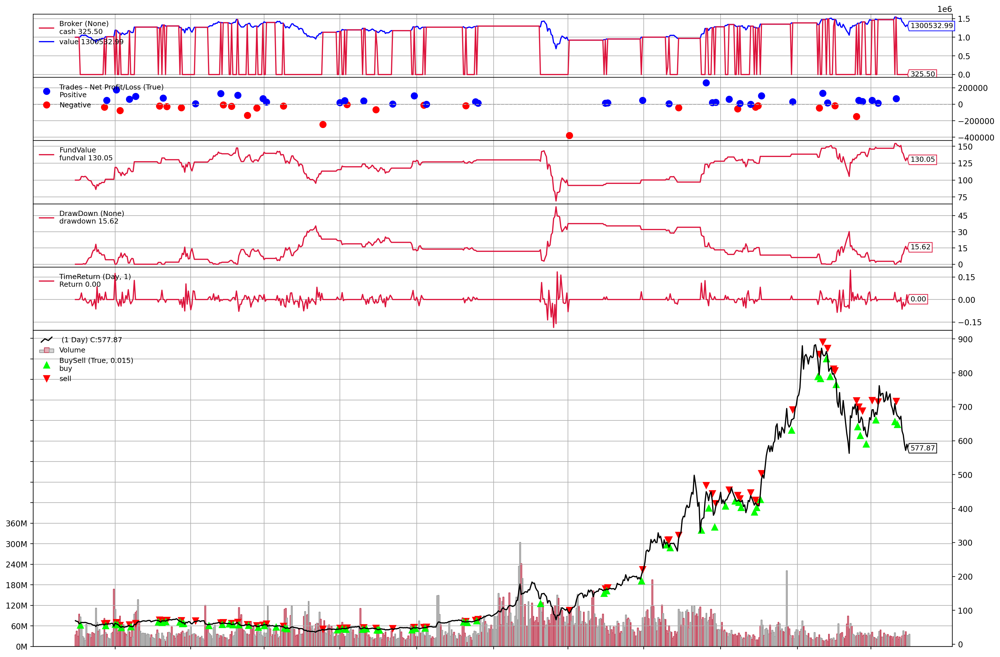

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### GOOGL

In [ ]:
googl_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/GOOGL.csv', index_col=0, parse_dates=True)
googl_data.dropna(inplace=True)
time_data = googl_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(googl_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=googl_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.010507554101529615
2018-08-13T00:00:00, 
Today's price =  1248.640015
Predicted price =  1267.5492829443822
Current f :  1
2018-08-14T00:00:00, BUY EXECUTED, Price: 1248.64, Cost: 998912.01, Comm 0.00
2018-08-14T00:00:00, 
Today's price =  1258.140015
Predicted price =  1238.5510191319934
Current f :  0
2018-08-15T00:00:00, SELL EXECUTED, Price: 1258.14, Cost: 998912.01, Comm 0.00
2018-08-15T00:00:00, 
Today's price =  1232.219971
Predicted price =  1221.5717811955458
Current f :  1
2018-08-16T00:00:00, BUY EXECUTED, Price: 1232.22, Cost: 1006723.72, Comm 0.00
2018-08-16T00:00:00, 
Today's price =  1224.060059
Predicted price =  1225.441141386526
Current f :  0
2018-08-17T00:00:00, SELL EXECUTED, Price: 1224.06, Cost: 1006723.72, Comm 0.00
2018-08-17T00:00:00, 
Today's price =  1215.849976
Predicted price =  1235.547532998011
Current f :  1
2018-08-20T00:00:00, BUY EXECUTED, Price: 1215.85, Cost: 1000644.53, Comm 0.00
2018-08-20T00:00:00, 
Today

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2018-09-10T00:00:00, 
Today's price =  1175.060059
Predicted price =  1228.0119317896038
Current f :  1
2018-09-11T00:00:00, 
Today's price =  1189.98999
Predicted price =  1226.4512966998316
Current f :  1
2018-09-12T00:00:00, 
Today's price =  1171.599976
Predicted price =  1245.324164583629
Current f :  1
2018-09-13T00:00:00, 
Today's price =  1182.140015
Predicted price =  1259.840885308997
Current f :  1
2018-09-14T00:00:00, 
Today's price =  1177.97998
Predicted price =  1251.798318955187
Current f :  1
2018-09-17T00:00:00, 
Today's price =  1159.829956
Predicted price =  1262.6758438881238
Current f :  1
2018-09-18T00:00:00, 
Today's price =  1167.109985
Predicted price =  1251.307143602818
Current f :  1
2018-09-19T00:00:00, 
Today's price =  1174.27002
Predicted price =  1239.0885290653425
Current f :  1
2018-09-20T00:00:00, 
Today's price =  1191.569946
Predicted price =  1226.2924997817336
Current f :  1
2018-09-21T00:00:00, 
Today's price =  1172.119995
Predicted price =  1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1133.079956
Predicted price =  1213.735083823481
Current f :  1
2018-10-17T00:00:00, 
Today's price =  1127.589966
Predicted price =  1215.778982064271
Current f :  1
2018-10-18T00:00:00, 
Today's price =  1097.910034
Predicted price =  1220.223487622393
Current f :  1
2018-10-19T00:00:00, 
Today's price =  1105.180054
Predicted price =  1223.8921664749582
Current f :  1
2018-10-22T00:00:00, 
Today's price =  1111.369995
Predicted price =  1194.5942567431591
Current f :  1
2018-10-23T00:00:00, 
Today's price =  1114.910034
Predicted price =  1187.3692436562537
Current f :  1
2018-10-24T00:00:00, 
Today's price =  1057.119995
Predicted price =  1175.3347954612982
Current f :  1
2018-10-25T00:00:00, 
Today's price =  1103.589966
Predicted price =  1169.0166553673062
Current f :  1
2018-10-26T00:00:00, 
Today's price =  1083.75
Predicted price =  1129.1628021865836
Current f :  1
2018-10-29T00:00:00, 
Today's price =  1034.72998
Predicted price =  1122.107531441097
Curren

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2018-11-19T00:00:00, BUY EXECUTED, Price: 1068.27, Cost: 949692.05, Comm 0.00
2018-11-19T00:00:00, 
Today's price =  1027.420044
Predicted price =  1108.1254671445588
Current f :  1
2018-11-20T00:00:00, 
Today's price =  1030.449951
Predicted price =  1094.6826820742626
Current f :  1
2018-11-21T00:00:00, 
Today's price =  1043.430054
Predicted price =  1076.8039049410665
Current f :  1
2018-11-23T00:00:00, 
Today's price =  1030.099976
Predicted price =  1087.6545228211967
Current f :  1
2018-11-26T00:00:00, 
Today's price =  1055.939941
Predicted price =  1123.0221829016164
Current f :  1
2018-11-27T00:00:00, 
Today's price =  1052.280029
Predicted price =  1101.4373454217975
Current f :  1
2018-11-28T00:00:00, 
Today's price =  1091.790039
Predicted price =  1089.2007867028094
Current f :  1
2018-11-29T00:00:00, 
Today's price =  1094.579956
Predicted price =  1061.7939395029628
Current f :  0
2018-11-30T00:00:00, SELL EXECUTED, Price: 1094.58, Cost: 949692.05, Comm 0.00
2018-11-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2018-12-24T00:00:00, 
Today's price =  984.669983
Predicted price =  1082.7714020839119
Current f :  1
2018-12-26T00:00:00, 
Today's price =  1047.849976
Predicted price =  1063.8661386010585
Current f :  1
2018-12-27T00:00:00, 
Today's price =  1052.900024
Predicted price =  1074.1720048965901
Current f :  1
2018-12-28T00:00:00, 
Today's price =  1046.680054
Predicted price =  1081.9580140817195
Current f :  1
2018-12-31T00:00:00, 
Today's price =  1044.959961
Predicted price =  1090.888655244784
Current f :  1
2019-01-02T00:00:00, 
Today's price =  1054.680054
Predicted price =  1085.598665733807
Current f :  1
2019-01-03T00:00:00, 
Today's price =  1025.469971
Predicted price =  1063.1473367880023
Current f :  1
2019-01-04T00:00:00, 
Today's price =  1078.069946
Predicted price =  1035.2346366743293
Current f :  0
2019-01-07T00:00:00, SELL EXECUTED, Price: 1078.07, Cost: 975393.17, Comm 0.00
2019-01-07T00:00:00, 
Today's price =  1075.920044
Predicted price =  1052.1088841643698
Cur

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  1097.98999
Predicted price =  1072.2620728452996
Current f :  0
2019-01-31T00:00:00, SELL EXECUTED, Price: 1097.99, Cost: 1020837.30, Comm 0.00
2019-01-31T00:00:00, 
Today's price =  1125.890015
Predicted price =  1060.2625089919197
Current f :  0
2019-02-01T00:00:00, 
Today's price =  1118.619995
Predicted price =  1089.5321740499926
Current f :  0
2019-02-04T00:00:00, 
Today's price =  1141.420044
Predicted price =  1094.212041652097
Current f :  0
2019-02-05T00:00:00, 
Today's price =  1151.869995
Predicted price =  1102.8445038131729
Current f :  0
2019-02-06T00:00:00, 
Today's price =  1122.890015
Predicted price =  1106.8223940500168
Current f :  0
2019-02-07T00:00:00, 
Today's price =  1105.910034
Predicted price =  1078.9617225335342
Current f :  0
2019-02-08T00:00:00, 
Today's price =  1102.380005
Predicted price =  1089.0673093935225
Current f :  0
2019-02-11T00:00:00, 
Today's price =  1102.119995
Predicted price =  1081.9502225744538
Current f :  0
2019-02

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1164.939941
Predicted price =  1116.2583851353984
Current f :  0
2019-03-07T00:00:00, 
Today's price =  1150.849976
Predicted price =  1125.8748997420068
Current f :  0
2019-03-08T00:00:00, 
Today's price =  1149.969971
Predicted price =  1122.1032561186444
Current f :  0
2019-03-11T00:00:00, 
Today's price =  1179.26001
Predicted price =  1110.2480405142649
Current f :  0
2019-03-12T00:00:00, 
Today's price =  1197.25
Predicted price =  1122.4482521870282
Current f :  0
2019-03-13T00:00:00, 
Today's price =  1199.060059
Predicted price =  1123.0808992279497
Current f :  0
2019-03-14T00:00:00, 
Today's price =  1192.530029
Predicted price =  1131.694388647914
Current f :  0
2019-03-15T00:00:00, 
Today's price =  1190.300049
Predicted price =  1128.4172681826103
Current f :  0
2019-03-18T00:00:00, 
Today's price =  1188.550049
Predicted price =  1127.208876030747
Current f :  0
2019-03-19T00:00:00, 
Today's price =  1202.459961
Predicted price =  1141.5249162776192
Curr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-04-10T00:00:00, 
Today's price =  1206.449951
Predicted price =  1198.7958718328518
Current f :  1
2019-04-11T00:00:00, BUY EXECUTED, Price: 1206.45, Cost: 1083392.06, Comm 0.00
2019-04-11T00:00:00, 
Today's price =  1209.589966
Predicted price =  1191.006743437708
Current f :  0
2019-04-12T00:00:00, SELL EXECUTED, Price: 1209.59, Cost: 1083392.06, Comm 0.00
2019-04-12T00:00:00, 
Today's price =  1222.72998
Predicted price =  1186.097359743386
Current f :  0
2019-04-15T00:00:00, 
Today's price =  1226.530029
Predicted price =  1180.0322243033922
Current f :  0
2019-04-16T00:00:00, 
Today's price =  1231.910034
Predicted price =  1182.5088742268847
Current f :  0
2019-04-17T00:00:00, 
Today's price =  1240.140015
Predicted price =  1201.087233735958
Current f :  0
2019-04-18T00:00:00, 
Today's price =  1241.469971
Predicted price =  1205.8650117671875
Current f :  0
2019-04-22T00:00:00, 
Today's price =  1253.76001
Predicted price =  1209.1602683242152
Current f :  0
2019-04-23T00:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

1136.589966
Predicted price =  1265.7858858130112
Current f :  1
2019-05-14T00:00:00, 
Today's price =  1124.859985
Predicted price =  1272.578171699591
Current f :  1
2019-05-15T00:00:00, 
Today's price =  1170.800049
Predicted price =  1286.7413323837843
Current f :  1
2019-05-16T00:00:00, 
Today's price =  1184.5
Predicted price =  1211.2593863250472
Current f :  1
2019-05-17T00:00:00, 
Today's price =  1168.780029
Predicted price =  1193.7648360742553
Current f :  1
2019-05-20T00:00:00, 
Today's price =  1144.660034
Predicted price =  1190.1128063558313
Current f :  1
2019-05-21T00:00:00, 
Today's price =  1154.439941
Predicted price =  1217.1472641342405
Current f :  1
2019-05-22T00:00:00, 
Today's price =  1155.849976
Predicted price =  1220.146410143925
Current f :  1
2019-05-23T00:00:00, 
Today's price =  1145.339966
Predicted price =  1196.8920473516544
Current f :  1
2019-05-24T00:00:00, 
Today's price =  1138.609985
Predicted price =  1186.2657670370313
Current f :  1
2019-0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-06-13T00:00:00, 
Today's price =  1091.01001
Predicted price =  1164.6004640659196
Current f :  1
2019-06-14T00:00:00, 
Today's price =  1086.300049
Predicted price =  1156.5460242658796
Current f :  1
2019-06-17T00:00:00, 
Today's price =  1093.890015
Predicted price =  1155.4102839162724
Current f :  1
2019-06-18T00:00:00, 
Today's price =  1105.23999
Predicted price =  1143.1598293797726
Current f :  1
2019-06-19T00:00:00, 
Today's price =  1104.51001
Predicted price =  1074.6806563802747
Current f :  0
2019-06-20T00:00:00, SELL EXECUTED, Price: 1104.51, Cost: 1086257.72, Comm 0.00
2019-06-20T00:00:00, 
Today's price =  1113.199951
Predicted price =  1086.7774381882384
Current f :  0
2019-06-21T00:00:00, 
Today's price =  1125.369995
Predicted price =  1077.035080446981
Current f :  0
2019-06-24T00:00:00, 
Today's price =  1116.699951
Predicted price =  1085.2868577219335
Current f :  0
2019-06-25T00:00:00, 
Today's price =  1087.579956
Predicted price =  1097.5005426670116
Cur

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1146.73999
Predicted price =  1108.8888380182932
Current f :  0
2019-07-18T00:00:00, 
Today's price =  1147.23999
Predicted price =  1116.7088377506902
Current f :  0
2019-07-19T00:00:00, 
Today's price =  1131.550049
Predicted price =  1119.4362245227699
Current f :  0
2019-07-22T00:00:00, 
Today's price =  1139.209961
Predicted price =  1126.3856398564858
Current f :  0
2019-07-23T00:00:00, 
Today's price =  1148.050049
Predicted price =  1120.3352312440063
Current f :  0
2019-07-24T00:00:00, 
Today's price =  1139.72998
Predicted price =  1108.44819041374
Current f :  0
2019-07-25T00:00:00, 
Today's price =  1135.939941
Predicted price =  1114.6030970948038
Current f :  0
2019-07-26T00:00:00, 
Today's price =  1245.219971
Predicted price =  1130.0717288702458
Current f :  0
2019-07-29T00:00:00, 
Today's price =  1241.839966
Predicted price =  1137.834283317246
Current f :  0
2019-07-30T00:00:00, 
Today's price =  1228.0
Predicted price =  1144.8664943713754
Current 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  1183.530029
Predicted price =  1197.6920357258562
Current f :  1
2019-08-21T00:00:00, 
Today's price =  1191.579956
Predicted price =  1170.0462834802863
Current f :  0
2019-08-22T00:00:00, SELL EXECUTED, Price: 1191.58, Cost: 1031581.24, Comm 0.00
2019-08-22T00:00:00, 
Today's price =  1191.52002
Predicted price =  1182.2799905441893
Current f :  1
2019-08-23T00:00:00, BUY EXECUTED, Price: 1191.52, Cost: 1027090.26, Comm 0.00
2019-08-23T00:00:00, 
Today's price =  1153.579956
Predicted price =  1191.9392882724385
Current f :  1
2019-08-26T00:00:00, 
Today's price =  1171.180054
Predicted price =  1213.8885562029227
Current f :  1
2019-08-27T00:00:00, 
Today's price =  1170.819946
Predicted price =  1194.7374732851952
Current f :  1
2019-08-28T00:00:00, 
Today's price =  1173.75
Predicted price =  1176.666398689473
Current f :  0
2019-08-29T00:00:00, SELL EXECUTED, Price: 1173.75, Cost: 1027090.26, Comm 0.00
2019-08-29T00:00:00, 
Today's price =  1194.23999
Predicted 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-09-18T00:00:00, 
Today's price =  1232.650024
Predicted price =  1202.5833625177686
Current f :  0
2019-09-19T00:00:00, 
Today's price =  1238.75
Predicted price =  1184.0145469015781
Current f :  0
2019-09-20T00:00:00, 
Today's price =  1229.839966
Predicted price =  1190.1801235995151
Current f :  0
2019-09-23T00:00:00, 
Today's price =  1234.689941
Predicted price =  1209.7251427196343
Current f :  0
2019-09-24T00:00:00, 
Today's price =  1218.329956
Predicted price =  1201.1284629829904
Current f :  0
2019-09-25T00:00:00, 
Today's price =  1245.939941
Predicted price =  1207.2148750878478
Current f :  0
2019-09-26T00:00:00, 
Today's price =  1242.290039
Predicted price =  1202.2871309146722
Current f :  0
2019-09-27T00:00:00, 
Today's price =  1225.949951
Predicted price =  1224.5639033776115
Current f :  1
2019-09-30T00:00:00, BUY EXECUTED, Price: 1225.95, Cost: 1004053.01, Comm 0.00
2019-09-30T00:00:00, 
Today's price =  1221.140015
Predicted price =  1236.674776785048
Curre

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1217.8918407096753
Current f :  0
2019-10-23T00:00:00, 
Today's price =  1257.630005
Predicted price =  1215.8939942383709
Current f :  0
2019-10-24T00:00:00, 
Today's price =  1259.109985
Predicted price =  1203.0144384160124
Current f :  0
2019-10-25T00:00:00, 
Today's price =  1264.300049
Predicted price =  1206.5135626284152
Current f :  0
2019-10-28T00:00:00, 
Today's price =  1288.97998
Predicted price =  1212.4539729058456
Current f :  0
2019-10-29T00:00:00, 
Today's price =  1260.660034
Predicted price =  1218.7507335100222
Current f :  0
2019-10-30T00:00:00, 
Today's price =  1260.699951
Predicted price =  1218.9660325845746
Current f :  0
2019-10-31T00:00:00, 
Today's price =  1258.800049
Predicted price =  1239.6978053917144
Current f :  0
2019-11-01T00:00:00, 
Today's price =  1272.25
Predicted price =  1242.8852684146275
Current f :  0
2019-11-04T00:00:00, 
Today's price =  1289.609985
Predicted price =  1254.0555972786246
Current f :  0
2019-11-05T00:00:00, 
Today's pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

0
2019-11-29T00:00:00, 
Today's price =  1304.089966
Predicted price =  1290.7723773810749
Current f :  1
2019-12-02T00:00:00, BUY EXECUTED, Price: 1304.09, Cost: 1043271.97, Comm 0.00
2019-12-02T00:00:00, 
Today's price =  1288.859985
Predicted price =  1291.996254639201
Current f :  0
2019-12-03T00:00:00, SELL EXECUTED, Price: 1288.86, Cost: 1043271.97, Comm 0.00
2019-12-03T00:00:00, 
Today's price =  1294.73999
Predicted price =  1308.1251977144213
Current f :  1
2019-12-04T00:00:00, BUY EXECUTED, Price: 1294.74, Cost: 1030613.03, Comm 0.00
2019-12-04T00:00:00, 
Today's price =  1318.939941
Predicted price =  1330.8915332301483
Current f :  0
2019-12-05T00:00:00, SELL EXECUTED, Price: 1318.94, Cost: 1030613.03, Comm 0.00
2019-12-05T00:00:00, 
Today's price =  1326.959961
Predicted price =  1317.1746738572087
Current f :  1
2019-12-06T00:00:00, BUY EXECUTED, Price: 1326.96, Cost: 1049625.33, Comm 0.00
2019-12-06T00:00:00, 
Today's price =  1339.390015
Predicted price =  1312.22191981

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-01-03T00:00:00, 
Today's price =  1361.52002
Predicted price =  1357.8591473978536
Current f :  1
2020-01-06T00:00:00, BUY EXECUTED, Price: 1361.52, Cost: 1074239.30, Comm 0.00
2020-01-06T00:00:00, 
Today's price =  1397.810059
Predicted price =  1356.0415934993914
Current f :  0
2020-01-07T00:00:00, SELL EXECUTED, Price: 1397.81, Cost: 1074239.30, Comm 0.00
2020-01-07T00:00:00, 
Today's price =  1395.109985
Predicted price =  1357.258615309897
Current f :  0
2020-01-08T00:00:00, 
Today's price =  1405.040039
Predicted price =  1363.1675248715987
Current f :  0
2020-01-09T00:00:00, 
Today's price =  1419.790039
Predicted price =  1355.3748707981679
Current f :  0
2020-01-10T00:00:00, 
Today's price =  1428.959961
Predicted price =  1354.5605659348778
Current f :  0
2020-01-13T00:00:00, 
Today's price =  1440.030029
Predicted price =  1346.814416998394
Current f :  0
2020-01-14T00:00:00, 
Today's price =  1430.589966
Predicted price =  1361.9438843122248
Current f :  0
2020-01-15T0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  1508.660034
Predicted price =  1470.115719604731
Current f :  0
2020-02-11T00:00:00, SELL EXECUTED, Price: 1508.66, Cost: 1141873.93, Comm 0.00
2020-02-11T00:00:00, 
Today's price =  1510.060059
Predicted price =  1458.7294284811671
Current f :  0
2020-02-12T00:00:00, 
Today's price =  1518.630005
Predicted price =  1436.633090366711
Current f :  0
2020-02-13T00:00:00, 
Today's price =  1513.390015
Predicted price =  1452.9362270124327
Current f :  0
2020-02-14T00:00:00, 
Today's price =  1518.72998
Predicted price =  1459.1608964214652
Current f :  0
2020-02-18T00:00:00, 
Today's price =  1519.439941
Predicted price =  1458.0432435042121
Current f :  0
2020-02-19T00:00:00, 
Today's price =  1524.869995
Predicted price =  1440.0403395124206
Current f :  0
2020-02-20T00:00:00, 
Today's price =  1516.98999
Predicted price =  1471.4719801039398
Current f :  0
2020-02-21T00:00:00, 
Today's price =  1483.459961
Predicted price =  1439.9182746067327
Current f :  0
2020-02-2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1091.189941
Predicted price =  1410.264212839094
Current f :  1
2020-03-19T00:00:00, 
Today's price =  1111.670044
Predicted price =  1368.1965940975217
Current f :  1
2020-03-20T00:00:00, 
Today's price =  1068.209961
Predicted price =  1402.5667826593722
Current f :  1
2020-03-23T00:00:00, 
Today's price =  1054.130005
Predicted price =  1326.025534404377
Current f :  1
2020-03-24T00:00:00, 
Today's price =  1130.01001
Predicted price =  1323.5648447586461
Current f :  1
2020-03-25T00:00:00, 
Today's price =  1101.619995
Predicted price =  1263.0793552645846
Current f :  1
2020-03-26T00:00:00, 
Today's price =  1162.920044
Predicted price =  1308.77097579908
Current f :  1
2020-03-27T00:00:00, 
Today's price =  1110.26001
Predicted price =  1270.499763547249
Current f :  1
2020-03-30T00:00:00, 
Today's price =  1146.310059
Predicted price =  1195.970646019583
Current f :  1
2020-03-31T00:00:00, 
Today's price =  1161.949951
Predicted price =  1271.874316996676
Curren

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-04-27T00:00:00, 
Today's price =  1270.859985
Predicted price =  1226.534220432876
Current f :  0
2020-04-28T00:00:00, 
Today's price =  1232.589966
Predicted price =  1191.7023347330305
Current f :  0
2020-04-29T00:00:00, 
Today's price =  1342.180054
Predicted price =  1209.957346485636
Current f :  0
2020-04-30T00:00:00, 
Today's price =  1346.699951
Predicted price =  1254.3943290342033
Current f :  0
2020-05-01T00:00:00, 
Today's price =  1317.319946
Predicted price =  1228.5431086830665
Current f :  0
2020-05-04T00:00:00, 
Today's price =  1322.900024
Predicted price =  1252.8870476590319
Current f :  0
2020-05-05T00:00:00, 
Today's price =  1349.02002
Predicted price =  1249.3486722248267
Current f :  0
2020-05-06T00:00:00, 
Today's price =  1345.430054
Predicted price =  1257.984684989411
Current f :  0
2020-05-07T00:00:00, 
Today's price =  1369.280029
Predicted price =  1213.1937935554492
Current f :  0
2020-05-08T00:00:00, 
Today's price =  1384.339966
Predicted pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1341.5357530156664
Current f :  0
2020-06-02T00:00:00, 
Today's price =  1442.310059
Predicted price =  1351.335268180029
Current f :  0
2020-06-03T00:00:00, 
Today's price =  1439.25
Predicted price =  1368.115229833322
Current f :  0
2020-06-04T00:00:00, 
Today's price =  1414.300049
Predicted price =  1382.89409332342
Current f :  0
2020-06-05T00:00:00, 
Today's price =  1440.02002
Predicted price =  1372.0712012844897
Current f :  0
2020-06-08T00:00:00, 
Today's price =  1448.040039
Predicted price =  1394.663234216437
Current f :  0
2020-06-09T00:00:00, 
Today's price =  1452.079956
Predicted price =  1397.3727725657482
Current f :  0
2020-06-10T00:00:00, 
Today's price =  1464.699951
Predicted price =  1390.9417247084561
Current f :  0
2020-06-11T00:00:00, 
Today's price =  1401.900024
Predicted price =  1403.8245500083628
Current f :  0
2020-06-12T00:00:00, 
Today's price =  1412.920044
Predicted price =  1398.4251099086134
Current f :  1
2020-06-15T00:00:00, BUY EXECUTED, Pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  1503.599976
Predicted price =  1427.3665293653237
Current f :  0
2020-07-09T00:00:00, 
Today's price =  1518.660034
Predicted price =  1448.095629579983
Current f :  0
2020-07-10T00:00:00, 
Today's price =  1539.01001
Predicted price =  1460.4184199120673
Current f :  0
2020-07-13T00:00:00, 
Today's price =  1512.22998
Predicted price =  1435.4441515753176
Current f :  0
2020-07-14T00:00:00, 
Today's price =  1520.859985
Predicted price =  1440.8854959425553
Current f :  0
2020-07-15T00:00:00, 
Today's price =  1516.880005
Predicted price =  1382.890356580887
Current f :  0
2020-07-16T00:00:00, 
Today's price =  1514.920044
Predicted price =  1422.7549499175177
Current f :  0
2020-07-17T00:00:00, 
Today's price =  1516.849976
Predicted price =  1434.934819833618
Current f :  0
2020-07-20T00:00:00, 
Today's price =  1563.839966
Predicted price =  1451.3348383365283
Current f :  0
2020-07-21T00:00:00, 
Today's price =  1555.920044
Predicted price =  1468.0969992147811
C

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1480.540039
Predicted price =  1514.0989498021022
Current f :  1
2020-08-12T00:00:00, BUY EXECUTED, Price: 1480.54, Cost: 1063027.75, Comm 0.00
2020-08-12T00:00:00, 
Today's price =  1507.23999
Predicted price =  1537.5326577088033
Current f :  1
2020-08-13T00:00:00, 
Today's price =  1516.650024
Predicted price =  1508.6469047731882
Current f :  1
2020-08-14T00:00:00, 
Today's price =  1504.630005
Predicted price =  1529.7093953657527
Current f :  1
2020-08-17T00:00:00, 
Today's price =  1516.23999
Predicted price =  1526.3580764798899
Current f :  0
2020-08-18T00:00:00, SELL EXECUTED, Price: 1516.24, Cost: 1063027.75, Comm 0.00
2020-08-18T00:00:00, 
Today's price =  1555.780029
Predicted price =  1489.6746616964858
Current f :  0
2020-08-19T00:00:00, 
Today's price =  1544.609985
Predicted price =  1492.4712437020962
Current f :  0
2020-08-20T00:00:00, 
Today's price =  1576.25
Predicted price =  1480.3497134370953
Current f :  0
2020-08-21T00:00:00, 
Today's price =

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1512.089966
Predicted price =  1625.960214085091
Current f :  1
2020-09-17T00:00:00, 
Today's price =  1487.040039
Predicted price =  1617.311029705974
Current f :  1
2020-09-18T00:00:00, 
Today's price =  1451.089966
Predicted price =  1647.5666190729348
Current f :  1
2020-09-21T00:00:00, 
Today's price =  1430.140015
Predicted price =  1688.8537765390013
Current f :  1
2020-09-22T00:00:00, 
Today's price =  1459.819946
Predicted price =  1618.2961266687528
Current f :  1
2020-09-23T00:00:00, 
Today's price =  1409.390015
Predicted price =  1585.2638006654674
Current f :  1
2020-09-24T00:00:00, 
Today's price =  1422.859985
Predicted price =  1543.689677550167
Current f :  1
2020-09-25T00:00:00, 
Today's price =  1439.060059
Predicted price =  1573.5261878638646
Current f :  1
2020-09-28T00:00:00, 
Today's price =  1458.660034
Predicted price =  1561.2638962660628
Current f :  1
2020-09-29T00:00:00, 
Today's price =  1466.02002
Predicted price =  1542.643612018274
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1585.98999
Predicted price =  1505.960208362697
Current f :  0
2020-10-22T00:00:00, 
Today's price =  1606.660034
Predicted price =  1490.5683545179463
Current f :  0
2020-10-23T00:00:00, 
Today's price =  1632.97998
Predicted price =  1489.9186317415024
Current f :  0
2020-10-26T00:00:00, 
Today's price =  1584.290039
Predicted price =  1504.7544617943893
Current f :  0
2020-10-27T00:00:00, 
Today's price =  1598.880005
Predicted price =  1516.5217752987096
Current f :  0
2020-10-28T00:00:00, 
Today's price =  1510.800049
Predicted price =  1558.9653949295623
Current f :  1
2020-10-29T00:00:00, BUY EXECUTED, Price: 1510.80, Cost: 1054538.43, Comm 0.00
2020-10-29T00:00:00, 
Today's price =  1556.880005
Predicted price =  1551.1420625376009
Current f :  1
2020-10-30T00:00:00, 
Today's price =  1616.109985
Predicted price =  1548.903516476951
Current f :  0
2020-11-02T00:00:00, SELL EXECUTED, Price: 1616.11, Cost: 1054538.43, Comm 0.00
2020-11-02T00:00:00, 
Today's price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1758.569946
Predicted price =  1635.9707138555991
Current f :  0
2020-11-20T00:00:00, 
Today's price =  1736.380005
Predicted price =  1693.5535052602597
Current f :  0
2020-11-23T00:00:00, 
Today's price =  1727.560059
Predicted price =  1708.1523949426225
Current f :  0
2020-11-24T00:00:00, 
Today's price =  1763.9000239999998
Predicted price =  1701.5899657917014
Current f :  0
2020-11-25T00:00:00, 
Today's price =  1764.130005
Predicted price =  1698.917156802891
Current f :  0
2020-11-27T00:00:00, 
Today's price =  1787.02002
Predicted price =  1691.7979177630095
Current f :  0
2020-11-30T00:00:00, 
Today's price =  1754.4000239999998
Predicted price =  1727.7718145298418
Current f :  0
2020-12-01T00:00:00, 
Today's price =  1795.359985
Predicted price =  1737.7478737073684
Current f :  0
2020-12-02T00:00:00, 
Today's price =  1824.969971
Predicted price =  1766.9010738685479
Current f :  0
2020-12-03T00:00:00, 
Today's price =  1821.839966
Predicted price =  1769

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-12-29T00:00:00, 
Today's price =  1757.7600100000002
Predicted price =  1784.0006354211841
Current f :  1
2020-12-30T00:00:00, 
Today's price =  1736.25
Predicted price =  1788.5469714971634
Current f :  1
2020-12-31T00:00:00, 
Today's price =  1752.640015
Predicted price =  1769.9785119407356
Current f :  [0.41634522]
2021-01-04T00:00:00, SELL EXECUTED, Price: 1752.64, Cost: 657189.04, Comm 0.00
2021-01-04T00:00:00, 
Today's price =  1726.130005
Predicted price =  1778.0223062616944
Current f :  1
2021-01-05T00:00:00, BUY EXECUTED, Price: 1726.13, Cost: 655929.40, Comm 0.00
2021-01-05T00:00:00, 
Today's price =  1740.050049
Predicted price =  1771.3714725791237
Current f :  1
2021-01-06T00:00:00, 
Today's price =  1722.880005
Predicted price =  1758.1976824697235
Current f :  1
2021-01-07T00:00:00, 
Today's price =  1774.339966
Predicted price =  1743.2569507582602
Current f :  0
2021-01-08T00:00:00, SELL EXECUTED, Price: 1774.34, Cost: 1126856.31, Comm 0.00
2021-01-08T00:00:00, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  1919.119995
Predicted price =  1744.4533816502362
Current f :  0
2021-02-03T00:00:00, 
Today's price =  2058.8798829999996
Predicted price =  1749.287322305964
Current f :  0
2021-02-04T00:00:00, 
Today's price =  2053.6298829999996
Predicted price =  1787.8742655484723
Current f :  0
2021-02-05T00:00:00, 
Today's price =  2088.830078
Predicted price =  1858.3682805271044
Current f :  0
2021-02-08T00:00:00, 
Today's price =  2084.52002
Predicted price =  1862.7176613082647
Current f :  0
2021-02-09T00:00:00, 
Today's price =  2075.389893
Predicted price =  1858.925137394926
Current f :  0
2021-02-10T00:00:00, 
Today's price =  2086.47998
Predicted price =  1852.3575654124766
Current f :  0
2021-02-11T00:00:00, 
Today's price =  2088.75
Predicted price =  1870.3716408442062
Current f :  0
2021-02-12T00:00:00, 
Today's price =  2095.030029
Predicted price =  1810.2371052256688
Current f :  0
2021-02-16T00:00:00, 
Today's price =  2110.699951
Predicted price =  1852.5604

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2033.930054
Predicted price =  2087.956850457141
Current f :  1
2021-03-05T00:00:00, 
Today's price =  2097.070068
Predicted price =  2087.0128480376375
Current f :  1
2021-03-08T00:00:00, 
Today's price =  2007.5
Predicted price =  2074.165564278867
Current f :  1
2021-03-09T00:00:00, 
Today's price =  2040.359985
Predicted price =  2054.3874679049172
Current f :  0
2021-03-10T00:00:00, SELL EXECUTED, Price: 2040.36, Cost: 1226301.11, Comm 0.00
2021-03-10T00:00:00, 
Today's price =  2036.189941
Predicted price =  2031.7680507803038
Current f :  1
2021-03-11T00:00:00, BUY EXECUTED, Price: 2036.19, Cost: 1213569.20, Comm 0.00
2021-03-11T00:00:00, 
Today's price =  2100.540039
Predicted price =  2048.4083872412366
Current f :  0
2021-03-12T00:00:00, SELL EXECUTED, Price: 2100.54, Cost: 1213569.20, Comm 0.00
2021-03-12T00:00:00, 
Today's price =  2050.0
Predicted price =  2080.303661352946
Current f :  1
2021-03-15T00:00:00, BUY EXECUTED, Price: 2050.00, Cost: 1250500.00,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2250.429932
Predicted price =  2054.5582022001054
Current f :  0
2021-04-09T00:00:00, 
Today's price =  2270.669922
Predicted price =  2063.467516802525
Current f :  0
2021-04-12T00:00:00, 
Today's price =  2244.6201170000004
Predicted price =  2058.607238801222
Current f :  0
2021-04-13T00:00:00, 
Today's price =  2254.429932
Predicted price =  2046.5826783170828
Current f :  0
2021-04-14T00:00:00, 
Today's price =  2241.909912
Predicted price =  2034.9487634732009
Current f :  0
2021-04-15T00:00:00, 
Today's price =  2285.25
Predicted price =  2055.899272358557
Current f :  0
2021-04-16T00:00:00, 
Today's price =  2282.75
Predicted price =  2046.8929196675433
Current f :  0
2021-04-19T00:00:00, 
Today's price =  2289.76001
Predicted price =  2063.027430905341
Current f :  0
2021-04-20T00:00:00, 
Today's price =  2279.01001
Predicted price =  2107.2430179103117
Current f :  0
2021-04-21T00:00:00, 
Today's price =  2278.350098
Predicted price =  2184.6735750888424
Curr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

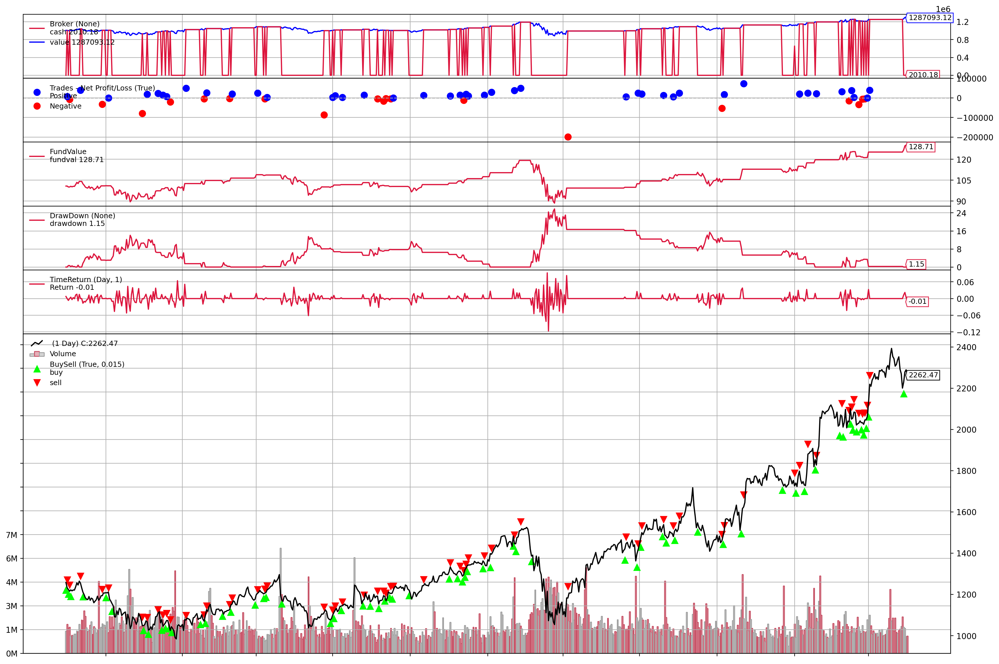

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### BRK-B

In [ ]:
brkb_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/BRK-B.csv', index_col=0, parse_dates=True)
brkb_data.dropna(inplace=True)
time_data = brkb_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(brkb_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=brkb_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.008089454231385048
2018-08-13T00:00:00, 
Today's price =  205.169998
Predicted price =  197.62298848517395
Current f :  0
2018-08-14T00:00:00, 
Today's price =  205.830002
Predicted price =  197.153154968634
Current f :  0
2018-08-15T00:00:00, 
Today's price =  204.5
Predicted price =  198.73391577380448
Current f :  0
2018-08-16T00:00:00, 
Today's price =  207.559998
Predicted price =  198.10165196266547
Current f :  0
2018-08-17T00:00:00, 
Today's price =  208.139999
Predicted price =  197.72877220616502
Current f :  0
2018-08-20T00:00:00, 
Today's price =  208.46000700000002
Predicted price =  197.86407968727738
Current f :  0
2018-08-21T00:00:00, 
Today's price =  208.490005
Predicted price =  199.6685677175974
Current f :  0
2018-08-22T00:00:00, 
Today's price =  207.330002
Predicted price =  204.6207200820046
Current f :  0
2018-08-23T00:00:00, 
Today's price =  207.240005
Predicted price =  207.60364372991995
Current f :  0
2018-08-24T00:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  209.75
Predicted price =  206.451217753351
Current f :  0
2018-08-31T00:00:00, 
Today's price =  208.720001
Predicted price =  204.72480992803744
Current f :  0
2018-09-04T00:00:00, 
Today's price =  210.05000299999998
Predicted price =  207.62093390642156
Current f :  0
2018-09-05T00:00:00, 
Today's price =  212.25999500000003
Predicted price =  207.96732182185522
Current f :  0
2018-09-06T00:00:00, 
Today's price =  212.88000499999998
Predicted price =  207.99210610630243
Current f :  0
2018-09-07T00:00:00, 
Today's price =  214.039993
Predicted price =  207.89879966823526
Current f :  0
2018-09-10T00:00:00, 
Today's price =  215.11000099999998
Predicted price =  206.970525505565
Current f :  0
2018-09-11T00:00:00, 
Today's price =  215.100006
Predicted price =  206.86281359024346
Current f :  0
2018-09-12T00:00:00, 
Today's price =  214.58999599999999
Predicted price =  208.01989093665907
Current f :  0
2018-09-13T00:00:00, 
Today's price =  214.88999900000002
Pred

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2018-10-08T00:00:00, SELL EXECUTED, Price: 219.46, Cost: 990620.28, Comm 0.00
2018-10-08T00:00:00, 
Today's price =  222.059998
Predicted price =  221.16449769721405
Current f :  1
2018-10-09T00:00:00, BUY EXECUTED, Price: 222.06, Cost: 992830.25, Comm 0.00
2018-10-09T00:00:00, 
Today's price =  223.75999500000003
Predicted price =  220.12969451289828
Current f :  0
2018-10-10T00:00:00, SELL EXECUTED, Price: 223.76, Cost: 992830.25, Comm 0.00
2018-10-10T00:00:00, 
Today's price =  213.100006
Predicted price =  218.16794602981366
Current f :  1
2018-10-11T00:00:00, BUY EXECUTED, Price: 213.10, Cost: 1000504.53, Comm 0.00
2018-10-11T00:00:00, 
Today's price =  205.190002
Predicted price =  218.25520198429507
Current f :  1
2018-10-12T00:00:00, 
Today's price =  206.800003
Predicted price =  216.97497350907162
Current f :  1
2018-10-15T00:00:00, 
Today's price =  205.029999
Predicted price =  217.2721653725116
Current f :  1
2018-10-16T00:00:00, 
Today's price =  209.830002
Predicted p

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  219.63000499999998
Predicted price =  202.7763678828776
Current f :  0
2018-11-12T00:00:00, 
Today's price =  215.419998
Predicted price =  204.2170496461249
Current f :  0
2018-11-13T00:00:00, 
Today's price =  217.919998
Predicted price =  202.14998890341974
Current f :  0
2018-11-14T00:00:00, 
Today's price =  216.02999900000003
Predicted price =  204.2226415706639
Current f :  0
2018-11-15T00:00:00, 
Today's price =  217.38000499999998
Predicted price =  205.77385119178842
Current f :  0
2018-11-16T00:00:00, 
Today's price =  218.41000400000001
Predicted price =  206.62775275535373
Current f :  0
2018-11-19T00:00:00, 
Today's price =  217.940002
Predicted price =  207.69996801496688
Current f :  0
2018-11-20T00:00:00, 
Today's price =  210.710007
Predicted price =  208.24077812523208
Current f :  0
2018-11-21T00:00:00, 
Today's price =  210.86000099999998
Predicted price =  215.28818290780882
Current f :  1
2018-11-23T00:00:00, BUY EXECUTED, Price: 210.86, Cost: 1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  196.520004
Predicted price =  218.31343825442454
Current f :  1
2018-12-19T00:00:00, 
Today's price =  195.169998
Predicted price =  219.3335784141193
Current f :  1
2018-12-20T00:00:00, 
Today's price =  193.580002
Predicted price =  221.24145881980076
Current f :  1
2018-12-21T00:00:00, 
Today's price =  192.100006
Predicted price =  213.2138149316089
Current f :  1
2018-12-24T00:00:00, 
Today's price =  187.759995
Predicted price =  211.57557444354424
Current f :  1
2018-12-26T00:00:00, 
Today's price =  197.570007
Predicted price =  207.68509092015705
Current f :  1
2018-12-27T00:00:00, 
Today's price =  200.119995
Predicted price =  207.0022372236135
Current f :  1
2018-12-28T00:00:00, 
Today's price =  202.080002
Predicted price =  205.85741087335504
Current f :  1
2018-12-31T00:00:00, 
Today's price =  204.179993
Predicted price =  204.6766570312861
Current f :  0
2019-01-02T00:00:00, SELL EXECUTED, Price: 204.18, Cost: 1063207.17, Comm 0.00
2019-01-02T00:00:00

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  202.75
Predicted price =  197.96121950630936
Current f :  0
2019-01-28T00:00:00, 
Today's price =  200.949997
Predicted price =  197.69803990203664
Current f :  0
2019-01-29T00:00:00, 
Today's price =  202.050003
Predicted price =  196.84112720888095
Current f :  0
2019-01-30T00:00:00, 
Today's price =  205.96000700000002
Predicted price =  197.10367343345507
Current f :  0
2019-01-31T00:00:00, 
Today's price =  205.53999299999998
Predicted price =  196.99565309689103
Current f :  0
2019-02-01T00:00:00, 
Today's price =  209.190002
Predicted price =  196.91713262988108
Current f :  0
2019-02-04T00:00:00, 
Today's price =  208.520004
Predicted price =  197.7639334567436
Current f :  0
2019-02-05T00:00:00, 
Today's price =  207.820007
Predicted price =  199.40180723364216
Current f :  0
2019-02-06T00:00:00, 
Today's price =  206.009995
Predicted price =  203.51003608037422
Current f :  0
2019-02-07T00:00:00, 
Today's price =  201.729996
Predicted price =  201.71845240818

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2019-03-06T00:00:00, 
Today's price =  200.669998
Predicted price =  205.18232958038757
Current f :  1
2019-03-07T00:00:00, 
Today's price =  199.300003
Predicted price =  205.9374842341185
Current f :  1
2019-03-08T00:00:00, 
Today's price =  198.699997
Predicted price =  207.38944488563635
Current f :  1
2019-03-11T00:00:00, 
Today's price =  202.08999599999999
Predicted price =  206.07068431029086
Current f :  1
2019-03-12T00:00:00, 
Today's price =  202.5
Predicted price =  202.78939368326914
Current f :  0
2019-03-13T00:00:00, SELL EXECUTED, Price: 202.50, Cost: 1061415.59, Comm 0.00
2019-03-13T00:00:00, 
Today's price =  204.059998
Predicted price =  203.88799221819764
Current f :  1
2019-03-14T00:00:00, BUY EXECUTED, Price: 204.06, Cost: 1062540.41, Comm 0.00
2019-03-14T00:00:00, 
Today's price =  203.380005
Predicted price =  204.0201481050805
Current f :  0
2019-03-15T00:00:00, SELL EXECUTED, Price: 203.38, Cost: 1062540.41, Comm 0.00
2019-03-15T00:00:00, 
Today's price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  205.330002
Predicted price =  204.329089342229
Current f :  1
2019-04-08T00:00:00, 
Today's price =  205.25
Predicted price =  204.88011848314196
Current f :  1
2019-04-09T00:00:00, 
Today's price =  204.919998
Predicted price =  202.1615717465751
Current f :  0
2019-04-10T00:00:00, SELL EXECUTED, Price: 204.92, Cost: 1061120.69, Comm 0.00
2019-04-10T00:00:00, 
Today's price =  204.520004
Predicted price =  200.95159968648082
Current f :  0
2019-04-11T00:00:00, 
Today's price =  206.669998
Predicted price =  201.65685470359205
Current f :  0
2019-04-12T00:00:00, 
Today's price =  210.559998
Predicted price =  200.22580043534123
Current f :  0
2019-04-15T00:00:00, 
Today's price =  209.74000499999997
Predicted price =  201.33757058585408
Current f :  0
2019-04-16T00:00:00, 
Today's price =  211.80000299999998
Predicted price =  201.47168272308366
Current f :  0
2019-04-17T00:00:00, 
Today's price =  210.36999500000002
Predicted price =  205.05865266568875
Current f :  0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-05-13T00:00:00, SELL EXECUTED, Price: 209.02, Cost: 1067618.63, Comm 0.00
2019-05-13T00:00:00, 
Today's price =  205.009995
Predicted price =  211.83886430829068
Current f :  1
2019-05-14T00:00:00, BUY EXECUTED, Price: 205.01, Cost: 1069947.16, Comm 0.00
2019-05-14T00:00:00, 
Today's price =  203.690002
Predicted price =  213.72680665131455
Current f :  1
2019-05-15T00:00:00, 
Today's price =  202.979996
Predicted price =  216.05421378941452
Current f :  1
2019-05-16T00:00:00, 
Today's price =  204.630005
Predicted price =  216.26851879587005
Current f :  1
2019-05-17T00:00:00, 
Today's price =  203.270004
Predicted price =  216.11224207638006
Current f :  1
2019-05-20T00:00:00, 
Today's price =  202.729996
Predicted price =  215.45675188785407
Current f :  1
2019-05-21T00:00:00, 
Today's price =  203.360001
Predicted price =  218.13889096665497
Current f :  1
2019-05-22T00:00:00, 
Today's price =  202.600006
Predicted price =  214.1933089166328
Current f :  1
2019-05-23T00:00:00,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  203.479996
Predicted price =  202.49439110341729
Current f :  1
2019-06-18T00:00:00, BUY EXECUTED, Price: 203.48, Cost: 1081292.70, Comm 0.00
2019-06-18T00:00:00, 
Today's price =  206.009995
Predicted price =  200.17728334727894
Current f :  0
2019-06-19T00:00:00, SELL EXECUTED, Price: 206.01, Cost: 1081292.70, Comm 0.00
2019-06-19T00:00:00, 
Today's price =  206.75
Predicted price =  200.64011999645555
Current f :  0
2019-06-20T00:00:00, 
Today's price =  208.03999299999998
Predicted price =  202.5677789497929
Current f :  0
2019-06-21T00:00:00, 
Today's price =  206.21000700000002
Predicted price =  204.15351817474613
Current f :  0
2019-06-24T00:00:00, 
Today's price =  206.850006
Predicted price =  205.4305653575702
Current f :  1
2019-06-25T00:00:00, BUY EXECUTED, Price: 206.85, Cost: 1094650.23, Comm 0.00
2019-06-25T00:00:00, 
Today's price =  208.070007
Predicted price =  206.25699319044213
Current f :  0
2019-06-26T00:00:00, SELL EXECUTED, Price: 208.07, Cost

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2019-07-17T00:00:00, BUY EXECUTED, Price: 212.88, Cost: 1119748.83, Comm 0.00
2019-07-17T00:00:00, 
Today's price =  207.449997
Predicted price =  212.8975524815304
Current f :  1
2019-07-18T00:00:00, 
Today's price =  207.979996
Predicted price =  214.36030524782367
Current f :  1
2019-07-19T00:00:00, 
Today's price =  205.970001
Predicted price =  214.3753044687245
Current f :  1
2019-07-22T00:00:00, 
Today's price =  204.83999599999999
Predicted price =  215.25278494624655
Current f :  1
2019-07-23T00:00:00, 
Today's price =  206.46000700000002
Predicted price =  215.49330272115972
Current f :  1
2019-07-24T00:00:00, 
Today's price =  207.970001
Predicted price =  215.18590884592894
Current f :  1
2019-07-25T00:00:00, 
Today's price =  207.899994
Predicted price =  214.55920925406122
Current f :  1
2019-07-26T00:00:00, 
Today's price =  209.899994
Predicted price =  214.30628411404817
Current f :  1
2019-07-29T00:00:00, 
Today's price =  208.610001
Predicted price =  213.40316372

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2019-08-22T00:00:00, 
Today's price =  201.009995
Predicted price =  202.82141106541005
Current f :  1
2019-08-23T00:00:00, 
Today's price =  197.16000400000001
Predicted price =  200.41665684132437
Current f :  1
2019-08-26T00:00:00, 
Today's price =  200.199997
Predicted price =  202.4931754309978
Current f :  1
2019-08-27T00:00:00, 
Today's price =  198.350006
Predicted price =  200.5823491057495
Current f :  1
2019-08-28T00:00:00, 
Today's price =  200.449997
Predicted price =  199.18223017323075
Current f :  1
2019-08-29T00:00:00, 
Today's price =  203.199997
Predicted price =  200.2679500641882
Current f :  0
2019-08-30T00:00:00, SELL EXECUTED, Price: 203.20, Cost: 1119748.83, Comm 0.00
2019-08-30T00:00:00, 
Today's price =  203.41000400000001
Predicted price =  198.10949134311312
Current f :  0
2019-09-03T00:00:00, 
Today's price =  200.899994
Predicted price =  199.97167148108107
Current f :  1
2019-09-04T00:00:00, BUY EXECUTED, Price: 200.90, Cost: 1068787.97, Comm 0.00
201

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Current f :  1
2019-09-30T00:00:00, BUY EXECUTED, Price: 207.45, Cost: 1091809.33, Comm 0.00
2019-09-30T00:00:00, 
Today's price =  208.020004
Predicted price =  211.38942702575918
Current f :  1
2019-10-01T00:00:00, 
Today's price =  206.71000700000002
Predicted price =  212.83934409825096
Current f :  1
2019-10-02T00:00:00, 
Today's price =  203.100006
Predicted price =  209.88371919161193
Current f :  1
2019-10-03T00:00:00, 
Today's price =  204.979996
Predicted price =  210.2355941980828
Current f :  1
2019-10-04T00:00:00, 
Today's price =  208.080002
Predicted price =  210.39246375595724
Current f :  1
2019-10-07T00:00:00, 
Today's price =  207.240005
Predicted price =  209.6431994449539
Current f :  1
2019-10-08T00:00:00, 
Today's price =  204.08999599999999
Predicted price =  208.61938967859055
Current f :  1
2019-10-09T00:00:00, 
Today's price =  206.690002
Predicted price =  207.84338195286338
Current f :  0
2019-10-10T00:00:00, SELL EXECUTED, Price: 206.69, Cost: 1091809.33, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  213.25
Predicted price =  209.11602903290935
Current f :  0
2019-10-31T00:00:00, 
Today's price =  212.580002
Predicted price =  209.4794683087898
Current f :  0
2019-11-01T00:00:00, 
Today's price =  215.830002
Predicted price =  209.86672182081293
Current f :  0
2019-11-04T00:00:00, 
Today's price =  217.979996
Predicted price =  209.69819736285015
Current f :  0
2019-11-05T00:00:00, 
Today's price =  220.88000499999998
Predicted price =  209.79505839736055
Current f :  0
2019-11-06T00:00:00, 
Today's price =  222.0
Predicted price =  211.7083637933164
Current f :  0
2019-11-07T00:00:00, 
Today's price =  222.74000499999997
Predicted price =  210.88168422679976
Current f :  0
2019-11-08T00:00:00, 
Today's price =  221.309998
Predicted price =  211.10253004217188
Current f :  0
2019-11-11T00:00:00, 
Today's price =  220.850006
Predicted price =  211.06761762909997
Current f :  0
2019-11-12T00:00:00, 
Today's price =  220.88999900000002
Predicted price =  212.075895103

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-12-05T00:00:00, 
Today's price =  219.600006
Predicted price =  219.40008113389388
Current f :  1
2019-12-06T00:00:00, BUY EXECUTED, Price: 219.60, Cost: 1109199.63, Comm 0.00
2019-12-06T00:00:00, 
Today's price =  222.61000099999998
Predicted price =  219.20719332998183
Current f :  0
2019-12-09T00:00:00, SELL EXECUTED, Price: 222.61, Cost: 1109199.63, Comm 0.00
2019-12-09T00:00:00, 
Today's price =  221.38000499999998
Predicted price =  217.70250187134806
Current f :  0
2019-12-10T00:00:00, 
Today's price =  221.25999500000003
Predicted price =  216.88252950958372
Current f :  0
2019-12-11T00:00:00, 
Today's price =  222.57000699999998
Predicted price =  218.3685528473856
Current f :  0
2019-12-12T00:00:00, 
Today's price =  225.919998
Predicted price =  219.54016369805723
Current f :  0
2019-12-13T00:00:00, 
Today's price =  225.36999500000002
Predicted price =  219.7993730839645
Current f :  0
2019-12-16T00:00:00, 
Today's price =  226.850006
Predicted price =  221.05994626780

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-01-10T00:00:00, SELL EXECUTED, Price: 228.65, Cost: 1133814.00, Comm 0.00
2020-01-10T00:00:00, 
Today's price =  226.61999500000002
Predicted price =  225.73237160331584
Current f :  1
2020-01-13T00:00:00, BUY EXECUTED, Price: 226.62, Cost: 1141938.15, Comm 0.00
2020-01-13T00:00:00, 
Today's price =  228.44999700000002
Predicted price =  225.56913609440454
Current f :  0
2020-01-14T00:00:00, SELL EXECUTED, Price: 228.45, Cost: 1141938.15, Comm 0.00
2020-01-14T00:00:00, 
Today's price =  227.169998
Predicted price =  226.47330032057548
Current f :  1
2020-01-15T00:00:00, BUY EXECUTED, Price: 227.17, Cost: 1151297.55, Comm 0.00
2020-01-15T00:00:00, 
Today's price =  228.350006
Predicted price =  226.3991317080648
Current f :  0
2020-01-16T00:00:00, SELL EXECUTED, Price: 228.35, Cost: 1151297.55, Comm 0.00
2020-01-16T00:00:00, 
Today's price =  229.729996
Predicted price =  226.30383158272704
Current f :  0
2020-01-17T00:00:00, 
Today's price =  230.19999700000002
Predicted price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  224.17228934909292
Current f :  0
2020-02-13T00:00:00, 
Today's price =  226.47000099999997
Predicted price =  225.09216146327927
Current f :  1
2020-02-14T00:00:00, BUY EXECUTED, Price: 226.47, Cost: 1182173.41, Comm 0.00
2020-02-14T00:00:00, 
Today's price =  226.80000299999998
Predicted price =  225.58887822689525
Current f :  1
2020-02-18T00:00:00, 
Today's price =  226.770004
Predicted price =  228.78175669142556
Current f :  1
2020-02-19T00:00:00, 
Today's price =  229.24000499999997
Predicted price =  225.78018863717426
Current f :  0
2020-02-20T00:00:00, SELL EXECUTED, Price: 229.24, Cost: 1182173.41, Comm 0.00
2020-02-20T00:00:00, 
Today's price =  228.169998
Predicted price =  224.2971022011558
Current f :  0
2020-02-21T00:00:00, 
Today's price =  229.330002
Predicted price =  225.79519988587512
Current f :  0
2020-02-24T00:00:00, 
Today's price =  221.690002
Predicted price =  229.33425654352203
Current f :  1
2020-02-25T00:00:00, BUY EXECUTED, Price: 221.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-03-19T00:00:00, 
Today's price =  174.679993
Predicted price =  212.23184477388068
Current f :  1
2020-03-20T00:00:00, 
Today's price =  170.059998
Predicted price =  219.31001374111577
Current f :  1
2020-03-23T00:00:00, 
Today's price =  162.130005
Predicted price =  211.47748412464043
Current f :  1
2020-03-24T00:00:00, 
Today's price =  178.199997
Predicted price =  209.4070553362109
Current f :  1
2020-03-25T00:00:00, 
Today's price =  180.470001
Predicted price =  199.38265024817878
Current f :  1
2020-03-26T00:00:00, 
Today's price =  183.899994
Predicted price =  206.36627404761975
Current f :  1
2020-03-27T00:00:00, 
Today's price =  179.66000400000001
Predicted price =  200.02569496424178
Current f :  1
2020-03-30T00:00:00, 
Today's price =  183.179993
Predicted price =  185.32787435539072
Current f :  1
2020-03-31T00:00:00, 
Today's price =  182.830002
Predicted price =  198.94688625334632
Current f :  1
2020-04-01T00:00:00, 
Today's price =  175.949997
Predicted price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-04-23T00:00:00, 
Today's price =  185.630005
Predicted price =  184.97789186023863
Current f :  1
2020-04-24T00:00:00, BUY EXECUTED, Price: 185.63, Cost: 962677.21, Comm 0.00
2020-04-24T00:00:00, 
Today's price =  186.520004
Predicted price =  186.36470932261057
Current f :  1
2020-04-27T00:00:00, 
Today's price =  187.46000700000002
Predicted price =  189.7751961574517
Current f :  1
2020-04-28T00:00:00, 
Today's price =  187.119995
Predicted price =  192.18410129887195
Current f :  1
2020-04-29T00:00:00, 
Today's price =  189.610001
Predicted price =  186.43602022076618
Current f :  0
2020-04-30T00:00:00, SELL EXECUTED, Price: 189.61, Cost: 962677.21, Comm 0.00
2020-04-30T00:00:00, 
Today's price =  187.360001
Predicted price =  191.20048632947803
Current f :  1
2020-05-01T00:00:00, BUY EXECUTED, Price: 187.36, Cost: 983265.29, Comm 0.00
2020-05-01T00:00:00, 
Today's price =  182.669998
Predicted price =  188.81299876423247
Current f :  1
2020-05-04T00:00:00, 
Today's price =

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  174.9496904452742
Current f :  0
2020-06-01T00:00:00, 
Today's price =  183.83999599999999
Predicted price =  173.5443272721102
Current f :  0
2020-06-02T00:00:00, 
Today's price =  185.940002
Predicted price =  173.33523538646384
Current f :  0
2020-06-03T00:00:00, 
Today's price =  190.820007
Predicted price =  172.3386243385421
Current f :  0
2020-06-04T00:00:00, 
Today's price =  192.050003
Predicted price =  177.4645648079848
Current f :  0
2020-06-05T00:00:00, 
Today's price =  200.66000400000001
Predicted price =  175.06203243651348
Current f :  0
2020-06-08T00:00:00, 
Today's price =  201.559998
Predicted price =  178.17227466621424
Current f :  0
2020-06-09T00:00:00, 
Today's price =  196.070007
Predicted price =  177.14887963314203
Current f :  0
2020-06-10T00:00:00, 
Today's price =  191.509995
Predicted price =  177.33727750053097
Current f :  0
2020-06-11T00:00:00, 
Today's price =  178.020004
Predicted price =  181.52318168600516
Current f :  1
2020-06-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  182.720001
Predicted price =  181.3517647121023
Current f :  1
2020-07-07T00:00:00, 
Today's price =  181.149994
Predicted price =  180.51288243043973
Current f :  1
2020-07-08T00:00:00, 
Today's price =  181.199997
Predicted price =  180.5302360771947
Current f :  1
2020-07-09T00:00:00, 
Today's price =  178.800003
Predicted price =  181.90556990030896
Current f :  1
2020-07-10T00:00:00, 
Today's price =  182.899994
Predicted price =  182.3534373499391
Current f :  1
2020-07-13T00:00:00, 
Today's price =  184.130005
Predicted price =  179.49742753333945
Current f :  0
2020-07-14T00:00:00, SELL EXECUTED, Price: 184.13, Cost: 918049.16, Comm 0.00
2020-07-14T00:00:00, 
Today's price =  189.71000700000002
Predicted price =  181.26967948189423
Current f :  0
2020-07-15T00:00:00, 
Today's price =  190.559998
Predicted price =  179.4490743825802
Current f :  0
2020-07-16T00:00:00, 
Today's price =  191.009995
Predicted price =  180.9868219411096
Current f :  0
2020-07-17T00:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-08-06T00:00:00, 
Today's price =  205.020004
Predicted price =  191.94004312855483
Current f :  0
2020-08-07T00:00:00, 
Today's price =  209.479996
Predicted price =  191.42437513608195
Current f :  0
2020-08-10T00:00:00, 
Today's price =  212.580002
Predicted price =  192.16223922424692
Current f :  0
2020-08-11T00:00:00, 
Today's price =  212.66000400000001
Predicted price =  193.3672845330537
Current f :  0
2020-08-12T00:00:00, 
Today's price =  213.24000499999997
Predicted price =  192.128319407949
Current f :  0
2020-08-13T00:00:00, 
Today's price =  211.979996
Predicted price =  193.0454461575077
Current f :  0
2020-08-14T00:00:00, 
Today's price =  210.960007
Predicted price =  195.13851662614132
Current f :  0
2020-08-17T00:00:00, 
Today's price =  206.779999
Predicted price =  193.73989076279688
Current f :  0
2020-08-18T00:00:00, 
Today's price =  208.330002
Predicted price =  195.11135989464827
Current f :  0
2020-08-19T00:00:00, 
Today's price =  207.21000700000002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  219.940002
Predicted price =  213.65201705023955
Current f :  0
2020-09-15T00:00:00, 
Today's price =  218.940002
Predicted price =  215.58142760431377
Current f :  0
2020-09-16T00:00:00, 
Today's price =  219.58999599999999
Predicted price =  217.81972099450994
Current f :  [0.21256911]
2020-09-17T00:00:00, BUY EXECUTED, Price: 219.59, Cost: 201803.21, Comm 0.00
2020-09-17T00:00:00, 
Today's price =  218.05000299999998
Predicted price =  218.33470183217113
Current f :  0
2020-09-18T00:00:00, SELL EXECUTED, Price: 218.05, Cost: 201803.21, Comm 0.00
2020-09-18T00:00:00, 
Today's price =  218.210007
Predicted price =  218.96796479970786
Current f :  0
2020-09-21T00:00:00, 
Today's price =  213.020004
Predicted price =  221.60214076571125
Current f :  1
2020-09-22T00:00:00, BUY EXECUTED, Price: 213.02, Cost: 948152.04, Comm 0.00
2020-09-22T00:00:00, 
Today's price =  214.16000400000001
Predicted price =  219.13046210371016
Current f :  1
2020-09-23T00:00:00, 
Today's pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  211.91000400000001
Predicted price =  214.16766293559377
Current f :  1
2020-10-19T00:00:00, BUY EXECUTED, Price: 211.91, Cost: 946390.08, Comm 0.00
2020-10-19T00:00:00, 
Today's price =  208.990005
Predicted price =  212.98859504470562
Current f :  1
2020-10-20T00:00:00, 
Today's price =  210.059998
Predicted price =  213.4109222422971
Current f :  1
2020-10-21T00:00:00, 
Today's price =  210.17999300000002
Predicted price =  214.33182936399
Current f :  1
2020-10-22T00:00:00, 
Today's price =  211.61000099999998
Predicted price =  212.07642407335885
Current f :  0
2020-10-23T00:00:00, SELL EXECUTED, Price: 211.61, Cost: 946390.08, Comm 0.00
2020-10-23T00:00:00, 
Today's price =  212.710007
Predicted price =  214.8295812700465
Current f :  1
2020-10-26T00:00:00, BUY EXECUTED, Price: 212.71, Cost: 945070.56, Comm 0.00
2020-10-26T00:00:00, 
Today's price =  208.490005
Predicted price =  216.57553606388223
Current f :  1
2020-10-27T00:00:00, 
Today's price =  206.880005


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  233.13000499999998
Predicted price =  220.2350496661683
Current f :  0
2020-11-27T00:00:00, 
Today's price =  231.55000299999998
Predicted price =  226.84094934802096
Current f :  0
2020-11-30T00:00:00, 
Today's price =  228.91000400000001
Predicted price =  226.37399123060294
Current f :  0
2020-12-01T00:00:00, 
Today's price =  229.67999300000002
Predicted price =  223.81801616350296
Current f :  0
2020-12-02T00:00:00, 
Today's price =  230.419998
Predicted price =  226.34864245385305
Current f :  0
2020-12-03T00:00:00, 
Today's price =  231.020004
Predicted price =  231.9535501652807
Current f :  0
2020-12-04T00:00:00, 
Today's price =  231.350006
Predicted price =  232.53795509339068
Current f :  0
2020-12-07T00:00:00, 
Today's price =  229.24000499999997
Predicted price =  228.3011130714501
Current f :  1
2020-12-08T00:00:00, BUY EXECUTED, Price: 229.24, Cost: 984127.34, Comm 0.00
2020-12-08T00:00:00, 
Today's price =  228.190002
Predicted price =  226.91897638783

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  231.86999500000002
Predicted price =  224.43383125528115
Current f :  0
2021-01-04T00:00:00, SELL EXECUTED, Price: 231.87, Cost: 985314.47, Comm 0.00
2021-01-04T00:00:00, 
Today's price =  228.44999700000002
Predicted price =  226.0784308319838
Current f :  0
2021-01-05T00:00:00, 
Today's price =  227.47000099999997
Predicted price =  224.57892333352038
Current f :  0
2021-01-06T00:00:00, 
Today's price =  230.270004
Predicted price =  226.30552142340565
Current f :  0
2021-01-07T00:00:00, 
Today's price =  232.88000499999998
Predicted price =  224.85466601408078
Current f :  0
2021-01-08T00:00:00, 
Today's price =  234.02999900000003
Predicted price =  224.9524232504211
Current f :  0
2021-01-11T00:00:00, 
Today's price =  233.42999300000002
Predicted price =  223.75631662464392
Current f :  0
2021-01-12T00:00:00, 
Today's price =  233.02999900000003
Predicted price =  225.90655110238785
Current f :  0
2021-01-13T00:00:00, 
Today's price =  234.50999500000003
Predicte

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  252.0
Predicted price =  247.61178431461676
Current f :  0
2021-03-18T00:00:00, 
Today's price =  252.460007
Predicted price =  249.0982623959452
Current f :  0
2021-03-19T00:00:00, 
Today's price =  250.99000499999997
Predicted price =  251.05491335319448
Current f :  0
2021-03-22T00:00:00, 
Today's price =  250.36000099999998
Predicted price =  245.1813123184821
Current f :  0
2021-03-23T00:00:00, 
Today's price =  248.309998
Predicted price =  251.3598526795155
Current f :  1
2021-03-24T00:00:00, BUY EXECUTED, Price: 248.31, Cost: 1095792.02, Comm 0.00
2021-03-24T00:00:00, 
Today's price =  249.63000499999998
Predicted price =  256.91817898767044
Current f :  1
2021-03-25T00:00:00, 
Today's price =  250.75
Predicted price =  259.22918170062326
Current f :  1
2021-03-26T00:00:00, 
Today's price =  256.769989
Predicted price =  261.74323621508006
Current f :  1
2021-03-29T00:00:00, 
Today's price =  258.820007
Predicted price =  259.1375736006635
Current f :  0
2021-0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  272.209991
Predicted price =  263.426247205564
Current f :  0
2021-04-22T00:00:00, 
Today's price =  269.51001
Predicted price =  264.0123418964836
Current f :  0
2021-04-23T00:00:00, 
Today's price =  271.980011
Predicted price =  264.1486680354971
Current f :  0
2021-04-26T00:00:00, 
Today's price =  270.859985
Predicted price =  263.3017020413655
Current f :  0
2021-04-27T00:00:00, 
Today's price =  273.649994
Predicted price =  265.61346496455724
Current f :  0
2021-04-28T00:00:00, 
Today's price =  272.950012
Predicted price =  267.21281378127634
Current f :  0
2021-04-29T00:00:00, 
Today's price =  277.600006
Predicted price =  266.2514451786163
Current f :  0
2021-04-30T00:00:00, 
Today's price =  274.950012
Predicted price =  265.5533287190907
Current f :  0
2021-05-03T00:00:00, 
Today's price =  279.179993
Predicted price =  267.03673189360643
Current f :  0
2021-05-04T00:00:00, 
Today's price =  280.26001
Predicted price =  270.45796938892323
Current f :  0
2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

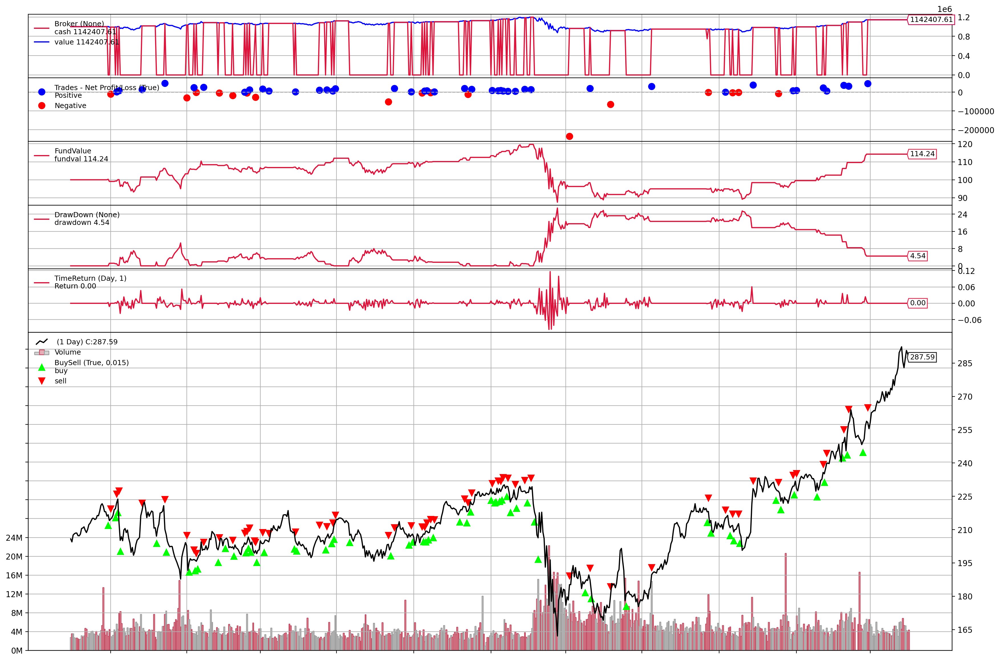

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### JPM

In [ ]:
jpm_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/JPM.csv', index_col=0, parse_dates=True)
jpm_data.dropna(inplace=True)
time_data = jpm_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(jpm_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=jpm_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.011424641016415877
2018-08-13T00:00:00, 
Today's price =  113.889999
Predicted price =  115.05578388082614
Current f :  0
2018-08-14T00:00:00, 
Today's price =  114.650002
Predicted price =  116.55712660510238
Current f :  1
2018-08-15T00:00:00, BUY EXECUTED, Price: 114.65, Cost: 999977.32, Comm 0.00
2018-08-15T00:00:00, 
Today's price =  113.699997
Predicted price =  117.18649686604869
Current f :  1
2018-08-16T00:00:00, 
Today's price =  114.769997
Predicted price =  115.50622048891424
Current f :  0
2018-08-17T00:00:00, SELL EXECUTED, Price: 114.77, Cost: 999977.32, Comm 0.00
2018-08-17T00:00:00, 
Today's price =  114.769997
Predicted price =  115.87750386882558
Current f :  0
2018-08-20T00:00:00, 
Today's price =  114.620003
Predicted price =  116.95797807431654
Current f :  1
2018-08-21T00:00:00, BUY EXECUTED, Price: 114.62, Cost: 1000976.49, Comm 0.00
2018-08-21T00:00:00, 
Today's price =  115.32
Predicted price =  117.88342288884962
Curre

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 115.150002
Predicted price =  116.02651495583078
Current f :  0
2018-09-05T00:00:00, 
Today's price =  114.589996
Predicted price =  115.83627451615038
Current f :  0
2018-09-06T00:00:00, 
Today's price =  114.099998
Predicted price =  115.56294071792524
Current f :  1
2018-09-07T00:00:00, BUY EXECUTED, Price: 114.10, Cost: 1014234.88, Comm 0.00
2018-09-07T00:00:00, 
Today's price =  114.32
Predicted price =  116.28353991402014
Current f :  1
2018-09-10T00:00:00, 
Today's price =  113.709999
Predicted price =  116.1603986595143
Current f :  1
2018-09-11T00:00:00, 
Today's price =  114.43
Predicted price =  115.99044854069354
Current f :  1
2018-09-12T00:00:00, 
Today's price =  113.08000200000001
Predicted price =  115.6955474051178
Current f :  1
2018-09-13T00:00:00, 
Today's price =  113.519997
Predicted price =  117.51172285839348
Current f :  1
2018-09-14T00:00:00, 
Today's price =  113.5
Predicted price =  117.19044784208782
Current f :  1
2018-09-17T00:00:00, 
Today's price =  1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2018-10-05T00:00:00, 
Today's price =  114.620003
Predicted price =  118.17294088478008
Current f :  1
2018-10-08T00:00:00, BUY EXECUTED, Price: 114.62, Cost: 1030892.31, Comm 0.00
2018-10-08T00:00:00, 
Today's price =  115.32
Predicted price =  119.0963122828887
Current f :  1
2018-10-09T00:00:00, 
Today's price =  114.519997
Predicted price =  118.67137705253828
Current f :  1
2018-10-10T00:00:00, 
Today's price =  111.470001
Predicted price =  117.42477318608542
Current f :  1
2018-10-11T00:00:00, 
Today's price =  108.129997
Predicted price =  117.05525006414828
Current f :  1
2018-10-12T00:00:00, 
Today's price =  106.949997
Predicted price =  116.11542234398982
Current f :  1
2018-10-15T00:00:00, 
Today's price =  106.339996
Predicted price =  115.6049883506355
Current f :  1
2018-10-16T00:00:00, 
Today's price =  108.620003
Predicted price =  113.78851987800402
Current f :  1
2018-10-17T00:00:00, 
Today's price =  109.83000200000001
Predicted price =  114.36798972051562
Current 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2018-11-08T00:00:00, 
Today's price =  112.379997
Predicted price =  106.72574684454969
Current f :  0
2018-11-09T00:00:00, 
Today's price =  111.290001
Predicted price =  104.69392963363933
Current f :  0
2018-11-12T00:00:00, 
Today's price =  108.949997
Predicted price =  105.99589727977761
Current f :  0
2018-11-13T00:00:00, 
Today's price =  109.589996
Predicted price =  104.71487966335735
Current f :  0
2018-11-14T00:00:00, 
Today's price =  107.33000200000001
Predicted price =  106.22664634534422
Current f :  1
2018-11-15T00:00:00, BUY EXECUTED, Price: 107.33, Cost: 1002676.88, Comm 0.00
2018-11-15T00:00:00, 
Today's price =  110.07
Predicted price =  107.37748830910019
Current f :  0
2018-11-16T00:00:00, SELL EXECUTED, Price: 110.07, Cost: 1002676.88, Comm 0.00
2018-11-16T00:00:00, 
Today's price =  109.989998
Predicted price =  109.44443260387459
Current f :  1
2018-11-19T00:00:00, BUY EXECUTED, Price: 109.99, Cost: 1028296.49, Comm 0.00
2018-11-19T00:00:00, 
Today's price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  101.360001
Predicted price =  109.40621083579452
Current f :  1
2018-12-11T00:00:00, 
Today's price =  100.370003
Predicted price =  108.48998230055352
Current f :  1
2018-12-12T00:00:00, 
Today's price =  101.019997
Predicted price =  107.53783153769012
Current f :  1
2018-12-13T00:00:00, 
Today's price =  101.120003
Predicted price =  110.29205163943945
Current f :  1
2018-12-14T00:00:00, 
Today's price =  100.290001
Predicted price =  111.02101785066293
Current f :  1
2018-12-17T00:00:00, 
Today's price =  99.010002
Predicted price =  111.78607910886385
Current f :  1
2018-12-18T00:00:00, 
Today's price =  98.540001
Predicted price =  110.96897882063567
Current f :  1
2018-12-19T00:00:00, 
Today's price =  97.290001
Predicted price =  111.93956017475526
Current f :  1
2018-12-20T00:00:00, 
Today's price =  96.449997
Predicted price =  113.11986658221758
Current f :  1
2018-12-21T00:00:00, 
Today's price =  94.16999799999999
Predicted price =  108.24828525988818
Curr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-01-17T00:00:00, 
Today's price =  102.91999799999999
Predicted price =  98.37711465164227
Current f :  0
2019-01-18T00:00:00, 
Today's price =  104.589996
Predicted price =  99.66453977575
Current f :  0
2019-01-22T00:00:00, 
Today's price =  102.940002
Predicted price =  97.85978752010476
Current f :  0
2019-01-23T00:00:00, 
Today's price =  102.68
Predicted price =  101.45196342025955
Current f :  0
2019-01-24T00:00:00, 
Today's price =  102.739998
Predicted price =  100.90007682493666
Current f :  0
2019-01-25T00:00:00, 
Today's price =  103.389999
Predicted price =  100.67091220619463
Current f :  0
2019-01-28T00:00:00, 
Today's price =  103.879997
Predicted price =  100.81356706224537
Current f :  0
2019-01-29T00:00:00, 
Today's price =  104.16999799999999
Predicted price =  100.70423573668054
Current f :  0
2019-01-30T00:00:00, 
Today's price =  104.410004
Predicted price =  100.40424619013305
Current f :  0
2019-01-31T00:00:00, 
Today's price =  103.5
Predicted price =  101

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  102.41999799999999
Predicted price =  105.1026031718448
Current f :  1
2019-02-15T00:00:00, 
Today's price =  105.550003
Predicted price =  104.83922090648096
Current f :  1
2019-02-19T00:00:00, 
Today's price =  105.18
Predicted price =  104.22097161110858
Current f :  1
2019-02-20T00:00:00, 
Today's price =  105.690002
Predicted price =  104.89899960288972
Current f :  1
2019-02-21T00:00:00, 
Today's price =  105.470001
Predicted price =  104.97255904139632
Current f :  1
2019-02-22T00:00:00, 
Today's price =  105.0
Predicted price =  104.56994994598688
Current f :  1
2019-02-25T00:00:00, 
Today's price =  106.099998
Predicted price =  104.7328062208463
Current f :  0
2019-02-26T00:00:00, SELL EXECUTED, Price: 106.10, Cost: 1011167.37, Comm 0.00
2019-02-26T00:00:00, 
Today's price =  105.290001
Predicted price =  103.2452875352873
Current f :  0
2019-02-27T00:00:00, 
Today's price =  105.160004
Predicted price =  102.36763465352459
Current f :  0
2019-02-28T00:00:00,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-03-20T00:00:00, 
Today's price =  104.519997
Predicted price =  104.95122485334903
Current f :  0
2019-03-21T00:00:00, 
Today's price =  102.870003
Predicted price =  104.96661139417861
Current f :  1
2019-03-22T00:00:00, BUY EXECUTED, Price: 102.87, Cost: 1074065.70, Comm 0.00
2019-03-22T00:00:00, 
Today's price =  99.760002
Predicted price =  104.50470510798004
Current f :  1
2019-03-25T00:00:00, 
Today's price =  98.93
Predicted price =  103.79733967363487
Current f :  1
2019-03-26T00:00:00, 
Today's price =  99.91999799999999
Predicted price =  103.83442524642399
Current f :  1
2019-03-27T00:00:00, 
Today's price =  99.58000200000001
Predicted price =  105.38969801476415
Current f :  1
2019-03-28T00:00:00, 
Today's price =  100.709999
Predicted price =  104.9780104164526
Current f :  1
2019-03-29T00:00:00, 
Today's price =  101.230003
Predicted price =  105.05085839275895
Current f :  1
2019-04-01T00:00:00, 
Today's price =  104.639999
Predicted price =  106.1458173960701
Curr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Current f :  0
2019-04-24T00:00:00, 
Today's price =  113.550003
Predicted price =  106.19675142422071
Current f :  0
2019-04-25T00:00:00, 
Today's price =  113.610001
Predicted price =  106.48417552237811
Current f :  0
2019-04-26T00:00:00, 
Today's price =  114.470001
Predicted price =  105.64365637717822
Current f :  0
2019-04-29T00:00:00, 
Today's price =  116.120003
Predicted price =  105.92794162169389
Current f :  0
2019-04-30T00:00:00, 
Today's price =  116.050003
Predicted price =  106.66646993107886
Current f :  0
2019-05-01T00:00:00, 
Today's price =  115.160004
Predicted price =  111.45753689173705
Current f :  0
2019-05-02T00:00:00, 
Today's price =  115.410004
Predicted price =  110.17288390775605
Current f :  0
2019-05-03T00:00:00, 
Today's price =  116.120003
Predicted price =  111.30016906407715
Current f :  0
2019-05-06T00:00:00, 
Today's price =  115.089996
Predicted price =  113.87949860110035
Current f :  1
2019-05-07T00:00:00, BUY EXECUTED, Price: 115.09, Cost: 10

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  108.519997
Predicted price =  114.05230990575384
Current f :  1
2019-05-29T00:00:00, 
Today's price =  108.220001
Predicted price =  113.81017296649466
Current f :  1
2019-05-30T00:00:00, 
Today's price =  107.059998
Predicted price =  110.60769488134511
Current f :  1
2019-05-31T00:00:00, 
Today's price =  105.959999
Predicted price =  111.64883269138863
Current f :  1
2019-06-03T00:00:00, 
Today's price =  106.459999
Predicted price =  111.41632573143522
Current f :  1
2019-06-04T00:00:00, 
Today's price =  109.739998
Predicted price =  112.54238317732913
Current f :  1
2019-06-05T00:00:00, 
Today's price =  110.129997
Predicted price =  112.08520723240036
Current f :  1
2019-06-06T00:00:00, 
Today's price =  110.370003
Predicted price =  112.44373061802767
Current f :  1
2019-06-07T00:00:00, 
Today's price =  109.160004
Predicted price =  112.53703369607194
Current f :  1
2019-06-10T00:00:00, 
Today's price =  110.339996
Predicted price =  111.9950446139733
Current 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  113.800003
Predicted price =  110.46783920811671
Current f :  0
2019-07-03T00:00:00, 
Today's price =  112.82
Predicted price =  110.35233289283053
Current f :  0
2019-07-05T00:00:00, 
Today's price =  113.489998
Predicted price =  111.51215718214004
Current f :  0
2019-07-08T00:00:00, 
Today's price =  112.870003
Predicted price =  110.26773683061501
Current f :  0
2019-07-09T00:00:00, 
Today's price =  113.349998
Predicted price =  110.74890571059171
Current f :  0
2019-07-10T00:00:00, 
Today's price =  113.019997
Predicted price =  110.31669064185184
Current f :  0
2019-07-11T00:00:00, 
Today's price =  114.099998
Predicted price =  109.54638145678581
Current f :  0
2019-07-12T00:00:00, 
Today's price =  115.300003
Predicted price =  108.81194817397676
Current f :  0
2019-07-15T00:00:00, 
Today's price =  113.900002
Predicted price =  109.34013379248898
Current f :  0
2019-07-16T00:00:00, 
Today's price =  115.120003
Predicted price =  109.53644571127691
Current f 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-08-02T00:00:00, BUY EXECUTED, Price: 112.94, Cost: 1120477.76, Comm 0.00
2019-08-02T00:00:00, 
Today's price =  112.93
Predicted price =  114.52626294644261
Current f :  1
2019-08-05T00:00:00, 
Today's price =  109.57
Predicted price =  115.53616751240153
Current f :  1
2019-08-06T00:00:00, 
Today's price =  110.43
Predicted price =  114.52942748765389
Current f :  1
2019-08-07T00:00:00, 
Today's price =  108.029999
Predicted price =  115.1226111161761
Current f :  1
2019-08-08T00:00:00, 
Today's price =  109.860001
Predicted price =  117.03069812632674
Current f :  1
2019-08-09T00:00:00, 
Today's price =  109.739998
Predicted price =  117.48530874440624
Current f :  1
2019-08-12T00:00:00, 
Today's price =  107.68
Predicted price =  116.46660459373527
Current f :  1
2019-08-13T00:00:00, 
Today's price =  109.339996
Predicted price =  117.04883265903527
Current f :  1
2019-08-14T00:00:00, 
Today's price =  104.800003
Predicted price =  116.77937780972957
Current f :  1
2019-08-15T0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2019-09-06T00:00:00, SELL EXECUTED, Price: 112.37, Cost: 1089910.43, Comm 0.00
2019-09-06T00:00:00, 
Today's price =  112.610001
Predicted price =  108.32639104359191
Current f :  0
2019-09-09T00:00:00, 
Today's price =  115.400002
Predicted price =  108.50988481125808
Current f :  0
2019-09-10T00:00:00, 
Today's price =  116.870003
Predicted price =  109.3538149962337
Current f :  0
2019-09-11T00:00:00, 
Today's price =  117.190002
Predicted price =  107.37989606422946
Current f :  0
2019-09-12T00:00:00, 
Today's price =  117.910004
Predicted price =  107.84228146211967
Current f :  0
2019-09-13T00:00:00, 
Today's price =  120.230003
Predicted price =  106.3768382742077
Current f :  0
2019-09-16T00:00:00, 
Today's price =  119.160004
Predicted price =  107.71966676938283
Current f :  0
2019-09-17T00:00:00, 
Today's price =  118.57
Predicted price =  109.93775053730238
Current f :  0
2019-09-18T00:00:00, 
Today's price =  119.760002
Predicted price =  110.39404196638961
Current f : 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  116.139999
Predicted price =  118.95147351451928
Current f :  1
2019-10-14T00:00:00, 
Today's price =  116.449997
Predicted price =  118.33511361824364
Current f :  1
2019-10-15T00:00:00, 
Today's price =  119.959999
Predicted price =  118.49671969050061
Current f :  0
2019-10-16T00:00:00, SELL EXECUTED, Price: 119.96, Cost: 1120950.58, Comm 0.00
2019-10-16T00:00:00, 
Today's price =  119.68
Predicted price =  118.75167283777981
Current f :  1
2019-10-17T00:00:00, BUY EXECUTED, Price: 119.68, Cost: 1163768.32, Comm 0.00
2019-10-17T00:00:00, 
Today's price =  120.349998
Predicted price =  116.99921517567503
Current f :  0
2019-10-18T00:00:00, SELL EXECUTED, Price: 120.35, Cost: 1163768.32, Comm 0.00
2019-10-18T00:00:00, 
Today's price =  120.559998
Predicted price =  114.66341059343819
Current f :  0
2019-10-21T00:00:00, 
Today's price =  123.550003
Predicted price =  113.68140095009423
Current f :  0
2019-10-22T00:00:00, 
Today's price =  124.790001
Predicted price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

130.619995
Predicted price =  125.53188075650533
Current f :  0
2019-11-19T00:00:00, 
Today's price =  130.580002
Predicted price =  128.2144770897086
Current f :  0
2019-11-20T00:00:00, 
Today's price =  129.630005
Predicted price =  129.25653945972837
Current f :  1
2019-11-21T00:00:00, BUY EXECUTED, Price: 129.63, Cost: 1170299.69, Comm 0.00
2019-11-21T00:00:00, 
Today's price =  129.929993
Predicted price =  130.02098923295318
Current f :  0
2019-11-22T00:00:00, SELL EXECUTED, Price: 129.93, Cost: 1170299.69, Comm 0.00
2019-11-22T00:00:00, 
Today's price =  130.78999299999998
Predicted price =  129.70879317643954
Current f :  1
2019-11-25T00:00:00, BUY EXECUTED, Price: 130.79, Cost: 1172924.66, Comm 0.00
2019-11-25T00:00:00, 
Today's price =  131.490005
Predicted price =  130.4146777093718
Current f :  1
2019-11-26T00:00:00, 
Today's price =  131.669998
Predicted price =  131.51810767151963
Current f :  1
2019-11-27T00:00:00, 
Today's price =  132.059998
Predicted price =  131.2380

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  139.03999299999998
Predicted price =  135.10093467123917
Current f :  0
2019-12-27T00:00:00, 
Today's price =  139.139999
Predicted price =  135.10561659702822
Current f :  0
2019-12-30T00:00:00, 
Today's price =  138.630005
Predicted price =  134.92864697798547
Current f :  0
2019-12-31T00:00:00, 
Today's price =  139.399994
Predicted price =  138.68554521869805
Current f :  1
2020-01-02T00:00:00, BUY EXECUTED, Price: 139.40, Cost: 1191033.55, Comm 0.00
2020-01-02T00:00:00, 
Today's price =  141.08999599999999
Predicted price =  137.67517281098569
Current f :  0
2020-01-03T00:00:00, SELL EXECUTED, Price: 141.09, Cost: 1191033.55, Comm 0.00
2020-01-03T00:00:00, 
Today's price =  138.33999599999999
Predicted price =  138.09284206350287
Current f :  1
2020-01-06T00:00:00, BUY EXECUTED, Price: 138.34, Cost: 1205494.73, Comm 0.00
2020-01-06T00:00:00, 
Today's price =  138.229996
Predicted price =  138.661988484807
Current f :  0
2020-01-07T00:00:00, SELL EXECUTED, Price: 1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  138.04116971507617
Current f :  1
2020-01-31T00:00:00, 
Today's price =  132.360001
Predicted price =  139.79220306230093
Current f :  1
2020-02-03T00:00:00, 
Today's price =  133.369995
Predicted price =  138.29630953114557
Current f :  1
2020-02-04T00:00:00, 
Today's price =  135.28999299999998
Predicted price =  138.34849333235672
Current f :  1
2020-02-05T00:00:00, 
Today's price =  137.58999599999999
Predicted price =  139.156385543353
Current f :  1
2020-02-06T00:00:00, 
Today's price =  137.610001
Predicted price =  138.0345027857284
Current f :  0
2020-02-07T00:00:00, SELL EXECUTED, Price: 137.61, Cost: 1228429.21, Comm 0.00
2020-02-07T00:00:00, 
Today's price =  137.169998
Predicted price =  138.09804645674802
Current f :  0
2020-02-10T00:00:00, 
Today's price =  137.740005
Predicted price =  137.64424095896487
Current f :  1
2020-02-11T00:00:00, BUY EXECUTED, Price: 137.74, Cost: 1236492.02, Comm 0.00
2020-02-11T00:00:00, 
Today's price =  138.0
Predicted 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-03-06T00:00:00, 
Today's price =  108.08000200000001
Predicted price =  138.8210616135111
Current f :  1
2020-03-09T00:00:00, 
Today's price =  93.440002
Predicted price =  138.21745089358458
Current f :  1
2020-03-10T00:00:00, 
Today's price =  100.699997
Predicted price =  136.4896032221788
Current f :  1
2020-03-11T00:00:00, 
Today's price =  95.959999
Predicted price =  133.2460181622435
Current f :  1
2020-03-12T00:00:00, 
Today's price =  88.050003
Predicted price =  128.07812213344724
Current f :  1
2020-03-13T00:00:00, 
Today's price =  103.910004
Predicted price =  128.64567349471275
Current f :  1
2020-03-16T00:00:00, 
Today's price =  88.360001
Predicted price =  123.65594756711965
Current f :  1
2020-03-17T00:00:00, 
Today's price =  93.760002
Predicted price =  118.5771986068199
Current f :  1
2020-03-18T00:00:00, 
Today's price =  83.889999
Predicted price =  123.27454698753351
Current f :  1
2020-03-19T00:00:00, 
Today's price =  85.300003
Predicted price =  119.419

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

0
2020-04-14T00:00:00, 
Today's price =  95.5
Predicted price =  98.17964436793062
Current f :  1
2020-04-15T00:00:00, BUY EXECUTED, Price: 95.50, Cost: 875257.50, Comm 0.00
2020-04-15T00:00:00, 
Today's price =  90.790001
Predicted price =  90.90487015539449
Current f :  0
2020-04-16T00:00:00, SELL EXECUTED, Price: 90.79, Cost: 875257.50, Comm 0.00
2020-04-16T00:00:00, 
Today's price =  87.33000200000001
Predicted price =  93.30605793758681
Current f :  1
2020-04-17T00:00:00, BUY EXECUTED, Price: 87.33, Cost: 832167.59, Comm 0.00
2020-04-17T00:00:00, 
Today's price =  95.18
Predicted price =  90.49455453313749
Current f :  0
2020-04-20T00:00:00, SELL EXECUTED, Price: 95.18, Cost: 832167.59, Comm 0.00
2020-04-20T00:00:00, 
Today's price =  91.709999
Predicted price =  86.67514451292246
Current f :  0
2020-04-21T00:00:00, 
Today's price =  89.050003
Predicted price =  86.71249578514104
Current f :  0
2020-04-22T00:00:00, 
Today's price =  89.339996
Predicted price =  85.32089628161606
C

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  88.66999799999999
Predicted price =  94.0334679487263
Current f :  1
2020-05-20T00:00:00, 
Today's price =  91.33000200000001
Predicted price =  92.68886622459243
Current f :  1
2020-05-21T00:00:00, 
Today's price =  90.16999799999999
Predicted price =  92.72366625667735
Current f :  1
2020-05-22T00:00:00, 
Today's price =  89.470001
Predicted price =  91.85465063316468
Current f :  1
2020-05-26T00:00:00, 
Today's price =  95.82
Predicted price =  92.76788759717789
Current f :  0
2020-05-27T00:00:00, SELL EXECUTED, Price: 95.82, Cost: 875588.05, Comm 0.00
2020-05-27T00:00:00, 
Today's price =  101.370003
Predicted price =  93.34921365474082
Current f :  0
2020-05-28T00:00:00, 
Today's price =  99.860001
Predicted price =  90.49626388830876
Current f :  0
2020-05-29T00:00:00, 
Today's price =  97.309998
Predicted price =  87.79572889699634
Current f :  0
2020-06-01T00:00:00, 
Today's price =  98.599998
Predicted price =  85.03265906772339
Current f :  0
2020-06-02T00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  97.93
Predicted price =  110.53813038941954
Current f :  1
2020-06-24T00:00:00, 
Today's price =  94.660004
Predicted price =  112.38291461777652
Current f :  1
2020-06-25T00:00:00, BUY EXECUTED, Price: 94.66, Cost: 94.66, Comm 0.00
2020-06-25T00:00:00, 
Today's price =  97.959999
Predicted price =  110.20149058675449
Current f :  1
2020-06-26T00:00:00, 
Today's price =  92.589996
Predicted price =  106.17538540234224
Current f :  1
2020-06-29T00:00:00, 
Today's price =  93.0
Predicted price =  97.85537040864568
Current f :  1
2020-06-30T00:00:00, 
Today's price =  94.059998
Predicted price =  100.79239152323015
Current f :  1
2020-07-01T00:00:00, 
Today's price =  93.260002
Predicted price =  102.55111770163015
Current f :  1
2020-07-02T00:00:00, 
Today's price =  92.660004
Predicted price =  103.88648259580074
Current f :  1
2020-07-06T00:00:00, 
Today's price =  95.0
Predicted price =  100.14547686234053
Current f :  1
2020-07-07T00:00:00, 
Today's price =  92.32
Pr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Current f :  0
2020-07-28T00:00:00, 
Today's price =  97.32
Predicted price =  96.73031891634963
Current f :  1
2020-07-29T00:00:00, BUY EXECUTED, Price: 97.32, Cost: 975924.96, Comm 0.00
2020-07-29T00:00:00, 
Today's price =  99.68
Predicted price =  98.27690684169158
Current f :  0
2020-07-30T00:00:00, SELL EXECUTED, Price: 99.68, Cost: 975924.96, Comm 0.00
2020-07-30T00:00:00, 
Today's price =  97.019997
Predicted price =  98.1006273097754
Current f :  [0.8535247]
2020-07-31T00:00:00, BUY EXECUTED, Price: 97.02, Cost: 853193.85, Comm 0.00
2020-07-31T00:00:00, 
Today's price =  96.639999
Predicted price =  100.00476200215508
Current f :  1
2020-08-03T00:00:00, BUY EXECUTED, Price: 96.64, Cost: 146409.60, Comm 0.00
2020-08-03T00:00:00, 
Today's price =  96.099998
Predicted price =  100.108586902186
Current f :  1
2020-08-04T00:00:00, 
Today's price =  95.550003
Predicted price =  98.84179408744853
Current f :  1
2020-08-05T00:00:00, 
Today's price =  97.209999
Predicted price =  97.62

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  102.349998
Predicted price =  104.78810835681168
Current f :  1
2020-08-28T00:00:00, 
Today's price =  102.769997
Predicted price =  103.30892919699218
Current f :  0
2020-08-31T00:00:00, SELL EXECUTED, Price: 102.77, Cost: 1102083.00, Comm 0.00
2020-08-31T00:00:00, 
Today's price =  100.190002
Predicted price =  102.68911276157431
Current f :  1
2020-09-01T00:00:00, BUY EXECUTED, Price: 100.19, Cost: 1126937.14, Comm 0.00
2020-09-01T00:00:00, 
Today's price =  100.139999
Predicted price =  102.85865884390867
Current f :  1
2020-09-02T00:00:00, 
Today's price =  101.650002
Predicted price =  100.64861463785019
Current f :  1
2020-09-03T00:00:00, 
Today's price =  101.33000200000001
Predicted price =  99.31344014218237
Current f :  0
2020-09-04T00:00:00, SELL EXECUTED, Price: 101.33, Cost: 1126937.14, Comm 0.00
2020-09-04T00:00:00, 
Today's price =  103.519997
Predicted price =  99.33326852452598
Current f :  0
2020-09-08T00:00:00, 
Today's price =  99.91999799999999
P

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  96.269997
Predicted price =  102.92865196273539
Current f :  1
2020-10-01T00:00:00, 
Today's price =  96.970001
Predicted price =  100.06272996075154
Current f :  1
2020-10-02T00:00:00, 
Today's price =  97.889999
Predicted price =  100.38529644959462
Current f :  1
2020-10-05T00:00:00, 
Today's price =  99.040001
Predicted price =  99.22352077889371
Current f :  0
2020-10-06T00:00:00, SELL EXECUTED, Price: 99.04, Cost: 1155519.91, Comm 0.00
2020-10-06T00:00:00, 
Today's price =  98.019997
Predicted price =  99.77014220295669
Current f :  1
2020-10-07T00:00:00, BUY EXECUTED, Price: 98.02, Cost: 1152715.16, Comm 0.00
2020-10-07T00:00:00, 
Today's price =  99.730003
Predicted price =  96.63520899358974
Current f :  0
2020-10-08T00:00:00, SELL EXECUTED, Price: 99.73, Cost: 1152715.16, Comm 0.00
2020-10-08T00:00:00, 
Today's price =  101.779999
Predicted price =  95.116175064088
Current f :  0
2020-10-09T00:00:00, 
Today's price =  101.199997
Predicted price =  94.05611343

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  104.349998
Predicted price =  100.71839295187834
Current f :  0
2020-11-06T00:00:00, 
Today's price =  102.959999
Predicted price =  99.86950782359142
Current f :  0
2020-11-09T00:00:00, 
Today's price =  116.900002
Predicted price =  103.80996924473476
Current f :  0
2020-11-10T00:00:00, 
Today's price =  116.519997
Predicted price =  104.40621131830969
Current f :  0
2020-11-11T00:00:00, 
Today's price =  114.779999
Predicted price =  101.80908217829736
Current f :  0
2020-11-12T00:00:00, 
Today's price =  113.370003
Predicted price =  100.22856537577755
Current f :  0
2020-11-13T00:00:00, 
Today's price =  114.08000200000001
Predicted price =  97.93219241330476
Current f :  0
2020-11-16T00:00:00, 
Today's price =  117.300003
Predicted price =  98.73761291616498
Current f :  0
2020-11-17T00:00:00, 
Today's price =  116.110001
Predicted price =  99.27017527480481
Current f :  0
2020-11-18T00:00:00, 
Today's price =  115.25
Predicted price =  101.02945782133753
Current

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  120.32
Predicted price =  121.76783166326487
Current f :  1
2020-12-16T00:00:00, 
Today's price =  120.66999799999999
Predicted price =  118.8175473763522
Current f :  0
2020-12-17T00:00:00, SELL EXECUTED, Price: 120.67, Cost: 1221066.26, Comm 0.00
2020-12-17T00:00:00, 
Today's price =  119.66999799999999
Predicted price =  121.17891620554062
Current f :  1
2020-12-18T00:00:00, BUY EXECUTED, Price: 119.67, Cost: 1232361.64, Comm 0.00
2020-12-18T00:00:00, 
Today's price =  119.08000200000001
Predicted price =  122.94110899653938
Current f :  1
2020-12-21T00:00:00, 
Today's price =  123.550003
Predicted price =  121.7381123774255
Current f :  0
2020-12-22T00:00:00, SELL EXECUTED, Price: 123.55, Cost: 1232361.64, Comm 0.00
2020-12-22T00:00:00, 
Today's price =  121.66999799999999
Predicted price =  123.39431716432608
Current f :  1
2020-12-23T00:00:00, BUY EXECUTED, Price: 121.67, Cost: 1272303.17, Comm 0.00
2020-12-23T00:00:00, 
Today's price =  125.07
Predicted price = 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  152.91000400000001
Predicted price =  141.79341672965583
Current f :  0
2021-03-04T00:00:00, 
Today's price =  150.559998
Predicted price =  144.72868760657857
Current f :  0
2021-03-05T00:00:00, 
Today's price =  150.91000400000001
Predicted price =  145.19683329259354
Current f :  0
2021-03-08T00:00:00, 
Today's price =  152.91000400000001
Predicted price =  145.3575295776441
Current f :  0
2021-03-09T00:00:00, 
Today's price =  151.830002
Predicted price =  147.79188716920504
Current f :  0
2021-03-10T00:00:00, 
Today's price =  155.130005
Predicted price =  149.4833389441928
Current f :  0
2021-03-11T00:00:00, 
Today's price =  154.320007
Predicted price =  150.75632174138417
Current f :  0
2021-03-12T00:00:00, 
Today's price =  156.149994
Predicted price =  153.4620427760488
Current f :  0
2021-03-15T00:00:00, 
Today's price =  155.369995
Predicted price =  151.3846619719021
Current f :  0
2021-03-16T00:00:00, 
Today's price =  153.509995
Predicted price =  148.00

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  152.229996
Predicted price =  156.59836403615282
Current f :  1
2021-04-01T00:00:00, 
Today's price =  153.71000700000002
Predicted price =  154.78797105705647
Current f :  0
2021-04-05T00:00:00, SELL EXECUTED, Price: 153.71, Cost: 1387097.74, Comm 0.00
2021-04-05T00:00:00, 
Today's price =  153.619995
Predicted price =  156.17234660117666
Current f :  1
2021-04-06T00:00:00, BUY EXECUTED, Price: 153.62, Cost: 1396405.75, Comm 0.00
2021-04-06T00:00:00, 
Today's price =  152.53999299999998
Predicted price =  158.71359792270223
Current f :  1
2021-04-07T00:00:00, 
Today's price =  154.929993
Predicted price =  156.17649945032025
Current f :  0
2021-04-08T00:00:00, SELL EXECUTED, Price: 154.93, Cost: 1396405.75, Comm 0.00
2021-04-08T00:00:00, 
Today's price =  155.119995
Predicted price =  152.77007017516453
Current f :  0
2021-04-09T00:00:00, 
Today's price =  156.279999
Predicted price =  150.92992689852255
Current f :  0
2021-04-12T00:00:00, 
Today's price =  155.949997

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  160.690002
Predicted price =  150.5000165606067
Current f :  0
2021-05-07T00:00:00, 
Today's price =  161.240005
Predicted price =  151.5869771866125
Current f :  0
2021-05-10T00:00:00, 
Today's price =  161.220001
Predicted price =  149.03200472256017
Current f :  0
2021-05-11T00:00:00, 
Today's price =  158.53999299999998
Predicted price =  151.83503969047504
Current f :  0
2021-05-12T00:00:00, 
Today's price =  157.449997
Predicted price =  151.88956649817658
Current f :  0
2021-05-13T00:00:00, 
Today's price =  161.5
Predicted price =  152.4651729979571
Current f :  0
2021-05-14T00:00:00, 
Today's price =  164.009995
Predicted price =  153.64801206181463
Current f :  0
2021-05-17T00:00:00, 
Today's price =  164.669998
Predicted price =  156.15951711619715
Current f :  0
2021-05-18T00:00:00, 
Today's price =  162.350006
Predicted price =  154.96331395983137
Current f :  0
Final Portfolio Value: 1469006.81


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

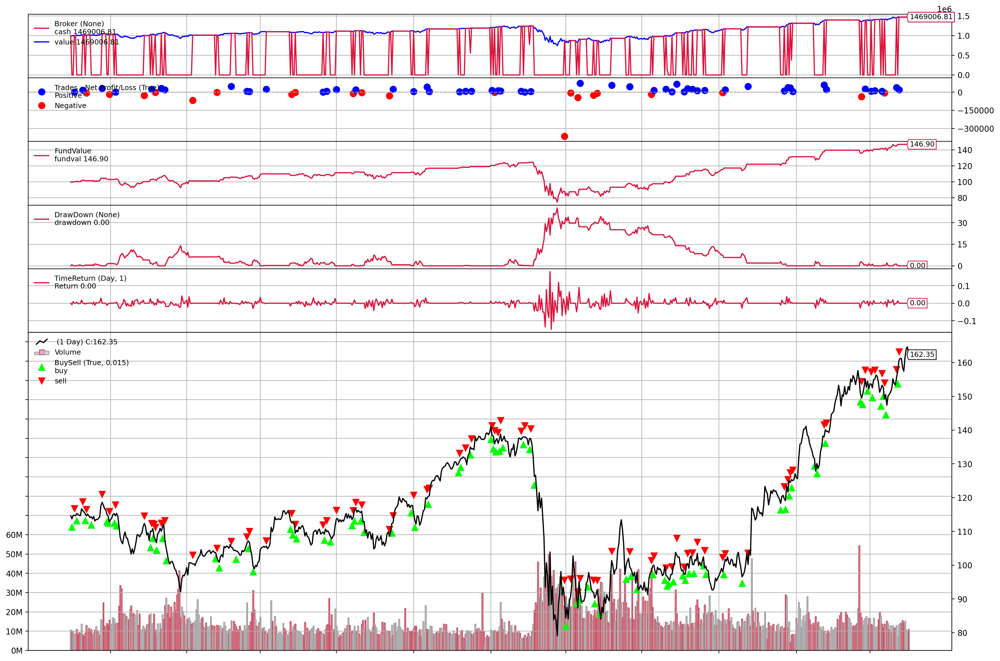

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### JNJ

In [ ]:
jnj_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/JNJ.csv', index_col=0, parse_dates=True)
jnj_data.dropna(inplace=True)
time_data = jnj_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(jnj_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=jnj_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.006799291978245195
2018-08-13T00:00:00, 
Today's price =  130.220001
Predicted price =  129.79188616012166
Current f :  1
2018-08-14T00:00:00, BUY EXECUTED, Price: 130.22, Cost: 999959.39, Comm 0.00
2018-08-14T00:00:00, 
Today's price =  129.5
Predicted price =  130.8327495053461
Current f :  1
2018-08-15T00:00:00, 
Today's price =  130.429993
Predicted price =  131.51449234043483
Current f :  1
2018-08-16T00:00:00, 
Today's price =  132.479996
Predicted price =  131.96609793491453
Current f :  1
2018-08-17T00:00:00, 
Today's price =  134.470001
Predicted price =  132.06862276371052
Current f :  0
2018-08-20T00:00:00, SELL EXECUTED, Price: 134.47, Cost: 999959.39, Comm 0.00
2018-08-20T00:00:00, 
Today's price =  136.880005
Predicted price =  130.31548566416646
Current f :  0
2018-08-21T00:00:00, 
Today's price =  135.350006
Predicted price =  130.73460731949456
Current f :  0
2018-08-22T00:00:00, 
Today's price =  134.610001
Predicted price =  1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2018-09-11T00:00:00, 
Today's price =  138.509995
Predicted price =  134.38068804327452
Current f :  0
2018-09-12T00:00:00, 
Today's price =  139.360001
Predicted price =  135.4293853247637
Current f :  0
2018-09-13T00:00:00, 
Today's price =  139.889999
Predicted price =  134.47251740598531
Current f :  0
2018-09-14T00:00:00, 
Today's price =  139.490005
Predicted price =  133.58482429540234
Current f :  0
2018-09-17T00:00:00, 
Today's price =  139.96000700000002
Predicted price =  134.30702704738562
Current f :  0
2018-09-18T00:00:00, 
Today's price =  140.53999299999998
Predicted price =  134.72913777592737
Current f :  0
2018-09-19T00:00:00, 
Today's price =  140.46000700000002
Predicted price =  134.69280636055282
Current f :  0
2018-09-20T00:00:00, 
Today's price =  141.979996
Predicted price =  133.48773419691432
Current f :  0
2018-09-21T00:00:00, 
Today's price =  142.880005
Predicted price =  135.33603148538808
Current f :  0
2018-09-24T00:00:00, 
Today's price =  140.470001


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  133.949997
Predicted price =  138.0262755899646
Current f :  1
2018-10-16T00:00:00, 
Today's price =  136.559998
Predicted price =  137.86300422711386
Current f :  1
2018-10-17T00:00:00, 
Today's price =  139.46000700000002
Predicted price =  139.3788946191462
Current f :  1
2018-10-18T00:00:00, 
Today's price =  139.5
Predicted price =  140.40791769839328
Current f :  0
2018-10-19T00:00:00, SELL EXECUTED, Price: 139.50, Cost: 1041382.68, Comm 0.00
2018-10-19T00:00:00, 
Today's price =  139.050003
Predicted price =  139.26545478361749
Current f :  0
2018-10-22T00:00:00, 
Today's price =  138.679993
Predicted price =  139.3246335872158
Current f :  0
2018-10-23T00:00:00, 
Today's price =  138.929993
Predicted price =  139.06289137024433
Current f :  0
2018-10-24T00:00:00, 
Today's price =  137.470001
Predicted price =  139.43525720648844
Current f :  1
2018-10-25T00:00:00, BUY EXECUTED, Price: 137.47, Cost: 1042297.55, Comm 0.00
2018-10-25T00:00:00, 
Today's price =  1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  140.73627588545708
Current f :  0
2018-11-20T00:00:00, 
Today's price =  146.449997
Predicted price =  139.99019887367504
Current f :  0
2018-11-21T00:00:00, 
Today's price =  141.990005
Predicted price =  141.70031897704922
Current f :  1
2018-11-23T00:00:00, BUY EXECUTED, Price: 141.99, Cost: 1061233.30, Comm 0.00
2018-11-23T00:00:00, 
Today's price =  142.229996
Predicted price =  142.02409501345466
Current f :  1
2018-11-26T00:00:00, 
Today's price =  141.369995
Predicted price =  144.12367277065516
Current f :  1
2018-11-27T00:00:00, 
Today's price =  143.220001
Predicted price =  144.39786409602607
Current f :  1
2018-11-28T00:00:00, 
Today's price =  146.440002
Predicted price =  144.46747584592416
Current f :  0
2018-11-29T00:00:00, SELL EXECUTED, Price: 146.44, Cost: 1061233.30, Comm 0.00
2018-11-29T00:00:00, 
Today's price =  145.850006
Predicted price =  144.7487563240746
Current f :  0
2018-11-30T00:00:00, 
Today's price =  146.899994
Predicted price =  1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2018-12-26T00:00:00, 
Today's price =  126.709999
Predicted price =  144.7196048198685
Current f :  1
2018-12-27T00:00:00, 
Today's price =  127.410004
Predicted price =  144.6909011986765
Current f :  1
2018-12-28T00:00:00, 
Today's price =  127.269997
Predicted price =  146.2929978228854
Current f :  1
2018-12-31T00:00:00, 
Today's price =  129.050003
Predicted price =  147.25644095910798
Current f :  1
2019-01-02T00:00:00, 
Today's price =  127.75
Predicted price =  147.7510592365238
Current f :  1
2019-01-03T00:00:00, 
Today's price =  125.720001
Predicted price =  133.63552831242197
Current f :  1
2019-01-04T00:00:00, 
Today's price =  127.83000200000001
Predicted price =  129.53689083505145
Current f :  1
2019-01-07T00:00:00, 
Today's price =  127.010002
Predicted price =  131.08906302575468
Current f :  1
2019-01-08T00:00:00, 
Today's price =  129.96000700000002
Predicted price =  129.73740544532967
Current f :  1
2019-01-09T00:00:00, 
Today's price =  128.929993
Predicted pr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  130.330002
Predicted price =  131.13434468589895
Current f :  0
2019-01-30T00:00:00, SELL EXECUTED, Price: 130.33, Cost: 1086170.43, Comm 0.00
2019-01-30T00:00:00, 
Today's price =  131.639999
Predicted price =  130.58826493717015
Current f :  0
2019-01-31T00:00:00, 
Today's price =  133.080002
Predicted price =  128.88301468007379
Current f :  0
2019-02-01T00:00:00, 
Today's price =  134.199997
Predicted price =  129.63806210224428
Current f :  0
2019-02-04T00:00:00, 
Today's price =  132.880005
Predicted price =  128.19632456559168
Current f :  0
2019-02-05T00:00:00, 
Today's price =  132.880005
Predicted price =  129.65404699089098
Current f :  0
2019-02-06T00:00:00, 
Today's price =  133.0
Predicted price =  130.66666938128753
Current f :  0
2019-02-07T00:00:00, 
Today's price =  132.050003
Predicted price =  128.8824158094257
Current f :  0
2019-02-08T00:00:00, 
Today's price =  132.399994
Predicted price =  129.01260540056006
Current f :  0
2019-02-11T00:00:00, 


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-03-07T00:00:00, 
Today's price =  138.240005
Predicted price =  135.13536747752292
Current f :  0
2019-03-08T00:00:00, 
Today's price =  138.059998
Predicted price =  135.52251429413275
Current f :  0
2019-03-11T00:00:00, 
Today's price =  138.559998
Predicted price =  134.7225652599861
Current f :  0
2019-03-12T00:00:00, 
Today's price =  139.179993
Predicted price =  136.05178748562338
Current f :  0
2019-03-13T00:00:00, 
Today's price =  139.41000400000001
Predicted price =  135.63904280184926
Current f :  0
2019-03-14T00:00:00, 
Today's price =  138.020004
Predicted price =  135.57626362806727
Current f :  0
2019-03-15T00:00:00, 
Today's price =  137.600006
Predicted price =  135.37318732188436
Current f :  0
2019-03-18T00:00:00, 
Today's price =  137.169998
Predicted price =  136.23278588872566
Current f :  0
2019-03-19T00:00:00, 
Today's price =  138.440002
Predicted price =  137.79314532558618
Current f :  1
2019-03-20T00:00:00, BUY EXECUTED, Price: 138.44, Cost: 1099075.18

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  135.580002
Predicted price =  136.7662823583605
Current f :  1
2019-04-11T00:00:00, 
Today's price =  135.21000700000002
Predicted price =  138.6857333117058
Current f :  1
2019-04-12T00:00:00, 
Today's price =  135.979996
Predicted price =  138.90903091989549
Current f :  1
2019-04-15T00:00:00, 
Today's price =  136.520004
Predicted price =  139.0038923154705
Current f :  1
2019-04-16T00:00:00, 
Today's price =  138.020004
Predicted price =  139.47210724920967
Current f :  1
2019-04-17T00:00:00, 
Today's price =  138.520004
Predicted price =  138.9981395049101
Current f :  0
2019-04-18T00:00:00, SELL EXECUTED, Price: 138.52, Cost: 1111870.60, Comm 0.00
2019-04-18T00:00:00, 
Today's price =  137.520004
Predicted price =  137.83691981377575
Current f :  0
2019-04-22T00:00:00, 
Today's price =  137.830002
Predicted price =  137.2206851261229
Current f :  1
2019-04-23T00:00:00, BUY EXECUTED, Price: 137.83, Cost: 1118352.64, Comm 0.00
2019-04-23T00:00:00, 
Today's price = 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  136.820007
Predicted price =  139.86235477534638
Current f :  1
2019-05-15T00:00:00, 
Today's price =  136.91000400000001
Predicted price =  139.53454341354075
Current f :  1
2019-05-16T00:00:00, 
Today's price =  138.21000700000002
Predicted price =  140.87900712209782
Current f :  1
2019-05-17T00:00:00, 
Today's price =  138.610001
Predicted price =  141.3283743452253
Current f :  1
2019-05-20T00:00:00, 
Today's price =  138.419998
Predicted price =  140.87875512238995
Current f :  1
2019-05-21T00:00:00, 
Today's price =  138.119995
Predicted price =  141.25147042881403
Current f :  1
2019-05-22T00:00:00, 
Today's price =  138.759995
Predicted price =  141.27090803016213
Current f :  1
2019-05-23T00:00:00, 
Today's price =  139.78999299999998
Predicted price =  139.61083013753552
Current f :  1
2019-05-24T00:00:00, 
Today's price =  138.850006
Predicted price =  139.33321054750385
Current f :  0
2019-05-28T00:00:00, SELL EXECUTED, Price: 138.85, Cost: 1137799.58, Com

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 140.08999599999999
Predicted price =  131.71642534024568
Current f :  0
2019-06-17T00:00:00, 
Today's price =  139.440002
Predicted price =  132.64580826543678
Current f :  0
2019-06-18T00:00:00, 
Today's price =  140.229996
Predicted price =  132.1805406590802
Current f :  0
2019-06-19T00:00:00, 
Today's price =  140.449997
Predicted price =  132.7781351703307
Current f :  0
2019-06-20T00:00:00, 
Today's price =  142.21000700000002
Predicted price =  134.74031078834668
Current f :  0
2019-06-21T00:00:00, 
Today's price =  142.08999599999999
Predicted price =  135.17094898019454
Current f :  0
2019-06-24T00:00:00, 
Today's price =  143.059998
Predicted price =  137.8611543570743
Current f :  0
2019-06-25T00:00:00, 
Today's price =  144.240005
Predicted price =  139.27860402210032
Current f :  0
2019-06-26T00:00:00, 
Today's price =  141.850006
Predicted price =  139.64747562265606
Current f :  0
2019-06-27T00:00:00, 
Today's price =  140.690002
Predicted price =  139.600740447625
Curr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  128.639999
Predicted price =  141.99898204863447
Current f :  1
2019-07-23T00:00:00, 
Today's price =  128.83999599999999
Predicted price =  140.5723804003519
Current f :  1
2019-07-24T00:00:00, 
Today's price =  129.779999
Predicted price =  140.79086638711132
Current f :  1
2019-07-25T00:00:00, 
Today's price =  131.119995
Predicted price =  141.24599343666975
Current f :  1
2019-07-26T00:00:00, 
Today's price =  130.729996
Predicted price =  141.2216394526422
Current f :  1
2019-07-29T00:00:00, 
Today's price =  133.020004
Predicted price =  140.24428796826217
Current f :  1
2019-07-30T00:00:00, 
Today's price =  132.080002
Predicted price =  134.30331655726715
Current f :  1
2019-07-31T00:00:00, 
Today's price =  130.220001
Predicted price =  134.96912135349993
Current f :  1
2019-08-01T00:00:00, 
Today's price =  130.28999299999998
Predicted price =  133.28963769748202
Current f :  1
2019-08-02T00:00:00, 
Today's price =  131.070007
Predicted price =  133.45823200

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 127.730003
Predicted price =  130.79819097085942
Current f :  1
2019-08-26T00:00:00, BUY EXECUTED, Price: 127.73, Cost: 1134753.35, Comm 0.00
2019-08-26T00:00:00, 
Today's price =  127.800003
Predicted price =  132.4343098090086
Current f :  1
2019-08-27T00:00:00, 
Today's price =  129.639999
Predicted price =  132.475009051168
Current f :  1
2019-08-28T00:00:00, 
Today's price =  128.679993
Predicted price =  132.2631620728406
Current f :  1
2019-08-29T00:00:00, 
Today's price =  128.240005
Predicted price =  133.6497955967711
Current f :  1
2019-08-30T00:00:00, 
Today's price =  128.360001
Predicted price =  130.28342042314264
Current f :  1
2019-09-03T00:00:00, 
Today's price =  128.740005
Predicted price =  130.51335114159332
Current f :  1
2019-09-04T00:00:00, 
Today's price =  128.860001
Predicted price =  131.27881166115125
Current f :  1
2019-09-05T00:00:00, 
Today's price =  128.580002
Predicted price =  132.5440216405968
Current f :  1
2019-09-06T00:00:00, 
Today's price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  129.70185107287824
Current f :  [0.97505541]
2019-09-27T00:00:00, BUY EXECUTED, Price: 128.85, Cost: 1150888.25, Comm 0.00
2019-09-27T00:00:00, 
Today's price =  128.600006
Predicted price =  131.65895597204275
Current f :  1
2019-09-30T00:00:00, BUY EXECUTED, Price: 128.60, Cost: 29320.80, Comm 0.00
2019-09-30T00:00:00, 
Today's price =  129.380005
Predicted price =  131.11993015915309
Current f :  1
2019-10-01T00:00:00, 
Today's price =  129.990005
Predicted price =  130.95503299386465
Current f :  1
2019-10-02T00:00:00, 
Today's price =  132.0
Predicted price =  129.39006486030507
Current f :  0
2019-10-03T00:00:00, SELL EXECUTED, Price: 132.00, Cost: 1180209.05, Comm 0.00
2019-10-03T00:00:00, 
Today's price =  131.190002
Predicted price =  129.8311241756228
Current f :  0
2019-10-04T00:00:00, 
Today's price =  133.66000400000001
Predicted price =  130.56082946855577
Current f :  0
2019-10-07T00:00:00, 
Today's price =  133.16000400000001
Predicted price =  130.0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  129.119995
Predicted price =  131.22968953473395
Current f :  1
2019-10-30T00:00:00, 
Today's price =  132.83999599999999
Predicted price =  131.06469972117793
Current f :  0
2019-10-31T00:00:00, SELL EXECUTED, Price: 132.84, Cost: 1204990.97, Comm 0.00
2019-10-31T00:00:00, 
Today's price =  132.03999299999998
Predicted price =  133.1076793673696
Current f :  1
2019-11-01T00:00:00, BUY EXECUTED, Price: 132.04, Cost: 1239195.33, Comm 0.00
2019-11-01T00:00:00, 
Today's price =  131.199997
Predicted price =  135.0254793261048
Current f :  1
2019-11-04T00:00:00, 
Today's price =  130.229996
Predicted price =  136.03723911194933
Current f :  1
2019-11-05T00:00:00, 
Today's price =  130.419998
Predicted price =  127.85703980081031
Current f :  0
2019-11-06T00:00:00, SELL EXECUTED, Price: 130.42, Cost: 1239195.33, Comm 0.00
2019-11-06T00:00:00, 
Today's price =  130.96000700000002
Predicted price =  127.84634151549183
Current f :  0
2019-11-07T00:00:00, 
Today's price =  131.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  137.490005
Predicted price =  131.8988024561254
Current f :  0
2019-12-02T00:00:00, 
Today's price =  137.360001
Predicted price =  131.00756014157477
Current f :  0
2019-12-03T00:00:00, 
Today's price =  137.16000400000001
Predicted price =  130.84395931480267
Current f :  0
2019-12-04T00:00:00, 
Today's price =  139.380005
Predicted price =  134.36720423544472
Current f :  0
2019-12-05T00:00:00, 
Today's price =  139.559998
Predicted price =  134.6402204491708
Current f :  0
2019-12-06T00:00:00, 
Today's price =  140.380005
Predicted price =  134.71620362865613
Current f :  0
2019-12-09T00:00:00, 
Today's price =  140.5
Predicted price =  135.39264688507933
Current f :  0
2019-12-10T00:00:00, 
Today's price =  139.990005
Predicted price =  135.92711716270588
Current f :  0
2019-12-11T00:00:00, 
Today's price =  140.979996
Predicted price =  137.37125814572462
Current f :  0
2019-12-12T00:00:00, 
Today's price =  141.33999599999999
Predicted price =  136.4842617792194

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-01-07T00:00:00, 
Today's price =  144.979996
Predicted price =  142.37694777208284
Current f :  0
2020-01-08T00:00:00, 
Today's price =  144.96000700000002
Predicted price =  144.71921922710393
Current f :  1
2020-01-09T00:00:00, BUY EXECUTED, Price: 144.96, Cost: 1223897.34, Comm 0.00
2020-01-09T00:00:00, 
Today's price =  145.389999
Predicted price =  145.02737595618083
Current f :  1
2020-01-10T00:00:00, 
Today's price =  145.059998
Predicted price =  145.3164322267045
Current f :  0
2020-01-13T00:00:00, SELL EXECUTED, Price: 145.06, Cost: 1223897.34, Comm 0.00
2020-01-13T00:00:00, 
Today's price =  145.699997
Predicted price =  144.79454981377486
Current f :  1
2020-01-14T00:00:00, BUY EXECUTED, Price: 145.70, Cost: 1224754.17, Comm 0.00
2020-01-14T00:00:00, 
Today's price =  146.520004
Predicted price =  144.6631826221512
Current f :  0
2020-01-15T00:00:00, SELL EXECUTED, Price: 146.52, Cost: 1224754.17, Comm 0.00
2020-01-15T00:00:00, 
Today's price =  147.009995
Predicted

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-02-07T00:00:00, 
Today's price =  151.889999
Predicted price =  147.7629110358811
Current f :  0
2020-02-10T00:00:00, 
Today's price =  151.860001
Predicted price =  148.01556176627705
Current f :  0
2020-02-11T00:00:00, 
Today's price =  151.990005
Predicted price =  147.76605081216223
Current f :  0
2020-02-12T00:00:00, 
Today's price =  151.08999599999999
Predicted price =  148.124556603861
Current f :  0
2020-02-13T00:00:00, 
Today's price =  150.08999599999999
Predicted price =  148.88379527281154
Current f :  0
2020-02-14T00:00:00, 
Today's price =  150.130005
Predicted price =  150.02472686416186
Current f :  1
2020-02-18T00:00:00, BUY EXECUTED, Price: 150.13, Cost: 1231666.56, Comm 0.00
2020-02-18T00:00:00, 
Today's price =  149.139999
Predicted price =  149.8460000317716
Current f :  0
2020-02-19T00:00:00, SELL EXECUTED, Price: 149.14, Cost: 1231666.56, Comm 0.00
2020-02-19T00:00:00, 
Today's price =  148.940002
Predicted price =  148.29061607064128
Current f :  1
2020

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 131.800003
Predicted price =  146.08449660609458
Current f :  1
2020-03-12T00:00:00, 
Today's price =  125.410004
Predicted price =  144.94569327833818
Current f :  1
2020-03-13T00:00:00, 
Today's price =  134.28999299999998
Predicted price =  144.3786650909691
Current f :  1
2020-03-16T00:00:00, 
Today's price =  127.129997
Predicted price =  140.36389335338362
Current f :  1
2020-03-17T00:00:00, 
Today's price =  136.58999599999999
Predicted price =  136.02706569415366
Current f :  1
2020-03-18T00:00:00, 
Today's price =  134.96000700000002
Predicted price =  141.0122840577862
Current f :  1
2020-03-19T00:00:00, 
Today's price =  127.050003
Predicted price =  138.01221902409156
Current f :  1
2020-03-20T00:00:00, 
Today's price =  119.889999
Predicted price =  145.4504682902972
Current f :  1
2020-03-23T00:00:00, 
Today's price =  111.139999
Predicted price =  143.63314824647696
Current f :  1
2020-03-24T00:00:00, 
Today's price =  119.18
Predicted price =  143.7705410356508
Current

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-04-16T00:00:00, 
Today's price =  149.669998
Predicted price =  136.36070413072528
Current f :  0
2020-04-17T00:00:00, 
Today's price =  152.020004
Predicted price =  133.3213173403814
Current f :  0
2020-04-20T00:00:00, 
Today's price =  151.669998
Predicted price =  130.58522829510034
Current f :  0
2020-04-21T00:00:00, 
Today's price =  149.679993
Predicted price =  132.61483555312483
Current f :  0
2020-04-22T00:00:00, 
Today's price =  152.990005
Predicted price =  133.11677498018415
Current f :  0
2020-04-23T00:00:00, 
Today's price =  155.509995
Predicted price =  139.46751523245243
Current f :  0
2020-04-24T00:00:00, 
Today's price =  154.860001
Predicted price =  136.60842575326868
Current f :  0
2020-04-27T00:00:00, 
Today's price =  154.28999299999998
Predicted price =  143.65020145055172
Current f :  0
2020-04-28T00:00:00, 
Today's price =  151.389999
Predicted price =  139.16254428918745
Current f :  0
2020-04-29T00:00:00, 
Today's price =  150.240005
Predicted price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-05-19T00:00:00, 
Today's price =  149.020004
Predicted price =  147.04801612979134
Current f :  0
2020-05-20T00:00:00, 
Today's price =  147.679993
Predicted price =  146.6161971094439
Current f :  0
2020-05-21T00:00:00, 
Today's price =  146.71000700000002
Predicted price =  148.48669649622187
Current f :  1
2020-05-22T00:00:00, BUY EXECUTED, Price: 146.71, Cost: 1154314.34, Comm 0.00
2020-05-22T00:00:00, 
Today's price =  144.369995
Predicted price =  147.63303647805276
Current f :  1
2020-05-26T00:00:00, 
Today's price =  144.559998
Predicted price =  147.51147324763636
Current f :  1
2020-05-27T00:00:00, 
Today's price =  144.889999
Predicted price =  148.8106102552133
Current f :  1
2020-05-28T00:00:00, 
Today's price =  146.970001
Predicted price =  148.83638709716246
Current f :  1
2020-05-29T00:00:00, 
Today's price =  148.75
Predicted price =  147.30705220660883
Current f :  0
2020-06-01T00:00:00, SELL EXECUTED, Price: 148.75, Cost: 1154314.34, Comm 0.00
2020-06-01T00:00:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 143.389999
Predicted price =  146.64536447729478
Current f :  1
2020-06-23T00:00:00, 
Today's price =  142.860001
Predicted price =  147.24200993884244
Current f :  1
2020-06-24T00:00:00, 
Today's price =  139.820007
Predicted price =  146.76332740207988
Current f :  1
2020-06-25T00:00:00, 
Today's price =  139.669998
Predicted price =  146.13861322129958
Current f :  1
2020-06-26T00:00:00, 
Today's price =  137.809998
Predicted price =  147.72171729118534
Current f :  1
2020-06-29T00:00:00, 
Today's price =  139.03999299999998
Predicted price =  141.626748264817
Current f :  1
2020-06-30T00:00:00, 
Today's price =  140.630005
Predicted price =  142.7333828448608
Current f :  1
2020-07-01T00:00:00, 
Today's price =  140.380005
Predicted price =  141.53002967141683
Current f :  1
2020-07-02T00:00:00, 
Today's price =  140.970001
Predicted price =  144.90891605415345
Current f :  1
2020-07-06T00:00:00, 
Today's price =  142.979996
Predicted price =  144.79094695629436
Current f :  1
202

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-09-04T00:00:00, 
Today's price =  148.58999599999999
Predicted price =  150.25622695078346
Current f :  1
2020-09-08T00:00:00, BUY EXECUTED, Price: 148.59, Cost: 1221261.18, Comm 0.00
2020-09-08T00:00:00, 
Today's price =  147.259995
Predicted price =  150.90846230677397
Current f :  1
2020-09-09T00:00:00, 
Today's price =  149.699997
Predicted price =  152.1415272923355
Current f :  1
2020-09-10T00:00:00, 
Today's price =  146.91000400000001
Predicted price =  151.57113996898013
Current f :  1
2020-09-11T00:00:00, 
Today's price =  147.779999
Predicted price =  151.5152121850326
Current f :  1
2020-09-14T00:00:00, 
Today's price =  148.350006
Predicted price =  151.38008612948343
Current f :  1
2020-09-15T00:00:00, 
Today's price =  148.889999
Predicted price =  152.3885052417902
Current f :  1
2020-09-16T00:00:00, 
Today's price =  148.399994
Predicted price =  152.69625002657693
Current f :  1
2020-09-17T00:00:00, 
Today's price =  147.169998
Predicted price =  152.607488301660

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  145.08419518252944
Current f :  0
2020-10-12T00:00:00, 
Today's price =  151.83999599999999
Predicted price =  145.82152515928993
Current f :  0
2020-10-13T00:00:00, 
Today's price =  148.360001
Predicted price =  146.48972030816304
Current f :  0
2020-10-14T00:00:00, 
Today's price =  148.100006
Predicted price =  147.47519049212008
Current f :  1
2020-10-15T00:00:00, BUY EXECUTED, Price: 148.10, Cost: 1215752.95, Comm 0.00
2020-10-15T00:00:00, 
Today's price =  147.190002
Predicted price =  148.07750634557436
Current f :  0
2020-10-16T00:00:00, SELL EXECUTED, Price: 147.19, Cost: 1215752.95, Comm 0.00
2020-10-16T00:00:00, 
Today's price =  148.100006
Predicted price =  149.1734869837169
Current f :  1
2020-10-19T00:00:00, BUY EXECUTED, Price: 148.10, Cost: 1208347.95, Comm 0.00
2020-10-19T00:00:00, 
Today's price =  144.320007
Predicted price =  147.68548287277287
Current f :  1
2020-10-20T00:00:00, 
Today's price =  144.550003
Predicted price =  146.2649465119846

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  148.279999
Predicted price =  145.84361393811238
Current f :  0
2020-11-11T00:00:00, SELL EXECUTED, Price: 148.28, Cost: 1208347.95, Comm 0.00
2020-11-11T00:00:00, 
Today's price =  147.800003
Predicted price =  144.55919317350546
Current f :  0
2020-11-12T00:00:00, 
Today's price =  148.300003
Predicted price =  143.54426666058598
Current f :  0
2020-11-13T00:00:00, 
Today's price =  149.899994
Predicted price =  138.71488319754272
Current f :  0
2020-11-16T00:00:00, 
Today's price =  150.850006
Predicted price =  138.45030241128094
Current f :  0
2020-11-17T00:00:00, 
Today's price =  149.350006
Predicted price =  138.32371074045432
Current f :  0
2020-11-18T00:00:00, 
Today's price =  147.369995
Predicted price =  140.31533964667344
Current f :  0
2020-11-19T00:00:00, 
Today's price =  147.139999
Predicted price =  139.74273285108887
Current f :  0
2020-11-20T00:00:00, 
Today's price =  146.360001
Predicted price =  140.79926477566443
Current f :  0
2020-11-23T00:00

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  147.56228451925588
Current f :  0
2020-12-18T00:00:00, 
Today's price =  154.509995
Predicted price =  148.03047775300877
Current f :  0
2020-12-21T00:00:00, 
Today's price =  153.020004
Predicted price =  148.4962633445048
Current f :  0
2020-12-22T00:00:00, 
Today's price =  152.720001
Predicted price =  149.7664779545538
Current f :  0
2020-12-23T00:00:00, 
Today's price =  151.940002
Predicted price =  148.81287768712625
Current f :  0
2020-12-24T00:00:00, 
Today's price =  152.470001
Predicted price =  151.01079385869366
Current f :  0
2020-12-28T00:00:00, 
Today's price =  153.190002
Predicted price =  152.00727241809514
Current f :  0
2020-12-29T00:00:00, 
Today's price =  154.139999
Predicted price =  151.5344184755069
Current f :  0
2020-12-30T00:00:00, 
Today's price =  156.050003
Predicted price =  152.14679410710787
Current f :  0
2020-12-31T00:00:00, 
Today's price =  157.380005
Predicted price =  148.34194864581264
Current f :  0
2021-01-04T00:00:00, 


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  170.479996
Predicted price =  158.8986884064094
Current f :  0
2021-01-27T00:00:00, 
Today's price =  167.880005
Predicted price =  158.85763818916055
Current f :  0
2021-01-28T00:00:00, 
Today's price =  169.16000400000001
Predicted price =  157.8862849926749
Current f :  0
2021-01-29T00:00:00, 
Today's price =  163.130005
Predicted price =  157.16987371006744
Current f :  0
2021-02-01T00:00:00, 
Today's price =  162.71000700000002
Predicted price =  156.64055433327678
Current f :  0
2021-02-02T00:00:00, 
Today's price =  161.25
Predicted price =  159.63460018181954
Current f :  0
2021-02-03T00:00:00, 
Today's price =  160.5
Predicted price =  159.47932452735384
Current f :  1
2021-02-04T00:00:00, BUY EXECUTED, Price: 160.50, Cost: 1257678.00, Comm 0.00
2021-02-04T00:00:00, 
Today's price =  161.990005
Predicted price =  161.59453326150557
Current f :  1
2021-02-05T00:00:00, 
Today's price =  164.449997
Predicted price =  161.04393565860377
Current f :  0
2021-02-08T0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  156.220001
Predicted price =  165.8277109825873
Current f :  1
2021-03-04T00:00:00, 
Today's price =  153.070007
Predicted price =  164.21638668759653
Current f :  1
2021-03-05T00:00:00, 
Today's price =  156.100006
Predicted price =  165.16602265455168
Current f :  1
2021-03-08T00:00:00, 
Today's price =  157.399994
Predicted price =  165.30073262123307
Current f :  1
2021-03-09T00:00:00, 
Today's price =  157.699997
Predicted price =  162.70465242341865
Current f :  1
2021-03-10T00:00:00, 
Today's price =  159.149994
Predicted price =  162.0288290884176
Current f :  1
2021-03-11T00:00:00, 
Today's price =  159.139999
Predicted price =  160.2748968897055
Current f :  1
2021-03-12T00:00:00, 
Today's price =  159.600006
Predicted price =  162.76119572960755
Current f :  1
2021-03-15T00:00:00, 
Today's price =  160.419998
Predicted price =  162.56366463811304
Current f :  1
2021-03-16T00:00:00, 
Today's price =  161.369995
Predicted price =  158.9834942677154
Current f :

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  163.389999
Predicted price =  160.1586541767562
Current f :  0
2021-04-07T00:00:00, 
Today's price =  163.610001
Predicted price =  159.50392080306483
Current f :  0
2021-04-08T00:00:00, 
Today's price =  162.970001
Predicted price =  160.65364309596208
Current f :  0
2021-04-09T00:00:00, 
Today's price =  161.25
Predicted price =  160.50684945774339
Current f :  1
2021-04-12T00:00:00, BUY EXECUTED, Price: 161.25, Cost: 1277261.25, Comm 0.00
2021-04-12T00:00:00, 
Today's price =  161.639999
Predicted price =  161.12879440283672
Current f :  1
2021-04-13T00:00:00, 
Today's price =  159.479996
Predicted price =  161.28095336714384
Current f :  1
2021-04-14T00:00:00, 
Today's price =  159.919998
Predicted price =  164.15138347666115
Current f :  1
2021-04-15T00:00:00, 
Today's price =  160.389999
Predicted price =  165.39994523388197
Current f :  1
2021-04-16T00:00:00, 
Today's price =  162.240005
Predicted price =  164.1025904381787
Current f :  1
2021-04-19T00:00:00, 


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  162.9036900248
Current f :  0
2021-05-06T00:00:00, 
Today's price =  167.740005
Predicted price =  166.52798789013974
Current f :  0
2021-05-07T00:00:00, 
Today's price =  168.5
Predicted price =  166.37769435846016
Current f :  0
2021-05-10T00:00:00, 
Today's price =  170.270004
Predicted price =  164.8320210741531
Current f :  0
2021-05-11T00:00:00, 
Today's price =  168.880005
Predicted price =  164.80760585438944
Current f :  0
2021-05-12T00:00:00, 
Today's price =  168.199997
Predicted price =  163.33567710111933
Current f :  0
2021-05-13T00:00:00, 
Today's price =  169.96000700000002
Predicted price =  162.82970442532124
Current f :  0
2021-05-14T00:00:00, 
Today's price =  170.220001
Predicted price =  161.25762436188603
Current f :  0
2021-05-17T00:00:00, 
Today's price =  170.389999
Predicted price =  163.78707144260076
Current f :  0
2021-05-18T00:00:00, 
Today's price =  170.449997
Predicted price =  162.628970115572
Current f :  0
Final Portfolio Value: 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

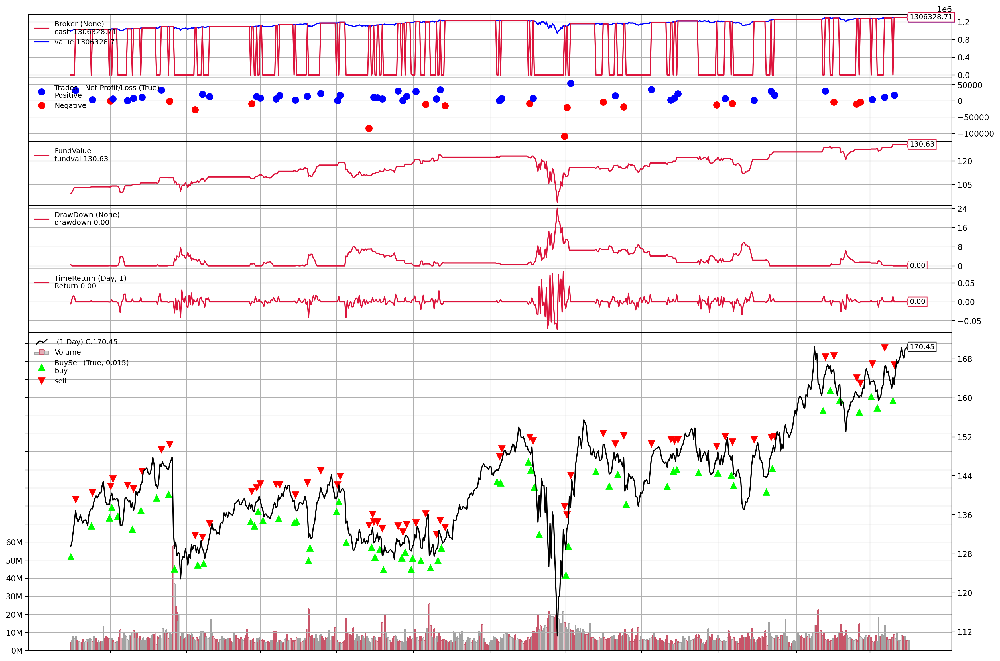

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### SPY

In [ ]:
spy_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/SPY.csv', index_col=0, parse_dates=True)
spy_data.dropna(inplace=True)
time_data = spy_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(spy_data))
train_len

1761

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=spy_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.006178456100834046
2018-08-13T00:00:00, 
Today's price =  282.100006
Predicted price =  283.23075892540373
Current f :  0
2018-08-14T00:00:00, 
Today's price =  283.899994
Predicted price =  281.38274141376166
Current f :  0
2018-08-15T00:00:00, 
Today's price =  281.77999900000003
Predicted price =  280.31355289360476
Current f :  1
2018-08-16T00:00:00, BUY EXECUTED, Price: 281.78, Cost: 999755.44, Comm 0.00
2018-08-16T00:00:00, 
Today's price =  284.059998
Predicted price =  281.323914906313
Current f :  0
2018-08-17T00:00:00, SELL EXECUTED, Price: 284.06, Cost: 999755.44, Comm 0.00
2018-08-17T00:00:00, 
Today's price =  285.059998
Predicted price =  281.2877368501747
Current f :  0
2018-08-20T00:00:00, 
Today's price =  285.670013
Predicted price =  282.60533672911004
Current f :  0
2018-08-21T00:00:00, 
Today's price =  286.339996
Predicted price =  283.0972788795352
Current f :  0
2018-08-22T00:00:00, 
Today's price =  286.170013
Predicted 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  290.309998
Predicted price =  283.3144763629109
Current f :  0
2018-09-04T00:00:00, 
Today's price =  289.809998
Predicted price =  284.8750294772533
Current f :  0
2018-09-05T00:00:00, 
Today's price =  289.02999900000003
Predicted price =  285.5140263365686
Current f :  0
2018-09-06T00:00:00, 
Today's price =  288.160004
Predicted price =  286.2769529363976
Current f :  0
2018-09-07T00:00:00, 
Today's price =  287.600006
Predicted price =  286.73639855076203
Current f :  1
2018-09-10T00:00:00, BUY EXECUTED, Price: 287.60, Cost: 1014077.62, Comm 0.00
2018-09-10T00:00:00, 
Today's price =  288.100006
Predicted price =  286.2045696991198
Current f :  0
2018-09-11T00:00:00, SELL EXECUTED, Price: 288.10, Cost: 1014077.62, Comm 0.00
2018-09-11T00:00:00, 
Today's price =  289.049988
Predicted price =  286.017473955172
Current f :  0
2018-09-12T00:00:00, 
Today's price =  289.119995
Predicted price =  287.8745147121973
Current f :  1
2018-09-13T00:00:00, BUY EXECUTED, Price:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  287.399994
Predicted price =  292.3543956149032
Current f :  1
2018-10-10T00:00:00, 
Today's price =  278.299988
Predicted price =  291.49753032159924
Current f :  1
2018-10-11T00:00:00, 
Today's price =  272.170013
Predicted price =  291.4034068143545
Current f :  1
2018-10-12T00:00:00, 
Today's price =  275.950012
Predicted price =  291.02069707947373
Current f :  1
2018-10-15T00:00:00, 
Today's price =  274.399994
Predicted price =  291.85941632116726
Current f :  1
2018-10-16T00:00:00, 
Today's price =  280.399994
Predicted price =  291.87602373071593
Current f :  1
2018-10-17T00:00:00, 
Today's price =  280.450012
Predicted price =  292.7212938887752
Current f :  1
2018-10-18T00:00:00, 
Today's price =  276.399994
Predicted price =  292.74162410040344
Current f :  1
2018-10-19T00:00:00, 
Today's price =  276.25
Predicted price =  292.84976225496416
Current f :  1
2018-10-22T00:00:00, 
Today's price =  275.01001
Predicted price =  291.0475337970116
Current f :  1
2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2018-11-14T00:00:00, BUY EXECUTED, Price: 272.06, Cost: 1000092.55, Comm 0.00
2018-11-14T00:00:00, 
Today's price =  270.200012
Predicted price =  270.46673950127297
Current f :  0
2018-11-15T00:00:00, SELL EXECUTED, Price: 270.20, Cost: 1000092.55, Comm 0.00
2018-11-15T00:00:00, 
Today's price =  273.019989
Predicted price =  272.3301754246644
Current f :  1
2018-11-16T00:00:00, BUY EXECUTED, Price: 273.02, Cost: 993246.72, Comm 0.00
2018-11-16T00:00:00, 
Today's price =  273.730011
Predicted price =  273.24563249926246
Current f :  1
2018-11-19T00:00:00, 
Today's price =  269.100006
Predicted price =  276.4909313001949
Current f :  1
2018-11-20T00:00:00, 
Today's price =  264.119995
Predicted price =  275.3563622597094
Current f :  1
2018-11-21T00:00:00, 
Today's price =  265.019989
Predicted price =  275.1880499128364
Current f :  1
2018-11-23T00:00:00, 
Today's price =  263.25
Predicted price =  276.68117423994227
Current f :  1
2018-11-26T00:00:00, 
Today's price =  267.5
Predicte

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  251.25999500000003
Predicted price =  274.72513449200324
Current f :  1
2018-12-20T00:00:00, 
Today's price =  247.169998
Predicted price =  277.33424905652225
Current f :  1
2018-12-21T00:00:00, 
Today's price =  240.69999700000002
Predicted price =  271.2164990404243
Current f :  1
2018-12-24T00:00:00, 
Today's price =  234.33999599999999
Predicted price =  271.4628386897475
Current f :  1
2018-12-26T00:00:00, 
Today's price =  246.17999300000002
Predicted price =  266.40201883170437
Current f :  1
2018-12-27T00:00:00, 
Today's price =  248.07000699999998
Predicted price =  267.7374491108736
Current f :  1
2018-12-28T00:00:00, 
Today's price =  247.75
Predicted price =  268.4137336223764
Current f :  1
2018-12-31T00:00:00, 
Today's price =  249.919998
Predicted price =  269.16941739972594
Current f :  1
2019-01-02T00:00:00, 
Today's price =  250.17999300000002
Predicted price =  268.68484326744976
Current f :  1
2019-01-03T00:00:00, 
Today's price =  244.210007
Predi

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  259.53816630391805
Current f :  0
2019-01-29T00:00:00, 
Today's price =  263.410004
Predicted price =  259.7071622054508
Current f :  0
2019-01-30T00:00:00, 
Today's price =  267.579987
Predicted price =  259.59917032407736
Current f :  0
2019-01-31T00:00:00, 
Today's price =  269.929993
Predicted price =  258.9126346607362
Current f :  0
2019-02-01T00:00:00, 
Today's price =  270.059998
Predicted price =  260.56001849905
Current f :  0
2019-02-04T00:00:00, 
Today's price =  271.959991
Predicted price =  261.51644185674866
Current f :  0
2019-02-05T00:00:00, 
Today's price =  273.100006
Predicted price =  264.4395300491585
Current f :  0
2019-02-06T00:00:00, 
Today's price =  272.73999
Predicted price =  265.6820984001005
Current f :  0
2019-02-07T00:00:00, 
Today's price =  270.140015
Predicted price =  262.226974770041
Current f :  0
2019-02-08T00:00:00, 
Today's price =  270.47000099999997
Predicted price =  263.7263153268668
Current f :  0
2019-02-11T00:00:00, 
T

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-03-06T00:00:00, 
Today's price =  277.329987
Predicted price =  275.6104173565287
Current f :  0
2019-03-07T00:00:00, 
Today's price =  275.01001
Predicted price =  276.275643067588
Current f :  0
2019-03-08T00:00:00, 
Today's price =  274.459991
Predicted price =  277.25430198101003
Current f :  1
2019-03-11T00:00:00, BUY EXECUTED, Price: 274.46, Cost: 951827.25, Comm 0.00
2019-03-11T00:00:00, 
Today's price =  278.440002
Predicted price =  276.8837923474656
Current f :  1
2019-03-12T00:00:00, 
Today's price =  279.48999
Predicted price =  277.9633734826725
Current f :  1
2019-03-13T00:00:00, 
Today's price =  281.339996
Predicted price =  278.240753757109
Current f :  0
2019-03-14T00:00:00, SELL EXECUTED, Price: 281.34, Cost: 951827.25, Comm 0.00
2019-03-14T00:00:00, 
Today's price =  281.160004
Predicted price =  278.92804339314546
Current f :  0
2019-03-15T00:00:00, 
Today's price =  281.309998
Predicted price =  278.6790776247449
Current f :  0
2019-03-18T00:00:00, 
Today's p

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-04-09T00:00:00, 
Today's price =  287.309998
Predicted price =  280.6810334108287
Current f :  0
2019-04-10T00:00:00, 
Today's price =  288.290009
Predicted price =  280.5795561948255
Current f :  0
2019-04-11T00:00:00, 
Today's price =  288.209991
Predicted price =  282.06392386750895
Current f :  0
2019-04-12T00:00:00, 
Today's price =  290.160004
Predicted price =  281.22596993865125
Current f :  0
2019-04-15T00:00:00, 
Today's price =  289.97000099999997
Predicted price =  282.0534331192381
Current f :  0
2019-04-16T00:00:00, 
Today's price =  290.160004
Predicted price =  283.11690421683613
Current f :  0
2019-04-17T00:00:00, 
Today's price =  289.450012
Predicted price =  285.66093205453524
Current f :  0
2019-04-18T00:00:00, 
Today's price =  290.019989
Predicted price =  286.0440318781265
Current f :  0
2019-04-22T00:00:00, 
Today's price =  290.269989
Predicted price =  286.37192271868105
Current f :  0
2019-04-23T00:00:00, 
Today's price =  292.880005
Predicted price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

285.059998
Predicted price =  293.39810017387447
Current f :  1
2019-05-16T00:00:00, 
Today's price =  287.700012
Predicted price =  293.42460343225184
Current f :  1
2019-05-17T00:00:00, 
Today's price =  285.839996
Predicted price =  291.72189238691874
Current f :  1
2019-05-20T00:00:00, 
Today's price =  283.950012
Predicted price =  291.5407826578279
Current f :  1
2019-05-21T00:00:00, 
Today's price =  286.51001
Predicted price =  294.27272716906214
Current f :  1
2019-05-22T00:00:00, 
Today's price =  285.630005
Predicted price =  293.6529968198686
Current f :  1
2019-05-23T00:00:00, 
Today's price =  282.140015
Predicted price =  289.73829814831333
Current f :  1
2019-05-24T00:00:00, 
Today's price =  282.77999900000003
Predicted price =  289.13098972235275
Current f :  1
2019-05-28T00:00:00, 
Today's price =  280.149994
Predicted price =  288.8346811489108
Current f :  1
2019-05-29T00:00:00, 
Today's price =  278.269989
Predicted price =  290.39852134990144
Current f :  1
2019-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-06-21T00:00:00, 
Today's price =  294.0
Predicted price =  285.11023089740615
Current f :  0
2019-06-24T00:00:00, 
Today's price =  293.640015
Predicted price =  286.7940796840886
Current f :  0
2019-06-25T00:00:00, 
Today's price =  290.76001
Predicted price =  287.7867294167346
Current f :  0
2019-06-26T00:00:00, 
Today's price =  290.47000099999997
Predicted price =  288.05506131422044
Current f :  0
2019-06-27T00:00:00, 
Today's price =  291.5
Predicted price =  288.9700254603687
Current f :  0
2019-06-28T00:00:00, 
Today's price =  293.0
Predicted price =  289.03034021443364
Current f :  0
2019-07-01T00:00:00, 
Today's price =  295.660004
Predicted price =  289.00635465407595
Current f :  0
2019-07-02T00:00:00, 
Today's price =  296.429993
Predicted price =  288.6074105012003
Current f :  0
2019-07-03T00:00:00, 
Today's price =  298.799988
Predicted price =  289.9931834485807
Current f :  0
2019-07-05T00:00:00, 
Today's price =  298.459991
Predicted price =  292.2244319311621

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-07-24T00:00:00, 
Today's price =  301.440002
Predicted price =  295.79630672876783
Current f :  0
2019-07-25T00:00:00, 
Today's price =  300.0
Predicted price =  296.3071794921325
Current f :  0
2019-07-26T00:00:00, 
Today's price =  302.01001
Predicted price =  297.98107932928497
Current f :  0
2019-07-29T00:00:00, 
Today's price =  301.459991
Predicted price =  299.0672972807779
Current f :  0
2019-07-30T00:00:00, 
Today's price =  300.72000099999997
Predicted price =  300.23547674726217
Current f :  1
2019-07-31T00:00:00, BUY EXECUTED, Price: 300.72, Cost: 1006810.56, Comm 0.00
2019-07-31T00:00:00, 
Today's price =  297.429993
Predicted price =  300.1574689880624
Current f :  1
2019-08-01T00:00:00, 
Today's price =  294.839996
Predicted price =  299.4882508760894
Current f :  1
2019-08-02T00:00:00, 
Today's price =  292.619995
Predicted price =  298.31226819771587
Current f :  1
2019-08-05T00:00:00, 
Today's price =  283.820007
Predicted price =  299.02701800278874
Current f : 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2019-08-23T00:00:00, BUY EXECUTED, Price: 292.36, Cost: 979113.59, Comm 0.00
2019-08-23T00:00:00, 
Today's price =  284.850006
Predicted price =  291.62731442710435
Current f :  1
2019-08-26T00:00:00, 
Today's price =  288.0
Predicted price =  296.03541903414396
Current f :  1
2019-08-27T00:00:00, 
Today's price =  286.869995
Predicted price =  293.868854834663
Current f :  1
2019-08-28T00:00:00, 
Today's price =  288.890015
Predicted price =  290.56508438784556
Current f :  0
2019-08-29T00:00:00, SELL EXECUTED, Price: 288.89, Cost: 979113.59, Comm 0.00
2019-08-29T00:00:00, 
Today's price =  292.579987
Predicted price =  294.20493045191336
Current f :  0
2019-08-30T00:00:00, 
Today's price =  292.450012
Predicted price =  288.07383439795683
Current f :  0
2019-09-03T00:00:00, 
Today's price =  290.73999
Predicted price =  288.48052062634144
Current f :  0
2019-09-04T00:00:00, 
Today's price =  294.040009
Predicted price =  290.95373769769856
Current f :  0
2019-09-05T00:00:00, 
Toda

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-09-26T00:00:00, 
Today's price =  297.0
Predicted price =  296.89031719972775
Current f :  1
2019-09-27T00:00:00, BUY EXECUTED, Price: 297.00, Cost: 959904.00, Comm 0.00
2019-09-27T00:00:00, 
Today's price =  295.399994
Predicted price =  299.55973934580015
Current f :  1
2019-09-30T00:00:00, 
Today's price =  296.769989
Predicted price =  301.4523926205776
Current f :  1
2019-10-01T00:00:00, 
Today's price =  293.23999
Predicted price =  300.47673231885324
Current f :  1
2019-10-02T00:00:00, 
Today's price =  288.059998
Predicted price =  299.1675689580251
Current f :  1
2019-10-03T00:00:00, 
Today's price =  290.420013
Predicted price =  300.0454331082217
Current f :  1
2019-10-04T00:00:00, 
Today's price =  294.350006
Predicted price =  300.7202740225307
Current f :  1
2019-10-07T00:00:00, 
Today's price =  293.079987
Predicted price =  300.9778809543509
Current f :  1
2019-10-08T00:00:00, 
Today's price =  288.52999900000003
Predicted price =  299.21496690842844
Current f :  1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  298.0212018632411
Current f :  0
2019-10-30T00:00:00, 
Today's price =  304.140015
Predicted price =  297.10574636203523
Current f :  0
2019-10-31T00:00:00, 
Today's price =  303.329987
Predicted price =  298.5867781569457
Current f :  0
2019-11-01T00:00:00, 
Today's price =  306.140015
Predicted price =  299.0035141229207
Current f :  0
2019-11-04T00:00:00, 
Today's price =  307.369995
Predicted price =  300.2813225497698
Current f :  0
2019-11-05T00:00:00, 
Today's price =  307.02999900000003
Predicted price =  299.0389930857227
Current f :  0
2019-11-06T00:00:00, 
Today's price =  307.100006
Predicted price =  300.5688418169011
Current f :  0
2019-11-07T00:00:00, 
Today's price =  308.179993
Predicted price =  299.80798182501246
Current f :  0
2019-11-08T00:00:00, 
Today's price =  308.940002
Predicted price =  300.4337665202413
Current f :  0
2019-11-11T00:00:00, 
Today's price =  308.350006
Predicted price =  301.4029464858271
Current f :  0
2019-11-12T00:00:00

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  311.459991
Predicted price =  311.327853439253
Current f :  1
2019-12-05T00:00:00, 
Today's price =  312.019989
Predicted price =  311.33094219362033
Current f :  1
2019-12-06T00:00:00, 
Today's price =  314.869995
Predicted price =  311.30079437351776
Current f :  0
2019-12-09T00:00:00, SELL EXECUTED, Price: 314.87, Cost: 959295.41, Comm 0.00
2019-12-09T00:00:00, 
Today's price =  313.880005
Predicted price =  310.42126202652764
Current f :  0
2019-12-10T00:00:00, 
Today's price =  313.52999900000003
Predicted price =  310.29800925112227
Current f :  0
2019-12-11T00:00:00, 
Today's price =  314.420013
Predicted price =  311.04913724905634
Current f :  0
2019-12-12T00:00:00, 
Today's price =  317.130005
Predicted price =  312.9832550122327
Current f :  0
2019-12-13T00:00:00, 
Today's price =  317.320007
Predicted price =  313.3189081979257
Current f :  0
2019-12-16T00:00:00, 
Today's price =  319.5
Predicted price =  314.67487793392877
Current f :  0
2019-12-17T00:00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  327.950012
Predicted price =  320.9357186743247
Current f :  0
2020-01-14T00:00:00, 
Today's price =  327.450012
Predicted price =  322.4356735024837
Current f :  0
2020-01-15T00:00:00, 
Today's price =  328.190002
Predicted price =  322.5579559641867
Current f :  0
2020-01-16T00:00:00, 
Today's price =  330.920013
Predicted price =  321.5418494737214
Current f :  0
2020-01-17T00:00:00, 
Today's price =  331.950012
Predicted price =  322.0388772479505
Current f :  0
2020-01-21T00:00:00, 
Today's price =  331.299988
Predicted price =  324.5296267843312
Current f :  0
2020-01-22T00:00:00, 
Today's price =  331.339996
Predicted price =  323.02077749189743
Current f :  0
2020-01-23T00:00:00, 
Today's price =  331.72000099999997
Predicted price =  323.41872257548494
Current f :  0
2020-01-24T00:00:00, 
Today's price =  328.769989
Predicted price =  322.18235658225694
Current f :  0
2020-01-27T00:00:00, 
Today's price =  323.5
Predicted price =  324.08599436109546
Current f 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-03-26T00:00:00, 
Today's price =  261.200012
Predicted price =  296.5712551929373
Current f :  1
2020-03-27T00:00:00, 
Today's price =  253.419998
Predicted price =  285.60513065655925
Current f :  1
2020-03-30T00:00:00, 
Today's price =  261.649994
Predicted price =  266.34886018524503
Current f :  1
2020-03-31T00:00:00, 
Today's price =  257.75
Predicted price =  280.5702471903986
Current f :  1
2020-04-01T00:00:00, 
Today's price =  246.149994
Predicted price =  257.0456158108957
Current f :  1
2020-04-02T00:00:00, 
Today's price =  251.830002
Predicted price =  269.8772125834229
Current f :  1
2020-04-03T00:00:00, 
Today's price =  248.190002
Predicted price =  257.29050799388983
Current f :  1
2020-04-06T00:00:00, 
Today's price =  264.859985
Predicted price =  253.91105490107415
Current f :  0
2020-04-07T00:00:00, SELL EXECUTED, Price: 264.86, Cost: 993005.45, Comm 0.00
2020-04-07T00:00:00, 
Today's price =  265.130005
Predicted price =  246.3165810784924
Current f :  0
2020

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  282.790009
Predicted price =  274.7385531217998
Current f :  0
2020-05-04T00:00:00, 
Today's price =  283.570007
Predicted price =  276.65166117641604
Current f :  0
2020-05-05T00:00:00, 
Today's price =  286.190002
Predicted price =  280.2868725373827
Current f :  0
2020-05-06T00:00:00, 
Today's price =  284.25
Predicted price =  279.00423230387287
Current f :  0
2020-05-07T00:00:00, 
Today's price =  287.679993
Predicted price =  272.11963977376956
Current f :  0
2020-05-08T00:00:00, 
Today's price =  292.440002
Predicted price =  275.65154402924543
Current f :  0
2020-05-11T00:00:00, 
Today's price =  292.5
Predicted price =  273.9015787604774
Current f :  0
2020-05-12T00:00:00, 
Today's price =  286.670013
Predicted price =  278.9156847547147
Current f :  0
2020-05-13T00:00:00, 
Today's price =  281.600006
Predicted price =  283.2449483338097
Current f :  0
2020-05-14T00:00:00, 
Today's price =  284.97000099999997
Predicted price =  281.23494368155264
Current f :  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  323.200012
Predicted price =  295.6920807757292
Current f :  0
2020-06-09T00:00:00, 
Today's price =  320.790009
Predicted price =  293.4989626189364
Current f :  0
2020-06-10T00:00:00, 
Today's price =  319.0
Predicted price =  293.35740574290446
Current f :  0
2020-06-11T00:00:00, 
Today's price =  300.609985
Predicted price =  297.2930331224039
Current f :  0
2020-06-12T00:00:00, 
Today's price =  304.209991
Predicted price =  300.36205077258035
Current f :  0
2020-06-15T00:00:00, 
Today's price =  307.049988
Predicted price =  300.1618197278301
Current f :  0
2020-06-16T00:00:00, 
Today's price =  312.959991
Predicted price =  302.40496699854157
Current f :  0
2020-06-17T00:00:00, 
Today's price =  311.660004
Predicted price =  304.0724757373914
Current f :  0
2020-06-18T00:00:00, 
Today's price =  311.77999900000003
Predicted price =  306.2832568558755
Current f :  0
2020-06-19T00:00:00, 
Today's price =  308.640015
Predicted price =  309.27494426782505
Current f 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Current f :  0
2020-07-15T00:00:00, 
Today's price =  321.850006
Predicted price =  302.87722768838944
Current f :  0
2020-07-16T00:00:00, 
Today's price =  320.790009
Predicted price =  307.1901356831331
Current f :  0
2020-07-17T00:00:00, 
Today's price =  321.72000099999997
Predicted price =  309.5818233874736
Current f :  0
2020-07-20T00:00:00, 
Today's price =  324.320007
Predicted price =  310.518856850479
Current f :  0
2020-07-21T00:00:00, 
Today's price =  325.01001
Predicted price =  311.3308247591449
Current f :  0
2020-07-22T00:00:00, 
Today's price =  326.859985
Predicted price =  316.14182069407855
Current f :  0
2020-07-23T00:00:00, 
Today's price =  322.959991
Predicted price =  314.2931341521934
Current f :  0
2020-07-24T00:00:00, 
Today's price =  320.880005
Predicted price =  315.5951553327134
Current f :  0
2020-07-27T00:00:00, 
Today's price =  323.22000099999997
Predicted price =  315.2890747775954
Current f :  0
2020-07-28T00:00:00, 
Today's price =  321.170013
P

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  337.910004
Predicted price =  322.67021484089923
Current f :  0
2020-08-18T00:00:00, 
Today's price =  338.640015
Predicted price =  324.85087498665507
Current f :  0
2020-08-19T00:00:00, 
Today's price =  337.230011
Predicted price =  327.2024454307535
Current f :  0
2020-08-20T00:00:00, 
Today's price =  338.27999900000003
Predicted price =  328.74705189127985
Current f :  0
2020-08-21T00:00:00, 
Today's price =  339.480011
Predicted price =  330.28473723345815
Current f :  0
2020-08-24T00:00:00, 
Today's price =  342.920013
Predicted price =  331.88056784917967
Current f :  0
2020-08-25T00:00:00, 
Today's price =  344.119995
Predicted price =  332.4570543502102
Current f :  0
2020-08-26T00:00:00, 
Today's price =  347.570007
Predicted price =  333.76336849032555
Current f :  0
2020-08-27T00:00:00, 
Today's price =  348.329987
Predicted price =  331.67756158318196
Current f :  0
2020-08-28T00:00:00, 
Today's price =  350.579987
Predicted price =  335.3725185871458
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2020-09-23T00:00:00, 
Today's price =  322.640015
Predicted price =  342.95312070554485
Current f :  1
2020-09-24T00:00:00, 
Today's price =  323.5
Predicted price =  336.32334004855966
Current f :  1
2020-09-25T00:00:00, 
Today's price =  328.730011
Predicted price =  342.2903244638818
Current f :  1
2020-09-28T00:00:00, 
Today's price =  334.190002
Predicted price =  338.0594194056904
Current f :  1
2020-09-29T00:00:00, 
Today's price =  332.369995
Predicted price =  337.2773547247789
Current f :  1
2020-09-30T00:00:00, 
Today's price =  334.890015
Predicted price =  339.50944079249325
Current f :  1
2020-10-01T00:00:00, 
Today's price =  337.040009
Predicted price =  341.72381229451264
Current f :  1
2020-10-02T00:00:00, 
Today's price =  333.839996
Predicted price =  341.01413444996774
Current f :  1
2020-10-05T00:00:00, 
Today's price =  339.76001
Predicted price =  337.41546727586285
Current f :  0
2020-10-06T00:00:00, SELL EXECUTED, Price: 339.76, Cost: 820029.79, Comm 0.00
2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-10-27T00:00:00, BUY EXECUTED, Price: 339.39, Cost: 855262.84, Comm 0.00
2020-10-27T00:00:00, 
Today's price =  338.22000099999997
Predicted price =  345.4148782185748
Current f :  1
2020-10-28T00:00:00, 
Today's price =  326.660004
Predicted price =  350.17281666566214
Current f :  1
2020-10-29T00:00:00, 
Today's price =  329.980011
Predicted price =  347.985837248277
Current f :  1
2020-10-30T00:00:00, 
Today's price =  326.540009
Predicted price =  345.97713293157994
Current f :  1
2020-11-02T00:00:00, 
Today's price =  330.200012
Predicted price =  346.87455643409453
Current f :  1
2020-11-03T00:00:00, 
Today's price =  336.02999900000003
Predicted price =  348.1305964817403
Current f :  1
2020-11-04T00:00:00, 
Today's price =  343.540009
Predicted price =  343.38562583317275
Current f :  1
2020-11-05T00:00:00, 
Today's price =  350.23999
Predicted price =  343.9335327867366
Current f :  0
2020-11-06T00:00:00, SELL EXECUTED, Price: 350.24, Cost: 855262.84, Comm 0.00
2020-11-06T

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-12-03T00:00:00, 
Today's price =  366.690002
Predicted price =  360.3975406036567
Current f :  0
2020-12-04T00:00:00, 
Today's price =  369.850006
Predicted price =  359.6892382713414
Current f :  0
2020-12-07T00:00:00, 
Today's price =  369.089996
Predicted price =  356.12474036536685
Current f :  0
2020-12-08T00:00:00, 
Today's price =  370.170013
Predicted price =  356.6177987604525
Current f :  0
2020-12-09T00:00:00, 
Today's price =  366.850006
Predicted price =  355.5125723212807
Current f :  0
2020-12-10T00:00:00, 
Today's price =  366.730011
Predicted price =  357.61075285580034
Current f :  0
2020-12-11T00:00:00, 
Today's price =  366.299988
Predicted price =  362.1873861455299
Current f :  0
2020-12-14T00:00:00, 
Today's price =  364.660004
Predicted price =  361.12307366228094
Current f :  0
2020-12-15T00:00:00, 
Today's price =  369.589996
Predicted price =  361.78199310253774
Current f :  0
2020-12-16T00:00:00, 
Today's price =  370.170013
Predicted price =  360.10934

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  379.100006
Predicted price =  369.3229582610869
Current f :  0
2021-01-08T00:00:00, SELL EXECUTED, Price: 379.10, Cost: 894533.94, Comm 0.00
2021-01-08T00:00:00, 
Today's price =  381.26001
Predicted price =  368.23079465845944
Current f :  0
2021-01-11T00:00:00, 
Today's price =  378.690002
Predicted price =  367.6067980058424
Current f :  0
2021-01-12T00:00:00, 
Today's price =  378.769989
Predicted price =  368.00654004582816
Current f :  0
2021-01-13T00:00:00, 
Today's price =  379.790009
Predicted price =  368.7535985139789
Current f :  0
2021-01-14T00:00:00, 
Today's price =  378.459991
Predicted price =  371.58704324289306
Current f :  0
2021-01-15T00:00:00, 
Today's price =  375.700012
Predicted price =  371.5937199629361
Current f :  0
2021-01-19T00:00:00, 
Today's price =  378.649994
Predicted price =  371.87501817204316
Current f :  0
2021-01-20T00:00:00, 
Today's price =  383.890015
Predicted price =  373.37631042684484
Current f :  0
2021-01-21T00:00:00, 


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  390.25
Predicted price =  382.7214699921277
Current f :  0
2021-02-10T00:00:00, 
Today's price =  390.079987
Predicted price =  382.79476881884034
Current f :  0
2021-02-11T00:00:00, 
Today's price =  390.709991
Predicted price =  382.4161127374018
Current f :  0
2021-02-12T00:00:00, 
Today's price =  392.640015
Predicted price =  376.26754367467754
Current f :  0
2021-02-16T00:00:00, 
Today's price =  392.299988
Predicted price =  378.51902765806824
Current f :  0
2021-02-17T00:00:00, 
Today's price =  392.390015
Predicted price =  372.46789985998373
Current f :  0
2021-02-18T00:00:00, 
Today's price =  390.72000099999997
Predicted price =  378.12372127356093
Current f :  0
2021-02-19T00:00:00, 
Today's price =  390.02999900000003
Predicted price =  382.058800515753
Current f :  0
2021-02-22T00:00:00, 
Today's price =  387.02999900000003
Predicted price =  382.0360489439357
Current f :  0
2021-02-23T00:00:00, 
Today's price =  387.5
Predicted price =  385.089977679677

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  396.410004
Predicted price =  384.6941050823907
Current f :  0
2021-03-16T00:00:00, SELL EXECUTED, Price: 396.41, Cost: 990666.83, Comm 0.00
2021-03-16T00:00:00, 
Today's price =  395.910004
Predicted price =  383.5666073633041
Current f :  0
2021-03-17T00:00:00, 
Today's price =  397.26001
Predicted price =  390.025964618153
Current f :  0
2021-03-18T00:00:00, 
Today's price =  391.480011
Predicted price =  387.3175476769196
Current f :  0
2021-03-19T00:00:00, 
Today's price =  389.480011
Predicted price =  383.5194742691074
Current f :  0
2021-03-22T00:00:00, 
Today's price =  392.589996
Predicted price =  377.973353059254
Current f :  0
2021-03-23T00:00:00, 
Today's price =  389.5
Predicted price =  383.83299868465474
Current f :  0
2021-03-24T00:00:00, 
Today's price =  387.519989
Predicted price =  384.5726428407427
Current f :  0
2021-03-25T00:00:00, 
Today's price =  389.700012
Predicted price =  388.5195626060506
Current f :  1
2021-03-26T00:00:00, BUY EXECUTED

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2021-04-20T00:00:00, 
Today's price =  412.170013
Predicted price =  399.28879707666454
Current f :  0
2021-04-21T00:00:00, 
Today's price =  416.070007
Predicted price =  404.2636400104835
Current f :  0
2021-04-22T00:00:00, 
Today's price =  412.269989
Predicted price =  403.0641187888017
Current f :  0
2021-04-23T00:00:00, 
Today's price =  416.73999
Predicted price =  402.7544532155059
Current f :  0
2021-04-26T00:00:00, 
Today's price =  417.609985
Predicted price =  405.1239931371671
Current f :  0
2021-04-27T00:00:00, 
Today's price =  417.519989
Predicted price =  408.1864703432424
Current f :  0
2021-04-28T00:00:00, 
Today's price =  417.399994
Predicted price =  409.42617698908805
Current f :  0
2021-04-29T00:00:00, 
Today's price =  420.05999800000006
Predicted price =  410.5721278616894
Current f :  0
2021-04-30T00:00:00, 
Today's price =  417.299988
Predicted price =  409.1810514646312
Current f :  0
2021-05-03T00:00:00, 
Today's price =  418.200012
Predicted price =  4

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

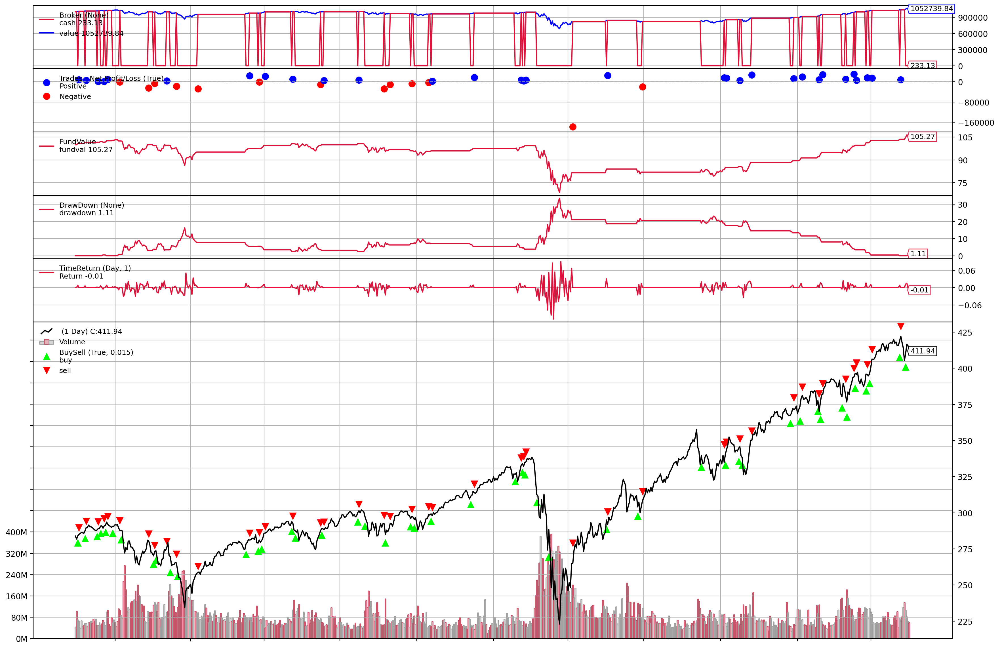

[[<Figure size 3600x2400 with 7 Axes>]]

In [ ]:
plt.rcParams['figure.figsize'] = [18, 12]
plt.rcParams['figure.dpi'] = 200 # 200 e.g. is really fine, but slower
cerebro.plot(start=dt.date(2018, 8, 14), iplot=False)

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-8-14',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: divide by zero encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


## HSI

### 0700 (Tencent)

In [ ]:
tencent_data = pd.read_csv(r'/content/drive/My Drive/CFE/0700.HK.csv', index_col=0, parse_dates=True)
tencent_data.dropna(inplace=True)
time_data = tencent_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(tencent_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = tencent_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.013909852614344286
2020-02-12T00:00:00, 
Today's price =  411.0
Predicted price =  384.58786640240635
Current f :  0
2020-02-13T00:00:00, 
Today's price =  416.399994
Predicted price =  385.65011026323145
Current f :  0
2020-02-14T00:00:00, 
Today's price =  415.0
Predicted price =  383.20141724697015
Current f :  0
2020-02-17T00:00:00, 
Today's price =  416.600006
Predicted price =  374.8362445915812
Current f :  0
2020-02-18T00:00:00, 
Today's price =  408.200012
Predicted price =  370.0363648067764
Current f :  0
2020-02-19T00:00:00, 
Today's price =  411.399994
Predicted price =  377.7893158826889
Current f :  0
2020-02-20T00:00:00, 
Today's price =  410.0
Predicted price =  387.0027157462413
Current f :  0
2020-02-21T00:00:00, 
Today's price =  401.0
Predicted price =  386.96614299404985
Current f :  0
2020-02-24T00:00:00, 
Today's price =  390.399994
Predicted price =  392.2012641459316
Current f :  0
2020-02-25T00:00:00, 
Today's price = 

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 1398 (ICBC)

In [ ]:
icbc_data = pd.read_csv(r'/content/drive/My Drive/CFE/1398.HK.csv', index_col=0, parse_dates=True)
icbc_data.dropna(inplace=True)
time_data = icbc_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(icbc_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = icbc_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.010896982739503003
2020-02-12T00:00:00, 
Today's price =  5.56
Predicted price =  5.673354736819402
Current f :  1
2020-02-13T00:00:00, BUY EXECUTED, Price: 5.56, Cost: 999999.36, Comm 0.00
2020-02-13T00:00:00, 
Today's price =  5.49
Predicted price =  5.672189612172678
Current f :  1
2020-02-14T00:00:00, 
Today's price =  5.52
Predicted price =  5.478343398929203
Current f :  1
2020-02-17T00:00:00, 
Today's price =  5.57
Predicted price =  5.373085957837263
Current f :  0
2020-02-18T00:00:00, SELL EXECUTED, Price: 5.57, Cost: 999999.36, Comm 0.00
2020-02-18T00:00:00, 
Today's price =  5.51
Predicted price =  5.309043916299648
Current f :  0
2020-02-19T00:00:00, 
Today's price =  5.56
Predicted price =  5.357679487417521
Current f :  0
2020-02-20T00:00:00, 
Today's price =  5.55
Predicted price =  5.37128269273357
Current f :  0
2020-02-21T00:00:00, 
Today's price =  5.52
Predicted price =  5.411744339619815
Current f :  0
2020-02-24T00:00:00, 


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.49
Predicted price =  5.51132932193264
Current f :  0
2020-03-06T00:00:00, SELL EXECUTED, Price: 5.49, Cost: 1001794.82, Comm 0.00
2020-03-06T00:00:00, 
Today's price =  5.36
Predicted price =  5.538409272394713
Current f :  1
2020-03-09T00:00:00, BUY EXECUTED, Price: 5.36, Cost: 1031869.68, Comm 0.00
2020-03-09T00:00:00, 
Today's price =  5.16
Predicted price =  5.5518262123747775
Current f :  1
2020-03-10T00:00:00, 
Today's price =  5.35
Predicted price =  5.512424507695005
Current f :  1
2020-03-11T00:00:00, 
Today's price =  5.37
Predicted price =  5.425904188917864
Current f :  0
2020-03-12T00:00:00, SELL EXECUTED, Price: 5.37, Cost: 1031869.68, Comm 0.00
2020-03-12T00:00:00, 
Today's price =  5.25
Predicted price =  5.458084724583178
Current f :  1
2020-03-13T00:00:00, BUY EXECUTED, Price: 5.25, Cost: 1033793.25, Comm 0.00
2020-03-13T00:00:00, 
Today's price =  5.25
Predicted price =  5.3920634565272945
Current f :  1
2020-03-16T00:00:00, 
Today's price =  5.1


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  5.17
Predicted price =  5.05812008772793
Current f :  0
2020-04-09T00:00:00, 
Today's price =  5.21
Predicted price =  5.194949889255722
Current f :  1
2020-04-14T00:00:00, BUY EXECUTED, Price: 5.21, Cost: 1049643.07, Comm 0.00
2020-04-14T00:00:00, 
Today's price =  5.21
Predicted price =  5.26322897637131
Current f :  0
2020-04-15T00:00:00, SELL EXECUTED, Price: 5.21, Cost: 1049643.07, Comm 0.00
2020-04-15T00:00:00, 
Today's price =  5.16
Predicted price =  5.227155006462865
Current f :  1
2020-04-16T00:00:00, BUY EXECUTED, Price: 5.16, Cost: 1049647.20, Comm 0.00
2020-04-16T00:00:00, 
Today's price =  5.09
Predicted price =  5.212748253631885
Current f :  1
2020-04-17T00:00:00, 
Today's price =  5.14
Predicted price =  5.248438279095798
Current f :  1
2020-04-20T00:00:00, 
Today's price =  5.12
Predicted price =  5.293171710622827
Current f :  1
2020-04-21T00:00:00, 
Today's price =  5.05
Predicted price =  5.212095744447678
Current f :  1
2020-04-22T00:00:00, 
Toda

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  5.03
Predicted price =  5.1218344537444125
Current f :  1
2020-05-15T00:00:00, 
Today's price =  5.02
Predicted price =  5.264099351539735
Current f :  1
2020-05-18T00:00:00, 
Today's price =  5.05
Predicted price =  5.286398703314621
Current f :  1
2020-05-19T00:00:00, 
Today's price =  5.09
Predicted price =  5.28110023703711
Current f :  1
2020-05-20T00:00:00, 
Today's price =  5.1
Predicted price =  5.11829004000178
Current f :  0
2020-05-21T00:00:00, SELL EXECUTED, Price: 5.10, Cost: 1080495.02, Comm 0.00
2020-05-21T00:00:00, 
Today's price =  5.06
Predicted price =  5.108601785885911
Current f :  0
2020-05-22T00:00:00, 
Today's price =  4.94
Predicted price =  5.152739553239997
Current f :  1
2020-05-25T00:00:00, BUY EXECUTED, Price: 4.94, Cost: 1082620.76, Comm 0.00
2020-05-25T00:00:00, 
Today's price =  4.97
Predicted price =  5.129379129682243
Current f :  1
2020-05-26T00:00:00, 
Today's price =  4.98
Predicted price =  5.203882095716597
Current f :  1
2020-0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.12
Predicted price =  5.1365960837829725
Current f :  0
2020-06-18T00:00:00, SELL EXECUTED, Price: 5.12, Cost: 1157278.72, Comm 0.00
2020-06-18T00:00:00, 
Today's price =  5.11
Predicted price =  5.159693588638508
Current f :  0
2020-06-19T00:00:00, 
Today's price =  5.18
Predicted price =  5.160924834706738
Current f :  1
2020-06-22T00:00:00, BUY EXECUTED, Price: 5.18, Cost: 1157279.34, Comm 0.00
2020-06-22T00:00:00, 
Today's price =  4.86
Predicted price =  5.194100328048981
Current f :  1
2020-06-23T00:00:00, 
Today's price =  4.88
Predicted price =  5.262748312916648
Current f :  1
2020-06-24T00:00:00, 
Today's price =  4.81
Predicted price =  5.197204322991273
Current f :  1
2020-06-26T00:00:00, 
Today's price =  4.76
Predicted price =  5.252157573553875
Current f :  1
2020-06-29T00:00:00, 
Today's price =  4.75
Predicted price =  5.270141846495846
Current f :  1
2020-06-30T00:00:00, 
Today's price =  4.7
Predicted price =  5.212457351675112
Current f :  1
2020-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  5.083669639062535
Current f :  1
2020-07-28T00:00:00, 
Today's price =  4.67
Predicted price =  5.026808883699898
Current f :  1
2020-07-29T00:00:00, 
Today's price =  4.7
Predicted price =  5.018992115792238
Current f :  1
2020-07-30T00:00:00, 
Today's price =  4.65
Predicted price =  5.006006211069434
Current f :  1
2020-07-31T00:00:00, 
Today's price =  4.58
Predicted price =  4.937760263075545
Current f :  1
2020-08-03T00:00:00, 
Today's price =  4.55
Predicted price =  4.956583702638014
Current f :  1
2020-08-04T00:00:00, 
Today's price =  4.64
Predicted price =  4.937981937925129
Current f :  1
2020-08-05T00:00:00, 
Today's price =  4.63
Predicted price =  4.984161420407629
Current f :  1
2020-08-06T00:00:00, 
Today's price =  4.6
Predicted price =  4.920111591082258
Current f :  1
2020-08-07T00:00:00, 
Today's price =  4.56
Predicted price =  4.848876431753487
Current f :  1
2020-08-10T00:00:00, 
Today's price =  4.55
Predicted price =  4.861015054982844
Curre

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 4.31
Predicted price =  4.754096853080942
Current f :  1
2020-09-02T00:00:00, 
Today's price =  4.22
Predicted price =  4.8170911116454525
Current f :  1
2020-09-03T00:00:00, 
Today's price =  4.21
Predicted price =  4.807158483496626
Current f :  1
2020-09-04T00:00:00, 
Today's price =  4.26
Predicted price =  4.834082713789563
Current f :  1
2020-09-07T00:00:00, 
Today's price =  4.22
Predicted price =  4.720611460891158
Current f :  1
2020-09-08T00:00:00, 
Today's price =  4.42
Predicted price =  4.719262410283814
Current f :  1
2020-09-09T00:00:00, 
Today's price =  4.39
Predicted price =  4.718032632055244
Current f :  1
2020-09-10T00:00:00, 
Today's price =  4.32
Predicted price =  4.7330475945465125
Current f :  1
2020-09-11T00:00:00, 
Today's price =  4.3
Predicted price =  4.7126260372423285
Current f :  1
2020-09-14T00:00:00, 
Today's price =  4.27
Predicted price =  4.675720554849044
Current f :  1
2020-09-15T00:00:00, 
Today's price =  4.29
Predicted price =  4.63617948138

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

1
2020-10-12T00:00:00, 
Today's price =  4.24
Predicted price =  4.308503265301773
Current f :  1
2020-10-14T00:00:00, 
Today's price =  4.26
Predicted price =  4.264324771679143
Current f :  0
2020-10-15T00:00:00, SELL EXECUTED, Price: 4.26, Cost: 1095598.09, Comm 0.00
2020-10-15T00:00:00, 
Today's price =  4.24
Predicted price =  4.205397052014879
Current f :  1
2020-10-16T00:00:00, BUY EXECUTED, Price: 4.24, Cost: 1021280.32, Comm 0.00
2020-10-16T00:00:00, 
Today's price =  4.42
Predicted price =  4.17718817289742
Current f :  0
2020-10-19T00:00:00, SELL EXECUTED, Price: 4.42, Cost: 1021280.32, Comm 0.00
2020-10-19T00:00:00, 
Today's price =  4.58
Predicted price =  4.216923266062672
Current f :  0
2020-10-20T00:00:00, 
Today's price =  4.54
Predicted price =  4.1762919208821
Current f :  0
2020-10-21T00:00:00, 
Today's price =  4.59
Predicted price =  4.167413605778812
Current f :  0
2020-10-22T00:00:00, 
Today's price =  4.71
Predicted price =  4.172984090575362
Current f :  0
202

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  4.539295663779852
Current f :  0
2020-11-18T00:00:00, SELL EXECUTED, Price: 4.68, Cost: 1073815.20, Comm 0.00
2020-11-18T00:00:00, 
Today's price =  4.71
Predicted price =  4.705195958665809
Current f :  1
2020-11-19T00:00:00, BUY EXECUTED, Price: 4.71, Cost: 1080742.47, Comm 0.00
2020-11-19T00:00:00, 
Today's price =  4.6
Predicted price =  4.77025153195492
Current f :  1
2020-11-20T00:00:00, 
Today's price =  4.56
Predicted price =  4.739902184883323
Current f :  1
2020-11-23T00:00:00, 
Today's price =  4.59
Predicted price =  4.751802008564106
Current f :  1
2020-11-24T00:00:00, 
Today's price =  4.53
Predicted price =  4.797904883308003
Current f :  1
2020-11-25T00:00:00, 
Today's price =  4.58
Predicted price =  4.787016374132092
Current f :  1
2020-11-26T00:00:00, 
Today's price =  4.67
Predicted price =  4.837949066343088
Current f :  1
2020-11-27T00:00:00, 
Today's price =  4.87
Predicted price =  4.991104726837868
Current f :  1
2020-11-30T00:00:00, 
Today's

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  4.54
Predicted price =  5.032221429378451
Current f :  1
2020-12-23T00:00:00, 
Today's price =  4.47
Predicted price =  4.9567344972840806
Current f :  1
2020-12-24T00:00:00, 
Today's price =  4.54
Predicted price =  4.898478834635104
Current f :  1
2020-12-28T00:00:00, 
Today's price =  4.76
Predicted price =  4.944674460263242
Current f :  1
2020-12-29T00:00:00, 
Today's price =  4.9
Predicted price =  4.903495556954154
Current f :  0
2020-12-30T00:00:00, SELL EXECUTED, Price: 4.90, Cost: 1164544.92, Comm 0.00
2020-12-30T00:00:00, 
Today's price =  4.93
Predicted price =  4.9217636142557355
Current f :  1
2020-12-31T00:00:00, BUY EXECUTED, Price: 4.93, Cost: 1206400.58, Comm 0.00
2020-12-31T00:00:00, 
Today's price =  5.01
Predicted price =  4.830063487586173
Current f :  0
2021-01-04T00:00:00, SELL EXECUTED, Price: 5.01, Cost: 1206400.58, Comm 0.00
2021-01-04T00:00:00, 
Today's price =  4.85
Predicted price =  4.8460852009314825
Current f :  1
2021-01-05T00:00:00, B

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  4.95
Predicted price =  5.064754334720629
Current f :  1
2021-02-01T00:00:00, 
Today's price =  4.95
Predicted price =  5.08933650555678
Current f :  1
2021-02-02T00:00:00, 
Today's price =  4.91
Predicted price =  5.190534775937921
Current f :  1
2021-02-03T00:00:00, 
Today's price =  4.89
Predicted price =  5.2007111276772875
Current f :  1
2021-02-04T00:00:00, 
Today's price =  4.86
Predicted price =  5.220720356979904
Current f :  1
2021-02-05T00:00:00, 
Today's price =  4.87
Predicted price =  5.1984919376301155
Current f :  1
2021-02-08T00:00:00, 
Today's price =  4.85
Predicted price =  5.250695343868047
Current f :  1
2021-02-09T00:00:00, 
Today's price =  4.81
Predicted price =  5.115366060317113
Current f :  1
2021-02-10T00:00:00, 
Today's price =  4.9
Predicted price =  5.1570045313499495
Current f :  1
2021-02-11T00:00:00, 
Today's price =  5.0
Predicted price =  5.141946831063938
Current f :  1
2021-02-16T00:00:00, 
Today's price =  5.06
Predicted price =

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-03-10T00:00:00, 
Today's price =  5.53
Predicted price =  5.150035597464673
Current f :  0
2021-03-11T00:00:00, 
Today's price =  5.57
Predicted price =  5.277645016389735
Current f :  0
2021-03-12T00:00:00, 
Today's price =  5.48
Predicted price =  5.216214949948373
Current f :  0
2021-03-15T00:00:00, 
Today's price =  5.6
Predicted price =  5.2556890234814695
Current f :  0
2021-03-16T00:00:00, 
Today's price =  5.53
Predicted price =  5.1225382411783835
Current f :  0
2021-03-17T00:00:00, 
Today's price =  5.53
Predicted price =  5.104114741945193
Current f :  0
2021-03-18T00:00:00, 
Today's price =  5.51
Predicted price =  5.076245949912769
Current f :  0
2021-03-19T00:00:00, 
Today's price =  5.4
Predicted price =  5.339686849685141
Current f :  0
2021-03-22T00:00:00, 
Today's price =  5.5
Predicted price =  5.332258937827174
Current f :  0
2021-03-23T00:00:00, 
Today's price =  5.47
Predicted price =  5.490590453129455
Current f :  0
2021-03-24T00:00:00, 
Today's price =  5.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.42
Predicted price =  5.4447036631560275
Current f :  0
2021-04-16T00:00:00, SELL EXECUTED, Price: 5.42, Cost: 1338676.54, Comm 0.00
2021-04-16T00:00:00, 
Today's price =  5.44
Predicted price =  5.503109269756978
Current f :  1
2021-04-19T00:00:00, BUY EXECUTED, Price: 5.44, Cost: 1316811.84, Comm 0.00
2021-04-19T00:00:00, 
Today's price =  5.47
Predicted price =  5.598976242676288
Current f :  1
2021-04-20T00:00:00, 
Today's price =  5.5
Predicted price =  5.57645241078201
Current f :  1
2021-04-21T00:00:00, 
Today's price =  5.4
Predicted price =  5.6072627367112196
Current f :  1
2021-04-22T00:00:00, 
Today's price =  5.34
Predicted price =  5.5650818784246665
Current f :  1
2021-04-23T00:00:00, 
Today's price =  5.42
Predicted price =  5.536234725567117
Current f :  1
2021-04-26T00:00:00, 
Today's price =  5.34
Predicted price =  5.528364003689801
Current f :  1
2021-04-27T00:00:00, 
Today's price =  5.27
Predicted price =  5.555628273808064
Current f :  1
2021-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 4333 (CISCO-T)

In [ ]:
cisco_data = pd.read_csv(r'/content/drive/My Drive/CFE/4333.HK.csv', index_col=0, parse_dates=True)
cisco_data.dropna(inplace=True)

train_len = int(0.7 * len(cisco_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = cisco_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.7944961240310078
2020-02-12T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-13T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-14T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-17T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-18T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-19T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-20T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-21T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-24T00:00:00, 
Today's price =  400.0
Predicted price =  401.04008476248794
Current f :  0
2020-02-25T00:00:00, 
Today's price =  400.0
Predicted price

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages

Skip


### 3968 (CM Bank)

In [ ]:
cm_data = pd.read_csv(r'/content/drive/My Drive/CFE/3968.HK.csv', index_col=0, parse_dates=True)
cm_data.dropna(inplace=True)
time_data = cm_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(cm_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = cm_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.014491368833601727
2020-02-12T00:00:00, 
Today's price =  38.849998
Predicted price =  40.06990989337364
Current f :  1
2020-02-13T00:00:00, BUY EXECUTED, Price: 38.85, Cost: 999998.95, Comm 0.00
2020-02-13T00:00:00, 
Today's price =  38.400002
Predicted price =  40.07686454318229
Current f :  1
2020-02-14T00:00:00, 
Today's price =  38.700001
Predicted price =  39.39522797149891
Current f :  1
2020-02-17T00:00:00, 
Today's price =  39.5
Predicted price =  39.06792810170704
Current f :  1
2020-02-18T00:00:00, 
Today's price =  38.75
Predicted price =  38.765037488271325
Current f :  0
2020-02-19T00:00:00, SELL EXECUTED, Price: 38.75, Cost: 999998.95, Comm 0.00
2020-02-19T00:00:00, 
Today's price =  38.950001
Predicted price =  39.11731607888495
Current f :  0
2020-02-20T00:00:00, 
Today's price =  38.75
Predicted price =  38.75371396506822
Current f :  0
2020-02-21T00:00:00, 
Today's price =  38.450001
Predicted price =  39.26221967806373
Curren

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  37.25
Predicted price =  38.87645836572636
Current f :  1
2020-03-03T00:00:00, 
Today's price =  37.25
Predicted price =  39.00524487557195
Current f :  1
2020-03-04T00:00:00, 
Today's price =  37.200001
Predicted price =  39.53620040276353
Current f :  1
2020-03-05T00:00:00, 
Today's price =  38.75
Predicted price =  39.00800736001134
Current f :  0
2020-03-06T00:00:00, SELL EXECUTED, Price: 38.75, Cost: 997393.03, Comm 0.00
2020-03-06T00:00:00, 
Today's price =  37.75
Predicted price =  38.989521356212784
Current f :  1
2020-03-09T00:00:00, BUY EXECUTED, Price: 37.75, Cost: 1005207.00, Comm 0.00
2020-03-09T00:00:00, 
Today's price =  36.150002
Predicted price =  39.04566696217567
Current f :  1
2020-03-10T00:00:00, 
Today's price =  36.900002
Predicted price =  38.81080152691365
Current f :  1
2020-03-11T00:00:00, 
Today's price =  36.75
Predicted price =  37.723495202400855
Current f :  1
2020-03-12T00:00:00, 
Today's price =  35.650002
Predicted price =  37.9560082

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-04-06T00:00:00, 
Today's price =  34.400002
Predicted price =  33.66881757089526
Current f :  0
2020-04-07T00:00:00, 
Today's price =  35.0
Predicted price =  35.37576637794575
Current f :  0
2020-04-08T00:00:00, 
Today's price =  34.299999
Predicted price =  33.63933921655805
Current f :  0
2020-04-09T00:00:00, 
Today's price =  34.799999
Predicted price =  34.76896225773725
Current f :  1
2020-04-14T00:00:00, BUY EXECUTED, Price: 34.80, Cost: 903999.57, Comm 0.00
2020-04-14T00:00:00, 
Today's price =  35.0
Predicted price =  35.93973717819534
Current f :  1
2020-04-15T00:00:00, 
Today's price =  34.349998
Predicted price =  35.39376988609999
Current f :  1
2020-04-16T00:00:00, 
Today's price =  34.099998
Predicted price =  35.2944067883519
Current f :  1
2020-04-17T00:00:00, 
Today's price =  35.299999
Predicted price =  35.337856725601746
Current f :  0
2020-04-20T00:00:00, SELL EXECUTED, Price: 35.30, Cost: 903999.57, Comm 0.00
2020-04-20T00:00:00, 
Today's price =  34.900002


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-05-18T00:00:00, BUY EXECUTED, Price: 35.65, Cost: 962336.15, Comm 0.00
2020-05-18T00:00:00, 
Today's price =  36.0
Predicted price =  35.692865484726774
Current f :  1
2020-05-19T00:00:00, 
Today's price =  36.700001
Predicted price =  36.61276310174848
Current f :  1
2020-05-20T00:00:00, 
Today's price =  36.700001
Predicted price =  34.89809720865708
Current f :  0
2020-05-21T00:00:00, SELL EXECUTED, Price: 36.70, Cost: 962336.15, Comm 0.00
2020-05-21T00:00:00, 
Today's price =  37.099998
Predicted price =  36.59723766748378
Current f :  1
2020-05-22T00:00:00, BUY EXECUTED, Price: 37.10, Cost: 990681.25, Comm 0.00
2020-05-22T00:00:00, 
Today's price =  35.700001
Predicted price =  36.41039009172856
Current f :  1
2020-05-25T00:00:00, 
Today's price =  35.400002
Predicted price =  36.17051724588596
Current f :  1
2020-05-26T00:00:00, 
Today's price =  35.799999
Predicted price =  36.27167455130825
Current f :  0
2020-05-27T00:00:00, SELL EXECUTED, Price: 35.80, Cost: 990681.25, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 36.099998
Predicted price =  38.40110824965584
Current f :  1
2020-06-24T00:00:00, 
Today's price =  36.099998
Predicted price =  37.92320808020849
Current f :  1
2020-06-26T00:00:00, 
Today's price =  35.549999
Predicted price =  37.97308656494356
Current f :  1
2020-06-29T00:00:00, 
Today's price =  35.799999
Predicted price =  38.04024349057994
Current f :  1
2020-06-30T00:00:00, 
Today's price =  35.650002
Predicted price =  37.27840843976351
Current f :  1
2020-07-02T00:00:00, 
Today's price =  35.900002
Predicted price =  36.95757033991934
Current f :  1
2020-07-03T00:00:00, 
Today's price =  37.450001
Predicted price =  36.545366349928784
Current f :  0
2020-07-06T00:00:00, SELL EXECUTED, Price: 37.45, Cost: 967963.20, Comm 0.00
2020-07-06T00:00:00, 
Today's price =  42.0
Predicted price =  36.78730201816495
Current f :  0
2020-07-07T00:00:00, 
Today's price =  41.200001
Predicted price =  36.647484297027724
Current f :  0
2020-07-08T00:00:00, 
Today's price =  41.200001
Predic

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  36.099998
Predicted price =  37.68561782938365
Current f :  1
2020-08-04T00:00:00, 
Today's price =  37.700001
Predicted price =  37.32994379257983
Current f :  1
2020-08-05T00:00:00, 
Today's price =  37.200001
Predicted price =  38.284997352538504
Current f :  1
2020-08-06T00:00:00, 
Today's price =  37.099998
Predicted price =  38.4553050542037
Current f :  1
2020-08-07T00:00:00, 
Today's price =  36.700001
Predicted price =  38.169658585687785
Current f :  1
2020-08-10T00:00:00, 
Today's price =  37.200001
Predicted price =  38.084014827086236
Current f :  1
2020-08-11T00:00:00, 
Today's price =  38.900002
Predicted price =  36.993546371106554
Current f :  0
2020-08-12T00:00:00, SELL EXECUTED, Price: 38.90, Cost: 989108.12, Comm 0.00
2020-08-12T00:00:00, 
Today's price =  38.900002
Predicted price =  36.994854511453184
Current f :  0
2020-08-13T00:00:00, 
Today's price =  38.700001
Predicted price =  37.27543561345756
Current f :  0
2020-08-14T00:00:00, 
Today's p

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 38.400002
Predicted price =  38.94399037127118
Current f :  1
2020-09-09T00:00:00, 
Today's price =  38.549999
Predicted price =  38.60332469656905
Current f :  0
2020-09-10T00:00:00, SELL EXECUTED, Price: 38.55, Cost: 1035445.00, Comm 0.00
2020-09-10T00:00:00, 
Today's price =  38.099998
Predicted price =  38.71780032244944
Current f :  1
2020-09-11T00:00:00, BUY EXECUTED, Price: 38.10, Cost: 1078839.54, Comm 0.00
2020-09-11T00:00:00, 
Today's price =  37.849998
Predicted price =  38.16124960442949
Current f :  0
2020-09-14T00:00:00, SELL EXECUTED, Price: 37.85, Cost: 1078839.54, Comm 0.00
2020-09-14T00:00:00, 
Today's price =  38.049999
Predicted price =  37.79221639923943
Current f :  1
2020-09-15T00:00:00, BUY EXECUTED, Price: 38.05, Cost: 1071754.32, Comm 0.00
2020-09-15T00:00:00, 
Today's price =  38.549999
Predicted price =  38.3543344058031
Current f :  1
2020-09-16T00:00:00, 
Today's price =  39.099998
Predicted price =  37.39231528442676
Current f :  0
2020-09-17T00:00:00, S

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 40.950001
Predicted price =  37.96638072201444
Current f :  0
2020-10-19T00:00:00, 
Today's price =  41.549999
Predicted price =  38.03454117936203
Current f :  0
2020-10-20T00:00:00, 
Today's price =  41.75
Predicted price =  36.37804559249957
Current f :  0
2020-10-21T00:00:00, 
Today's price =  42.849998
Predicted price =  37.211660427067656
Current f :  0
2020-10-22T00:00:00, 
Today's price =  43.950001
Predicted price =  37.28582277682952
Current f :  0
2020-10-23T00:00:00, 
Today's price =  43.849998
Predicted price =  37.972062249101164
Current f :  0
2020-10-27T00:00:00, 
Today's price =  42.549999
Predicted price =  37.62238303718494
Current f :  0
2020-10-28T00:00:00, 
Today's price =  41.650002
Predicted price =  37.87865801972918
Current f :  0
2020-10-29T00:00:00, 
Today's price =  41.75
Predicted price =  37.34686979495897
Current f :  0
2020-10-30T00:00:00, 
Today's price =  40.299999
Predicted price =  38.616357277829955
Current f :  0
2020-11-02T00:00:00, 
Today's pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  47.06895305631925
Current f :  0
2020-11-30T00:00:00, 
Today's price =  49.049999
Predicted price =  45.700570141878984
Current f :  0
2020-12-01T00:00:00, 
Today's price =  50.049999
Predicted price =  45.70348375403976
Current f :  0
2020-12-02T00:00:00, 
Today's price =  50.900002
Predicted price =  46.32939559186085
Current f :  0
2020-12-03T00:00:00, 
Today's price =  50.0
Predicted price =  47.072662324225014
Current f :  0
2020-12-04T00:00:00, 
Today's price =  50.599998
Predicted price =  48.21109797081609
Current f :  0
2020-12-07T00:00:00, 
Today's price =  48.450001
Predicted price =  48.198717753001674
Current f :  1
2020-12-08T00:00:00, BUY EXECUTED, Price: 48.45, Cost: 1196811.92, Comm 0.00
2020-12-08T00:00:00, 
Today's price =  47.650002
Predicted price =  47.65341033782368
Current f :  0
2020-12-09T00:00:00, SELL EXECUTED, Price: 47.65, Cost: 1196811.92, Comm 0.00
2020-12-09T00:00:00, 
Today's price =  48.0
Predicted price =  48.10217793092443
Curren

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  49.200001
Predicted price =  47.789054178159944
Current f :  0
2021-01-07T00:00:00, SELL EXECUTED, Price: 49.20, Cost: 1194361.00, Comm 0.00
2021-01-07T00:00:00, 
Today's price =  52.200001
Predicted price =  47.858318302487426
Current f :  0
2021-01-08T00:00:00, 
Today's price =  53.450001
Predicted price =  47.946324209187644
Current f :  0
2021-01-11T00:00:00, 
Today's price =  56.299999
Predicted price =  47.30338314277058
Current f :  0
2021-01-12T00:00:00, 
Today's price =  57.900002
Predicted price =  47.20978409427888
Current f :  0
2021-01-13T00:00:00, 
Today's price =  57.25
Predicted price =  47.913415844346176
Current f :  0
2021-01-14T00:00:00, 
Today's price =  57.150002
Predicted price =  48.380965850462786
Current f :  0
2021-01-15T00:00:00, 
Today's price =  60.900002
Predicted price =  48.049225344939074
Current f :  0
2021-01-18T00:00:00, 
Today's price =  60.099998
Predicted price =  48.8108258443031
Current f :  0
2021-01-19T00:00:00, 
Today's pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  66.949997
Predicted price =  57.25584180009973
Current f :  0
2021-02-17T00:00:00, 
Today's price =  67.75
Predicted price =  56.94653523993619
Current f :  0
2021-02-18T00:00:00, 
Today's price =  65.300003
Predicted price =  57.24770361907305
Current f :  0
2021-02-19T00:00:00, 
Today's price =  65.349998
Predicted price =  58.32386424317936
Current f :  0
2021-02-22T00:00:00, 
Today's price =  62.900002
Predicted price =  58.569393824369754
Current f :  0
2021-02-23T00:00:00, 
Today's price =  66.349998
Predicted price =  60.391808478826384
Current f :  0
2021-02-24T00:00:00, 
Today's price =  62.700001
Predicted price =  59.734635003249004
Current f :  0
2021-02-25T00:00:00, 
Today's price =  64.0
Predicted price =  60.74068037016916
Current f :  0
2021-02-26T00:00:00, 
Today's price =  59.549999
Predicted price =  60.749427709067426
Current f :  1
2021-03-01T00:00:00, BUY EXECUTED, Price: 59.55, Cost: 1211604.28, Comm 0.00
2021-03-01T00:00:00, 
Today's price =  5

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  60.349998
Predicted price =  58.125058001401186
Current f :  0
2021-03-26T00:00:00, 
Today's price =  60.950001
Predicted price =  59.702402775709224
Current f :  0
2021-03-29T00:00:00, 
Today's price =  60.650002
Predicted price =  61.80591570199145
Current f :  1
2021-03-30T00:00:00, BUY EXECUTED, Price: 60.65, Cost: 1329326.74, Comm 0.00
2021-03-30T00:00:00, 
Today's price =  60.950001
Predicted price =  62.52160573440905
Current f :  1
2021-03-31T00:00:00, 
Today's price =  59.349998
Predicted price =  61.26800150236666
Current f :  1
2021-04-01T00:00:00, 
Today's price =  60.349998
Predicted price =  62.46167294758993
Current f :  1
2021-04-07T00:00:00, 
Today's price =  59.700001
Predicted price =  61.24005451293622
Current f :  1
2021-04-08T00:00:00, 
Today's price =  60.0
Predicted price =  63.10024844931311
Current f :  1
2021-04-09T00:00:00, 
Today's price =  58.849998
Predicted price =  60.256484583183564
Current f :  1
2021-04-12T00:00:00, 
Today's price = 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 939 (CCB)

In [ ]:
ccb_data = pd.read_csv(r'/content/drive/My Drive/CFE/0939.HK.csv', index_col=0, parse_dates=True)
ccb_data.dropna(inplace=True)
time_data = ccb_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ccb_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ccb_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.010921117472412686
2020-02-12T00:00:00, 
Today's price =  6.5
Predicted price =  6.493549862969252
Current f :  1
2020-02-13T00:00:00, BUY EXECUTED, Price: 6.50, Cost: 999999.00, Comm 0.00
2020-02-13T00:00:00, 
Today's price =  6.44
Predicted price =  6.509048007173232
Current f :  [0.004811]
2020-02-14T00:00:00, SELL EXECUTED, Price: 6.44, Cost: 995182.50, Comm 0.00
2020-02-14T00:00:00, 
Today's price =  6.51
Predicted price =  6.320327467807325
Current f :  0
2020-02-17T00:00:00, SELL EXECUTED, Price: 6.51, Cost: 4816.50, Comm 0.00
2020-02-17T00:00:00, 
Today's price =  6.54
Predicted price =  6.158745484922329
Current f :  0
2020-02-18T00:00:00, 
Today's price =  6.47
Predicted price =  6.094472531613923
Current f :  0
2020-02-19T00:00:00, 
Today's price =  6.55
Predicted price =  6.155013636653683
Current f :  0
2020-02-20T00:00:00, 
Today's price =  6.55
Predicted price =  6.204773880072571
Current f :  0
2020-02-21T00:00:00, 
Today's price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-03-09T00:00:00, 
Today's price =  6.23
Predicted price =  6.597336431601713
Current f :  1
2020-03-10T00:00:00, 
Today's price =  6.41
Predicted price =  6.51558621426511
Current f :  1
2020-03-11T00:00:00, 
Today's price =  6.45
Predicted price =  6.399573414434722
Current f :  1
2020-03-12T00:00:00, 
Today's price =  6.33
Predicted price =  6.457734993705245
Current f :  1
2020-03-13T00:00:00, 
Today's price =  6.34
Predicted price =  6.396063879291068
Current f :  0
2020-03-16T00:00:00, SELL EXECUTED, Price: 6.34, Cost: 1006446.92, Comm 0.00
2020-03-16T00:00:00, 
Today's price =  6.19
Predicted price =  6.502389135790814
Current f :  1
2020-03-17T00:00:00, BUY EXECUTED, Price: 6.19, Cost: 995457.23, Comm 0.00
2020-03-17T00:00:00, 
Today's price =  6.2
Predicted price =  6.364071597097067
Current f :  1
2020-03-18T00:00:00, 
Today's price =  6.0
Predicted price =  6.466356426957792
Current f :  1
2020-03-19T00:00:00, 
Today's price =  5.96
Predicted price =  6.441701196765527
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-04-14T00:00:00, 
Today's price =  6.27
Predicted price =  6.317959751943401
Current f :  0
2020-04-15T00:00:00, 
Today's price =  6.21
Predicted price =  6.323770002035764
Current f :  1
2020-04-16T00:00:00, BUY EXECUTED, Price: 6.21, Cost: 1034548.74, Comm 0.00
2020-04-16T00:00:00, 
Today's price =  6.1
Predicted price =  6.265513678688373
Current f :  1
2020-04-17T00:00:00, 
Today's price =  6.12
Predicted price =  6.28052077471578
Current f :  1
2020-04-20T00:00:00, 
Today's price =  6.09
Predicted price =  6.332697465560111
Current f :  1
2020-04-21T00:00:00, 
Today's price =  6.0
Predicted price =  6.256670163476213
Current f :  1
2020-04-22T00:00:00, 
Today's price =  6.01
Predicted price =  6.32597443215497
Current f :  1
2020-04-23T00:00:00, 
Today's price =  6.02
Predicted price =  6.19485569399535
Current f :  1
2020-04-24T00:00:00, 
Today's price =  6.01
Predicted price =  6.290369288033099
Current f :  1
2020-04-27T00:00:00, 
Today's price =  6.17
Predicted price =  6.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.23
Predicted price =  6.335220000134943
Current f :  1
2020-05-20T00:00:00, 
Today's price =  6.27
Predicted price =  6.124245869920078
Current f :  0
2020-05-21T00:00:00, SELL EXECUTED, Price: 6.27, Cost: 1058390.40, Comm 0.00
2020-05-21T00:00:00, 
Today's price =  6.27
Predicted price =  6.141037398577336
Current f :  0
2020-05-22T00:00:00, 
Today's price =  6.02
Predicted price =  6.177451117197344
Current f :  1
2020-05-25T00:00:00, BUY EXECUTED, Price: 6.02, Cost: 1079042.86, Comm 0.00
2020-05-25T00:00:00, 
Today's price =  6.09
Predicted price =  6.154864737820831
Current f :  0
2020-05-26T00:00:00, SELL EXECUTED, Price: 6.09, Cost: 1079042.86, Comm 0.00
2020-05-26T00:00:00, 
Today's price =  6.11
Predicted price =  6.249358794917039
Current f :  1
2020-05-27T00:00:00, BUY EXECUTED, Price: 6.11, Cost: 1091588.16, Comm 0.00
2020-05-27T00:00:00, 
Today's price =  6.09
Predicted price =  6.273659090900003
Current f :  1
2020-05-28T00:00:00, 
Today's price =  6.18


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.17
Predicted price =  6.32895746441892
Current f :  1
2020-06-19T00:00:00, 
Today's price =  6.26
Predicted price =  6.3810201445834265
Current f :  1
2020-06-22T00:00:00, 
Today's price =  6.2
Predicted price =  6.340164760542452
Current f :  1
2020-06-23T00:00:00, 
Today's price =  6.26
Predicted price =  6.409821621617146
Current f :  1
2020-06-24T00:00:00, 
Today's price =  6.22
Predicted price =  6.320671799642668
Current f :  1
2020-06-26T00:00:00, 
Today's price =  6.17
Predicted price =  6.374520318612234
Current f :  1
2020-06-29T00:00:00, 
Today's price =  6.23
Predicted price =  6.424495378633527
Current f :  1
2020-06-30T00:00:00, 
Today's price =  6.27
Predicted price =  6.350877414559707
Current f :  1
2020-07-02T00:00:00, 
Today's price =  6.09
Predicted price =  6.281823071358617
Current f :  1
2020-07-03T00:00:00, 
Today's price =  6.14
Predicted price =  6.224286507166166
Current f :  1
2020-07-06T00:00:00, 
Today's price =  6.52
Predicted price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-07-24T00:00:00, 
Today's price =  5.86
Predicted price =  6.561066936202993
Current f :  1
2020-07-27T00:00:00, 
Today's price =  5.92
Predicted price =  6.4918018727140945
Current f :  1
2020-07-28T00:00:00, 
Today's price =  5.88
Predicted price =  6.39597711883153
Current f :  1
2020-07-29T00:00:00, 
Today's price =  5.86
Predicted price =  6.3461894855354615
Current f :  1
2020-07-30T00:00:00, 
Today's price =  5.77
Predicted price =  6.33758045117997
Current f :  1
2020-07-31T00:00:00, 
Today's price =  5.68
Predicted price =  6.2769770800671125
Current f :  1
2020-08-03T00:00:00, 
Today's price =  5.68
Predicted price =  6.245878264210976
Current f :  1
2020-08-04T00:00:00, 
Today's price =  5.83
Predicted price =  6.237114027230608
Current f :  1
2020-08-05T00:00:00, 
Today's price =  5.79
Predicted price =  6.21492346979427
Current f :  1
2020-08-06T00:00:00, 
Today's price =  5.76
Predicted price =  6.16777422132403
Current f :  1
2020-08-07T00:00:00, 
Today's price =  5.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.65
Predicted price =  5.942502485594964
Current f :  1
2020-08-31T00:00:00, 
Today's price =  5.49
Predicted price =  5.917398860290713
Current f :  1
2020-09-01T00:00:00, 
Today's price =  5.49
Predicted price =  5.883810747639248
Current f :  1
2020-09-02T00:00:00, 
Today's price =  5.38
Predicted price =  5.9363898795969705
Current f :  1
2020-09-03T00:00:00, 
Today's price =  5.38
Predicted price =  5.955955741093593
Current f :  1
2020-09-04T00:00:00, 
Today's price =  5.44
Predicted price =  6.023596953094238
Current f :  1
2020-09-07T00:00:00, 
Today's price =  5.42
Predicted price =  5.876367258531814
Current f :  1
2020-09-08T00:00:00, 
Today's price =  5.59
Predicted price =  5.901629770422364
Current f :  1
2020-09-09T00:00:00, 
Today's price =  5.5
Predicted price =  5.885275374615449
Current f :  1
2020-09-10T00:00:00, 
Today's price =  5.42
Predicted price =  5.8988186936799
Current f :  1
2020-09-11T00:00:00, 
Today's price =  5.39
Predicted price =  5

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.02
Predicted price =  5.496270909160075
Current f :  1
2020-10-09T00:00:00, 
Today's price =  5.02
Predicted price =  5.439219693440827
Current f :  1
2020-10-12T00:00:00, 
Today's price =  5.3
Predicted price =  5.456868279394119
Current f :  1
2020-10-14T00:00:00, 
Today's price =  5.3
Predicted price =  5.3702955732496465
Current f :  1
2020-10-15T00:00:00, 
Today's price =  5.26
Predicted price =  5.2929255474843275
Current f :  0
2020-10-16T00:00:00, SELL EXECUTED, Price: 5.26, Cost: 1149753.15, Comm 0.00
2020-10-16T00:00:00, 
Today's price =  5.56
Predicted price =  5.244903141336412
Current f :  0
2020-10-19T00:00:00, 
Today's price =  5.66
Predicted price =  5.270101356471458
Current f :  0
2020-10-20T00:00:00, 
Today's price =  5.6
Predicted price =  5.246386422687238
Current f :  0
2020-10-21T00:00:00, 
Today's price =  5.66
Predicted price =  5.214847951433115
Current f :  0
2020-10-22T00:00:00, 
Today's price =  5.79
Predicted price =  5.196405888434956
C

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  5.683146026990949
Current f :  0
2020-11-16T00:00:00, 
Today's price =  5.91
Predicted price =  5.639884873737921
Current f :  0
2020-11-17T00:00:00, 
Today's price =  6.0
Predicted price =  5.560314243440552
Current f :  0
2020-11-18T00:00:00, 
Today's price =  6.03
Predicted price =  5.724870212542656
Current f :  0
2020-11-19T00:00:00, 
Today's price =  5.95
Predicted price =  5.791401899298301
Current f :  0
2020-11-20T00:00:00, 
Today's price =  5.86
Predicted price =  5.788830690588254
Current f :  0
2020-11-23T00:00:00, 
Today's price =  5.9
Predicted price =  5.8562135121448184
Current f :  1
2020-11-24T00:00:00, BUY EXECUTED, Price: 5.90, Cost: 1120056.00, Comm 0.00
2020-11-24T00:00:00, 
Today's price =  5.84
Predicted price =  5.89528585648117
Current f :  0
2020-11-25T00:00:00, SELL EXECUTED, Price: 5.84, Cost: 1120056.00, Comm 0.00
2020-11-25T00:00:00, 
Today's price =  5.89
Predicted price =  5.932589881203786
Current f :  0
2020-11-26T00:00:00, 
Today's

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.74
Predicted price =  6.141222712884448
Current f :  1
2020-12-16T00:00:00, 
Today's price =  5.75
Predicted price =  6.1325451645324005
Current f :  1
2020-12-17T00:00:00, 
Today's price =  5.74
Predicted price =  6.189232908159043
Current f :  1
2020-12-18T00:00:00, 
Today's price =  5.75
Predicted price =  6.190447428588317
Current f :  1
2020-12-21T00:00:00, 
Today's price =  5.65
Predicted price =  6.116475340122769
Current f :  1
2020-12-22T00:00:00, 
Today's price =  5.63
Predicted price =  6.141772314234714
Current f :  1
2020-12-23T00:00:00, 
Today's price =  5.54
Predicted price =  6.061104660192976
Current f :  1
2020-12-24T00:00:00, 
Today's price =  5.68
Predicted price =  5.982848722246764
Current f :  1
2020-12-28T00:00:00, 
Today's price =  5.8
Predicted price =  6.0274056921552175
Current f :  1
2020-12-29T00:00:00, 
Today's price =  5.89
Predicted price =  5.987493326325541
Current f :  1
2020-12-30T00:00:00, 
Today's price =  5.93
Predicted price =

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.06
Predicted price =  5.865248179750951
Current f :  0
2021-01-25T00:00:00, 
Today's price =  6.13
Predicted price =  5.995144834462368
Current f :  0
2021-01-26T00:00:00, 
Today's price =  6.06
Predicted price =  6.026091462346557
Current f :  1
2021-01-27T00:00:00, BUY EXECUTED, Price: 6.06, Cost: 1128062.94, Comm 0.00
2021-01-27T00:00:00, 
Today's price =  6.06
Predicted price =  6.1167287589144355
Current f :  0
2021-01-28T00:00:00, SELL EXECUTED, Price: 6.06, Cost: 1128062.94, Comm 0.00
2021-01-28T00:00:00, 
Today's price =  5.99
Predicted price =  6.156365131186327
Current f :  1
2021-01-29T00:00:00, BUY EXECUTED, Price: 5.99, Cost: 1128066.75, Comm 0.00
2021-01-29T00:00:00, 
Today's price =  5.88
Predicted price =  6.1396526751529334
Current f :  1
2021-02-01T00:00:00, 
Today's price =  5.87
Predicted price =  6.123520950748477
Current f :  1
2021-02-02T00:00:00, 
Today's price =  5.88
Predicted price =  6.202185662805215
Current f :  1
2021-02-03T00:00:00, 
T

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  6.23
Predicted price =  6.027227510271518
Current f :  0
2021-03-01T00:00:00, 
Today's price =  6.14
Predicted price =  6.060627078033409
Current f :  0
2021-03-02T00:00:00, 
Today's price =  6.06
Predicted price =  6.170799465262423
Current f :  1
2021-03-03T00:00:00, BUY EXECUTED, Price: 6.06, Cost: 1156314.66, Comm 0.00
2021-03-03T00:00:00, 
Today's price =  6.4
Predicted price =  6.241345298447752
Current f :  0
2021-03-04T00:00:00, SELL EXECUTED, Price: 6.40, Cost: 1156314.66, Comm 0.00
2021-03-04T00:00:00, 
Today's price =  6.38
Predicted price =  6.291341816878345
Current f :  0
2021-03-05T00:00:00, 
Today's price =  6.49
Predicted price =  6.344456537552629
Current f :  0
2021-03-08T00:00:00, 
Today's price =  6.56
Predicted price =  6.256443792673308
Current f :  0
2021-03-09T00:00:00, 
Today's price =  6.5
Predicted price =  6.2074005109318575
Current f :  0
2021-03-10T00:00:00, 
Today's price =  6.43
Predicted price =  6.285514617586528
Current f :  0
2021-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.52
Predicted price =  6.604784746011055
Current f :  1
2021-04-07T00:00:00, BUY EXECUTED, Price: 6.52, Cost: 1342930.92, Comm 0.00
2021-04-07T00:00:00, 
Today's price =  6.49
Predicted price =  6.62615028509154
Current f :  1
2021-04-08T00:00:00, 
Today's price =  6.54
Predicted price =  6.600653321125104
Current f :  0
2021-04-09T00:00:00, SELL EXECUTED, Price: 6.54, Cost: 1342930.92, Comm 0.00
2021-04-09T00:00:00, 
Today's price =  6.52
Predicted price =  6.498381102503628
Current f :  1
2021-04-12T00:00:00, BUY EXECUTED, Price: 6.52, Cost: 1347051.56, Comm 0.00
2021-04-12T00:00:00, 
Today's price =  6.46
Predicted price =  6.618565585141344
Current f :  1
2021-04-13T00:00:00, 
Today's price =  6.57
Predicted price =  6.520574531397203
Current f :  1
2021-04-14T00:00:00, 
Today's price =  6.58
Predicted price =  6.498700006849021
Current f :  0
2021-04-15T00:00:00, SELL EXECUTED, Price: 6.58, Cost: 1347051.56, Comm 0.00
2021-04-15T00:00:00, 
Today's price =  6.5
Pr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 2318 (Ping An)

In [ ]:
pingan_data = pd.read_csv(r'/content/drive/My Drive/CFE/2318.HK.csv', index_col=0, parse_dates=True)
pingan_data.dropna(inplace=True)
time_data = pingan_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(pingan_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = pingan_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.012443724324072257
2020-02-12T00:00:00, 
Today's price =  91.599998
Predicted price =  94.63542283322319
Current f :  1
2020-02-13T00:00:00, BUY EXECUTED, Price: 91.60, Cost: 999997.18, Comm 0.00
2020-02-13T00:00:00, 
Today's price =  90.75
Predicted price =  95.55610526399575
Current f :  1
2020-02-14T00:00:00, 
Today's price =  90.900002
Predicted price =  92.28528838727259
Current f :  1
2020-02-17T00:00:00, 
Today's price =  91.75
Predicted price =  91.4866683480009
Current f :  1
2020-02-18T00:00:00, 
Today's price =  90.699997
Predicted price =  89.73538380418161
Current f :  1
2020-02-19T00:00:00, 
Today's price =  91.099998
Predicted price =  89.0816014380772
Current f :  0
2020-02-20T00:00:00, SELL EXECUTED, Price: 91.10, Cost: 999997.18, Comm 0.00
2020-02-20T00:00:00, 
Today's price =  91.599998
Predicted price =  90.09166821023506
Current f :  0
2020-02-21T00:00:00, 
Today's price =  91.0
Predicted price =  91.42174420688136
Current f

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  84.949997
Predicted price =  93.03612068002522
Current f :  1
2020-03-11T00:00:00, 
Today's price =  84.0
Predicted price =  90.52297478300594
Current f :  1
2020-03-12T00:00:00, 
Today's price =  81.349998
Predicted price =  89.9144443273685
Current f :  1
2020-03-13T00:00:00, 
Today's price =  80.400002
Predicted price =  89.88061529950662
Current f :  1
2020-03-16T00:00:00, 
Today's price =  77.5
Predicted price =  90.60289041868263
Current f :  1
2020-03-17T00:00:00, 
Today's price =  77.099998
Predicted price =  88.55075575787205
Current f :  1
2020-03-18T00:00:00, 
Today's price =  74.449997
Predicted price =  88.6446195683615
Current f :  1
2020-03-19T00:00:00, 
Today's price =  71.599998
Predicted price =  88.14462649913689
Current f :  1
2020-03-20T00:00:00, 
Today's price =  73.599998
Predicted price =  87.5231141652008
Current f :  1
2020-03-23T00:00:00, 
Today's price =  70.900002
Predicted price =  88.6314187254854
Current f :  1
2020-03-24T00:00:00, 
Toda

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  78.599998
Predicted price =  75.85379124019285
Current f :  0
2020-04-20T00:00:00, 
Today's price =  78.900002
Predicted price =  76.42455551302699
Current f :  0
2020-04-21T00:00:00, 
Today's price =  77.75
Predicted price =  76.07700074605775
Current f :  0
2020-04-22T00:00:00, 
Today's price =  77.800003
Predicted price =  76.29499334318722
Current f :  0
2020-04-23T00:00:00, 
Today's price =  78.050003
Predicted price =  76.01565938235
Current f :  0
2020-04-24T00:00:00, 
Today's price =  77.300003
Predicted price =  77.00177923488141
Current f :  1
2020-04-27T00:00:00, BUY EXECUTED, Price: 77.30, Cost: 861585.83, Comm 0.00
2020-04-27T00:00:00, 
Today's price =  78.050003
Predicted price =  78.75585384611989
Current f :  0
2020-04-28T00:00:00, SELL EXECUTED, Price: 78.05, Cost: 861585.83, Comm 0.00
2020-04-28T00:00:00, 
Today's price =  78.800003
Predicted price =  78.50173611932024
Current f :  1
2020-04-29T00:00:00, BUY EXECUTED, Price: 78.80, Cost: 869952.03, Co

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-05-25T00:00:00, 
Today's price =  75.449997
Predicted price =  80.02308518229106
Current f :  1
2020-05-26T00:00:00, 
Today's price =  76.150002
Predicted price =  79.15077513746806
Current f :  1
2020-05-27T00:00:00, 
Today's price =  76.050003
Predicted price =  79.3544850298857
Current f :  1
2020-05-28T00:00:00, 
Today's price =  76.5
Predicted price =  78.68785690077307
Current f :  1
2020-05-29T00:00:00, 
Today's price =  76.5
Predicted price =  78.63975167042365
Current f :  1
2020-06-01T00:00:00, 
Today's price =  77.400002
Predicted price =  77.87191670842242
Current f :  0
2020-06-02T00:00:00, SELL EXECUTED, Price: 77.40, Cost: 881502.62, Comm 0.00
2020-06-02T00:00:00, 
Today's price =  78.400002
Predicted price =  77.84358760272637
Current f :  1
2020-06-03T00:00:00, BUY EXECUTED, Price: 78.40, Cost: 898934.42, Comm 0.00
2020-06-03T00:00:00, 
Today's price =  80.0
Predicted price =  78.14107603711008
Current f :  0
2020-06-04T00:00:00, SELL EXECUTED, Price: 80.00, Cost

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  77.5
Predicted price =  81.92015806465105
Current f :  1
2020-07-02T00:00:00, 
Today's price =  79.949997
Predicted price =  81.27765805583654
Current f :  1
2020-07-03T00:00:00, 
Today's price =  81.099998
Predicted price =  80.24606038874097
Current f :  1
2020-07-06T00:00:00, 
Today's price =  86.150002
Predicted price =  80.52989723987042
Current f :  0
2020-07-07T00:00:00, SELL EXECUTED, Price: 86.15, Cost: 917285.98, Comm 0.00
2020-07-07T00:00:00, 
Today's price =  87.25
Predicted price =  80.71426592080654
Current f :  0
2020-07-08T00:00:00, 
Today's price =  89.25
Predicted price =  80.62703458842012
Current f :  0
2020-07-09T00:00:00, 
Today's price =  89.650002
Predicted price =  80.41681216435077
Current f :  0
2020-07-10T00:00:00, 
Today's price =  87.900002
Predicted price =  80.3991113031846
Current f :  0
2020-07-13T00:00:00, 
Today's price =  88.150002
Predicted price =  80.28689376525885
Current f :  0
2020-07-14T00:00:00, 
Today's price =  87.25
Predi

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  82.550003
Predicted price =  87.72302792822299
Current f :  1
2020-08-07T00:00:00, 
Today's price =  81.949997
Predicted price =  86.1822062501131
Current f :  1
2020-08-10T00:00:00, 
Today's price =  82.0
Predicted price =  85.97006267652
Current f :  1
2020-08-11T00:00:00, 
Today's price =  82.400002
Predicted price =  83.94877491279412
Current f :  1
2020-08-12T00:00:00, 
Today's price =  83.199997
Predicted price =  84.0409807697177
Current f :  0
2020-08-13T00:00:00, SELL EXECUTED, Price: 83.20, Cost: 995879.42, Comm 0.00
2020-08-13T00:00:00, 
Today's price =  82.900002
Predicted price =  83.33720678992422
Current f :  0
2020-08-14T00:00:00, 
Today's price =  83.099998
Predicted price =  84.04149634137708
Current f :  1
2020-08-17T00:00:00, BUY EXECUTED, Price: 83.10, Cost: 993543.58, Comm 0.00
2020-08-17T00:00:00, 
Today's price =  85.449997
Predicted price =  82.57435469462463
Current f :  0
2020-08-18T00:00:00, SELL EXECUTED, Price: 85.45, Cost: 993543.58, Comm

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  81.0
Predicted price =  85.07011396567623
Current f :  1
2020-09-10T00:00:00, 
Today's price =  80.900002
Predicted price =  85.56525066239088
Current f :  1
2020-09-11T00:00:00, 
Today's price =  81.199997
Predicted price =  84.78822700052187
Current f :  1
2020-09-14T00:00:00, 
Today's price =  81.650002
Predicted price =  84.39229614958059
Current f :  1
2020-09-15T00:00:00, 
Today's price =  82.75
Predicted price =  83.78508218260123
Current f :  1
2020-09-16T00:00:00, 
Today's price =  82.25
Predicted price =  83.53507474847254
Current f :  1
2020-09-17T00:00:00, 
Today's price =  81.75
Predicted price =  83.18825610326546
Current f :  1
2020-09-18T00:00:00, 
Today's price =  83.699997
Predicted price =  82.44715141771265
Current f :  0
2020-09-21T00:00:00, SELL EXECUTED, Price: 83.70, Cost: 1021638.84, Comm 0.00
2020-09-21T00:00:00, 
Today's price =  82.5
Predicted price =  81.73188281967646
Current f :  1
2020-09-22T00:00:00, BUY EXECUTED, Price: 82.50, Cost: 10

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Current f :  0
2020-10-20T00:00:00, 
Today's price =  84.5
Predicted price =  81.09109591428802
Current f :  0
2020-10-21T00:00:00, 
Today's price =  84.599998
Predicted price =  81.2203729179399
Current f :  0
2020-10-22T00:00:00, 
Today's price =  84.400002
Predicted price =  81.25057066980077
Current f :  0
2020-10-23T00:00:00, 
Today's price =  86.349998
Predicted price =  81.13514762182972
Current f :  0
2020-10-27T00:00:00, 
Today's price =  84.699997
Predicted price =  80.9186879146905
Current f :  0
2020-10-28T00:00:00, 
Today's price =  82.0
Predicted price =  80.91735197790833
Current f :  0
2020-10-29T00:00:00, 
Today's price =  80.5
Predicted price =  81.13139002107519
Current f :  0
2020-10-30T00:00:00, 
Today's price =  79.550003
Predicted price =  82.07383438236998
Current f :  1
2020-11-02T00:00:00, BUY EXECUTED, Price: 79.55, Cost: 1042025.49, Comm 0.00
2020-11-02T00:00:00, 
Today's price =  79.300003
Predicted price =  82.65934531116729
Current f :  1
2020-11-03T00:00

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  89.400002
Predicted price =  83.61425023962643
Current f :  0
2020-11-26T00:00:00, 
Today's price =  90.900002
Predicted price =  84.74140921287227
Current f :  0
2020-11-27T00:00:00, 
Today's price =  91.699997
Predicted price =  85.75894752561955
Current f :  0
2020-11-30T00:00:00, 
Today's price =  91.0
Predicted price =  85.07776787594109
Current f :  0
2020-12-01T00:00:00, 
Today's price =  94.300003
Predicted price =  84.50228864325142
Current f :  0
2020-12-02T00:00:00, 
Today's price =  95.050003
Predicted price =  85.76158738219036
Current f :  0
2020-12-03T00:00:00, 
Today's price =  95.349998
Predicted price =  87.24131218760084
Current f :  0
2020-12-04T00:00:00, 
Today's price =  97.849998
Predicted price =  88.71503078588374
Current f :  0
2020-12-07T00:00:00, 
Today's price =  96.550003
Predicted price =  88.46097073752821
Current f :  0
2020-12-08T00:00:00, 
Today's price =  93.25
Predicted price =  88.15278166212555
Current f :  0
2020-12-09T00:00:00,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-12-30T00:00:00, 
Today's price =  94.050003
Predicted price =  93.3660835904728
Current f :  1
2020-12-31T00:00:00, BUY EXECUTED, Price: 94.05, Cost: 1145340.94, Comm 0.00
2020-12-31T00:00:00, 
Today's price =  95.099998
Predicted price =  93.86896680881046
Current f :  0
2021-01-04T00:00:00, SELL EXECUTED, Price: 95.10, Cost: 1145340.94, Comm 0.00
2021-01-04T00:00:00, 
Today's price =  94.300003
Predicted price =  92.82454099016047
Current f :  0
2021-01-05T00:00:00, 
Today's price =  93.75
Predicted price =  93.92203397746628
Current f :  0
2021-01-06T00:00:00, 
Today's price =  93.599998
Predicted price =  94.4148006690288
Current f :  0
2021-01-07T00:00:00, 
Today's price =  94.75
Predicted price =  93.64136231284976
Current f :  1
2021-01-08T00:00:00, BUY EXECUTED, Price: 94.75, Cost: 1158129.25, Comm 0.00
2021-01-08T00:00:00, 
Today's price =  95.599998
Predicted price =  93.71351049827312
Current f :  0
2021-01-11T00:00:00, SELL EXECUTED, Price: 95.60, Cost: 1158129.25, Co

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-02-01T00:00:00, 
Today's price =  91.349998
Predicted price =  99.21046913846699
Current f :  1
2021-02-02T00:00:00, 
Today's price =  91.25
Predicted price =  101.38650267349216
Current f :  1
2021-02-03T00:00:00, 
Today's price =  89.800003
Predicted price =  100.31421224681098
Current f :  1
2021-02-04T00:00:00, 
Today's price =  91.75
Predicted price =  100.9412509328849
Current f :  1
2021-02-05T00:00:00, 
Today's price =  91.150002
Predicted price =  100.30255897105155
Current f :  1
2021-02-08T00:00:00, 
Today's price =  90.400002
Predicted price =  100.62095774480161
Current f :  1
2021-02-09T00:00:00, 
Today's price =  90.099998
Predicted price =  98.20807353965563
Current f :  1
2021-02-10T00:00:00, 
Today's price =  90.449997
Predicted price =  98.88647689445585
Current f :  1
2021-02-11T00:00:00, 
Today's price =  89.75
Predicted price =  96.07697659139323
Current f :  1
2021-02-16T00:00:00, 
Today's price =  90.5
Predicted price =  97.10199088082607
Current f :  1
202

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-03-10T00:00:00, 
Today's price =  98.599998
Predicted price =  94.119607479825
Current f :  0
2021-03-11T00:00:00, 
Today's price =  99.099998
Predicted price =  96.94009791612069
Current f :  0
2021-03-12T00:00:00, 
Today's price =  97.099998
Predicted price =  95.49440914423698
Current f :  0
2021-03-15T00:00:00, 
Today's price =  98.050003
Predicted price =  98.47741448435156
Current f :  0
2021-03-16T00:00:00, 
Today's price =  97.849998
Predicted price =  95.44311091211688
Current f :  0
2021-03-17T00:00:00, 
Today's price =  96.650002
Predicted price =  97.09209554988897
Current f :  0
2021-03-18T00:00:00, 
Today's price =  95.949997
Predicted price =  95.45956223408439
Current f :  1
2021-03-19T00:00:00, BUY EXECUTED, Price: 95.95, Cost: 1194769.36, Comm 0.00
2021-03-19T00:00:00, 
Today's price =  94.849998
Predicted price =  99.57783703671785
Current f :  1
2021-03-22T00:00:00, 
Today's price =  94.0
Predicted price =  97.58369129945936
Current f :  1
2021-03-23T00:00:00, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  90.0
Predicted price =  93.61111583777323
Current f :  1
2021-04-20T00:00:00, 
Today's price =  90.400002
Predicted price =  94.16728237409002
Current f :  1
2021-04-21T00:00:00, 
Today's price =  88.699997
Predicted price =  92.67330768059041
Current f :  1
2021-04-22T00:00:00, 
Today's price =  86.199997
Predicted price =  93.62005735093221
Current f :  1
2021-04-23T00:00:00, 
Today's price =  87.099998
Predicted price =  92.86504190933336
Current f :  1
2021-04-26T00:00:00, 
Today's price =  86.0
Predicted price =  93.77594704633994
Current f :  1
2021-04-27T00:00:00, 
Today's price =  85.199997
Predicted price =  91.39165924590961
Current f :  1
2021-04-28T00:00:00, 
Today's price =  85.400002
Predicted price =  91.43937931051067
Current f :  1
2021-04-29T00:00:00, 
Today's price =  86.25
Predicted price =  91.31448157869801
Current f :  1
2021-04-30T00:00:00, 
Today's price =  84.949997
Predicted price =  92.6146538391654
Current f :  1
2021-05-03T00:00:00, 
Today

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 1288 (ABC)

In [ ]:
abc_data = pd.read_csv(r'/content/drive/My Drive/CFE/1288.HK.csv', index_col=0, parse_dates=True)
abc_data.dropna(inplace=True)
time_data = abc_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(abc_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = abc_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.010906797387111639
2020-02-12T00:00:00, 
Today's price =  3.12
Predicted price =  3.256127306982113
Current f :  1
2020-02-13T00:00:00, BUY EXECUTED, Price: 3.12, Cost: 999997.44, Comm 0.00
2020-02-13T00:00:00, 
Today's price =  3.14
Predicted price =  3.271241210777769
Current f :  1
2020-02-14T00:00:00, 
Today's price =  3.18
Predicted price =  3.1848719210293734
Current f :  0
2020-02-17T00:00:00, SELL EXECUTED, Price: 3.18, Cost: 999997.44, Comm 0.00
2020-02-17T00:00:00, 
Today's price =  3.17
Predicted price =  3.1256130077566096
Current f :  0
2020-02-18T00:00:00, 
Today's price =  3.16
Predicted price =  3.1085503313787544
Current f :  0
2020-02-19T00:00:00, 
Today's price =  3.2
Predicted price =  3.12839313124455
Current f :  0
2020-02-20T00:00:00, 
Today's price =  3.19
Predicted price =  3.1129072966135944
Current f :  0
2020-02-21T00:00:00, 
Today's price =  3.17
Predicted price =  3.1209247171838013
Current f :  0
2020-02-24T00:00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  3.21
Predicted price =  3.215062707330091
Current f :  0
2020-03-04T00:00:00, SELL EXECUTED, Price: 3.21, Cost: 1019229.12, Comm 0.00
2020-03-04T00:00:00, 
Today's price =  3.22
Predicted price =  3.2012942070652257
Current f :  1
2020-03-05T00:00:00, BUY EXECUTED, Price: 3.22, Cost: 1048628.42, Comm 0.00
2020-03-05T00:00:00, 
Today's price =  3.25
Predicted price =  3.2039413447665614
Current f :  0
2020-03-06T00:00:00, SELL EXECUTED, Price: 3.25, Cost: 1048628.42, Comm 0.00
2020-03-06T00:00:00, 
Today's price =  3.18
Predicted price =  3.2353367390544467
Current f :  1
2020-03-09T00:00:00, BUY EXECUTED, Price: 3.18, Cost: 1058399.40, Comm 0.00
2020-03-09T00:00:00, 
Today's price =  3.11
Predicted price =  3.236850072425077
Current f :  1
2020-03-10T00:00:00, 
Today's price =  3.17
Predicted price =  3.2285214747811493
Current f :  1
2020-03-11T00:00:00, 
Today's price =  3.2
Predicted price =  3.2011717204353105
Current f :  0
2020-03-12T00:00:00, SELL EXECUTED, Pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-04-08T00:00:00, 
Today's price =  3.09
Predicted price =  2.942655725513793
Current f :  0
2020-04-09T00:00:00, 
Today's price =  3.12
Predicted price =  3.020259857728118
Current f :  0
2020-04-14T00:00:00, 
Today's price =  3.15
Predicted price =  3.0223501592409474
Current f :  0
2020-04-15T00:00:00, 
Today's price =  3.11
Predicted price =  3.037713551669006
Current f :  0
2020-04-16T00:00:00, 
Today's price =  3.08
Predicted price =  3.0170896446377684
Current f :  0
2020-04-17T00:00:00, 
Today's price =  3.11
Predicted price =  3.0577595331090364
Current f :  0
2020-04-20T00:00:00, 
Today's price =  3.11
Predicted price =  3.141464128125288
Current f :  0
2020-04-21T00:00:00, 
Today's price =  3.06
Predicted price =  3.1299727551461873
Current f :  1
2020-04-22T00:00:00, BUY EXECUTED, Price: 3.06, Cost: 1054815.66, Comm 0.00
2020-04-22T00:00:00, 
Today's price =  3.11
Predicted price =  3.127082224293837
Current f :  0
2020-04-23T00:00:00, SELL EXECUTED, Price: 3.11, Cost

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-05-18T00:00:00, 
Today's price =  3.11
Predicted price =  3.2628413079408283
Current f :  1
2020-05-19T00:00:00, 
Today's price =  3.15
Predicted price =  3.28498910810823
Current f :  1
2020-05-20T00:00:00, 
Today's price =  3.13
Predicted price =  3.156564876830571
Current f :  0
2020-05-21T00:00:00, SELL EXECUTED, Price: 3.13, Cost: 1117153.08, Comm 0.00
2020-05-21T00:00:00, 
Today's price =  3.13
Predicted price =  3.1574094095375895
Current f :  0
2020-05-22T00:00:00, 
Today's price =  3.03
Predicted price =  3.1943512000459133
Current f :  1
2020-05-25T00:00:00, BUY EXECUTED, Price: 3.03, Cost: 1099587.00, Comm 0.00
2020-05-25T00:00:00, 
Today's price =  3.06
Predicted price =  3.2141455888323645
Current f :  1
2020-05-26T00:00:00, 
Today's price =  3.08
Predicted price =  3.2695463074564155
Current f :  1
2020-05-27T00:00:00, 
Today's price =  3.07
Predicted price =  3.266661979154861
Current f :  1
2020-05-28T00:00:00, 
Today's price =  3.15
Predicted price =  3.215407560

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  3.13
Predicted price =  3.217390603763097
Current f :  1
2020-06-22T00:00:00, 
Today's price =  3.15
Predicted price =  3.224171342743144
Current f :  1
2020-06-23T00:00:00, 
Today's price =  3.15
Predicted price =  3.284112257750208
Current f :  1
2020-06-24T00:00:00, 
Today's price =  3.16
Predicted price =  3.209888537734544
Current f :  1
2020-06-26T00:00:00, 
Today's price =  3.19
Predicted price =  3.2229972934530777
Current f :  0
2020-06-29T00:00:00, SELL EXECUTED, Price: 3.19, Cost: 1168492.31, Comm 0.00
2020-06-29T00:00:00, 
Today's price =  3.15
Predicted price =  3.2257871194696293
Current f :  1
2020-06-30T00:00:00, BUY EXECUTED, Price: 3.15, Cost: 1198552.95, Comm 0.00
2020-06-30T00:00:00, 
Today's price =  3.12
Predicted price =  3.1769862324330744
Current f :  1
2020-07-02T00:00:00, 
Today's price =  2.92
Predicted price =  3.152179442491605
Current f :  1
2020-07-03T00:00:00, 
Today's price =  2.96
Predicted price =  3.189891472930229
Current f :  1
2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2020-07-23T00:00:00, 
Today's price =  2.83
Predicted price =  3.1963175407071027
Current f :  1
2020-07-24T00:00:00, 
Today's price =  2.78
Predicted price =  3.1304229171422073
Current f :  1
2020-07-27T00:00:00, 
Today's price =  2.8
Predicted price =  3.09500129734022
Current f :  1
2020-07-28T00:00:00, 
Today's price =  2.8
Predicted price =  3.0266596635787315
Current f :  1
2020-07-29T00:00:00, 
Today's price =  2.81
Predicted price =  3.001934849016873
Current f :  1
2020-07-30T00:00:00, 
Today's price =  2.77
Predicted price =  3.0175311484732603
Current f :  1
2020-07-31T00:00:00, 
Today's price =  2.75
Predicted price =  2.997358323529869
Current f :  1
2020-08-03T00:00:00, 
Today's price =  2.72
Predicted price =  2.973721495754398
Current f :  1
2020-08-04T00:00:00, 
Today's price =  2.76
Predicted price =  2.98371495221632
Current f :  1
2020-08-05T00:00:00, 
Today's price =  2.75
Predicted price =  2.9854990899292257
Current f :  1
2020-08-06T00:00:00, 
Today's price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.73
Predicted price =  2.840443951190145
Current f :  1
2020-08-25T00:00:00, 
Today's price =  2.73
Predicted price =  2.806539474277956
Current f :  1
2020-08-26T00:00:00, 
Today's price =  2.72
Predicted price =  2.8325272448652705
Current f :  1
2020-08-27T00:00:00, 
Today's price =  2.69
Predicted price =  2.8278557613822657
Current f :  1
2020-08-28T00:00:00, 
Today's price =  2.68
Predicted price =  2.855139283930072
Current f :  1
2020-08-31T00:00:00, 
Today's price =  2.59
Predicted price =  2.841307111345321
Current f :  1
2020-09-01T00:00:00, 
Today's price =  2.56
Predicted price =  2.859444034931411
Current f :  1
2020-09-02T00:00:00, 
Today's price =  2.52
Predicted price =  2.8887406179850084
Current f :  1
2020-09-03T00:00:00, 
Today's price =  2.52
Predicted price =  2.900845306457746
Current f :  1
2020-09-04T00:00:00, 
Today's price =  2.51
Predicted price =  2.9032153947057644
Current f :  1
2020-09-07T00:00:00, 
Today's price =  2.5
Predicted price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2.4
Predicted price =  2.640755215416954
Current f :  1
2020-09-30T00:00:00, 
Today's price =  2.42
Predicted price =  2.652828545940951
Current f :  1
2020-10-05T00:00:00, 
Today's price =  2.4
Predicted price =  2.650610423628669
Current f :  1
2020-10-06T00:00:00, 
Today's price =  2.4
Predicted price =  2.6582902445785717
Current f :  1
2020-10-07T00:00:00, 
Today's price =  2.4
Predicted price =  2.639268767104143
Current f :  1
2020-10-08T00:00:00, 
Today's price =  2.43
Predicted price =  2.6661495321743063
Current f :  1
2020-10-09T00:00:00, 
Today's price =  2.42
Predicted price =  2.627351334683758
Current f :  1
2020-10-12T00:00:00, 
Today's price =  2.53
Predicted price =  2.6301221327792454
Current f :  1
2020-10-14T00:00:00, 
Today's price =  2.56
Predicted price =  2.5963842107922535
Current f :  1
2020-10-15T00:00:00, 
Today's price =  2.58
Predicted price =  2.572369509203772
Current f :  1
2020-10-16T00:00:00, 
Today's price =  2.69
Predicted price =  2.55804713921174

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-11-09T00:00:00, 
Today's price =  2.88
Predicted price =  2.824151439788011
Current f :  0
2020-11-10T00:00:00, 
Today's price =  2.89
Predicted price =  2.85628271266346
Current f :  0
2020-11-11T00:00:00, 
Today's price =  2.96
Predicted price =  2.901709066037209
Current f :  0
2020-11-12T00:00:00, 
Today's price =  2.94
Predicted price =  2.834421218358348
Current f :  0
2020-11-13T00:00:00, 
Today's price =  2.85
Predicted price =  2.801131223443203
Current f :  0
2020-11-16T00:00:00, 
Today's price =  2.85
Predicted price =  2.7968132989758874
Current f :  0
2020-11-17T00:00:00, 
Today's price =  2.88
Predicted price =  2.7712148292892715
Current f :  0
2020-11-18T00:00:00, 
Today's price =  2.87
Predicted price =  2.9145199373370736
Current f :  1
2020-11-19T00:00:00, BUY EXECUTED, Price: 2.87, Cost: 1065031.17, Comm 0.00
2020-11-19T00:00:00, 
Today's price =  2.82
Predicted price =  2.8805759385178926
Current f :  1
2020-11-20T00:00:00, 
Today's price =  2.77
Predicted pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

1
2020-12-11T00:00:00, BUY EXECUTED, Price: 2.84, Cost: 2.84, Comm 0.00
2020-12-11T00:00:00, 
Today's price =  2.86
Predicted price =  2.968742819839251
Current f :  1
2020-12-14T00:00:00, 
Today's price =  2.85
Predicted price =  2.946942372504763
Current f :  1
2020-12-15T00:00:00, 
Today's price =  2.81
Predicted price =  3.043554017107363
Current f :  1
2020-12-16T00:00:00, 
Today's price =  2.8
Predicted price =  3.012745587138087
Current f :  1
2020-12-17T00:00:00, 
Today's price =  2.8
Predicted price =  3.0553319424879795
Current f :  1
2020-12-18T00:00:00, 
Today's price =  2.76
Predicted price =  3.015209508617368
Current f :  1
2020-12-21T00:00:00, 
Today's price =  2.74
Predicted price =  2.9762962101415034
Current f :  1
2020-12-22T00:00:00, 
Today's price =  2.75
Predicted price =  3.001382314919054
Current f :  1
2020-12-23T00:00:00, 
Today's price =  2.72
Predicted price =  2.9959132393285555
Current f :  1
2020-12-24T00:00:00, 
Today's price =  2.75
Predicted price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.96
Predicted price =  2.8561423368701475
Current f :  0
2021-01-14T00:00:00, 
Today's price =  2.96
Predicted price =  2.9177985755357607
Current f :  0
2021-01-15T00:00:00, 
Today's price =  3.0
Predicted price =  2.9275800737017525
Current f :  0
2021-01-18T00:00:00, 
Today's price =  3.02
Predicted price =  2.9553584665191504
Current f :  0
2021-01-19T00:00:00, 
Today's price =  3.05
Predicted price =  2.896514658350079
Current f :  0
2021-01-20T00:00:00, 
Today's price =  3.02
Predicted price =  2.880952139796745
Current f :  0
2021-01-21T00:00:00, 
Today's price =  3.02
Predicted price =  2.8977795407684006
Current f :  0
2021-01-22T00:00:00, 
Today's price =  2.93
Predicted price =  2.943466645910273
Current f :  0
2021-01-25T00:00:00, 
Today's price =  2.93
Predicted price =  2.9518246691349175
Current f :  0
2021-01-26T00:00:00, 
Today's price =  2.88
Predicted price =  2.971364314727326
Current f :  1
2021-01-27T00:00:00, BUY EXECUTED, Price: 2.88, Cost: 106

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  2.86
Predicted price =  2.8942991040406936
Current f :  1
2021-02-22T00:00:00, 
Today's price =  2.89
Predicted price =  2.8910104540982133
Current f :  0
2021-02-23T00:00:00, SELL EXECUTED, Price: 2.89, Cost: 1067984.64, Comm 0.00
2021-02-23T00:00:00, 
Today's price =  2.96
Predicted price =  2.8854874950112643
Current f :  0
2021-02-24T00:00:00, 
Today's price =  2.88
Predicted price =  2.873906158607076
Current f :  1
2021-02-25T00:00:00, BUY EXECUTED, Price: 2.88, Cost: 1071694.08, Comm 0.00
2021-02-25T00:00:00, 
Today's price =  2.91
Predicted price =  2.8746561883549764
Current f :  0
2021-02-26T00:00:00, SELL EXECUTED, Price: 2.91, Cost: 1071694.08, Comm 0.00
2021-02-26T00:00:00, 
Today's price =  2.82
Predicted price =  2.859335599186472
Current f :  1
2021-03-01T00:00:00, BUY EXECUTED, Price: 2.82, Cost: 1082857.44, Comm 0.00
2021-03-01T00:00:00, 
Today's price =  2.8
Predicted price =  2.8460428002087927
Current f :  1
2021-03-02T00:00:00, 
Today's price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  3.15
Predicted price =  3.199841433115857
Current f :  1
2021-03-25T00:00:00, BUY EXECUTED, Price: 3.15, Cost: 1178856.00, Comm 0.00
2021-03-25T00:00:00, 
Today's price =  3.14
Predicted price =  3.144771722796971
Current f :  0
2021-03-26T00:00:00, SELL EXECUTED, Price: 3.14, Cost: 1178856.00, Comm 0.00
2021-03-26T00:00:00, 
Today's price =  3.15
Predicted price =  3.181066198802736
Current f :  0
2021-03-29T00:00:00, 
Today's price =  3.2
Predicted price =  3.1979476850055204
Current f :  1
2021-03-30T00:00:00, BUY EXECUTED, Price: 3.20, Cost: 1175113.60, Comm 0.00
2021-03-30T00:00:00, 
Today's price =  3.11
Predicted price =  3.1806926187006996
Current f :  1
2021-03-31T00:00:00, 
Today's price =  3.11
Predicted price =  3.2610392038705864
Current f :  1
2021-04-01T00:00:00, 
Today's price =  3.12
Predicted price =  3.2708417370707275
Current f :  1
2021-04-07T00:00:00, 
Today's price =  3.08
Predicted price =  3.271078233310077
Current f :  1
2021-04-08T00:00:00, 


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 1299 (AIA)

In [ ]:
aia_data = pd.read_csv(r'/content/drive/My Drive/CFE/1299.HK.csv', index_col=0, parse_dates=True)
aia_data.dropna(inplace=True)
time_data = aia_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(aia_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = aia_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.011639000423142152
2020-02-12T00:00:00, 
Today's price =  81.349998
Predicted price =  81.38173352647841
Current f :  0
2020-02-13T00:00:00, 
Today's price =  80.199997
Predicted price =  81.37286700419955
Current f :  1
2020-02-14T00:00:00, BUY EXECUTED, Price: 80.20, Cost: 999933.56, Comm 0.00
2020-02-14T00:00:00, 
Today's price =  80.650002
Predicted price =  79.32063407573042
Current f :  0
2020-02-17T00:00:00, SELL EXECUTED, Price: 80.65, Cost: 999933.56, Comm 0.00
2020-02-17T00:00:00, 
Today's price =  81.0
Predicted price =  77.5352516006282
Current f :  0
2020-02-18T00:00:00, 
Today's price =  79.800003
Predicted price =  77.04361033209189
Current f :  0
2020-02-19T00:00:00, 
Today's price =  79.800003
Predicted price =  78.3222740387458
Current f :  0
2020-02-20T00:00:00, 
Today's price =  79.650002
Predicted price =  79.17825123437471
Current f :  1
2020-02-21T00:00:00, BUY EXECUTED, Price: 79.65, Cost: 1005581.28, Comm 0.00
2020-02-21

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  82.43220523273165
Current f :  1
2020-03-04T00:00:00, 
Today's price =  75.050003
Predicted price =  82.87069477589806
Current f :  1
2020-03-05T00:00:00, 
Today's price =  77.650002
Predicted price =  82.34524576634692
Current f :  1
2020-03-06T00:00:00, 
Today's price =  76.050003
Predicted price =  82.09642203181228
Current f :  1
2020-03-09T00:00:00, 
Today's price =  71.400002
Predicted price =  82.01501596274794
Current f :  1
2020-03-10T00:00:00, 
Today's price =  71.849998
Predicted price =  81.03694239363786
Current f :  1
2020-03-11T00:00:00, 
Today's price =  72.0
Predicted price =  79.38191892278155
Current f :  1
2020-03-12T00:00:00, 
Today's price =  68.800003
Predicted price =  79.1189062996863
Current f :  1
2020-03-13T00:00:00, 
Today's price =  69.099998
Predicted price =  78.84831311386567
Current f :  1
2020-03-16T00:00:00, 
Today's price =  66.050003
Predicted price =  78.9078045866723
Current f :  1
2020-03-17T00:00:00, 
Today's price =  65.900

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  69.800003
Predicted price =  68.59449203135367
Current f :  0
2020-04-03T00:00:00, SELL EXECUTED, Price: 69.80, Cost: 998665.82, Comm 0.00
2020-04-03T00:00:00, 
Today's price =  70.199997
Predicted price =  67.45956122472428
Current f :  0
2020-04-06T00:00:00, 
Today's price =  70.849998
Predicted price =  65.23915819826631
Current f :  0
2020-04-07T00:00:00, 
Today's price =  72.650002
Predicted price =  67.96104311144164
Current f :  0
2020-04-08T00:00:00, 
Today's price =  72.150002
Predicted price =  64.93273998459719
Current f :  0
2020-04-09T00:00:00, 
Today's price =  71.599998
Predicted price =  66.51694395013769
Current f :  0
2020-04-14T00:00:00, 
Today's price =  71.900002
Predicted price =  70.18922172525448
Current f :  0
2020-04-15T00:00:00, 
Today's price =  70.300003
Predicted price =  69.62999361788061
Current f :  1
2020-04-16T00:00:00, BUY EXECUTED, Price: 70.30, Cost: 901175.74, Comm 0.00
2020-04-16T00:00:00, 
Today's price =  69.449997
Predicted p

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  68.550003
Predicted price =  67.4059770614224
Current f :  0
2020-05-14T00:00:00, 
Today's price =  67.150002
Predicted price =  68.21753149253455
Current f :  1
2020-05-15T00:00:00, BUY EXECUTED, Price: 67.15, Cost: 937951.23, Comm 0.00
2020-05-15T00:00:00, 
Today's price =  68.25
Predicted price =  69.26299521141794
Current f :  1
2020-05-18T00:00:00, 
Today's price =  68.300003
Predicted price =  70.15783732537724
Current f :  1
2020-05-19T00:00:00, 
Today's price =  70.400002
Predicted price =  70.87500049177967
Current f :  0
2020-05-20T00:00:00, SELL EXECUTED, Price: 70.40, Cost: 937951.23, Comm 0.00
2020-05-20T00:00:00, 
Today's price =  70.599998
Predicted price =  67.7630373409139
Current f :  0
2020-05-21T00:00:00, 
Today's price =  70.650002
Predicted price =  68.44726565633582
Current f :  0
2020-05-22T00:00:00, 
Today's price =  64.0
Predicted price =  69.37547556606471
Current f :  1
2020-05-25T00:00:00, BUY EXECUTED, Price: 64.00, Cost: 983360.00, Comm 0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-06-19T00:00:00, 
Today's price =  71.800003
Predicted price =  71.22937851227319
Current f :  1
2020-06-22T00:00:00, BUY EXECUTED, Price: 71.80, Cost: 1107730.45, Comm 0.00
2020-06-22T00:00:00, 
Today's price =  73.099998
Predicted price =  71.13012771140991
Current f :  0
2020-06-23T00:00:00, SELL EXECUTED, Price: 73.10, Cost: 1107730.45, Comm 0.00
2020-06-23T00:00:00, 
Today's price =  74.900002
Predicted price =  71.91952213516907
Current f :  0
2020-06-24T00:00:00, 
Today's price =  75.599998
Predicted price =  72.34973917047358
Current f :  0
2020-06-26T00:00:00, 
Today's price =  74.099998
Predicted price =  74.9375175928866
Current f :  0
2020-06-29T00:00:00, 
Today's price =  72.400002
Predicted price =  73.9763121224481
Current f :  1
2020-06-30T00:00:00, BUY EXECUTED, Price: 72.40, Cost: 1127774.83, Comm 0.00
2020-06-30T00:00:00, 
Today's price =  72.300003
Predicted price =  72.75362773906082
Current f :  0
2020-07-02T00:00:00, SELL EXECUTED, Price: 72.30, Cost: 1127774

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-07-22T00:00:00, BUY EXECUTED, Price: 73.25, Cost: 1118600.75, Comm 0.00
2020-07-22T00:00:00, 
Today's price =  71.949997
Predicted price =  75.16287723972061
Current f :  1
2020-07-23T00:00:00, 
Today's price =  72.849998
Predicted price =  74.91719245043707
Current f :  1
2020-07-24T00:00:00, 
Today's price =  71.900002
Predicted price =  75.96889231960806
Current f :  1
2020-07-27T00:00:00, 
Today's price =  72.400002
Predicted price =  76.35149004600466
Current f :  1
2020-07-28T00:00:00, 
Today's price =  72.800003
Predicted price =  75.93563291178712
Current f :  1
2020-07-29T00:00:00, 
Today's price =  72.599998
Predicted price =  75.57998212504408
Current f :  1
2020-07-30T00:00:00, 
Today's price =  70.849998
Predicted price =  74.26178261778425
Current f :  1
2020-07-31T00:00:00, 
Today's price =  70.050003
Predicted price =  72.89295311139986
Current f :  1
2020-08-03T00:00:00, 
Today's price =  69.349998
Predicted price =  71.93059682363759
Current f :  1
2020-08-04T00:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-08-25T00:00:00, 
Today's price =  77.900002
Predicted price =  72.96611823839793
Current f :  0
2020-08-26T00:00:00, 
Today's price =  77.800003
Predicted price =  72.67622442653449
Current f :  0
2020-08-27T00:00:00, 
Today's price =  77.5
Predicted price =  74.10391136715934
Current f :  0
2020-08-28T00:00:00, 
Today's price =  80.650002
Predicted price =  75.65552565684762
Current f :  0
2020-08-31T00:00:00, 
Today's price =  79.800003
Predicted price =  74.90440176258461
Current f :  0
2020-09-01T00:00:00, 
Today's price =  80.400002
Predicted price =  75.14470731343314
Current f :  0
2020-09-02T00:00:00, 
Today's price =  80.0
Predicted price =  75.19090711480979
Current f :  0
2020-09-03T00:00:00, 
Today's price =  80.449997
Predicted price =  75.0862048829028
Current f :  0
2020-09-04T00:00:00, 
Today's price =  78.0
Predicted price =  75.28372423332247
Current f :  0
2020-09-07T00:00:00, 
Today's price =  82.300003
Predicted price =  73.15495497619501
Current f :  0
2020-0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  76.650002
Predicted price =  78.92559362370682
Current f :  1
2020-09-25T00:00:00, 
Today's price =  77.650002
Predicted price =  79.15153615962984
Current f :  1
2020-09-28T00:00:00, 
Today's price =  77.0
Predicted price =  78.13132350999486
Current f :  1
2020-09-29T00:00:00, 
Today's price =  76.150002
Predicted price =  79.13288921673917
Current f :  1
2020-09-30T00:00:00, 
Today's price =  75.900002
Predicted price =  79.3249353830386
Current f :  1
2020-10-05T00:00:00, 
Today's price =  78.699997
Predicted price =  80.60447095151548
Current f :  1
2020-10-06T00:00:00, 
Today's price =  78.849998
Predicted price =  79.32610243858271
Current f :  0
2020-10-07T00:00:00, SELL EXECUTED, Price: 78.85, Cost: 1221944.15, Comm 0.00
2020-10-07T00:00:00, 
Today's price =  79.949997
Predicted price =  77.59689144952459
Current f :  0
2020-10-08T00:00:00, 
Today's price =  80.0
Predicted price =  77.88769393824883
Current f :  0
2020-10-09T00:00:00, 
Today's price =  79.6500

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-10-30T00:00:00, 
Today's price =  73.050003
Predicted price =  81.02239468209866
Current f :  1
2020-11-02T00:00:00, 
Today's price =  73.349998
Predicted price =  81.87548013933184
Current f :  1
2020-11-03T00:00:00, 
Today's price =  77.949997
Predicted price =  79.73370127866998
Current f :  1
2020-11-04T00:00:00, 
Today's price =  78.5
Predicted price =  79.1648707497496
Current f :  0
2020-11-05T00:00:00, SELL EXECUTED, Price: 78.50, Cost: 1250438.83, Comm 0.00
2020-11-05T00:00:00, 
Today's price =  80.300003
Predicted price =  78.82274218567045
Current f :  0
2020-11-06T00:00:00, 
Today's price =  80.5
Predicted price =  79.11378136735595
Current f :  0
2020-11-09T00:00:00, 
Today's price =  82.300003
Predicted price =  78.88710154983013
Current f :  0
2020-11-10T00:00:00, 
Today's price =  87.0
Predicted price =  79.03912813629921
Current f :  0
2020-11-11T00:00:00, 
Today's price =  87.0
Predicted price =  78.3506848828651
Current f :  0
2020-11-12T00:00:00, 
Today's price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 88.300003
Predicted price =  86.63779346959015
Current f :  0
2020-12-03T00:00:00, 
Today's price =  88.900002
Predicted price =  88.2802266327641
Current f :  1
2020-12-04T00:00:00, BUY EXECUTED, Price: 88.90, Cost: 1333944.53, Comm 0.00
2020-12-04T00:00:00, 
Today's price =  89.0
Predicted price =  88.41517551671593
Current f :  1
2020-12-07T00:00:00, 
Today's price =  87.949997
Predicted price =  86.91691932189089
Current f :  0
2020-12-08T00:00:00, SELL EXECUTED, Price: 87.95, Cost: 1333944.53, Comm 0.00
2020-12-08T00:00:00, 
Today's price =  87.050003
Predicted price =  87.81792162267992
Current f :  0
2020-12-09T00:00:00, 
Today's price =  89.0
Predicted price =  85.77546011882181
Current f :  0
2020-12-10T00:00:00, 
Today's price =  89.550003
Predicted price =  87.12896709508695
Current f :  0
2020-12-11T00:00:00, 
Today's price =  89.25
Predicted price =  87.30948900802957
Current f :  0
2020-12-14T00:00:00, 
Today's price =  90.0
Predicted price =  86.91120927206543
Current f

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-01-11T00:00:00, 
Today's price =  98.849998
Predicted price =  87.90858881030927
Current f :  0
2021-01-12T00:00:00, 
Today's price =  103.0
Predicted price =  89.88642843146401
Current f :  0
2021-01-13T00:00:00, 
Today's price =  101.699997
Predicted price =  90.48737044799094
Current f :  0
2021-01-14T00:00:00, 
Today's price =  100.699997
Predicted price =  93.10364101446422
Current f :  0
2021-01-15T00:00:00, 
Today's price =  104.400002
Predicted price =  92.5086811572665
Current f :  0
2021-01-18T00:00:00, 
Today's price =  104.300003
Predicted price =  94.34159423342508
Current f :  0
2021-01-19T00:00:00, 
Today's price =  108.900002
Predicted price =  93.72659567040877
Current f :  0
2021-01-20T00:00:00, 
Today's price =  105.199997
Predicted price =  96.44211013659464
Current f :  0
2021-01-21T00:00:00, 
Today's price =  103.800003
Predicted price =  96.75541779302539
Current f :  0
2021-01-22T00:00:00, 
Today's price =  100.400002
Predicted price =  94.35943071371977
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-02-17T00:00:00, 
Today's price =  105.599998
Predicted price =  92.27878809103618
Current f :  0
2021-02-18T00:00:00, 
Today's price =  101.400002
Predicted price =  92.70470463893228
Current f :  0
2021-02-19T00:00:00, 
Today's price =  101.5
Predicted price =  93.82178712168988
Current f :  0
2021-02-22T00:00:00, 
Today's price =  100.599998
Predicted price =  95.89685974571069
Current f :  0
2021-02-23T00:00:00, 
Today's price =  105.400002
Predicted price =  95.49875158912648
Current f :  0
2021-02-24T00:00:00, 
Today's price =  101.400002
Predicted price =  95.54057333493411
Current f :  0
2021-02-25T00:00:00, 
Today's price =  100.900002
Predicted price =  97.10785394657692
Current f :  0
2021-02-26T00:00:00, 
Today's price =  97.050003
Predicted price =  97.59892712083618
Current f :  0
2021-03-01T00:00:00, 
Today's price =  99.900002
Predicted price =  100.3452633787848
Current f :  0
2021-03-02T00:00:00, 
Today's price =  96.800003
Predicted price =  101.68893434293028
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2021-03-22T00:00:00, 
Today's price =  96.75
Predicted price =  96.50061062032847
Current f :  1
2021-03-23T00:00:00, BUY EXECUTED, Price: 96.75, Cost: 1436544.00, Comm 0.00
2021-03-23T00:00:00, 
Today's price =  96.349998
Predicted price =  95.40941480722257
Current f :  1
2021-03-24T00:00:00, 
Today's price =  92.75
Predicted price =  94.3123223988412
Current f :  1
2021-03-25T00:00:00, 
Today's price =  95.400002
Predicted price =  98.7333873432455
Current f :  1
2021-03-26T00:00:00, 
Today's price =  95.75
Predicted price =  98.44399834779338
Current f :  1
2021-03-29T00:00:00, 
Today's price =  96.099998
Predicted price =  99.74737542934515
Current f :  1
2021-03-30T00:00:00, 
Today's price =  96.050003
Predicted price =  96.21445304309222
Current f :  0
2021-03-31T00:00:00, SELL EXECUTED, Price: 96.05, Cost: 1436544.00, Comm 0.00
2021-03-31T00:00:00, 
Today's price =  94.300003
Predicted price =  99.52899979778273
Current f :  1
2021-04-01T00:00:00, BUY EXECUTED, Price: 94.30,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: divide by zero encountered in double_scalars
  np.abs(np.percentile(returns, 5))
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


###0857 (Petrochina)

In [ ]:
petrochina_data = pd.read_csv(r'/content/drive/My Drive/CFE/0857.HK.csv', index_col=0, parse_dates=True)
petrochina_data.dropna(inplace=True)
time_data = petrochina_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(petrochina_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = petrochina_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.01295264899018327
2020-02-12T00:00:00, 
Today's price =  3.5
Predicted price =  3.8325574444699058
Current f :  1
2020-02-13T00:00:00, BUY EXECUTED, Price: 3.50, Cost: 999999.00, Comm 0.00
2020-02-13T00:00:00, 
Today's price =  3.45
Predicted price =  3.810381676106701
Current f :  1
2020-02-14T00:00:00, 
Today's price =  3.45
Predicted price =  3.689589765393173
Current f :  1
2020-02-17T00:00:00, 
Today's price =  3.46
Predicted price =  3.6222440371254194
Current f :  1
2020-02-18T00:00:00, 
Today's price =  3.42
Predicted price =  3.573958960529282
Current f :  1
2020-02-19T00:00:00, 
Today's price =  3.42
Predicted price =  3.5193815520558993
Current f :  1
2020-02-20T00:00:00, 
Today's price =  3.42
Predicted price =  3.52847809388989
Current f :  1
2020-02-21T00:00:00, 
Today's price =  3.38
Predicted price =  3.4988379071068603
Current f :  1
2020-02-24T00:00:00, 
Today's price =  3.22
Predicted price =  3.5685671639077094
Current f :  1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2020-03-11T00:00:00, 
Today's price =  2.73
Predicted price =  3.3635256608430653
Current f :  1
2020-03-12T00:00:00, 
Today's price =  2.56
Predicted price =  3.3508442707083352
Current f :  1
2020-03-13T00:00:00, 
Today's price =  2.58
Predicted price =  3.3154144369663996
Current f :  1
2020-03-16T00:00:00, 
Today's price =  2.46
Predicted price =  3.3011524467388464
Current f :  1
2020-03-17T00:00:00, 
Today's price =  2.44
Predicted price =  3.1879782459857533
Current f :  1
2020-03-18T00:00:00, 
Today's price =  2.31
Predicted price =  3.2532913286933467
Current f :  1
2020-03-19T00:00:00, 
Today's price =  2.23
Predicted price =  3.2251678342964625
Current f :  1
2020-03-20T00:00:00, 
Today's price =  2.44
Predicted price =  3.1660589105996597
Current f :  1
2020-03-23T00:00:00, 
Today's price =  2.3
Predicted price =  3.202870136757134
Current f :  1
2020-03-24T00:00:00, 
Today's price =  2.45
Predicted price =  3.1152633893520303
Current f :  1
2020-03-25T00:00:00, 
Today's

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-04-17T00:00:00, 
Today's price =  2.76
Predicted price =  2.732972311077332
Current f :  1
2020-04-20T00:00:00, BUY EXECUTED, Price: 2.76, Cost: 811426.20, Comm 0.00
2020-04-20T00:00:00, 
Today's price =  2.78
Predicted price =  2.88649465617529
Current f :  1
2020-04-21T00:00:00, 
Today's price =  2.71
Predicted price =  2.814844727913701
Current f :  1
2020-04-22T00:00:00, 
Today's price =  2.68
Predicted price =  3.0914060164678454
Current f :  1
2020-04-23T00:00:00, 
Today's price =  2.7
Predicted price =  2.9671763747988096
Current f :  1
2020-04-24T00:00:00, 
Today's price =  2.69
Predicted price =  3.07213176222604
Current f :  1
2020-04-27T00:00:00, 
Today's price =  2.73
Predicted price =  3.1486151914601175
Current f :  1
2020-04-28T00:00:00, 
Today's price =  2.75
Predicted price =  3.1073196459831136
Current f :  1
2020-04-29T00:00:00, 
Today's price =  2.79
Predicted price =  3.117020868278952
Current f :  1
2020-05-04T00:00:00, 
Today's price =  2.55
Predicted pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.66
Predicted price =  2.816073304281007
Current f :  1
2020-05-27T00:00:00, 
Today's price =  2.65
Predicted price =  2.8763854162317255
Current f :  1
2020-05-28T00:00:00, 
Today's price =  2.63
Predicted price =  2.7948989906665043
Current f :  1
2020-05-29T00:00:00, 
Today's price =  2.66
Predicted price =  2.796517036462224
Current f :  1
2020-06-01T00:00:00, 
Today's price =  2.71
Predicted price =  2.7597522757566306
Current f :  1
2020-06-02T00:00:00, 
Today's price =  2.69
Predicted price =  2.73063170523508
Current f :  1
2020-06-03T00:00:00, 
Today's price =  2.77
Predicted price =  2.829226968367198
Current f :  1
2020-06-04T00:00:00, 
Today's price =  2.74
Predicted price =  2.8911839628545133
Current f :  1
2020-06-05T00:00:00, 
Today's price =  2.81
Predicted price =  2.8506871476653743
Current f :  1
2020-06-08T00:00:00, 
Today's price =  2.83
Predicted price =  2.8536165732575403
Current f :  0
2020-06-09T00:00:00, SELL EXECUTED, Price: 2.83, Cost: 80

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.9
Predicted price =  2.8952256678838704
Current f :  1
2020-07-07T00:00:00, 
Today's price =  2.8
Predicted price =  2.906021303848366
Current f :  1
2020-07-08T00:00:00, 
Today's price =  2.81
Predicted price =  2.9194494943372624
Current f :  1
2020-07-09T00:00:00, 
Today's price =  2.87
Predicted price =  2.9346620098393834
Current f :  1
2020-07-10T00:00:00, 
Today's price =  2.76
Predicted price =  2.8744026939225598
Current f :  1
2020-07-13T00:00:00, 
Today's price =  2.77
Predicted price =  2.8777810098341705
Current f :  1
2020-07-14T00:00:00, 
Today's price =  2.7
Predicted price =  2.8108973579437664
Current f :  1
2020-07-15T00:00:00, 
Today's price =  2.7
Predicted price =  2.7565258443559024
Current f :  1
2020-07-16T00:00:00, 
Today's price =  2.62
Predicted price =  2.715258905437194
Current f :  1
2020-07-17T00:00:00, 
Today's price =  2.65
Predicted price =  2.7205716801493818
Current f :  1
2020-07-20T00:00:00, 
Today's price =  2.68
Predicted pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.73
Predicted price =  2.8889445711731487
Current f :  1
2020-08-13T00:00:00, 
Today's price =  2.73
Predicted price =  2.8699135292530924
Current f :  1
2020-08-14T00:00:00, 
Today's price =  2.71
Predicted price =  2.863864973926758
Current f :  1
2020-08-17T00:00:00, 
Today's price =  2.77
Predicted price =  2.8297746874359953
Current f :  1
2020-08-18T00:00:00, 
Today's price =  2.75
Predicted price =  2.8273846592657716
Current f :  1
2020-08-19T00:00:00, 
Today's price =  2.72
Predicted price =  2.781192504914416
Current f :  1
2020-08-20T00:00:00, 
Today's price =  2.68
Predicted price =  2.8091384218279747
Current f :  1
2020-08-21T00:00:00, 
Today's price =  2.69
Predicted price =  2.927078165282098
Current f :  1
2020-08-24T00:00:00, 
Today's price =  2.71
Predicted price =  2.927112955492465
Current f :  1
2020-08-25T00:00:00, 
Today's price =  2.73
Predicted price =  2.85369535398073
Current f :  1
2020-08-26T00:00:00, 
Today's price =  2.71
Predicted pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Current f :  1
2020-09-18T00:00:00, 
Today's price =  2.52
Predicted price =  2.7755150094936574
Current f :  1
2020-09-21T00:00:00, 
Today's price =  2.47
Predicted price =  2.7251318226720755
Current f :  1
2020-09-22T00:00:00, 
Today's price =  2.42
Predicted price =  2.726807693396301
Current f :  1
2020-09-23T00:00:00, 
Today's price =  2.41
Predicted price =  2.7143471373204813
Current f :  1
2020-09-24T00:00:00, 
Today's price =  2.34
Predicted price =  2.720561764957649
Current f :  1
2020-09-25T00:00:00, 
Today's price =  2.33
Predicted price =  2.689010457675653
Current f :  1
2020-09-28T00:00:00, 
Today's price =  2.37
Predicted price =  2.6487346797097473
Current f :  1
2020-09-29T00:00:00, 
Today's price =  2.27
Predicted price =  2.651142433011046
Current f :  1
2020-09-30T00:00:00, 
Today's price =  2.27
Predicted price =  2.6529955627884285
Current f :  1
2020-10-05T00:00:00, 
Today's price =  2.24
Predicted price =  2.6309264363600535
Current f :  1
2020-10-06T00:00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-10-29T00:00:00, 
Today's price =  2.18
Predicted price =  2.420973378103849
Current f :  1
2020-10-30T00:00:00, 
Today's price =  2.17
Predicted price =  2.432589924705585
Current f :  1
2020-11-02T00:00:00, 
Today's price =  2.2
Predicted price =  2.3939376070499527
Current f :  1
2020-11-03T00:00:00, 
Today's price =  2.27
Predicted price =  2.375027760410962
Current f :  1
2020-11-04T00:00:00, 
Today's price =  2.26
Predicted price =  2.368912220440575
Current f :  1
2020-11-05T00:00:00, 
Today's price =  2.3
Predicted price =  2.3748713232010368
Current f :  1
2020-11-06T00:00:00, 
Today's price =  2.3
Predicted price =  2.347232563982248
Current f :  1
2020-11-09T00:00:00, 
Today's price =  2.33
Predicted price =  2.3591636072396205
Current f :  1
2020-11-10T00:00:00, 
Today's price =  2.48
Predicted price =  2.3343899702258986
Current f :  0
2020-11-11T00:00:00, SELL EXECUTED, Price: 2.48, Cost: 887042.12, Comm 0.00
2020-11-11T00:00:00, 
Today's price =  2.53
Predicted price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-12-04T00:00:00, 
Today's price =  2.45
Predicted price =  2.6743739220344627
Current f :  1
2020-12-07T00:00:00, 
Today's price =  2.4
Predicted price =  2.6766100933699986
Current f :  1
2020-12-08T00:00:00, 
Today's price =  2.36
Predicted price =  2.665502870000235
Current f :  1
2020-12-09T00:00:00, 
Today's price =  2.35
Predicted price =  2.744843596823185
Current f :  1
2020-12-10T00:00:00, 
Today's price =  2.32
Predicted price =  2.7349010910193083
Current f :  1
2020-12-11T00:00:00, 
Today's price =  2.38
Predicted price =  2.771465646809048
Current f :  1
2020-12-14T00:00:00, 
Today's price =  2.41
Predicted price =  2.795945345478024
Current f :  1
2020-12-15T00:00:00, 
Today's price =  2.39
Predicted price =  2.7736258280755934
Current f :  1
2020-12-16T00:00:00, 
Today's price =  2.39
Predicted price =  2.650018521434614
Current f :  1
2020-12-17T00:00:00, 
Today's price =  2.4
Predicted price =  2.6450017259264986
Current f :  1
2020-12-18T00:00:00, 
Today's price =

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  2.59
Predicted price =  2.5500501846614307
Current f :  0
2021-01-15T00:00:00, 
Today's price =  2.58
Predicted price =  2.5658078848513477
Current f :  1
2021-01-18T00:00:00, BUY EXECUTED, Price: 2.58, Cost: 809467.26, Comm 0.00
2021-01-18T00:00:00, 
Today's price =  2.6
Predicted price =  2.584759318139764
Current f :  1
2021-01-19T00:00:00, 
Today's price =  2.64
Predicted price =  2.5669672900493987
Current f :  0
2021-01-20T00:00:00, SELL EXECUTED, Price: 2.64, Cost: 809467.26, Comm 0.00
2021-01-20T00:00:00, 
Today's price =  2.63
Predicted price =  2.5647425416861287
Current f :  0
2021-01-21T00:00:00, 
Today's price =  2.64
Predicted price =  2.54266697319032
Current f :  0
2021-01-22T00:00:00, 
Today's price =  2.53
Predicted price =  2.596074096976742
Current f :  1
2021-01-25T00:00:00, BUY EXECUTED, Price: 2.53, Cost: 828291.64, Comm 0.00
2021-01-25T00:00:00, 
Today's price =  2.45
Predicted price =  2.5946630453983137
Current f :  1
2021-01-26T00:00:00, 
To

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  2.67
Predicted price =  2.5515729618886254
Current f :  0
2021-02-22T00:00:00, 
Today's price =  2.8
Predicted price =  2.531140788641209
Current f :  0
2021-02-23T00:00:00, 
Today's price =  2.89
Predicted price =  2.5415534445157495
Current f :  0
2021-02-24T00:00:00, 
Today's price =  2.81
Predicted price =  2.533578138951322
Current f :  0
2021-02-25T00:00:00, 
Today's price =  2.88
Predicted price =  2.524910413147251
Current f :  0
2021-02-26T00:00:00, 
Today's price =  2.78
Predicted price =  2.523719629978978
Current f :  0
2021-03-01T00:00:00, 
Today's price =  2.81
Predicted price =  2.563375775177537
Current f :  0
2021-03-02T00:00:00, 
Today's price =  2.72
Predicted price =  2.5619932353891914
Current f :  0
2021-03-03T00:00:00, 
Today's price =  2.8
Predicted price =  2.546660655165941
Current f :  0
2021-03-04T00:00:00, 
Today's price =  2.84
Predicted price =  2.818917073074626
Current f :  1
2021-03-05T00:00:00, BUY EXECUTED, Price: 2.84, Cost: 900316

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  3.157798899890061
Current f :  1
2021-03-25T00:00:00, 
Today's price =  2.77
Predicted price =  3.0801580044297423
Current f :  1
2021-03-26T00:00:00, 
Today's price =  2.81
Predicted price =  3.083812545902681
Current f :  1
2021-03-29T00:00:00, 
Today's price =  2.85
Predicted price =  3.165026817996508
Current f :  1
2021-03-30T00:00:00, 
Today's price =  2.88
Predicted price =  3.1453358128414686
Current f :  1
2021-03-31T00:00:00, 
Today's price =  2.81
Predicted price =  3.145199904870906
Current f :  1
2021-04-01T00:00:00, 
Today's price =  2.8
Predicted price =  3.1334982480627187
Current f :  1
2021-04-07T00:00:00, 
Today's price =  2.78
Predicted price =  3.111063345858051
Current f :  1
2021-04-08T00:00:00, 
Today's price =  2.77
Predicted price =  3.134696783205791
Current f :  1
2021-04-09T00:00:00, 
Today's price =  2.73
Predicted price =  3.043062198895577
Current f :  1
2021-04-12T00:00:00, 
Today's price =  2.72
Predicted price =  3.0766707231398445


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 3988 (Bank of China)

In [ ]:
boc_data = pd.read_csv(r'/content/drive/My Drive/CFE/3988.HK.csv', index_col=0, parse_dates=True)
boc_data.dropna(inplace=True)
time_data = boc_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(boc_data))
train_len

864

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = boc_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.010053269143320026
2020-02-12T00:00:00, 
Today's price =  3.19
Predicted price =  3.2605806128055246
Current f :  1
2020-02-13T00:00:00, BUY EXECUTED, Price: 3.19, Cost: 999998.01, Comm 0.00
2020-02-13T00:00:00, 
Today's price =  3.19
Predicted price =  3.257094921055826
Current f :  1
2020-02-14T00:00:00, 
Today's price =  3.22
Predicted price =  3.1755681334093464
Current f :  0
2020-02-17T00:00:00, SELL EXECUTED, Price: 3.22, Cost: 999998.01, Comm 0.00
2020-02-17T00:00:00, 
Today's price =  3.23
Predicted price =  3.1190346623249363
Current f :  0
2020-02-18T00:00:00, 
Today's price =  3.2
Predicted price =  3.1036259104906314
Current f :  0
2020-02-19T00:00:00, 
Today's price =  3.22
Predicted price =  3.129848312684709
Current f :  0
2020-02-20T00:00:00, 
Today's price =  3.22
Predicted price =  3.1277759890318664
Current f :  0
2020-02-21T00:00:00, 
Today's price =  3.19
Predicted price =  3.13954215798611
Current f :  0
2020-02-24T00:00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-03-04T00:00:00, 
Today's price =  3.12
Predicted price =  3.2668804645546636
Current f :  1
2020-03-05T00:00:00, 
Today's price =  3.14
Predicted price =  3.247841568034439
Current f :  1
2020-03-06T00:00:00, 
Today's price =  3.09
Predicted price =  3.2651036063695926
Current f :  1
2020-03-09T00:00:00, 
Today's price =  3.01
Predicted price =  3.2801653532151995
Current f :  1
2020-03-10T00:00:00, 
Today's price =  3.07
Predicted price =  3.24328049147413
Current f :  1
2020-03-11T00:00:00, 
Today's price =  3.07
Predicted price =  3.202497929876233
Current f :  1
2020-03-12T00:00:00, 
Today's price =  3.0
Predicted price =  3.202184769076708
Current f :  1
2020-03-13T00:00:00, 
Today's price =  2.99
Predicted price =  3.176919971400016
Current f :  1
2020-03-16T00:00:00, 
Today's price =  2.89
Predicted price =  3.225280465022097
Current f :  1
2020-03-17T00:00:00, 
Today's price =  2.91
Predicted price =  3.155078626663418
Current f :  1
2020-03-18T00:00:00, 
Today's price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.99
Predicted price =  2.9561048858887076
Current f :  0
2020-04-14T00:00:00, 
Today's price =  3.0
Predicted price =  3.012338758401988
Current f :  0
2020-04-15T00:00:00, 
Today's price =  2.98
Predicted price =  2.997035940644321
Current f :  0
2020-04-16T00:00:00, 
Today's price =  2.94
Predicted price =  2.9738808809304778
Current f :  1
2020-04-17T00:00:00, BUY EXECUTED, Price: 2.94, Cost: 942067.14, Comm 0.00
2020-04-17T00:00:00, 
Today's price =  2.98
Predicted price =  2.9934409199687666
Current f :  0
2020-04-20T00:00:00, SELL EXECUTED, Price: 2.98, Cost: 942067.14, Comm 0.00
2020-04-20T00:00:00, 
Today's price =  2.97
Predicted price =  3.036864253483086
Current f :  1
2020-04-21T00:00:00, BUY EXECUTED, Price: 2.97, Cost: 954881.73, Comm 0.00
2020-04-21T00:00:00, 
Today's price =  2.94
Predicted price =  2.995166460384007
Current f :  1
2020-04-22T00:00:00, 
Today's price =  2.91
Predicted price =  3.043594201581643
Current f :  1
2020-04-23T00:00:00, 
Toda

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.92
Predicted price =  2.9650500342044768
Current f :  1
2020-05-22T00:00:00, 
Today's price =  2.83
Predicted price =  2.982406124263009
Current f :  1
2020-05-25T00:00:00, 
Today's price =  2.84
Predicted price =  2.9771076715221976
Current f :  1
2020-05-26T00:00:00, 
Today's price =  2.85
Predicted price =  3.0033663264238726
Current f :  1
2020-05-27T00:00:00, 
Today's price =  2.85
Predicted price =  3.0227075984945735
Current f :  1
2020-05-28T00:00:00, 
Today's price =  2.85
Predicted price =  2.983737311240088
Current f :  1
2020-05-29T00:00:00, 
Today's price =  2.83
Predicted price =  2.981748086346079
Current f :  1
2020-06-01T00:00:00, 
Today's price =  2.88
Predicted price =  2.96147053005187
Current f :  1
2020-06-02T00:00:00, 
Today's price =  2.91
Predicted price =  2.962836308455415
Current f :  1
2020-06-03T00:00:00, 
Today's price =  2.92
Predicted price =  2.967704422311668
Current f :  1
2020-06-04T00:00:00, 
Today's price =  2.92
Predicted price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 2.89
Predicted price =  3.067562570950559
Current f :  1
2020-06-30T00:00:00, 
Today's price =  2.87
Predicted price =  3.0164977184984125
Current f :  1
2020-07-02T00:00:00, 
Today's price =  2.95
Predicted price =  2.990125574819464
Current f :  1
2020-07-03T00:00:00, 
Today's price =  3.02
Predicted price =  2.9732609176265763
Current f :  0
2020-07-06T00:00:00, SELL EXECUTED, Price: 3.02, Cost: 958099.10, Comm 0.00
2020-07-06T00:00:00, 
Today's price =  3.16
Predicted price =  2.990647897966688
Current f :  0
2020-07-07T00:00:00, 
Today's price =  2.9
Predicted price =  3.0105266835484623
Current f :  1
2020-07-08T00:00:00, BUY EXECUTED, Price: 2.90, Cost: 997745.00, Comm 0.00
2020-07-08T00:00:00, 
Today's price =  2.88
Predicted price =  2.9959860478145193
Current f :  1
2020-07-09T00:00:00, 
Today's price =  2.85
Predicted price =  2.9993875470082223
Current f :  1
2020-07-10T00:00:00, 
Today's price =  2.81
Predicted price =  2.9926660558332703
Current f :  1
2020-07-13T00:00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.58
Predicted price =  2.8343945964584822
Current f :  1
2020-08-10T00:00:00, 
Today's price =  2.58
Predicted price =  2.814289831999474
Current f :  1
2020-08-11T00:00:00, 
Today's price =  2.6
Predicted price =  2.7495820433721185
Current f :  1
2020-08-12T00:00:00, 
Today's price =  2.63
Predicted price =  2.7605180625774985
Current f :  1
2020-08-13T00:00:00, 
Today's price =  2.61
Predicted price =  2.7615480980310916
Current f :  1
2020-08-14T00:00:00, 
Today's price =  2.62
Predicted price =  2.7923736170080526
Current f :  1
2020-08-17T00:00:00, 
Today's price =  2.65
Predicted price =  2.718394735466224
Current f :  1
2020-08-18T00:00:00, 
Today's price =  2.65
Predicted price =  2.7369768260210887
Current f :  1
2020-08-19T00:00:00, 
Today's price =  2.62
Predicted price =  2.708387308373102
Current f :  1
2020-08-20T00:00:00, 
Today's price =  2.6
Predicted price =  2.7394858160411246
Current f :  1
2020-08-21T00:00:00, 
Today's price =  2.61
Predicted pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  2.52
Predicted price =  2.6781149104966224
Current f :  1
2020-09-17T00:00:00, 
Today's price =  2.5
Predicted price =  2.6626139111801295
Current f :  1
2020-09-18T00:00:00, 
Today's price =  2.51
Predicted price =  2.631724492021472
Current f :  1
2020-09-21T00:00:00, 
Today's price =  2.49
Predicted price =  2.6432280528922116
Current f :  1
2020-09-22T00:00:00, 
Today's price =  2.48
Predicted price =  2.6318370033434038
Current f :  1
2020-09-23T00:00:00, 
Today's price =  2.46
Predicted price =  2.626571823831739
Current f :  1
2020-09-24T00:00:00, 
Today's price =  2.41
Predicted price =  2.706354804328371
Current f :  1
2020-09-25T00:00:00, 
Today's price =  2.4
Predicted price =  2.6971045453815647
Current f :  1
2020-09-28T00:00:00, 
Today's price =  2.43
Predicted price =  2.6642981757929833
Current f :  1
2020-09-29T00:00:00, 
Today's price =  2.39
Predicted price =  2.6667289611336087
Current f :  1
2020-09-30T00:00:00, 
Today's price =  2.4
Predicted pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.6
Predicted price =  2.5557387750436247
Current f :  0
2020-10-23T00:00:00, SELL EXECUTED, Price: 2.60, Cost: 887647.35, Comm 0.00
2020-10-23T00:00:00, 
Today's price =  2.61
Predicted price =  2.517653196538
Current f :  0
2020-10-27T00:00:00, 
Today's price =  2.58
Predicted price =  2.533601969315183
Current f :  0
2020-10-28T00:00:00, 
Today's price =  2.55
Predicted price =  2.5644012477521727
Current f :  0
2020-10-29T00:00:00, 
Today's price =  2.51
Predicted price =  2.533931740397679
Current f :  0
2020-10-30T00:00:00, 
Today's price =  2.45
Predicted price =  2.622474762860341
Current f :  1
2020-11-02T00:00:00, BUY EXECUTED, Price: 2.45, Cost: 905052.05, Comm 0.00
2020-11-02T00:00:00, 
Today's price =  2.53
Predicted price =  2.637014783190365
Current f :  1
2020-11-03T00:00:00, 
Today's price =  2.57
Predicted price =  2.6075784289246284
Current f :  1
2020-11-04T00:00:00, 
Today's price =  2.56
Predicted price =  2.6794800975171063
Current f :  1
2020-11

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.78
Predicted price =  2.9346911289935256
Current f :  1
2020-11-30T00:00:00, 
Today's price =  2.74
Predicted price =  2.8685785977268656
Current f :  1
2020-12-01T00:00:00, 
Today's price =  2.75
Predicted price =  2.8180452597761714
Current f :  1
2020-12-02T00:00:00, 
Today's price =  2.74
Predicted price =  2.844403719724094
Current f :  1
2020-12-03T00:00:00, 
Today's price =  2.72
Predicted price =  2.879904249048235
Current f :  1
2020-12-04T00:00:00, 
Today's price =  2.72
Predicted price =  2.8725855450471234
Current f :  1
2020-12-07T00:00:00, 
Today's price =  2.7
Predicted price =  2.8427178387306795
Current f :  1
2020-12-08T00:00:00, 
Today's price =  2.65
Predicted price =  2.8185991495902356
Current f :  1
2020-12-09T00:00:00, 
Today's price =  2.68
Predicted price =  2.834490924166779
Current f :  1
2020-12-10T00:00:00, 
Today's price =  2.65
Predicted price =  2.8053564715912747
Current f :  1
2020-12-11T00:00:00, 
Today's price =  2.66
Predicted pr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 2.68
Predicted price =  2.686765052825822
Current f :  0
2021-01-11T00:00:00, SELL EXECUTED, Price: 2.68, Cost: 989962.52, Comm 0.00
2021-01-11T00:00:00, 
Today's price =  2.7
Predicted price =  2.7026265580738635
Current f :  0
2021-01-12T00:00:00, 
Today's price =  2.71
Predicted price =  2.668379896203478
Current f :  0
2021-01-13T00:00:00, 
Today's price =  2.72
Predicted price =  2.712192829264046
Current f :  1
2021-01-14T00:00:00, BUY EXECUTED, Price: 2.72, Cost: 989963.04, Comm 0.00
2021-01-14T00:00:00, 
Today's price =  2.71
Predicted price =  2.751745550206381
Current f :  1
2021-01-15T00:00:00, 
Today's price =  2.73
Predicted price =  2.7515871108164784
Current f :  0
2021-01-18T00:00:00, SELL EXECUTED, Price: 2.73, Cost: 989963.04, Comm 0.00
2021-01-18T00:00:00, 
Today's price =  2.73
Predicted price =  2.761452473198588
Current f :  1
2021-01-19T00:00:00, BUY EXECUTED, Price: 2.73, Cost: 993602.61, Comm 0.00
2021-01-19T00:00:00, 
Today's price =  2.77
Predicted price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  2.72
Predicted price =  2.852956257517314
Current f :  1
2021-02-17T00:00:00, 
Today's price =  2.75
Predicted price =  2.810949849432001
Current f :  1
2021-02-18T00:00:00, 
Today's price =  2.72
Predicted price =  2.768633807697209
Current f :  1
2021-02-19T00:00:00, 
Today's price =  2.72
Predicted price =  2.7620202913441134
Current f :  1
2021-02-22T00:00:00, 
Today's price =  2.74
Predicted price =  2.783895308700289
Current f :  1
2021-02-23T00:00:00, 
Today's price =  2.79
Predicted price =  2.758845243922845
Current f :  0
2021-02-24T00:00:00, SELL EXECUTED, Price: 2.79, Cost: 1011800.46, Comm 0.00
2021-02-24T00:00:00, 
Today's price =  2.76
Predicted price =  2.75843965147916
Current f :  1
2021-02-25T00:00:00, BUY EXECUTED, Price: 2.76, Cost: 1015439.88, Comm 0.00
2021-02-25T00:00:00, 
Today's price =  2.77
Predicted price =  2.7682909917393284
Current f :  1
2021-02-26T00:00:00, 
Today's price =  2.72
Predicted price =  2.7480082078945354
Current f :  0
20

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  2.92
Predicted price =  2.941205835480496
Current f :  0
2021-03-24T00:00:00, 
Today's price =  2.89
Predicted price =  2.971846270512844
Current f :  1
2021-03-25T00:00:00, BUY EXECUTED, Price: 2.89, Cost: 1074542.46, Comm 0.00
2021-03-25T00:00:00, 
Today's price =  2.91
Predicted price =  2.983630803346138
Current f :  1
2021-03-26T00:00:00, 
Today's price =  2.92
Predicted price =  2.969756086280824
Current f :  1
2021-03-29T00:00:00, 
Today's price =  2.95
Predicted price =  2.9736439799977377
Current f :  0
2021-03-30T00:00:00, SELL EXECUTED, Price: 2.95, Cost: 1074542.46, Comm 0.00
2021-03-30T00:00:00, 
Today's price =  2.92
Predicted price =  2.9563451974462818
Current f :  1
2021-03-31T00:00:00, BUY EXECUTED, Price: 2.92, Cost: 1096851.28, Comm 0.00
2021-03-31T00:00:00, 
Today's price =  2.96
Predicted price =  3.0019580291894763
Current f :  1
2021-04-01T00:00:00, 
Today's price =  2.95
Predicted price =  2.9985305854046036
Current f :  1
2021-04-07T00:00:00, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2020-02-12',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


## SSE

### 601628 (China Life Insurance)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601628.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
time_data = ss_raw_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ss_raw_data))
train_len

NameError: ignored

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.01639784552661321
2018-09-21T00:00:00, 
Today's price =  22.059998999999998
Predicted price =  21.939144529340833
Current f :  1
2018-09-25T00:00:00, BUY EXECUTED, Price: 22.06, Cost: 999979.75, Comm 0.00
2018-09-25T00:00:00, 
Today's price =  21.92
Predicted price =  21.77175351441895
Current f :  1
2018-09-26T00:00:00, 
Today's price =  22.450001
Predicted price =  21.755287057147243
Current f :  0
2018-09-27T00:00:00, SELL EXECUTED, Price: 22.45, Cost: 999979.75, Comm 0.00
2018-09-27T00:00:00, 
Today's price =  22.49
Predicted price =  21.49286581221299
Current f :  0
2018-09-28T00:00:00, 
Today's price =  22.68
Predicted price =  21.30099228936732
Current f :  0
2018-10-08T00:00:00, 
Today's price =  21.73
Predicted price =  21.254750636345523
Current f :  0
2018-10-09T00:00:00, 
Today's price =  21.73
Predicted price =  21.299092661979618
Current f :  0
2018-10-10T00:00:00, 
Today's price =  21.719998999999998
Predicted price =  21.06681757

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  21.77
Predicted price =  22.009306762216223
Current f :  0
2018-10-22T00:00:00, SELL EXECUTED, Price: 21.77, Cost: 1036567.88, Comm 0.00
2018-10-22T00:00:00, 
Today's price =  23.32
Predicted price =  22.184778414834174
Current f :  0
2018-10-23T00:00:00, 
Today's price =  22.65
Predicted price =  22.361981534047512
Current f :  1
2018-10-24T00:00:00, BUY EXECUTED, Price: 22.65, Cost: 1065954.30, Comm 0.00
2018-10-24T00:00:00, 
Today's price =  22.870001000000002
Predicted price =  21.70475407890148
Current f :  0
2018-10-25T00:00:00, SELL EXECUTED, Price: 22.87, Cost: 1065954.30, Comm 0.00
2018-10-25T00:00:00, 
Today's price =  23.35
Predicted price =  21.858066418274753
Current f :  0
2018-10-26T00:00:00, 
Today's price =  22.530001000000002
Predicted price =  21.937442149422367
Current f :  0
2018-10-29T00:00:00, 
Today's price =  21.67
Predicted price =  21.455792052499724
Current f :  1
2018-10-30T00:00:00, BUY EXECUTED, Price: 21.67, Cost: 1076305.56, Comm 0.00
2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2018-11-23T00:00:00, 
Today's price =  21.41
Predicted price =  22.27302790330765
Current f :  1
2018-11-26T00:00:00, 
Today's price =  21.43
Predicted price =  22.507583651474224
Current f :  1
2018-11-27T00:00:00, 
Today's price =  21.41
Predicted price =  22.265336968502677
Current f :  1
2018-11-28T00:00:00, 
Today's price =  21.6
Predicted price =  22.295498412538596
Current f :  1
2018-11-29T00:00:00, 
Today's price =  21.48
Predicted price =  22.593048434628017
Current f :  1
2018-11-30T00:00:00, 
Today's price =  21.58
Predicted price =  22.147029054136606
Current f :  1
2018-12-03T00:00:00, 
Today's price =  22.190001000000002
Predicted price =  22.575271231918776
Current f :  1
2018-12-04T00:00:00, 
Today's price =  22.200001
Predicted price =  22.442578666359164
Current f :  0
2018-12-05T00:00:00, SELL EXECUTED, Price: 22.20, Cost: 1129340.05, Comm 0.00
2018-12-05T00:00:00, 
Today's price =  22.01
Predicted price =  22.496158259813754
Current f :  1
2018-12-06T00:00:00, BUY 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  19.950001
Predicted price =  21.594459179300735
Current f :  1
2019-01-03T00:00:00, 
Today's price =  20.16
Predicted price =  21.2820055332009
Current f :  1
2019-01-04T00:00:00, 
Today's price =  20.49
Predicted price =  21.441817872220835
Current f :  1
2019-01-07T00:00:00, 
Today's price =  20.23
Predicted price =  21.389029707747184
Current f :  1
2019-01-08T00:00:00, 
Today's price =  19.99
Predicted price =  21.53962064989747
Current f :  1
2019-01-09T00:00:00, 
Today's price =  20.33
Predicted price =  21.543815312420758
Current f :  1
2019-01-10T00:00:00, 
Today's price =  20.299999
Predicted price =  21.3819603280567
Current f :  1
2019-01-11T00:00:00, 
Today's price =  20.450001
Predicted price =  21.00128188286748
Current f :  1
2019-01-14T00:00:00, 
Today's price =  20.17
Predicted price =  20.647018437767734
Current f :  1
2019-01-15T00:00:00, 
Today's price =  20.469998999999998
Predicted price =  20.448266242325758
Current f :  1
2019-01-16T00:00:00, 


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2019-02-14T00:00:00, 
Today's price =  23.139999
Predicted price =  21.695609918606987
Current f :  0
2019-02-15T00:00:00, 
Today's price =  22.459999
Predicted price =  21.85567785908218
Current f :  0
2019-02-18T00:00:00, 
Today's price =  23.450001
Predicted price =  21.951854921960194
Current f :  0
2019-02-19T00:00:00, 
Today's price =  24.200001
Predicted price =  22.432415972608677
Current f :  0
2019-02-20T00:00:00, 
Today's price =  25.18
Predicted price =  22.6370109071195
Current f :  0
2019-02-21T00:00:00, 
Today's price =  24.450001
Predicted price =  22.846179236489743
Current f :  0
2019-02-22T00:00:00, 
Today's price =  25.959999
Predicted price =  22.477243872189753
Current f :  0
2019-02-25T00:00:00, 
Today's price =  28.559998999999998
Predicted price =  23.132192856089624
Current f :  0
2019-02-26T00:00:00, 
Today's price =  28.549999
Predicted price =  23.18814047065323
Current f :  0
2019-02-27T00:00:00, 
Today's price =  29.299999
Predicted price =  23.2750692

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  29.57
Predicted price =  30.9913135124755
Current f :  1
2019-03-20T00:00:00, BUY EXECUTED, Price: 29.57, Cost: 1048493.06, Comm 0.00
2019-03-20T00:00:00, 
Today's price =  29.42
Predicted price =  31.428991667038247
Current f :  1
2019-03-21T00:00:00, 
Today's price =  29.4
Predicted price =  31.357061144438013
Current f :  1
2019-03-22T00:00:00, 
Today's price =  28.889999
Predicted price =  32.272126231191166
Current f :  1
2019-03-25T00:00:00, 
Today's price =  27.32
Predicted price =  31.471380573351276
Current f :  1
2019-03-26T00:00:00, 
Today's price =  26.9
Predicted price =  29.73640721997876
Current f :  1
2019-03-27T00:00:00, 
Today's price =  26.99
Predicted price =  30.581835097734537
Current f :  1
2019-03-28T00:00:00, 
Today's price =  26.379998999999998
Predicted price =  30.48531719386592
Current f :  1
2019-03-29T00:00:00, 
Today's price =  28.32
Predicted price =  30.43340478638415
Current f :  1
2019-04-01T00:00:00, 
Today's price =  28.82
Predict

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  29.879998999999998
Predicted price =  27.7850201524483
Current f :  0
2019-04-23T00:00:00, 
Today's price =  30.129998999999998
Predicted price =  28.233235582749415
Current f :  0
2019-04-24T00:00:00, 
Today's price =  29.700001
Predicted price =  29.28197675844365
Current f :  1
2019-04-25T00:00:00, BUY EXECUTED, Price: 29.70, Cost: 1052568.04, Comm 0.00
2019-04-25T00:00:00, 
Today's price =  29.49
Predicted price =  28.761647688174726
Current f :  0
2019-04-26T00:00:00, SELL EXECUTED, Price: 29.49, Cost: 1052568.04, Comm 0.00
2019-04-26T00:00:00, 
Today's price =  30.08
Predicted price =  28.57776616903202
Current f :  0
2019-05-06T00:00:00, 
Today's price =  27.58
Predicted price =  28.419242093107155
Current f :  1
2019-05-07T00:00:00, BUY EXECUTED, Price: 27.58, Cost: 1045144.10, Comm 0.00
2019-05-07T00:00:00, 
Today's price =  27.67
Predicted price =  28.344228384751766
Current f :  1
2019-05-08T00:00:00, 
Today's price =  27.0
Predicted price =  28.669186325557

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  26.209999
Predicted price =  25.199555927058622
Current f :  0
2019-06-04T00:00:00, SELL EXECUTED, Price: 26.21, Cost: 1021265.92, Comm 0.00
2019-06-04T00:00:00, 
Today's price =  26.040001
Predicted price =  24.358748241540766
Current f :  0
2019-06-05T00:00:00, 
Today's price =  26.059998999999998
Predicted price =  24.770108988925443
Current f :  0
2019-06-06T00:00:00, 
Today's price =  26.07
Predicted price =  24.47739459090182
Current f :  0
2019-06-10T00:00:00, 
Today's price =  26.450001
Predicted price =  24.43815167414939
Current f :  0
2019-06-11T00:00:00, 
Today's price =  27.059998999999998
Predicted price =  24.175989888198153
Current f :  0
2019-06-12T00:00:00, 
Today's price =  26.790001
Predicted price =  23.86319669810135
Current f :  0
2019-06-13T00:00:00, 
Today's price =  26.790001
Predicted price =  24.7403733036555
Current f :  0
2019-06-14T00:00:00, 
Today's price =  26.58
Predicted price =  24.549541362822684
Current f :  0
2019-06-17T00:00:00, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  29.370001000000002
Predicted price =  26.986747983572716
Current f :  0
2019-07-08T00:00:00, 
Today's price =  28.299999
Predicted price =  28.142038006791825
Current f :  1
2019-07-09T00:00:00, BUY EXECUTED, Price: 28.30, Cost: 1024771.26, Comm 0.00
2019-07-09T00:00:00, 
Today's price =  28.41
Predicted price =  28.115596397935956
Current f :  1
2019-07-10T00:00:00, 
Today's price =  28.27
Predicted price =  28.143889877896623
Current f :  1
2019-07-11T00:00:00, 
Today's price =  29.200001
Predicted price =  27.70589157747072
Current f :  0
2019-07-12T00:00:00, SELL EXECUTED, Price: 29.20, Cost: 1024771.26, Comm 0.00
2019-07-12T00:00:00, 
Today's price =  30.67
Predicted price =  27.9361906454052
Current f :  0
2019-07-15T00:00:00, 
Today's price =  30.68
Predicted price =  28.479969963749177
Current f :  0
2019-07-16T00:00:00, 
Today's price =  30.129998999999998
Predicted price =  28.57209359268327
Current f :  0
2019-07-17T00:00:00, 
Today's price =  30.05999899999

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 27.9
Predicted price =  30.359396723417476
Current f :  1
2019-08-08T00:00:00, 
Today's price =  28.1
Predicted price =  29.93835323276205
Current f :  1
2019-08-09T00:00:00, 
Today's price =  28.17
Predicted price =  30.46840771379214
Current f :  1
2019-08-12T00:00:00, 
Today's price =  28.549999
Predicted price =  30.510001142632106
Current f :  1
2019-08-13T00:00:00, 
Today's price =  27.700001
Predicted price =  30.050495269430606
Current f :  1
2019-08-14T00:00:00, 
Today's price =  27.75
Predicted price =  29.95035908270794
Current f :  1
2019-08-15T00:00:00, 
Today's price =  28.040001
Predicted price =  30.311019216875188
Current f :  1
2019-08-16T00:00:00, 
Today's price =  28.25
Predicted price =  29.885609589118506
Current f :  1
2019-08-19T00:00:00, 
Today's price =  29.200001
Predicted price =  29.783470836822154
Current f :  1
2019-08-20T00:00:00, 
Today's price =  28.809998999999998
Predicted price =  29.08604662339021
Current f :  0
2019-08-21T00:00:00, SELL EXECUTED,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  28.709999
Predicted price =  28.405764059594148
Current f :  1
2019-09-18T00:00:00, BUY EXECUTED, Price: 28.71, Cost: 1084003.43, Comm 0.00
2019-09-18T00:00:00, 
Today's price =  28.68
Predicted price =  28.688433535711724
Current f :  0
2019-09-19T00:00:00, SELL EXECUTED, Price: 28.68, Cost: 1084003.43, Comm 0.00
2019-09-19T00:00:00, 
Today's price =  28.809998999999998
Predicted price =  28.70797209333773
Current f :  1
2019-09-20T00:00:00, BUY EXECUTED, Price: 28.81, Cost: 1082881.43, Comm 0.00
2019-09-20T00:00:00, 
Today's price =  28.969998999999998
Predicted price =  28.807176410540432
Current f :  1
2019-09-23T00:00:00, 
Today's price =  28.629998999999998
Predicted price =  29.204093874255378
Current f :  1
2019-09-24T00:00:00, 
Today's price =  28.5
Predicted price =  29.381702701004485
Current f :  1
2019-09-25T00:00:00, 
Today's price =  28.15
Predicted price =  29.427643774042178
Current f :  1
2019-09-26T00:00:00, 
Today's price =  28.110001
Predicted pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-10-25T00:00:00, 
Today's price =  30.5
Predicted price =  27.393791921451783
Current f :  0
2019-10-28T00:00:00, 
Today's price =  31.23
Predicted price =  27.409209649907503
Current f :  0
2019-10-29T00:00:00, 
Today's price =  30.870001000000002
Predicted price =  27.702357950252875
Current f :  0
2019-10-30T00:00:00, 
Today's price =  32.41
Predicted price =  28.220362554289355
Current f :  0
2019-10-31T00:00:00, 
Today's price =  33.450001
Predicted price =  28.217601056207968
Current f :  0
2019-11-01T00:00:00, 
Today's price =  33.32
Predicted price =  28.448579835709513
Current f :  0
2019-11-04T00:00:00, 
Today's price =  34.810001
Predicted price =  28.79012053744688
Current f :  0
2019-11-05T00:00:00, 
Today's price =  35.75
Predicted price =  28.664788594209487
Current f :  0
2019-11-06T00:00:00, 
Today's price =  35.799999
Predicted price =  30.17349747889165
Current f :  0
2019-11-07T00:00:00, 
Today's price =  34.880001
Predicted price =  30.15788866562471
Current f 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  32.810001
Predicted price =  35.36012065917187
Current f :  1
2019-12-02T00:00:00, 
Today's price =  32.700001
Predicted price =  35.000996886487876
Current f :  1
2019-12-03T00:00:00, 
Today's price =  33.040001000000004
Predicted price =  35.37238976102389
Current f :  1
2019-12-04T00:00:00, 
Today's price =  32.41
Predicted price =  35.92681209401932
Current f :  1
2019-12-05T00:00:00, 
Today's price =  33.299999
Predicted price =  35.69096938042308
Current f :  1
2019-12-06T00:00:00, 
Today's price =  33.040001000000004
Predicted price =  35.04734630917145
Current f :  1
2019-12-09T00:00:00, 
Today's price =  33.23
Predicted price =  33.964192128326864
Current f :  1
2019-12-10T00:00:00, 
Today's price =  33.41
Predicted price =  33.32441538042696
Current f :  1
2019-12-11T00:00:00, 
Today's price =  33.880001
Predicted price =  33.420928777834554
Current f :  1
2019-12-12T00:00:00, 
Today's price =  33.709998999999996
Predicted price =  33.773239973803044
Current 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  35.139998999999996
Predicted price =  33.898835957684845
Current f :  0
2020-01-08T00:00:00, 
Today's price =  34.130001
Predicted price =  33.88694969006112
Current f :  1
2020-01-09T00:00:00, BUY EXECUTED, Price: 34.13, Cost: 1051374.68, Comm 0.00
2020-01-09T00:00:00, 
Today's price =  34.610001000000004
Predicted price =  33.64103072518538
Current f :  0
2020-01-10T00:00:00, SELL EXECUTED, Price: 34.61, Cost: 1051374.68, Comm 0.00
2020-01-10T00:00:00, 
Today's price =  35.049999
Predicted price =  33.46481137424531
Current f :  0
2020-01-13T00:00:00, 
Today's price =  35.27
Predicted price =  33.82415256532122
Current f :  0
2020-01-14T00:00:00, 
Today's price =  34.84
Predicted price =  33.9323568716466
Current f :  0
2020-01-15T00:00:00, 
Today's price =  34.799999
Predicted price =  33.582007949719284
Current f :  0
2020-01-16T00:00:00, 
Today's price =  33.919998
Predicted price =  34.37410726266491
Current f :  0
2020-01-17T00:00:00, 
Today's price =  33.049999

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-02-20T00:00:00, 
Today's price =  31.99
Predicted price =  30.37836902746234
Current f :  0
2020-02-21T00:00:00, 
Today's price =  32.200001
Predicted price =  29.94752856332808
Current f :  0
2020-02-24T00:00:00, 
Today's price =  31.639999
Predicted price =  29.967644332897876
Current f :  0
2020-02-25T00:00:00, 
Today's price =  31.049999
Predicted price =  29.469805153775933
Current f :  0
2020-02-26T00:00:00, 
Today's price =  30.93
Predicted price =  29.075296297890223
Current f :  0
2020-02-27T00:00:00, 
Today's price =  30.9
Predicted price =  28.97281331625815
Current f :  0
2020-02-28T00:00:00, 
Today's price =  29.450001
Predicted price =  29.553584021233288
Current f :  0
2020-03-02T00:00:00, 
Today's price =  30.129998999999998
Predicted price =  28.960706387314687
Current f :  0
2020-03-03T00:00:00, 
Today's price =  29.9
Predicted price =  29.147819298229432
Current f :  0
2020-03-04T00:00:00, 
Today's price =  30.0
Predicted price =  30.06485907665615
Current f : 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  26.98
Predicted price =  29.193550226967975
Current f :  1
2020-03-27T00:00:00, 
Today's price =  26.83
Predicted price =  28.846540244602224
Current f :  1
2020-03-30T00:00:00, 
Today's price =  26.549999
Predicted price =  28.22882985962817
Current f :  1
2020-03-31T00:00:00, 
Today's price =  26.34
Predicted price =  27.5355114950601
Current f :  1
2020-04-01T00:00:00, 
Today's price =  26.15
Predicted price =  26.614241463120475
Current f :  1
2020-04-02T00:00:00, 
Today's price =  26.620001000000002
Predicted price =  25.937896043165473
Current f :  0
2020-04-03T00:00:00, SELL EXECUTED, Price: 26.62, Cost: 1068609.85, Comm 0.00
2020-04-03T00:00:00, 
Today's price =  26.299999
Predicted price =  25.482353493254134
Current f :  0
2020-04-07T00:00:00, 
Today's price =  26.83
Predicted price =  24.19505446864474
Current f :  0
2020-04-08T00:00:00, 
Today's price =  26.280001000000002
Predicted price =  24.84609007681937
Current f :  0
2020-04-09T00:00:00, 
Today's pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-05-06T00:00:00, 
Today's price =  27.9
Predicted price =  26.637673754218905
Current f :  0
2020-05-07T00:00:00, 
Today's price =  27.52
Predicted price =  26.36500953520929
Current f :  0
2020-05-08T00:00:00, 
Today's price =  27.940001000000002
Predicted price =  27.844224233805686
Current f :  1
2020-05-11T00:00:00, BUY EXECUTED, Price: 27.94, Cost: 975860.41, Comm 0.00
2020-05-11T00:00:00, 
Today's price =  28.34
Predicted price =  27.844066640678694
Current f :  0
2020-05-12T00:00:00, SELL EXECUTED, Price: 28.34, Cost: 975860.41, Comm 0.00
2020-05-12T00:00:00, 
Today's price =  27.790001
Predicted price =  27.55788109585933
Current f :  1
2020-05-13T00:00:00, BUY EXECUTED, Price: 27.79, Cost: 989824.26, Comm 0.00
2020-05-13T00:00:00, 
Today's price =  27.75
Predicted price =  27.761245083648664
Current f :  0
2020-05-14T00:00:00, SELL EXECUTED, Price: 27.75, Cost: 989824.26, Comm 0.00
2020-05-14T00:00:00, 
Today's price =  27.25
Predicted price =  27.82533868912509
Current

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  29.15
Predicted price =  26.050384860694244
Current f :  0
2020-06-10T00:00:00, 
Today's price =  28.92
Predicted price =  25.020731407936506
Current f :  0
2020-06-11T00:00:00, 
Today's price =  28.4
Predicted price =  25.25654737989995
Current f :  0
2020-06-12T00:00:00, 
Today's price =  28.139999
Predicted price =  25.476513542780992
Current f :  0
2020-06-15T00:00:00, 
Today's price =  27.4
Predicted price =  25.788394013758456
Current f :  0
2020-06-16T00:00:00, 
Today's price =  27.85
Predicted price =  25.190695308623674
Current f :  0
2020-06-17T00:00:00, 
Today's price =  27.620001000000002
Predicted price =  25.396564726900568
Current f :  0
2020-06-18T00:00:00, 
Today's price =  27.6
Predicted price =  25.98313190105684
Current f :  0
2020-06-19T00:00:00, 
Today's price =  28.17
Predicted price =  26.899697349245866
Current f :  0
2020-06-22T00:00:00, 
Today's price =  28.02
Predicted price =  26.85167705114575
Current f :  0
2020-06-23T00:00:00, 
Today's 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  39.57
Predicted price =  27.337767994921908
Current f :  0
2020-07-16T00:00:00, 
Today's price =  34.970001
Predicted price =  27.39238104900322
Current f :  0
2020-07-17T00:00:00, 
Today's price =  34.52
Predicted price =  28.05833009542681
Current f :  0
2020-07-20T00:00:00, 
Today's price =  37.970001
Predicted price =  29.475023444155635
Current f :  0
2020-07-21T00:00:00, 
Today's price =  39.240002000000004
Predicted price =  31.983396779618552
Current f :  0
2020-07-22T00:00:00, 
Today's price =  38.599998
Predicted price =  34.69922432468847
Current f :  0
2020-07-23T00:00:00, 
Today's price =  37.900002
Predicted price =  35.34632728614567
Current f :  0
2020-07-24T00:00:00, 
Today's price =  35.400002
Predicted price =  38.85698517015528
Current f :  1
2020-07-27T00:00:00, BUY EXECUTED, Price: 35.40, Cost: 1036724.46, Comm 0.00
2020-07-27T00:00:00, 
Today's price =  35.330002
Predicted price =  41.872038194195895
Current f :  1
2020-07-28T00:00:00, 
Today's p

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  44.700001
Predicted price =  36.366037631139534
Current f :  0
2020-08-24T00:00:00, 
Today's price =  43.619999
Predicted price =  37.82330002281473
Current f :  0
2020-08-25T00:00:00, 
Today's price =  43.630001
Predicted price =  37.24025311958109
Current f :  0
2020-08-26T00:00:00, 
Today's price =  43.049999
Predicted price =  38.80029983209519
Current f :  0
2020-08-27T00:00:00, 
Today's price =  43.099998
Predicted price =  38.48005441420249
Current f :  0
2020-08-28T00:00:00, 
Today's price =  44.77
Predicted price =  38.3350489876352
Current f :  0
2020-08-31T00:00:00, 
Today's price =  43.68
Predicted price =  38.35069650658838
Current f :  0
2020-09-01T00:00:00, 
Today's price =  43.939999
Predicted price =  42.04887475277941
Current f :  0
2020-09-02T00:00:00, 
Today's price =  44.080002
Predicted price =  45.45860412704731
Current f :  1
2020-09-03T00:00:00, BUY EXECUTED, Price: 44.08, Cost: 1202326.13, Comm 0.00
2020-09-03T00:00:00, 
Today's price =  43.41

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  45.400002
Predicted price =  42.154719541500874
Current f :  0
2020-09-28T00:00:00, 
Today's price =  45.57
Predicted price =  42.80421160541265
Current f :  0
2020-09-29T00:00:00, 
Today's price =  45.490002000000004
Predicted price =  42.7805132637786
Current f :  0
2020-09-30T00:00:00, 
Today's price =  44.43
Predicted price =  42.290341410223824
Current f :  0
2020-10-09T00:00:00, 
Today's price =  44.849998
Predicted price =  42.278595977179116
Current f :  0
2020-10-12T00:00:00, 
Today's price =  46.860001000000004
Predicted price =  42.403315964903896
Current f :  0
2020-10-13T00:00:00, 
Today's price =  47.0
Predicted price =  41.91284451236021
Current f :  0
2020-10-14T00:00:00, 
Today's price =  47.009997999999996
Predicted price =  45.568883716696256
Current f :  0
2020-10-15T00:00:00, 
Today's price =  48.040001000000004
Predicted price =  44.81688241254966
Current f :  0
2020-10-16T00:00:00, 
Today's price =  49.630001
Predicted price =  44.265704615208975

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  41.279999
Predicted price =  50.55832298308507
Current f :  1
2020-11-09T00:00:00, 
Today's price =  42.59
Predicted price =  49.75502377115733
Current f :  1
2020-11-10T00:00:00, 
Today's price =  42.650002
Predicted price =  48.55124954468429
Current f :  1
2020-11-11T00:00:00, 
Today's price =  42.77
Predicted price =  47.6682701801962
Current f :  1
2020-11-12T00:00:00, 
Today's price =  41.900002
Predicted price =  49.01387164681031
Current f :  1
2020-11-13T00:00:00, 
Today's price =  40.700001
Predicted price =  49.30882544670524
Current f :  1
2020-11-16T00:00:00, 
Today's price =  41.41
Predicted price =  48.31362289427784
Current f :  1
2020-11-17T00:00:00, 
Today's price =  41.419998
Predicted price =  46.34935383731382
Current f :  1
2020-11-18T00:00:00, 
Today's price =  42.82
Predicted price =  44.82178272299288
Current f :  1
2020-11-19T00:00:00, 
Today's price =  43.209998999999996
Predicted price =  45.75464906721131
Current f :  1
2020-11-20T00:00:00,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

38.52
Predicted price =  41.43934419904763
Current f :  1
2020-12-16T00:00:00, 
Today's price =  39.029999
Predicted price =  41.02657298350007
Current f :  1
2020-12-17T00:00:00, 
Today's price =  39.810001
Predicted price =  41.56703883625359
Current f :  1
2020-12-18T00:00:00, 
Today's price =  38.91
Predicted price =  41.072119351085924
Current f :  1
2020-12-21T00:00:00, 
Today's price =  39.09
Predicted price =  40.958778296329
Current f :  1
2020-12-22T00:00:00, 
Today's price =  37.380001
Predicted price =  40.95109393757662
Current f :  1
2020-12-23T00:00:00, 
Today's price =  37.400002
Predicted price =  41.08599195741818
Current f :  1
2020-12-24T00:00:00, 
Today's price =  37.25
Predicted price =  41.2626147752421
Current f :  1
2020-12-25T00:00:00, 
Today's price =  37.52
Predicted price =  41.07230830410414
Current f :  1
2020-12-28T00:00:00, 
Today's price =  37.400002
Predicted price =  39.792008970394114
Current f :  1
2020-12-29T00:00:00, 
Today's price =  37.70999899

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  39.59
Predicted price =  35.848940962286264
Current f :  0
2021-01-22T00:00:00, 
Today's price =  38.02
Predicted price =  37.49100730952828
Current f :  1
2021-01-25T00:00:00, BUY EXECUTED, Price: 38.02, Cost: 1213370.28, Comm 0.00
2021-01-25T00:00:00, 
Today's price =  38.66
Predicted price =  37.7667240331142
Current f :  0
2021-01-26T00:00:00, SELL EXECUTED, Price: 38.66, Cost: 1213370.28, Comm 0.00
2021-01-26T00:00:00, 
Today's price =  37.650002
Predicted price =  37.49054274173871
Current f :  1
2021-01-27T00:00:00, BUY EXECUTED, Price: 37.65, Cost: 1233790.57, Comm 0.00
2021-01-27T00:00:00, 
Today's price =  37.75
Predicted price =  36.66619241102374
Current f :  0
2021-01-28T00:00:00, SELL EXECUTED, Price: 37.75, Cost: 1233790.57, Comm 0.00
2021-01-28T00:00:00, 
Today's price =  37.240002000000004
Predicted price =  39.11225006220135
Current f :  1
2021-01-29T00:00:00, BUY EXECUTED, Price: 37.24, Cost: 1237075.63, Comm 0.00
2021-01-29T00:00:00, 
Today's price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 32.769127907105194
Current f :  1
2021-03-03T00:00:00, BUY EXECUTED, Price: 33.10, Cost: 1122619.53, Comm 0.00
2021-03-03T00:00:00, 
Today's price =  34.029999
Predicted price =  31.518562216915058
Current f :  0
2021-03-04T00:00:00, SELL EXECUTED, Price: 34.03, Cost: 1122619.53, Comm 0.00
2021-03-04T00:00:00, 
Today's price =  34.139998999999996
Predicted price =  31.755398286637973
Current f :  0
2021-03-05T00:00:00, 
Today's price =  33.330002
Predicted price =  32.04350753354327
Current f :  0
2021-03-08T00:00:00, 
Today's price =  32.939999
Predicted price =  32.93435024726254
Current f :  1
2021-03-09T00:00:00, BUY EXECUTED, Price: 32.94, Cost: 1154184.62, Comm 0.00
2021-03-09T00:00:00, 
Today's price =  32.970001
Predicted price =  33.103246784534676
Current f :  0
2021-03-10T00:00:00, SELL EXECUTED, Price: 32.97, Cost: 1154184.62, Comm 0.00
2021-03-10T00:00:00, 
Today's price =  31.6
Predicted price =  32.27020817791514
Current f :  1
2021-03-11T00:00:00, BUY EXECUTED, Price: 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-05-14T00:00:00, 
Today's price =  35.450001
Predicted price =  31.158022007586673
Current f :  0
2021-05-17T00:00:00, 
Today's price =  34.57
Predicted price =  30.24466284153856
Current f :  0
2021-05-18T00:00:00, 
Today's price =  34.959998999999996
Predicted price =  31.33995650613594
Current f :  0
2021-05-19T00:00:00, 
Today's price =  34.43
Predicted price =  31.959957716637877
Current f :  0
2021-05-20T00:00:00, 
Today's price =  35.209998999999996
Predicted price =  32.56014322027995
Current f :  0
2021-05-21T00:00:00, 
Today's price =  34.41
Predicted price =  32.28277353330259
Current f :  0
2021-05-24T00:00:00, 
Today's price =  34.830002
Predicted price =  32.009526472147286
Current f :  0
2021-05-25T00:00:00, 
Today's price =  36.259997999999996
Predicted price =  32.17859297661802
Current f :  0
2021-05-26T00:00:00, 
Today's price =  36.59
Predicted price =  32.09647091577399
Current f :  0
2021-05-27T00:00:00, 
Today's price =  36.450001
Predicted price =  32.951034

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  33.57
Predicted price =  36.20900710752198
Current f :  1
2021-06-18T00:00:00, 
Today's price =  33.419998
Predicted price =  35.350758666417846
Current f :  1
2021-06-21T00:00:00, 
Today's price =  33.779999
Predicted price =  35.77913638683625
Current f :  1
2021-06-22T00:00:00, 
Today's price =  33.959998999999996
Predicted price =  35.6807816770946
Current f :  1
2021-06-23T00:00:00, 
Today's price =  33.740002000000004
Predicted price =  35.87475539556811
Current f :  1
2021-06-24T00:00:00, 
Today's price =  34.0
Predicted price =  35.71925820481787
Current f :  1
2021-06-25T00:00:00, 
Today's price =  34.889998999999996
Predicted price =  35.30440471479532
Current f :  0
2021-06-28T00:00:00, SELL EXECUTED, Price: 34.89, Cost: 1317426.92, Comm 0.00
2021-06-28T00:00:00, 
Today's price =  34.490002000000004
Predicted price =  35.332250356672105
Current f :  1
2021-06-29T00:00:00, BUY EXECUTED, Price: 34.49, Cost: 1292616.29, Comm 0.00
2021-06-29T00:00:00, 
Today's p

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 601857 (Petrochina)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601857.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
time_data = ss_raw_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.01026826040968802
2018-09-21T00:00:00, 
Today's price =  8.81
Predicted price =  8.265205040330494
Current f :  0
2018-09-25T00:00:00, 
Today's price =  8.89
Predicted price =  8.341841834393444
Current f :  0
2018-09-26T00:00:00, 
Today's price =  9.05
Predicted price =  8.226440441847698
Current f :  0
2018-09-27T00:00:00, 
Today's price =  9.11
Predicted price =  8.199062157775305
Current f :  0
2018-09-28T00:00:00, 
Today's price =  9.17
Predicted price =  8.266653119678182
Current f :  0
2018-10-08T00:00:00, 
Today's price =  8.83
Predicted price =  8.256783723456202
Current f :  0
2018-10-09T00:00:00, 
Today's price =  9.22
Predicted price =  8.510519796166214
Current f :  0
2018-10-10T00:00:00, 
Today's price =  9.33
Predicted price =  8.641406450551816
Current f :  0
2018-10-11T00:00:00, 
Today's price =  8.83
Predicted price =  8.664803622826414
Current f :  0
2018-10-12T00:00:00, 
Today's price =  8.91
Predicted price =  8.625311184587

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  8.7
Predicted price =  9.106138660741353
Current f :  1
2018-10-23T00:00:00, 
Today's price =  8.52
Predicted price =  9.1398133306354
Current f :  1
2018-10-24T00:00:00, 
Today's price =  8.3
Predicted price =  8.817761678779766
Current f :  1
2018-10-25T00:00:00, 
Today's price =  8.27
Predicted price =  9.171749406387608
Current f :  1
2018-10-26T00:00:00, 
Today's price =  8.24
Predicted price =  9.239214852760288
Current f :  1
2018-10-29T00:00:00, 
Today's price =  8.23
Predicted price =  8.86251840599254
Current f :  1
2018-10-30T00:00:00, 
Today's price =  8.26
Predicted price =  8.973360834889888
Current f :  1
2018-10-31T00:00:00, 
Today's price =  8.31
Predicted price =  8.800198344729369
Current f :  1
2018-11-01T00:00:00, 
Today's price =  8.2
Predicted price =  8.971360373855125
Current f :  1
2018-11-02T00:00:00, 
Today's price =  8.31
Predicted price =  9.158975340675454
Current f :  1
2018-11-05T00:00:00, 
Today's price =  8.29
Predicted price =  8.458

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

1
2018-11-27T00:00:00, 
Today's price =  7.56
Predicted price =  8.021700209837952
Current f :  1
2018-11-28T00:00:00, 
Today's price =  7.61
Predicted price =  8.079245163969325
Current f :  1
2018-11-29T00:00:00, 
Today's price =  7.56
Predicted price =  8.124304704831605
Current f :  1
2018-11-30T00:00:00, 
Today's price =  7.61
Predicted price =  7.8211885510713826
Current f :  1
2018-12-03T00:00:00, 
Today's price =  7.73
Predicted price =  7.865761440619812
Current f :  1
2018-12-04T00:00:00, 
Today's price =  7.73
Predicted price =  7.867798730481398
Current f :  1
2018-12-05T00:00:00, 
Today's price =  7.67
Predicted price =  7.8704178923900106
Current f :  1
2018-12-06T00:00:00, 
Today's price =  7.6
Predicted price =  7.865209809205394
Current f :  1
2018-12-07T00:00:00, 
Today's price =  7.57
Predicted price =  7.7339333084132855
Current f :  1
2018-12-10T00:00:00, 
Today's price =  7.62
Predicted price =  7.733893611658241
Current f :  1
2018-12-11T00:00:00, 
Today's price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2019-01-07T00:00:00, 
Today's price =  7.32
Predicted price =  7.635451425983346
Current f :  1
2019-01-08T00:00:00, 
Today's price =  7.33
Predicted price =  7.499097894366725
Current f :  1
2019-01-09T00:00:00, 
Today's price =  7.33
Predicted price =  7.4811150886537305
Current f :  1
2019-01-10T00:00:00, 
Today's price =  7.35
Predicted price =  7.462516545009941
Current f :  1
2019-01-11T00:00:00, 
Today's price =  7.38
Predicted price =  7.5306918564055305
Current f :  1
2019-01-14T00:00:00, 
Today's price =  7.31
Predicted price =  7.414541472852436
Current f :  1
2019-01-15T00:00:00, 
Today's price =  7.34
Predicted price =  7.383613981882235
Current f :  0
2019-01-16T00:00:00, SELL EXECUTED, Price: 7.34, Cost: 931382.01, Comm 0.00
2019-01-16T00:00:00, 
Today's price =  7.34
Predicted price =  7.337829290689211
Current f :  1
2019-01-17T00:00:00, BUY EXECUTED, Price: 7.34, Cost: 915173.22, Comm 0.00
2019-01-17T00:00:00, 
Today's price =  7.31
Predicted price =  7.31938610282

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 7.51
Predicted price =  7.366122403064385
Current f :  0
2019-02-15T00:00:00, 
Today's price =  7.45
Predicted price =  7.327915948244575
Current f :  0
2019-02-18T00:00:00, 
Today's price =  7.57
Predicted price =  7.33842307385852
Current f :  0
2019-02-19T00:00:00, 
Today's price =  7.59
Predicted price =  7.356466454942328
Current f :  0
2019-02-20T00:00:00, 
Today's price =  7.58
Predicted price =  7.3622500398838175
Current f :  0
2019-02-21T00:00:00, 
Today's price =  7.52
Predicted price =  7.3757779021162655
Current f :  0
2019-02-22T00:00:00, 
Today's price =  7.57
Predicted price =  7.362741660365246
Current f :  0
2019-02-25T00:00:00, 
Today's price =  7.85
Predicted price =  7.431844681462424
Current f :  0
2019-02-26T00:00:00, 
Today's price =  7.8
Predicted price =  7.452567688950188
Current f :  0
2019-02-27T00:00:00, 
Today's price =  7.83
Predicted price =  7.465448245070437
Current f :  0
2019-02-28T00:00:00, 
Today's price =  7.83
Predicted price =  7.4888735866735

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-03-22T00:00:00, 
Today's price =  7.77
Predicted price =  8.036288850791086
Current f :  1
2019-03-25T00:00:00, 
Today's price =  7.6
Predicted price =  8.024155824213796
Current f :  1
2019-03-26T00:00:00, 
Today's price =  7.54
Predicted price =  7.783565623067418
Current f :  1
2019-03-27T00:00:00, 
Today's price =  7.55
Predicted price =  7.8413418781406765
Current f :  1
2019-03-28T00:00:00, 
Today's price =  7.49
Predicted price =  7.844971270909227
Current f :  1
2019-03-29T00:00:00, 
Today's price =  7.6
Predicted price =  7.790355933615434
Current f :  1
2019-04-01T00:00:00, 
Today's price =  7.69
Predicted price =  7.7937818711683615
Current f :  1
2019-04-02T00:00:00, 
Today's price =  7.66
Predicted price =  7.788684661370965
Current f :  1
2019-04-03T00:00:00, 
Today's price =  7.73
Predicted price =  7.885871514206377
Current f :  1
2019-04-04T00:00:00, 
Today's price =  7.73
Predicted price =  7.8962495399498405
Current f :  1
2019-04-08T00:00:00, 
Today's price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  7.29
Predicted price =  7.733889632413313
Current f :  1
2019-05-08T00:00:00, 
Today's price =  7.24
Predicted price =  7.7136564525511435
Current f :  1
2019-05-09T00:00:00, 
Today's price =  7.21
Predicted price =  7.817768305474269
Current f :  1
2019-05-10T00:00:00, 
Today's price =  7.28
Predicted price =  7.727811970559666
Current f :  1
2019-05-13T00:00:00, 
Today's price =  7.24
Predicted price =  7.722298575001137
Current f :  1
2019-05-14T00:00:00, 
Today's price =  7.22
Predicted price =  7.697498231882803
Current f :  1
2019-05-15T00:00:00, 
Today's price =  7.27
Predicted price =  7.728263798398992
Current f :  1
2019-05-16T00:00:00, 
Today's price =  7.28
Predicted price =  7.731031080965147
Current f :  1
2019-05-17T00:00:00, 
Today's price =  7.2
Predicted price =  7.699868596977187
Current f :  1
2019-05-20T00:00:00, 
Today's price =  7.23
Predicted price =  7.572636421087055
Current f :  1
2019-05-21T00:00:00, 
Today's price =  7.23
Predicted price =

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  7.06
Predicted price =  7.254686328958855
Current f :  1
2019-06-14T00:00:00, 
Today's price =  7.0
Predicted price =  7.2404226700415935
Current f :  1
2019-06-17T00:00:00, 
Today's price =  7.01
Predicted price =  7.207480733029543
Current f :  1
2019-06-18T00:00:00, 
Today's price =  6.93
Predicted price =  7.233213410730399
Current f :  1
2019-06-19T00:00:00, 
Today's price =  6.94
Predicted price =  7.188700761458298
Current f :  1
2019-06-20T00:00:00, 
Today's price =  6.98
Predicted price =  7.193218274415069
Current f :  1
2019-06-21T00:00:00, 
Today's price =  7.03
Predicted price =  7.1807746089941595
Current f :  1
2019-06-24T00:00:00, 
Today's price =  7.01
Predicted price =  7.17870490075005
Current f :  1
2019-06-25T00:00:00, 
Today's price =  6.96
Predicted price =  7.147396891601695
Current f :  1
2019-06-26T00:00:00, 
Today's price =  6.99
Predicted price =  7.169937471182785
Current f :  1
2019-06-27T00:00:00, 
Today's price =  6.99
Predicted price = 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.55
Predicted price =  7.013339164260748
Current f :  1
2019-07-22T00:00:00, 
Today's price =  6.45
Predicted price =  7.032035972011035
Current f :  1
2019-07-23T00:00:00, 
Today's price =  6.45
Predicted price =  6.975535170699262
Current f :  1
2019-07-24T00:00:00, 
Today's price =  6.48
Predicted price =  6.883172663262528
Current f :  1
2019-07-25T00:00:00, 
Today's price =  6.47
Predicted price =  6.840552109763343
Current f :  1
2019-07-26T00:00:00, 
Today's price =  6.54
Predicted price =  6.790802812178201
Current f :  1
2019-07-29T00:00:00, 
Today's price =  6.54
Predicted price =  6.814115394476239
Current f :  1
2019-07-30T00:00:00, 
Today's price =  6.54
Predicted price =  6.81219239281404
Current f :  1
2019-07-31T00:00:00, 
Today's price =  6.51
Predicted price =  6.789118943506086
Current f :  1
2019-08-01T00:00:00, 
Today's price =  6.46
Predicted price =  6.77064615192836
Current f :  1
2019-08-02T00:00:00, 
Today's price =  6.33
Predicted price =  6

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.17
Predicted price =  6.412153115636072
Current f :  1
2019-08-22T00:00:00, 
Today's price =  6.15
Predicted price =  6.328233466620693
Current f :  1
2019-08-23T00:00:00, 
Today's price =  6.12
Predicted price =  6.385566442393099
Current f :  1
2019-08-26T00:00:00, 
Today's price =  6.07
Predicted price =  6.365065125676423
Current f :  1
2019-08-27T00:00:00, 
Today's price =  6.1
Predicted price =  6.353902739855309
Current f :  1
2019-08-28T00:00:00, 
Today's price =  6.09
Predicted price =  6.36493194418484
Current f :  1
2019-08-29T00:00:00, 
Today's price =  6.09
Predicted price =  6.284390067938173
Current f :  1
2019-08-30T00:00:00, 
Today's price =  6.12
Predicted price =  6.281717556910251
Current f :  1
2019-09-02T00:00:00, 
Today's price =  6.16
Predicted price =  6.248607805718153
Current f :  1
2019-09-03T00:00:00, 
Today's price =  6.15
Predicted price =  6.247403219159204
Current f :  1
2019-09-04T00:00:00, 
Today's price =  6.19
Predicted price =  6

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2019-09-30T00:00:00, 
Today's price =  6.19
Predicted price =  6.488990928113657
Current f :  1
2019-10-08T00:00:00, 
Today's price =  6.11
Predicted price =  6.446002870256156
Current f :  1
2019-10-09T00:00:00, 
Today's price =  6.1
Predicted price =  6.651010021078361
Current f :  1
2019-10-10T00:00:00, 
Today's price =  6.09
Predicted price =  6.573233880372727
Current f :  1
2019-10-11T00:00:00, 
Today's price =  6.17
Predicted price =  6.512635762254666
Current f :  1
2019-10-14T00:00:00, 
Today's price =  6.16
Predicted price =  6.527499245047816
Current f :  1
2019-10-15T00:00:00, 
Today's price =  6.11
Predicted price =  6.5284318938860055
Current f :  1
2019-10-16T00:00:00, 
Today's price =  6.09
Predicted price =  6.532319361704447
Current f :  1
2019-10-17T00:00:00, 
Today's price =  6.11
Predicted price =  6.4537842252341635
Current f :  1
2019-10-18T00:00:00, 
Today's price =  6.06
Predicted price =  6.348345775800328
Current f :  1
2019-10-21T00:00:00, 
Today's price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.67
Predicted price =  6.223193494884408
Current f :  1
2019-11-12T00:00:00, 
Today's price =  5.63
Predicted price =  6.219326734831524
Current f :  1
2019-11-13T00:00:00, 
Today's price =  5.57
Predicted price =  6.232205045730636
Current f :  1
2019-11-14T00:00:00, 
Today's price =  5.6
Predicted price =  6.192462156059819
Current f :  1
2019-11-15T00:00:00, 
Today's price =  5.5
Predicted price =  6.138014486103169
Current f :  1
2019-11-18T00:00:00, 
Today's price =  5.52
Predicted price =  6.061069070584378
Current f :  1
2019-11-19T00:00:00, 
Today's price =  5.54
Predicted price =  6.091930232273847
Current f :  1
2019-11-20T00:00:00, 
Today's price =  5.52
Predicted price =  6.103260045543028
Current f :  1
2019-11-21T00:00:00, 
Today's price =  5.61
Predicted price =  6.121832797870153
Current f :  1
2019-11-22T00:00:00, 
Today's price =  5.61
Predicted price =  6.07002575878089
Current f :  1
2019-11-25T00:00:00, 
Today's price =  5.71
Predicted price =  6.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

5.85
Predicted price =  5.785633846368667
Current f :  0
2019-12-18T00:00:00, 
Today's price =  5.82
Predicted price =  5.771129175870539
Current f :  1
2019-12-19T00:00:00, BUY EXECUTED, Price: 5.82, Cost: 735560.70, Comm 0.00
2019-12-19T00:00:00, 
Today's price =  5.82
Predicted price =  5.797342236118735
Current f :  1
2019-12-20T00:00:00, 
Today's price =  5.8
Predicted price =  5.790935446179773
Current f :  1
2019-12-23T00:00:00, 
Today's price =  5.71
Predicted price =  5.838281485839172
Current f :  1
2019-12-24T00:00:00, 
Today's price =  5.73
Predicted price =  5.832128028011331
Current f :  1
2019-12-25T00:00:00, 
Today's price =  5.72
Predicted price =  5.825191233656617
Current f :  1
2019-12-26T00:00:00, 
Today's price =  5.73
Predicted price =  5.827512924403105
Current f :  1
2019-12-27T00:00:00, 
Today's price =  5.78
Predicted price =  5.828038968513932
Current f :  0
2019-12-30T00:00:00, SELL EXECUTED, Price: 5.78, Cost: 735560.70, Comm 0.00
2019-12-30T00:00:00, 
Tod

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.74
Predicted price =  6.384749333505575
Current f :  1
2020-01-23T00:00:00, 
Today's price =  5.64
Predicted price =  6.287128565129528
Current f :  1
2020-02-03T00:00:00, 
Today's price =  5.13
Predicted price =  6.42110323590344
Current f :  1
2020-02-04T00:00:00, 
Today's price =  5.17
Predicted price =  6.256680940111356
Current f :  1
2020-02-05T00:00:00, 
Today's price =  5.21
Predicted price =  6.197794105742884
Current f :  1
2020-02-06T00:00:00, 
Today's price =  5.27
Predicted price =  6.2078253028314
Current f :  1
2020-02-07T00:00:00, 
Today's price =  5.28
Predicted price =  6.181673985658506
Current f :  1
2020-02-10T00:00:00, 
Today's price =  5.28
Predicted price =  6.126187147312159
Current f :  1
2020-02-11T00:00:00, 
Today's price =  5.3
Predicted price =  6.098453195268657
Current f :  1
2020-02-12T00:00:00, 
Today's price =  5.31
Predicted price =  6.083764458864043
Current f :  1
2020-02-13T00:00:00, 
Today's price =  5.28
Predicted price =  6.0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  5.18
Predicted price =  5.5494413187135
Current f :  1
2020-03-05T00:00:00, 
Today's price =  5.25
Predicted price =  5.5499779302549355
Current f :  1
2020-03-06T00:00:00, 
Today's price =  5.2
Predicted price =  5.595147722469271
Current f :  1
2020-03-09T00:00:00, 
Today's price =  5.15
Predicted price =  5.60233108223472
Current f :  1
2020-03-10T00:00:00, 
Today's price =  5.15
Predicted price =  5.568043190890026
Current f :  1
2020-03-11T00:00:00, 
Today's price =  5.12
Predicted price =  5.479897024209003
Current f :  1
2020-03-12T00:00:00, 
Today's price =  5.07
Predicted price =  5.356387201080462
Current f :  1
2020-03-13T00:00:00, 
Today's price =  5.04
Predicted price =  5.407831671318114
Current f :  1
2020-03-16T00:00:00, 
Today's price =  5.03
Predicted price =  5.384211679949313
Current f :  1
2020-03-17T00:00:00, 
Today's price =  5.01
Predicted price =  5.280398871785152
Current f :  1
2020-03-18T00:00:00, 
Today's price =  4.95
Predicted price =  5

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 4.58
Predicted price =  5.129921542345962
Current f :  1
2020-04-14T00:00:00, 
Today's price =  4.59
Predicted price =  5.060580093970165
Current f :  1
2020-04-15T00:00:00, 
Today's price =  4.55
Predicted price =  5.0560115635526595
Current f :  1
2020-04-16T00:00:00, 
Today's price =  4.53
Predicted price =  4.923534320938332
Current f :  1
2020-04-17T00:00:00, 
Today's price =  4.55
Predicted price =  4.917254482039544
Current f :  1
2020-04-20T00:00:00, 
Today's price =  4.55
Predicted price =  4.877647181318623
Current f :  1
2020-04-21T00:00:00, 
Today's price =  4.51
Predicted price =  5.00336512368921
Current f :  1
2020-04-22T00:00:00, 
Today's price =  4.46
Predicted price =  4.9205758102743316
Current f :  1
2020-04-23T00:00:00, 
Today's price =  4.55
Predicted price =  4.9648699755326415
Current f :  1
2020-04-24T00:00:00, 
Today's price =  4.48
Predicted price =  4.90981832878239
Current f :  1
2020-04-27T00:00:00, 
Today's price =  4.45
Predicted price =  4.908019764801

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  4.37
Predicted price =  4.793254919077737
Current f :  1
2020-05-25T00:00:00, 
Today's price =  4.34
Predicted price =  4.767794811378767
Current f :  1
2020-05-26T00:00:00, 
Today's price =  4.35
Predicted price =  4.785829768652121
Current f :  1
2020-05-27T00:00:00, 
Today's price =  4.31
Predicted price =  4.757689401072147
Current f :  1
2020-05-28T00:00:00, 
Today's price =  4.29
Predicted price =  4.733113223648583
Current f :  1
2020-05-29T00:00:00, 
Today's price =  4.25
Predicted price =  4.7253111547191216
Current f :  1
2020-06-01T00:00:00, 
Today's price =  4.29
Predicted price =  4.700171682033307
Current f :  1
2020-06-02T00:00:00, 
Today's price =  4.31
Predicted price =  4.731898827729152
Current f :  1
2020-06-03T00:00:00, 
Today's price =  4.34
Predicted price =  4.7580355306642765
Current f :  1
2020-06-04T00:00:00, 
Today's price =  4.32
Predicted price =  4.781072587630301
Current f :  1
2020-06-05T00:00:00, 
Today's price =  4.3
Predicted price =

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-08-07T00:00:00, 
Today's price =  4.45
Predicted price =  4.893475545611177
Current f :  1
2020-08-10T00:00:00, 
Today's price =  4.47
Predicted price =  4.836310997654863
Current f :  1
2020-08-11T00:00:00, 
Today's price =  4.45
Predicted price =  4.808460191762418
Current f :  1
2020-08-12T00:00:00, 
Today's price =  4.46
Predicted price =  4.783946472490973
Current f :  1
2020-08-13T00:00:00, 
Today's price =  4.47
Predicted price =  4.828232021016453
Current f :  1
2020-08-14T00:00:00, 
Today's price =  4.48
Predicted price =  4.857467489635756
Current f :  1
2020-08-17T00:00:00, 
Today's price =  4.54
Predicted price =  4.833928438565085
Current f :  1
2020-08-18T00:00:00, 
Today's price =  4.53
Predicted price =  4.864307435353386
Current f :  1
2020-08-19T00:00:00, 
Today's price =  4.52
Predicted price =  4.858533304186678
Current f :  1
2020-08-20T00:00:00, 
Today's price =  4.46
Predicted price =  4.874094882542776
Current f :  1
2020-08-21T00:00:00, 
Today's price =  4

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  4.31
Predicted price =  4.767373122557013
Current f :  1
2020-09-09T00:00:00, 
Today's price =  4.28
Predicted price =  4.759161038736511
Current f :  1
2020-09-10T00:00:00, 
Today's price =  4.24
Predicted price =  4.778890100424229
Current f :  1
2020-09-11T00:00:00, 
Today's price =  4.24
Predicted price =  4.767099921326455
Current f :  1
2020-09-14T00:00:00, 
Today's price =  4.26
Predicted price =  4.764622699771503
Current f :  1
2020-09-15T00:00:00, 
Today's price =  4.24
Predicted price =  4.781371985387256
Current f :  1
2020-09-16T00:00:00, 
Today's price =  4.25
Predicted price =  4.750601697772455
Current f :  1
2020-09-17T00:00:00, 
Today's price =  4.23
Predicted price =  4.731077590118294
Current f :  1
2020-09-18T00:00:00, 
Today's price =  4.27
Predicted price =  4.6724700955976175
Current f :  1
2020-09-21T00:00:00, 
Today's price =  4.25
Predicted price =  4.6350314311129885
Current f :  1
2020-09-22T00:00:00, 
Today's price =  4.14
Predicted price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  4.11
Predicted price =  4.430274439060219
Current f :  1
2020-10-22T00:00:00, 
Today's price =  4.1
Predicted price =  4.452512531276107
Current f :  1
2020-10-23T00:00:00, 
Today's price =  4.12
Predicted price =  4.426383408897427
Current f :  1
2020-10-26T00:00:00, 
Today's price =  4.11
Predicted price =  4.440684007644986
Current f :  1
2020-10-27T00:00:00, 
Today's price =  4.1
Predicted price =  4.454134267678148
Current f :  1
2020-10-28T00:00:00, 
Today's price =  4.09
Predicted price =  4.4851182880241165
Current f :  1
2020-10-29T00:00:00, 
Today's price =  4.05
Predicted price =  4.46637678780573
Current f :  1
2020-10-30T00:00:00, 
Today's price =  4.07
Predicted price =  4.434061480581098
Current f :  1
2020-11-02T00:00:00, 
Today's price =  4.06
Predicted price =  4.434695324705515
Current f :  1
2020-11-03T00:00:00, 
Today's price =  4.12
Predicted price =  4.45199470023076
Current f :  1
2020-11-04T00:00:00, 
Today's price =  4.11
Predicted price =  4.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  4.31
Predicted price =  4.511905297703801
Current f :  1
2020-11-26T00:00:00, 
Today's price =  4.29
Predicted price =  4.524292140248222
Current f :  1
2020-11-27T00:00:00, 
Today's price =  4.3
Predicted price =  4.590680325691858
Current f :  1
2020-11-30T00:00:00, 
Today's price =  4.31
Predicted price =  4.54102849646682
Current f :  1
2020-12-01T00:00:00, 
Today's price =  4.3
Predicted price =  4.517030192986375
Current f :  1
2020-12-02T00:00:00, 
Today's price =  4.3
Predicted price =  4.5862847901246315
Current f :  1
2020-12-03T00:00:00, 
Today's price =  4.3
Predicted price =  4.605820270213303
Current f :  1
2020-12-04T00:00:00, 
Today's price =  4.29
Predicted price =  4.600029818859067
Current f :  1
2020-12-07T00:00:00, 
Today's price =  4.24
Predicted price =  4.580064006467433
Current f :  1
2020-12-08T00:00:00, 
Today's price =  4.21
Predicted price =  4.571800938176935
Current f :  1
2020-12-09T00:00:00, 
Today's price =  4.18
Predicted price =  4.6

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  4.19
Predicted price =  4.507518837210869
Current f :  1
2021-01-05T00:00:00, 
Today's price =  4.18
Predicted price =  4.552198002589224
Current f :  1
2021-01-06T00:00:00, 
Today's price =  4.25
Predicted price =  4.588370394568145
Current f :  1
2021-01-07T00:00:00, 
Today's price =  4.25
Predicted price =  4.585171318484356
Current f :  1
2021-01-08T00:00:00, 
Today's price =  4.29
Predicted price =  4.486629844635699
Current f :  1
2021-01-11T00:00:00, 
Today's price =  4.22
Predicted price =  4.4883029370756145
Current f :  1
2021-01-12T00:00:00, 
Today's price =  4.31
Predicted price =  4.497845384869737
Current f :  1
2021-01-13T00:00:00, 
Today's price =  4.36
Predicted price =  4.512243874434509
Current f :  1
2021-01-14T00:00:00, 
Today's price =  4.33
Predicted price =  4.488503087210752
Current f :  1
2021-01-15T00:00:00, 
Today's price =  4.28
Predicted price =  4.4708210539689395
Current f :  1
2021-01-18T00:00:00, 
Today's price =  4.25
Predicted price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  4.12
Predicted price =  4.583423050989876
Current f :  1
2021-02-09T00:00:00, 
Today's price =  4.17
Predicted price =  4.520423246215613
Current f :  1
2021-02-10T00:00:00, 
Today's price =  4.2
Predicted price =  4.507946484803492
Current f :  1
2021-02-18T00:00:00, 
Today's price =  4.38
Predicted price =  4.517049205418706
Current f :  1
2021-02-19T00:00:00, 
Today's price =  4.32
Predicted price =  4.507825046335293
Current f :  1
2021-02-22T00:00:00, 
Today's price =  4.45
Predicted price =  4.487458019652269
Current f :  0
2021-02-23T00:00:00, SELL EXECUTED, Price: 4.45, Cost: 627567.30, Comm 0.00
2021-02-23T00:00:00, 
Today's price =  4.48
Predicted price =  4.451232129494118
Current f :  1
2021-02-24T00:00:00, BUY EXECUTED, Price: 4.48, Cost: 621976.32, Comm 0.00
2021-02-24T00:00:00, 
Today's price =  4.36
Predicted price =  4.447105936169416
Current f :  1
2021-02-25T00:00:00, 
Today's price =  4.43
Predicted price =  4.4568040449837625
Current f :  0
2021-0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  4.32
Predicted price =  4.653411090427476
Current f :  1
2021-03-22T00:00:00, 
Today's price =  4.36
Predicted price =  4.676076930909912
Current f :  1
2021-03-23T00:00:00, 
Today's price =  4.32
Predicted price =  4.746279105590241
Current f :  1
2021-03-24T00:00:00, 
Today's price =  4.27
Predicted price =  4.814315568162289
Current f :  1
2021-03-25T00:00:00, 
Today's price =  4.28
Predicted price =  4.7817200448277095
Current f :  1
2021-03-26T00:00:00, 
Today's price =  4.29
Predicted price =  4.708020329268919
Current f :  1
2021-03-29T00:00:00, 
Today's price =  4.3
Predicted price =  4.759530143109729
Current f :  1
2021-03-30T00:00:00, 
Today's price =  4.3
Predicted price =  4.789103540831254
Current f :  1
2021-03-31T00:00:00, 
Today's price =  4.3
Predicted price =  4.851104283401056
Current f :  1
2021-04-01T00:00:00, 
Today's price =  4.28
Predicted price =  4.83757516120126
Current f :  1
2021-04-02T00:00:00, 
Today's price =  4.28
Predicted price =  4

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 4.17
Predicted price =  4.59617591585755
Current f :  1
2021-04-27T00:00:00, 
Today's price =  4.14
Predicted price =  4.598608440490446
Current f :  1
2021-04-28T00:00:00, 
Today's price =  4.17
Predicted price =  4.611724081946404
Current f :  1
2021-04-29T00:00:00, 
Today's price =  4.2
Predicted price =  4.575793201105178
Current f :  1
2021-04-30T00:00:00, 
Today's price =  4.25
Predicted price =  4.573466302619816
Current f :  1
2021-05-06T00:00:00, 
Today's price =  4.38
Predicted price =  4.581942577052754
Current f :  1
2021-05-07T00:00:00, 
Today's price =  4.44
Predicted price =  4.599885967037782
Current f :  1
2021-05-10T00:00:00, 
Today's price =  4.58
Predicted price =  4.601704746006032
Current f :  0
2021-05-11T00:00:00, SELL EXECUTED, Price: 4.58, Cost: 615034.68, Comm 0.00
2021-05-11T00:00:00, 
Today's price =  4.56
Predicted price =  4.589630434776549
Current f :  0
2021-05-12T00:00:00, 
Today's price =  4.69
Predicted price =  4.550123038598037
Current f :  0
2021

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  4.75
Predicted price =  5.148914803528677
Current f :  1
2021-06-04T00:00:00, 
Today's price =  4.69
Predicted price =  5.091498123855496
Current f :  1
2021-06-07T00:00:00, 
Today's price =  4.75
Predicted price =  4.992914353499495
Current f :  1
2021-06-08T00:00:00, 
Today's price =  4.72
Predicted price =  4.996854486402533
Current f :  1
2021-06-09T00:00:00, 
Today's price =  4.89
Predicted price =  4.901334984582995
Current f :  0
2021-06-10T00:00:00, SELL EXECUTED, Price: 4.89, Cost: 660053.16, Comm 0.00
2021-06-10T00:00:00, 
Today's price =  4.91
Predicted price =  5.0288664894792765
Current f :  1
2021-06-11T00:00:00, BUY EXECUTED, Price: 4.91, Cost: 689668.42, Comm 0.00
2021-06-11T00:00:00, 
Today's price =  5.19
Predicted price =  4.992006480158905
Current f :  0
2021-06-15T00:00:00, SELL EXECUTED, Price: 5.19, Cost: 689668.42, Comm 0.00
2021-06-15T00:00:00, 
Today's price =  5.23
Predicted price =  4.96519804967433
Current f :  0
2021-06-16T00:00:00, 
Toda

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 601318 (Ping An Insurance)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601318.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
time_data = ss_raw_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.014872574657532008
2018-09-21T00:00:00, 
Today's price =  67.489998
Predicted price =  63.54332331537439
Current f :  0
2018-09-25T00:00:00, 
Today's price =  67.190002
Predicted price =  61.853722874466264
Current f :  0
2018-09-26T00:00:00, 
Today's price =  67.959999
Predicted price =  63.25363188132919
Current f :  0
2018-09-27T00:00:00, 
Today's price =  67.199997
Predicted price =  62.79822800438584
Current f :  0
2018-09-28T00:00:00, 
Today's price =  68.5
Predicted price =  62.54251823490164
Current f :  0
2018-10-08T00:00:00, 
Today's price =  64.779999
Predicted price =  61.5061871377883
Current f :  0
2018-10-09T00:00:00, 
Today's price =  65.0
Predicted price =  62.93305173082387
Current f :  0
2018-10-10T00:00:00, 
Today's price =  64.650002
Predicted price =  64.17017492773104
Current f :  1
2018-10-11T00:00:00, BUY EXECUTED, Price: 64.65, Cost: 999941.58, Comm 0.00
2018-10-11T00:00:00, 
Today's price =  61.849998
Predicted price =

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  62.0
Predicted price =  62.886960404258396
Current f :  1
2018-10-30T00:00:00, 
Today's price =  62.799999
Predicted price =  65.06171962122733
Current f :  1
2018-10-31T00:00:00, 
Today's price =  63.630001
Predicted price =  63.787391571837055
Current f :  0
2018-11-01T00:00:00, SELL EXECUTED, Price: 63.63, Cost: 987879.22, Comm 0.00
2018-11-01T00:00:00, 
Today's price =  64.300003
Predicted price =  64.3439361960497
Current f :  0
2018-11-02T00:00:00, 
Today's price =  67.349998
Predicted price =  64.47297407933917
Current f :  0
2018-11-05T00:00:00, 
Today's price =  66.58000200000001
Predicted price =  62.528430336887766
Current f :  0
2018-11-06T00:00:00, 
Today's price =  66.800003
Predicted price =  65.7538317092152
Current f :  0
2018-11-07T00:00:00, 
Today's price =  66.120003
Predicted price =  67.99564973869269
Current f :  1
2018-11-08T00:00:00, BUY EXECUTED, Price: 66.12, Cost: 994643.21, Comm 0.00
2018-11-08T00:00:00, 
Today's price =  66.300003
Predicte

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Current f :  0
2018-12-05T00:00:00, 
Today's price =  64.25
Predicted price =  65.29320797155751
Current f :  1
2018-12-06T00:00:00, BUY EXECUTED, Price: 64.25, Cost: 944732.00, Comm 0.00
2018-12-06T00:00:00, 
Today's price =  63.0
Predicted price =  64.05928415727317
Current f :  1
2018-12-07T00:00:00, 
Today's price =  63.0
Predicted price =  63.908459970699035
Current f :  1
2018-12-10T00:00:00, 
Today's price =  62.18
Predicted price =  63.16517350941389
Current f :  1
2018-12-11T00:00:00, 
Today's price =  62.169998
Predicted price =  62.546792671341926
Current f :  0
2018-12-12T00:00:00, SELL EXECUTED, Price: 62.17, Cost: 944732.00, Comm 0.00
2018-12-12T00:00:00, 
Today's price =  62.459998999999996
Predicted price =  63.55714851609227
Current f :  1
2018-12-13T00:00:00, BUY EXECUTED, Price: 62.46, Cost: 914164.55, Comm 0.00
2018-12-13T00:00:00, 
Today's price =  63.200001
Predicted price =  63.35668370384103
Current f :  0
2018-12-14T00:00:00, SELL EXECUTED, Price: 63.20, Cost:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-01-09T00:00:00, 
Today's price =  56.950001
Predicted price =  59.16175612939331
Current f :  1
2019-01-10T00:00:00, 
Today's price =  57.5
Predicted price =  58.610610069378765
Current f :  1
2019-01-11T00:00:00, 
Today's price =  58.07
Predicted price =  58.26124052029572
Current f :  0
2019-01-14T00:00:00, SELL EXECUTED, Price: 58.07, Cost: 925011.95, Comm 0.00
2019-01-14T00:00:00, 
Today's price =  57.119999
Predicted price =  58.0756317689425
Current f :  1
2019-01-15T00:00:00, BUY EXECUTED, Price: 57.12, Cost: 867195.82, Comm 0.00
2019-01-15T00:00:00, 
Today's price =  58.59
Predicted price =  56.76782315869305
Current f :  0
2019-01-16T00:00:00, SELL EXECUTED, Price: 58.59, Cost: 867195.82, Comm 0.00
2019-01-16T00:00:00, 
Today's price =  58.740002000000004
Predicted price =  56.29536075090851
Current f :  0
2019-01-17T00:00:00, 
Today's price =  58.73
Predicted price =  55.602794155722336
Current f :  0
2019-01-18T00:00:00, 
Today's price =  59.919998
Predicted price =  54

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2019-02-21T00:00:00, 
Today's price =  65.389999
Predicted price =  62.069871598602866
Current f :  0
2019-02-22T00:00:00, 
Today's price =  67.019997
Predicted price =  61.770187144106245
Current f :  0
2019-02-25T00:00:00, 
Today's price =  73.0
Predicted price =  63.644119268665925
Current f :  0
2019-02-26T00:00:00, 
Today's price =  70.010002
Predicted price =  63.72002422900372
Current f :  0
2019-02-27T00:00:00, 
Today's price =  69.980003
Predicted price =  65.00138291722737
Current f :  0
2019-02-28T00:00:00, 
Today's price =  70.010002
Predicted price =  65.08161790976584
Current f :  0
2019-03-01T00:00:00, 
Today's price =  72.389999
Predicted price =  65.7091163997899
Current f :  0
2019-03-04T00:00:00, 
Today's price =  72.58000200000001
Predicted price =  65.82397311149393
Current f :  0
2019-03-05T00:00:00, 
Today's price =  72.07
Predicted price =  64.0318326604256
Current f :  0
2019-03-06T00:00:00, 
Today's price =  72.160004
Predicted price =  66.16412168688646
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  73.400002
Predicted price =  70.91389071016442
Current f :  0
2019-03-29T00:00:00, 
Today's price =  77.099998
Predicted price =  72.92859068433728
Current f :  0
2019-04-01T00:00:00, 
Today's price =  78.599998
Predicted price =  73.54020903293056
Current f :  0
2019-04-02T00:00:00, 
Today's price =  78.959999
Predicted price =  74.49234295253888
Current f :  0
2019-04-03T00:00:00, 
Today's price =  79.860001
Predicted price =  74.78927414993095
Current f :  0
2019-04-04T00:00:00, 
Today's price =  80.199997
Predicted price =  75.3504771629143
Current f :  0
2019-04-08T00:00:00, 
Today's price =  80.589996
Predicted price =  76.73144685401178
Current f :  0
2019-04-09T00:00:00, 
Today's price =  81.099998
Predicted price =  76.9875278906492
Current f :  0
2019-04-10T00:00:00, 
Today's price =  82.029999
Predicted price =  76.24275745268497
Current f :  0
2019-04-11T00:00:00, 
Today's price =  80.709999
Predicted price =  73.12722017952672
Current f :  0
2019-04-12T00:

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2019-05-10T00:00:00, 
Today's price =  81.379997
Predicted price =  85.5602368477692
Current f :  1
2019-05-13T00:00:00, 
Today's price =  78.650002
Predicted price =  84.6765284143527
Current f :  1
2019-05-14T00:00:00, 
Today's price =  78.300003
Predicted price =  87.36689750207788
Current f :  1
2019-05-15T00:00:00, 
Today's price =  80.540001
Predicted price =  85.56155936402655
Current f :  1
2019-05-16T00:00:00, 
Today's price =  80.970001
Predicted price =  87.14145751286225
Current f :  1
2019-05-17T00:00:00, 
Today's price =  79.099998
Predicted price =  86.63713236748654
Current f :  1
2019-05-20T00:00:00, 
Today's price =  77.870003
Predicted price =  84.97901328995528
Current f :  1
2019-05-21T00:00:00, 
Today's price =  78.199997
Predicted price =  85.30258829455033
Current f :  1
2019-05-22T00:00:00, 
Today's price =  77.639999
Predicted price =  83.00814729063279
Current f :  1
2019-05-23T00:00:00, 
Today's price =  75.440002
Predicted price =  82.36253139310233
Curren

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 80.489998
Predicted price =  76.35301532993569
Current f :  0
2019-06-14T00:00:00, 
Today's price =  79.75
Predicted price =  77.00571700561679
Current f :  0
2019-06-17T00:00:00, 
Today's price =  79.91999799999999
Predicted price =  77.9500120077139
Current f :  0
2019-06-18T00:00:00, 
Today's price =  80.970001
Predicted price =  77.8077934127
Current f :  0
2019-06-19T00:00:00, 
Today's price =  83.540001
Predicted price =  77.38699657490929
Current f :  0
2019-06-20T00:00:00, 
Today's price =  88.5
Predicted price =  78.31927132061787
Current f :  0
2019-06-21T00:00:00, 
Today's price =  87.970001
Predicted price =  77.29410120769597
Current f :  0
2019-06-24T00:00:00, 
Today's price =  88.209999
Predicted price =  77.30015318936694
Current f :  0
2019-06-25T00:00:00, 
Today's price =  86.629997
Predicted price =  77.65585409621096
Current f :  0
2019-06-26T00:00:00, 
Today's price =  86.400002
Predicted price =  78.82561631500886
Current f :  0
2019-06-27T00:00:00, 
Today's pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 90.40819189260063
Current f :  1
2019-07-17T00:00:00, 
Today's price =  86.989998
Predicted price =  93.3470619480367
Current f :  1
2019-07-18T00:00:00, 
Today's price =  86.730003
Predicted price =  91.84320735737015
Current f :  1
2019-07-19T00:00:00, 
Today's price =  88.349998
Predicted price =  90.96063956337713
Current f :  1
2019-07-22T00:00:00, 
Today's price =  87.68
Predicted price =  90.34110405853895
Current f :  1
2019-07-23T00:00:00, 
Today's price =  87.5
Predicted price =  92.21520508843554
Current f :  1
2019-07-24T00:00:00, 
Today's price =  88.849998
Predicted price =  90.83212938404961
Current f :  1
2019-07-25T00:00:00, 
Today's price =  89.410004
Predicted price =  89.6304436785623
Current f :  0
2019-07-26T00:00:00, SELL EXECUTED, Price: 89.41, Cost: 888022.58, Comm 0.00
2019-07-26T00:00:00, 
Today's price =  90.099998
Predicted price =  89.90852700290623
Current f :  1
2019-07-29T00:00:00, BUY EXECUTED, Price: 90.10, Cost: 901450.48, Comm 0.00
2019-07-29T00:00

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  87.940002
Predicted price =  85.79844128864389
Current f :  0
2019-08-21T00:00:00, SELL EXECUTED, Price: 87.94, Cost: 895998.47, Comm 0.00
2019-08-21T00:00:00, 
Today's price =  87.730003
Predicted price =  84.65571893545132
Current f :  0
2019-08-22T00:00:00, 
Today's price =  87.980003
Predicted price =  84.9338644374183
Current f :  0
2019-08-23T00:00:00, 
Today's price =  89.889999
Predicted price =  83.65060328694014
Current f :  0
2019-08-26T00:00:00, 
Today's price =  87.5
Predicted price =  84.54273820663704
Current f :  0
2019-08-27T00:00:00, 
Today's price =  87.68
Predicted price =  83.9222154894147
Current f :  0
2019-08-28T00:00:00, 
Today's price =  86.900002
Predicted price =  85.60792136234457
Current f :  [0.00900603]
2019-08-29T00:00:00, BUY EXECUTED, Price: 86.90, Cost: 7994.80, Comm 0.00
2019-08-29T00:00:00, 
Today's price =  86.699997
Predicted price =  84.30177027417386
Current f :  0
2019-08-30T00:00:00, SELL EXECUTED, Price: 86.70, Cost: 7994.80

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  88.910004
Predicted price =  88.5520426763214
Current f :  1
2019-09-24T00:00:00, BUY EXECUTED, Price: 88.91, Cost: 903948.01, Comm 0.00
2019-09-24T00:00:00, 
Today's price =  88.949997
Predicted price =  89.25602197938707
Current f :  0
2019-09-25T00:00:00, SELL EXECUTED, Price: 88.95, Cost: 903948.01, Comm 0.00
2019-09-25T00:00:00, 
Today's price =  88.779999
Predicted price =  90.81931296030226
Current f :  1
2019-09-26T00:00:00, BUY EXECUTED, Price: 88.78, Cost: 904313.07, Comm 0.00
2019-09-26T00:00:00, 
Today's price =  88.349998
Predicted price =  90.51863721442069
Current f :  1
2019-09-27T00:00:00, 
Today's price =  88.300003
Predicted price =  89.54222896821634
Current f :  [0.58184408]
2019-09-30T00:00:00, SELL EXECUTED, Price: 88.30, Cost: 378025.24, Comm 0.00
2019-09-30T00:00:00, 
Today's price =  87.040001
Predicted price =  89.8749557376301
Current f :  1
2019-10-08T00:00:00, BUY EXECUTED, Price: 87.04, Cost: 376012.80, Comm 0.00
2019-10-08T00:00:00, 
Tod

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  89.38076204705163
Current f :  1
2019-11-01T00:00:00, 
Today's price =  90.040001
Predicted price =  89.91492879350673
Current f :  1
2019-11-04T00:00:00, 
Today's price =  90.290001
Predicted price =  91.42265802122151
Current f :  0
2019-11-05T00:00:00, SELL EXECUTED, Price: 90.29, Cost: 907673.59, Comm 0.00
2019-11-05T00:00:00, 
Today's price =  90.059998
Predicted price =  89.37288092456347
Current f :  1
2019-11-06T00:00:00, BUY EXECUTED, Price: 90.06, Cost: 924555.94, Comm 0.00
2019-11-06T00:00:00, 
Today's price =  90.0
Predicted price =  89.71298101839844
Current f :  1
2019-11-07T00:00:00, 
Today's price =  89.769997
Predicted price =  90.1979319956225
Current f :  0
2019-11-08T00:00:00, SELL EXECUTED, Price: 89.77, Cost: 924555.94, Comm 0.00
2019-11-08T00:00:00, 
Today's price =  89.16999799999999
Predicted price =  89.49055551369796
Current f :  0
2019-11-11T00:00:00, 
Today's price =  88.209999
Predicted price =  89.89757822848145
Current f :  1
2019-11-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  84.269997
Predicted price =  87.53578860736289
Current f :  1
2019-12-04T00:00:00, 
Today's price =  84.07
Predicted price =  88.20640014993987
Current f :  1
2019-12-05T00:00:00, 
Today's price =  84.66999799999999
Predicted price =  88.3404405677469
Current f :  1
2019-12-06T00:00:00, 
Today's price =  84.739998
Predicted price =  87.59381777568504
Current f :  1
2019-12-09T00:00:00, 
Today's price =  83.650002
Predicted price =  85.96354555092574
Current f :  1
2019-12-10T00:00:00, 
Today's price =  83.589996
Predicted price =  84.75226391714531
Current f :  [0.16301749]
2019-12-11T00:00:00, SELL EXECUTED, Price: 83.59, Cost: 771053.88, Comm 0.00
2019-12-11T00:00:00, 
Today's price =  84.040001
Predicted price =  85.56175864959161
Current f :  1
2019-12-12T00:00:00, BUY EXECUTED, Price: 84.04, Cost: 731988.41, Comm 0.00
2019-12-12T00:00:00, 
Today's price =  84.040001
Predicted price =  85.5164096911356
Current f :  1
2019-12-13T00:00:00, 
Today's price =  86.76999

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2020-01-03T00:00:00, BUY EXECUTED, Price: 86.12, Cost: 899954.03, Comm 0.00
2020-01-03T00:00:00, 
Today's price =  86.199997
Predicted price =  84.93594319799564
Current f :  [0.47772187]
2020-01-06T00:00:00, SELL EXECUTED, Price: 86.20, Cost: 469956.86, Comm 0.00
2020-01-06T00:00:00, 
Today's price =  85.599998
Predicted price =  84.8766800934589
Current f :  1
2020-01-07T00:00:00, BUY EXECUTED, Price: 85.60, Cost: 470371.99, Comm 0.00
2020-01-07T00:00:00, 
Today's price =  86.150002
Predicted price =  84.81583442281777
Current f :  0
2020-01-08T00:00:00, SELL EXECUTED, Price: 86.15, Cost: 900369.16, Comm 0.00
2020-01-08T00:00:00, 
Today's price =  85.0
Predicted price =  85.38282092704932
Current f :  0
2020-01-09T00:00:00, 
Today's price =  85.040001
Predicted price =  84.54851951639617
Current f :  1
2020-01-10T00:00:00, BUY EXECUTED, Price: 85.04, Cost: 903550.01, Comm 0.00
2020-01-10T00:00:00, 
Today's price =  84.779999
Predicted price =  84.51864677609805
Current f :  1
2020

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  81.029999
Predicted price =  86.69065180530043
Current f :  1
2020-02-10T00:00:00, 
Today's price =  80.300003
Predicted price =  85.53712692548007
Current f :  1
2020-02-11T00:00:00, 
Today's price =  81.129997
Predicted price =  85.1007454086344
Current f :  1
2020-02-12T00:00:00, 
Today's price =  81.199997
Predicted price =  85.92468093581141
Current f :  1
2020-02-13T00:00:00, 
Today's price =  80.449997
Predicted price =  87.52402127689876
Current f :  1
2020-02-14T00:00:00, 
Today's price =  81.0
Predicted price =  85.72626047394616
Current f :  1
2020-02-17T00:00:00, 
Today's price =  82.389999
Predicted price =  85.3056576704939
Current f :  1
2020-02-18T00:00:00, 
Today's price =  81.550003
Predicted price =  83.68626300624314
Current f :  1
2020-02-19T00:00:00, 
Today's price =  81.699997
Predicted price =  78.23187689282466
Current f :  0
2020-02-20T00:00:00, SELL EXECUTED, Price: 81.70, Cost: 931915.36, Comm 0.00
2020-02-20T00:00:00, 
Today's price =  83.2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  79.18
Predicted price =  81.19808386194563
Current f :  1
2020-03-11T00:00:00, 
Today's price =  78.150002
Predicted price =  80.40390166810491
Current f :  1
2020-03-12T00:00:00, 
Today's price =  76.650002
Predicted price =  79.34524966235475
Current f :  1
2020-03-13T00:00:00, 
Today's price =  74.709999
Predicted price =  79.45721875325808
Current f :  1
2020-03-16T00:00:00, 
Today's price =  72.0
Predicted price =  79.5201793665382
Current f :  1
2020-03-17T00:00:00, 
Today's price =  72.139999
Predicted price =  77.1520499614654
Current f :  1
2020-03-18T00:00:00, 
Today's price =  69.870003
Predicted price =  79.50956515135562
Current f :  1
2020-03-19T00:00:00, 
Today's price =  67.809998
Predicted price =  79.58149152001107
Current f :  1
2020-03-20T00:00:00, BUY EXECUTED, Price: 67.81, Cost: 67.81, Comm 0.00
2020-03-20T00:00:00, 
Today's price =  69.0
Predicted price =  80.24490900039697
Current f :  1
2020-03-23T00:00:00, 
Today's price =  66.760002
Predict

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-04-10T00:00:00, 
Today's price =  70.989998
Predicted price =  67.62717221907755
Current f :  0
2020-04-13T00:00:00, 
Today's price =  70.129997
Predicted price =  68.8479705194886
Current f :  0
2020-04-14T00:00:00, 
Today's price =  71.019997
Predicted price =  68.0343896429709
Current f :  0
2020-04-15T00:00:00, 
Today's price =  70.849998
Predicted price =  67.78967320812373
Current f :  0
2020-04-16T00:00:00, 
Today's price =  70.379997
Predicted price =  67.3589598329662
Current f :  0
2020-04-17T00:00:00, 
Today's price =  72.400002
Predicted price =  67.34916877602546
Current f :  0
2020-04-20T00:00:00, 
Today's price =  73.5
Predicted price =  68.18628526520445
Current f :  0
2020-04-21T00:00:00, 
Today's price =  72.370003
Predicted price =  68.09543874562593
Current f :  0
2020-04-22T00:00:00, 
Today's price =  72.07
Predicted price =  66.96342365654263
Current f :  0
2020-04-23T00:00:00, 
Today's price =  72.160004
Predicted price =  68.62196821251393
Current f :  0
2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  72.199997
Predicted price =  71.8574253355846
Current f :  1
2020-05-19T00:00:00, BUY EXECUTED, Price: 72.20, Cost: 801780.97, Comm 0.00
2020-05-19T00:00:00, 
Today's price =  72.900002
Predicted price =  72.86685225780536
Current f :  1
2020-05-20T00:00:00, 
Today's price =  72.949997
Predicted price =  74.46545223039476
Current f :  1
2020-05-21T00:00:00, 
Today's price =  72.379997
Predicted price =  74.82607088482814
Current f :  1
2020-05-22T00:00:00, 
Today's price =  70.120003
Predicted price =  73.45992268778733
Current f :  1
2020-05-25T00:00:00, 
Today's price =  70.029999
Predicted price =  73.15265504731212
Current f :  1
2020-05-26T00:00:00, 
Today's price =  70.510002
Predicted price =  73.22931902555288
Current f :  1
2020-05-27T00:00:00, 
Today's price =  70.650002
Predicted price =  74.4743634124604
Current f :  1
2020-05-28T00:00:00, 
Today's price =  71.510002
Predicted price =  74.98319811602806
Current f :  1
2020-05-29T00:00:00, 
Today's price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

73.400002
Predicted price =  73.3930824400698
Current f :  1
2020-06-19T00:00:00, BUY EXECUTED, Price: 73.40, Cost: 811437.02, Comm 0.00
2020-06-19T00:00:00, 
Today's price =  73.41999799999999
Predicted price =  74.06092671312453
Current f :  0
2020-06-22T00:00:00, SELL EXECUTED, Price: 73.42, Cost: 811437.02, Comm 0.00
2020-06-22T00:00:00, 
Today's price =  72.769997
Predicted price =  74.45876832287647
Current f :  1
2020-06-23T00:00:00, BUY EXECUTED, Price: 72.77, Cost: 811676.55, Comm 0.00
2020-06-23T00:00:00, 
Today's price =  71.959999
Predicted price =  74.85017690027146
Current f :  1
2020-06-24T00:00:00, 
Today's price =  72.260002
Predicted price =  76.33203255759213
Current f :  1
2020-06-29T00:00:00, 
Today's price =  71.010002
Predicted price =  76.33275856009715
Current f :  1
2020-06-30T00:00:00, 
Today's price =  71.400002
Predicted price =  75.55797565709724
Current f :  1
2020-07-01T00:00:00, 
Today's price =  73.5
Predicted price =  74.34016503837537
Current f :  0


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  76.43
Predicted price =  85.08039483174252
Current f :  1
2020-07-28T00:00:00, 
Today's price =  76.379997
Predicted price =  82.36937808912816
Current f :  1
2020-07-29T00:00:00, 
Today's price =  77.300003
Predicted price =  83.46972800800006
Current f :  1
2020-07-30T00:00:00, 
Today's price =  76.029999
Predicted price =  82.99419483012525
Current f :  1
2020-07-31T00:00:00, 
Today's price =  75.900002
Predicted price =  82.21584881471594
Current f :  1
2020-08-03T00:00:00, 
Today's price =  76.440002
Predicted price =  80.47531363366372
Current f :  1
2020-08-04T00:00:00, 
Today's price =  78.66999799999999
Predicted price =  79.50155859039378
Current f :  0
2020-08-05T00:00:00, SELL EXECUTED, Price: 78.67, Cost: 819842.01, Comm 0.00
2020-08-05T00:00:00, 
Today's price =  77.129997
Predicted price =  83.83769236025671
Current f :  1
2020-08-06T00:00:00, BUY EXECUTED, Price: 77.13, Cost: 806934.03, Comm 0.00
2020-08-06T00:00:00, 
Today's price =  77.150002
Predicte

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2020-08-31T00:00:00, SELL EXECUTED, Price: 77.89, Cost: 823987.23, Comm 0.00
2020-08-31T00:00:00, 
Today's price =  76.620003
Predicted price =  76.04430725783774
Current f :  1
2020-09-01T00:00:00, BUY EXECUTED, Price: 76.62, Cost: 835694.37, Comm 0.00
2020-09-01T00:00:00, 
Today's price =  76.379997
Predicted price =  78.05832400262108
Current f :  1
2020-09-02T00:00:00, 
Today's price =  75.93
Predicted price =  80.20237524839013
Current f :  1
2020-09-03T00:00:00, 
Today's price =  75.389999
Predicted price =  78.83933264926841
Current f :  1
2020-09-04T00:00:00, 
Today's price =  74.82
Predicted price =  77.33666586901728
Current f :  1
2020-09-07T00:00:00, 
Today's price =  75.059998
Predicted price =  76.88278393416937
Current f :  1
2020-09-08T00:00:00, 
Today's price =  77.139999
Predicted price =  78.17670859359774
Current f :  0
2020-09-09T00:00:00, SELL EXECUTED, Price: 77.14, Cost: 835694.37, Comm 0.00
2020-09-09T00:00:00, 
Today's price =  76.480003
Predicted price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-11-16T00:00:00, 
Today's price =  83.099998
Predicted price =  79.24355969741478
Current f :  0
2020-11-17T00:00:00, SELL EXECUTED, Price: 83.10, Cost: 967534.57, Comm 0.00
2020-11-17T00:00:00, 
Today's price =  84.029999
Predicted price =  78.97083959638633
Current f :  0
2020-11-18T00:00:00, 
Today's price =  85.370003
Predicted price =  78.31488506314747
Current f :  0
2020-11-19T00:00:00, 
Today's price =  85.41999799999999
Predicted price =  79.64625564850388
Current f :  0
2020-11-20T00:00:00, 
Today's price =  84.540001
Predicted price =  79.66609461134536
Current f :  0
2020-11-23T00:00:00, 
Today's price =  86.220001
Predicted price =  80.90299771434829
Current f :  0
2020-11-24T00:00:00, 
Today's price =  85.0
Predicted price =  80.9905542111662
Current f :  0
2020-11-25T00:00:00, 
Today's price =  87.25
Predicted price =  82.23426144938219
Current f :  0
2020-11-26T00:00:00, 
Today's price =  89.150002
Predicted price =  82.70010197050465
Current f :  0
2020-11-27T00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Predicted price =  93.34283722292403
Current f :  1
2020-12-21T00:00:00, 
Today's price =  87.050003
Predicted price =  92.67996652865483
Current f :  1
2020-12-22T00:00:00, 
Today's price =  84.150002
Predicted price =  93.54493582271607
Current f :  1
2020-12-23T00:00:00, 
Today's price =  84.849998
Predicted price =  91.72319623016494
Current f :  1
2020-12-24T00:00:00, 
Today's price =  84.199997
Predicted price =  89.85169736206808
Current f :  1
2020-12-25T00:00:00, 
Today's price =  83.199997
Predicted price =  89.3595590221326
Current f :  1
2020-12-28T00:00:00, 
Today's price =  84.620003
Predicted price =  88.88552161755547
Current f :  1
2020-12-29T00:00:00, 
Today's price =  85.5
Predicted price =  88.03623394623202
Current f :  1
2020-12-30T00:00:00, 
Today's price =  85.879997
Predicted price =  88.85392989785609
Current f :  1
2020-12-31T00:00:00, 
Today's price =  86.980003
Predicted price =  87.06458763946154
Current f :  0
2021-01-04T00:00:00, SELL EXECUTED, Price: 8

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 83.800003
Predicted price =  85.19885697614896
Current f :  1
2021-01-25T00:00:00, BUY EXECUTED, Price: 83.80, Cost: 1043393.84, Comm 0.00
2021-01-25T00:00:00, 
Today's price =  84.879997
Predicted price =  85.9785625830701
Current f :  0
2021-01-26T00:00:00, SELL EXECUTED, Price: 84.88, Cost: 1043393.84, Comm 0.00
2021-01-26T00:00:00, 
Today's price =  83.0
Predicted price =  85.67267392984022
Current f :  1
2021-01-27T00:00:00, BUY EXECUTED, Price: 83.00, Cost: 1056839.00, Comm 0.00
2021-01-27T00:00:00, 
Today's price =  83.040001
Predicted price =  83.82059191842504
Current f :  0
2021-01-28T00:00:00, SELL EXECUTED, Price: 83.04, Cost: 1056839.00, Comm 0.00
2021-01-28T00:00:00, 
Today's price =  80.91999799999999
Predicted price =  86.69266636178702
Current f :  1
2021-01-29T00:00:00, BUY EXECUTED, Price: 80.92, Cost: 1057300.69, Comm 0.00
2021-01-29T00:00:00, 
Today's price =  79.08000200000001
Predicted price =  87.14304473629281
Current f :  1
2021-02-01T00:00:00, 
Today's price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  84.5
Predicted price =  77.27076202744945
Current f :  0
2021-03-08T00:00:00, 
Today's price =  84.949997
Predicted price =  81.23365493860629
Current f :  0
2021-03-09T00:00:00, 
Today's price =  84.050003
Predicted price =  83.26256264371551
Current f :  1
2021-03-10T00:00:00, BUY EXECUTED, Price: 84.05, Cost: 1061047.24, Comm 0.00
2021-03-10T00:00:00, 
Today's price =  83.279999
Predicted price =  81.25954945504412
Current f :  0
2021-03-11T00:00:00, SELL EXECUTED, Price: 83.28, Cost: 1061047.24, Comm 0.00
2021-03-11T00:00:00, 
Today's price =  86.360001
Predicted price =  82.56757112078537
Current f :  0
2021-03-12T00:00:00, 
Today's price =  85.550003
Predicted price =  82.27797852334314
Current f :  0
2021-03-15T00:00:00, 
Today's price =  85.110001
Predicted price =  85.92054914709473
Current f :  0
2021-03-16T00:00:00, 
Today's price =  85.400002
Predicted price =  85.0073943321083
Current f :  1
2021-03-17T00:00:00, BUY EXECUTED, Price: 85.40, Cost: 1051359.42

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  78.629997
Predicted price =  80.32863272945329
Current f :  1
2021-04-09T00:00:00, 
Today's price =  77.160004
Predicted price =  80.9342729030609
Current f :  1
2021-04-12T00:00:00, 
Today's price =  77.160004
Predicted price =  79.21999902261007
Current f :  1
2021-04-13T00:00:00, 
Today's price =  76.559998
Predicted price =  78.19912428686516
Current f :  1
2021-04-14T00:00:00, 
Today's price =  77.150002
Predicted price =  78.87664156464058
Current f :  1
2021-04-15T00:00:00, 
Today's price =  75.809998
Predicted price =  78.02563488014215
Current f :  1
2021-04-16T00:00:00, 
Today's price =  75.699997
Predicted price =  78.58624969370206
Current f :  1
2021-04-19T00:00:00, 
Today's price =  76.18
Predicted price =  78.11405113992984
Current f :  1
2021-04-20T00:00:00, 
Today's price =  76.0
Predicted price =  78.04712995011087
Current f :  1
2021-04-21T00:00:00, 
Today's price =  75.620003
Predicted price =  78.17906301120843
Current f :  1
2021-04-22T00:00:00, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  71.18
Predicted price =  73.78614672512174
Current f :  1
2021-05-17T00:00:00, 
Today's price =  70.370003
Predicted price =  72.48708372208424
Current f :  1
2021-05-18T00:00:00, 
Today's price =  70.900002
Predicted price =  72.79034831165745
Current f :  1
2021-05-19T00:00:00, 
Today's price =  69.970001
Predicted price =  72.36591904403775
Current f :  1
2021-05-20T00:00:00, 
Today's price =  70.720001
Predicted price =  73.1425143776911
Current f :  1
2021-05-21T00:00:00, 
Today's price =  70.050003
Predicted price =  71.82966583266963
Current f :  1
2021-05-24T00:00:00, 
Today's price =  69.940002
Predicted price =  69.55294925617872
Current f :  1
2021-05-25T00:00:00, 
Today's price =  72.459999
Predicted price =  69.25413500376226
Current f :  0
2021-05-26T00:00:00, SELL EXECUTED, Price: 72.46, Cost: 1051359.42, Comm 0.00
2021-05-26T00:00:00, 
Today's price =  72.379997
Predicted price =  69.29303653654031
Current f :  0
2021-05-27T00:00:00, 
Today's price =  7

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  66.25
Predicted price =  71.27922053491312
Current f :  1
2021-06-18T00:00:00, 
Today's price =  65.099998
Predicted price =  70.84453404956565
Current f :  1
2021-06-21T00:00:00, 
Today's price =  64.160004
Predicted price =  70.77032732223452
Current f :  1
2021-06-22T00:00:00, 
Today's price =  64.730003
Predicted price =  71.12121638067399
Current f :  1
2021-06-23T00:00:00, 
Today's price =  65.82
Predicted price =  71.31842888628688
Current f :  1
2021-06-24T00:00:00, 
Today's price =  65.959999
Predicted price =  70.6952779139277
Current f :  1
2021-06-25T00:00:00, 
Today's price =  66.68
Predicted price =  70.25390913963801
Current f :  1
2021-06-28T00:00:00, 
Today's price =  65.599998
Predicted price =  70.31878699524799
Current f :  1
2021-06-29T00:00:00, 
Today's price =  64.379997
Predicted price =  70.12901490668008
Current f :  1
2021-06-30T00:00:00, 
Today's price =  64.279999
Predicted price =  69.42922419153524
Current f :  1
2021-07-01T00:00:00, 
To

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 601939 (China Construction Bank)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601939.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
time_data = ss_raw_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.011789568786210574
2018-09-21T00:00:00, 
Today's price =  7.21
Predicted price =  6.681604373328439
Current f :  0
2018-09-25T00:00:00, 
Today's price =  7.1
Predicted price =  6.638941365866745
Current f :  0
2018-09-26T00:00:00, 
Today's price =  7.13
Predicted price =  6.660943676007741
Current f :  0
2018-09-27T00:00:00, 
Today's price =  7.13
Predicted price =  6.633582315774595
Current f :  0
2018-09-28T00:00:00, 
Today's price =  7.24
Predicted price =  6.619562589200726
Current f :  0
2018-10-08T00:00:00, 
Today's price =  6.93
Predicted price =  6.577522396833215
Current f :  0
2018-10-09T00:00:00, 
Today's price =  6.9
Predicted price =  6.641107349669116
Current f :  0
2018-10-10T00:00:00, 
Today's price =  6.94
Predicted price =  6.650844347149698
Current f :  0
2018-10-11T00:00:00, 
Today's price =  6.68
Predicted price =  6.5649315876156535
Current f :  0
2018-10-12T00:00:00, 
Today's price =  6.93
Predicted price =  6.613628472249

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2018-10-22T00:00:00, 
Today's price =  7.19
Predicted price =  7.0162987874560745
Current f :  0
2018-10-23T00:00:00, 
Today's price =  6.96
Predicted price =  7.14145211627355
Current f :  1
2018-10-24T00:00:00, BUY EXECUTED, Price: 6.96, Cost: 1017489.36, Comm 0.00
2018-10-24T00:00:00, 
Today's price =  7.15
Predicted price =  6.899216251690926
Current f :  0
2018-10-25T00:00:00, SELL EXECUTED, Price: 7.15, Cost: 1017489.36, Comm 0.00
2018-10-25T00:00:00, 
Today's price =  7.24
Predicted price =  6.8856564312665895
Current f :  0
2018-10-26T00:00:00, 
Today's price =  7.28
Predicted price =  6.910040561305768
Current f :  0
2018-10-29T00:00:00, 
Today's price =  7.08
Predicted price =  6.7319717508574595
Current f :  0
2018-10-30T00:00:00, 
Today's price =  7.13
Predicted price =  6.971100448829375
Current f :  0
2018-10-31T00:00:00, 
Today's price =  7.15
Predicted price =  6.833536954518075
Current f :  0
2018-11-01T00:00:00, 
Today's price =  7.09
Predicted price =  6.88738681136

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.65
Predicted price =  6.9774646995406675
Current f :  1
2018-11-26T00:00:00, 
Today's price =  6.69
Predicted price =  7.000159173494754
Current f :  1
2018-11-27T00:00:00, 
Today's price =  6.66
Predicted price =  6.716261326636706
Current f :  0
2018-11-28T00:00:00, SELL EXECUTED, Price: 6.66, Cost: 1045268.00, Comm 0.00
2018-11-28T00:00:00, 
Today's price =  6.69
Predicted price =  6.741409368545111
Current f :  0
2018-11-29T00:00:00, 
Today's price =  6.63
Predicted price =  6.706101265504073
Current f :  1
2018-11-30T00:00:00, BUY EXECUTED, Price: 6.63, Cost: 994493.37, Comm 0.00
2018-11-30T00:00:00, 
Today's price =  6.65
Predicted price =  6.61380548221745
Current f :  1
2018-12-03T00:00:00, 
Today's price =  6.77
Predicted price =  6.649356177738943
Current f :  0
2018-12-04T00:00:00, SELL EXECUTED, Price: 6.77, Cost: 994493.37, Comm 0.00
2018-12-04T00:00:00, 
Today's price =  6.77
Predicted price =  6.568041665464887
Current f :  0
2018-12-05T00:00:00, 
Toda

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  6.37
Predicted price =  6.6195457033292735
Current f :  1
2019-01-02T00:00:00, 
Today's price =  6.25
Predicted price =  6.703328022344717
Current f :  1
2019-01-03T00:00:00, 
Today's price =  6.26
Predicted price =  6.576981692351278
Current f :  1
2019-01-04T00:00:00, 
Today's price =  6.36
Predicted price =  6.580933334722461
Current f :  1
2019-01-07T00:00:00, 
Today's price =  6.34
Predicted price =  6.53928534334177
Current f :  1
2019-01-08T00:00:00, 
Today's price =  6.34
Predicted price =  6.486709877986153
Current f :  1
2019-01-09T00:00:00, 
Today's price =  6.41
Predicted price =  6.394022315474727
Current f :  1
2019-01-10T00:00:00, 
Today's price =  6.34
Predicted price =  6.2943998569729604
Current f :  1
2019-01-11T00:00:00, 
Today's price =  6.36
Predicted price =  6.286500029437236
Current f :  [0.85495128]
2019-01-14T00:00:00, SELL EXECUTED, Price: 6.36, Cost: 148612.63, Comm 0.00
2019-01-14T00:00:00, 
Today's price =  6.3
Predicted price =  6.26538

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  6.86
Predicted price =  6.195405410659183
Current f :  0
2019-01-31T00:00:00, 
Today's price =  7.07
Predicted price =  6.310314842751867
Current f :  0
2019-02-01T00:00:00, 
Today's price =  7.06
Predicted price =  6.368284319150681
Current f :  0
2019-02-11T00:00:00, 
Today's price =  7.06
Predicted price =  6.436365778307742
Current f :  0
2019-02-12T00:00:00, 
Today's price =  7.05
Predicted price =  6.618794327453606
Current f :  0
2019-02-13T00:00:00, 
Today's price =  7.11
Predicted price =  6.665504715113258
Current f :  0
2019-02-14T00:00:00, 
Today's price =  7.03
Predicted price =  6.59492214344212
Current f :  0
2019-02-15T00:00:00, 
Today's price =  6.84
Predicted price =  6.642681385854657
Current f :  0
2019-02-18T00:00:00, 
Today's price =  6.97
Predicted price =  6.652616024429657
Current f :  0
2019-02-19T00:00:00, 
Today's price =  6.97
Predicted price =  6.796298212605579
Current f :  0
2019-02-20T00:00:00, 
Today's price =  6.97
Predicted price = 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  7.01
Predicted price =  6.895664574590519
Current f :  0
2019-03-13T00:00:00, SELL EXECUTED, Price: 7.01, Cost: 990290.63, Comm 0.00
2019-03-13T00:00:00, 
Today's price =  6.95
Predicted price =  7.32378401039517
Current f :  1
2019-03-14T00:00:00, BUY EXECUTED, Price: 6.95, Cost: 995969.75, Comm 0.00
2019-03-14T00:00:00, 
Today's price =  6.95
Predicted price =  7.158559524191707
Current f :  1
2019-03-15T00:00:00, 
Today's price =  7.03
Predicted price =  7.238512763621002
Current f :  1
2019-03-18T00:00:00, 
Today's price =  7.15
Predicted price =  7.124034052127125
Current f :  1
2019-03-19T00:00:00, 
Today's price =  7.14
Predicted price =  7.262785425770909
Current f :  1
2019-03-20T00:00:00, 
Today's price =  7.14
Predicted price =  7.310986867523927
Current f :  1
2019-03-21T00:00:00, 
Today's price =  7.07
Predicted price =  7.245414248000243
Current f :  1
2019-03-22T00:00:00, 
Today's price =  7.03
Predicted price =  7.258335540521321
Current f :  1
2019-03-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  7.76
Predicted price =  6.8616127989613025
Current f :  0
2019-04-18T00:00:00, 
Today's price =  7.59
Predicted price =  7.013561246890407
Current f :  0
2019-04-19T00:00:00, 
Today's price =  7.62
Predicted price =  7.057158167716532
Current f :  0
2019-04-22T00:00:00, 
Today's price =  7.37
Predicted price =  7.161346342071257
Current f :  0
2019-04-23T00:00:00, 
Today's price =  7.39
Predicted price =  7.372028494074526
Current f :  1
2019-04-24T00:00:00, BUY EXECUTED, Price: 7.39, Cost: 982980.85, Comm 0.00
2019-04-24T00:00:00, 
Today's price =  7.41
Predicted price =  7.362305288266208
Current f :  1
2019-04-25T00:00:00, 
Today's price =  7.33
Predicted price =  7.332909818835629
Current f :  0
2019-04-26T00:00:00, SELL EXECUTED, Price: 7.33, Cost: 982980.85, Comm 0.00
2019-04-26T00:00:00, 
Today's price =  7.26
Predicted price =  7.2696167350038685
Current f :  0
2019-05-06T00:00:00, 
Today's price =  7.15
Predicted price =  7.16137032705841
Current f :  0
2019-0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  6.99
Predicted price =  6.878932788181496
Current f :  0
2019-05-31T00:00:00, SELL EXECUTED, Price: 6.99, Cost: 968045.95, Comm 0.00
2019-05-31T00:00:00, 
Today's price =  6.98
Predicted price =  6.9656235843509595
Current f :  1
2019-06-03T00:00:00, BUY EXECUTED, Price: 6.98, Cost: 965285.14, Comm 0.00
2019-06-03T00:00:00, 
Today's price =  7.01
Predicted price =  6.894913351737364
Current f :  0
2019-06-04T00:00:00, SELL EXECUTED, Price: 7.01, Cost: 965285.14, Comm 0.00
2019-06-04T00:00:00, 
Today's price =  7.08
Predicted price =  6.790112917797763
Current f :  0
2019-06-05T00:00:00, 
Today's price =  7.16
Predicted price =  6.826525248975826
Current f :  0
2019-06-06T00:00:00, 
Today's price =  7.16
Predicted price =  6.79577868750652
Current f :  0
2019-06-10T00:00:00, 
Today's price =  7.28
Predicted price =  6.813495231778025
Current f :  0
2019-06-11T00:00:00, 
Today's price =  7.3
Predicted price =  6.839294947853455
Current f :  0
2019-06-12T00:00:00, 
Today

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

0
2019-07-08T00:00:00, 
Today's price =  7.46
Predicted price =  7.4907252969233955
Current f :  0
2019-07-09T00:00:00, 
Today's price =  7.4
Predicted price =  7.359673823269024
Current f :  1
2019-07-10T00:00:00, BUY EXECUTED, Price: 7.40, Cost: 969429.60, Comm 0.00
2019-07-10T00:00:00, 
Today's price =  6.99
Predicted price =  7.383905095672831
Current f :  1
2019-07-11T00:00:00, 
Today's price =  7.04
Predicted price =  7.297688947601103
Current f :  1
2019-07-12T00:00:00, 
Today's price =  7.17
Predicted price =  7.361419320735365
Current f :  1
2019-07-15T00:00:00, 
Today's price =  7.18
Predicted price =  7.421959005198172
Current f :  1
2019-07-16T00:00:00, 
Today's price =  7.18
Predicted price =  7.447120200621545
Current f :  1
2019-07-17T00:00:00, 
Today's price =  7.13
Predicted price =  7.441692154699714
Current f :  1
2019-07-18T00:00:00, 
Today's price =  7.23
Predicted price =  7.424164703440856
Current f :  1
2019-07-19T00:00:00, 
Today's price =  7.25
Predicted price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  7.14
Predicted price =  7.239101730865055
Current f :  1
2019-08-09T00:00:00, 
Today's price =  7.14
Predicted price =  7.30400906936973
Current f :  1
2019-08-12T00:00:00, 
Today's price =  7.19
Predicted price =  7.3291973471086465
Current f :  1
2019-08-13T00:00:00, 
Today's price =  7.1
Predicted price =  7.243807475054773
Current f :  1
2019-08-14T00:00:00, 
Today's price =  7.08
Predicted price =  7.22041282063207
Current f :  1
2019-08-15T00:00:00, 
Today's price =  7.1
Predicted price =  7.245109724092382
Current f :  1
2019-08-16T00:00:00, 
Today's price =  7.09
Predicted price =  7.276637604727547
Current f :  1
2019-08-19T00:00:00, 
Today's price =  7.07
Predicted price =  7.2467677139610585
Current f :  1
2019-08-20T00:00:00, 
Today's price =  6.99
Predicted price =  7.157922612070671
Current f :  1
2019-08-21T00:00:00, 
Today's price =  7.0
Predicted price =  7.080443489286296
Current f :  1
2019-08-22T00:00:00, 
Today's price =  6.95
Predicted price =  7.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  7.14
Predicted price =  6.880273169325313
Current f :  0
2019-09-16T00:00:00, 
Today's price =  7.12
Predicted price =  6.887510661343355
Current f :  0
2019-09-17T00:00:00, 
Today's price =  7.04
Predicted price =  6.889315319410143
Current f :  0
2019-09-18T00:00:00, 
Today's price =  7.05
Predicted price =  6.8738968863604795
Current f :  0
2019-09-19T00:00:00, 
Today's price =  7.05
Predicted price =  6.845301679514845
Current f :  0
2019-09-20T00:00:00, 
Today's price =  7.08
Predicted price =  6.851890127791327
Current f :  0
2019-09-23T00:00:00, 
Today's price =  6.99
Predicted price =  6.950635111050949
Current f :  1
2019-09-24T00:00:00, BUY EXECUTED, Price: 6.99, Cost: 948207.48, Comm 0.00
2019-09-24T00:00:00, 
Today's price =  6.96
Predicted price =  7.011124271245345
Current f :  0
2019-09-25T00:00:00, SELL EXECUTED, Price: 6.96, Cost: 948207.48, Comm 0.00
2019-09-25T00:00:00, 
Today's price =  6.98
Predicted price =  7.0217607750668085
Current f :  0
2019-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  7.44
Predicted price =  7.082210316970334
Current f :  0
2019-10-28T00:00:00, 
Today's price =  7.36
Predicted price =  7.063307120516442
Current f :  0
2019-10-29T00:00:00, 
Today's price =  7.3
Predicted price =  7.118827734609359
Current f :  0
2019-10-30T00:00:00, 
Today's price =  7.32
Predicted price =  7.194271600835913
Current f :  0
2019-10-31T00:00:00, 
Today's price =  7.29
Predicted price =  7.279367752523528
Current f :  1
2019-11-01T00:00:00, BUY EXECUTED, Price: 7.29, Cost: 946817.91, Comm 0.00
2019-11-01T00:00:00, 
Today's price =  7.3
Predicted price =  7.207427717558018
Current f :  0
2019-11-04T00:00:00, SELL EXECUTED, Price: 7.30, Cost: 946817.91, Comm 0.00
2019-11-04T00:00:00, 
Today's price =  7.34
Predicted price =  7.1809791581289595
Current f :  0
2019-11-05T00:00:00, 
Today's price =  7.38
Predicted price =  7.171500732422252
Current f :  0
2019-11-06T00:00:00, 
Today's price =  7.49
Predicted price =  7.308215472320922
Current f :  0
2019-11

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2019-11-29T00:00:00, 
Today's price =  7.1
Predicted price =  7.149855276622882
Current f :  0
2019-12-02T00:00:00, 
Today's price =  7.12
Predicted price =  7.138399869721083
Current f :  0
2019-12-03T00:00:00, 
Today's price =  7.15
Predicted price =  7.11159703151647
Current f :  1
2019-12-04T00:00:00, BUY EXECUTED, Price: 7.15, Cost: 936313.95, Comm 0.00
2019-12-04T00:00:00, 
Today's price =  7.14
Predicted price =  7.088499655240258
Current f :  1
2019-12-05T00:00:00, 
Today's price =  7.14
Predicted price =  7.093699973116651
Current f :  1
2019-12-06T00:00:00, 
Today's price =  7.14
Predicted price =  7.004656417245018
Current f :  0
2019-12-09T00:00:00, SELL EXECUTED, Price: 7.14, Cost: 936313.95, Comm 0.00
2019-12-09T00:00:00, 
Today's price =  7.09
Predicted price =  7.0418843264668425
Current f :  1
2019-12-10T00:00:00, BUY EXECUTED, Price: 7.09, Cost: 935000.84, Comm 0.00
2019-12-10T00:00:00, 
Today's price =  7.07
Predicted price =  7.064877835679578
Current f :  1
2019-1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-01-02T00:00:00, BUY EXECUTED, Price: 7.23, Cost: 929821.38, Comm 0.00
2020-01-02T00:00:00, 
Today's price =  7.31
Predicted price =  7.099041924275498
Current f :  0
2020-01-03T00:00:00, SELL EXECUTED, Price: 7.31, Cost: 929821.38, Comm 0.00
2020-01-03T00:00:00, 
Today's price =  7.31
Predicted price =  7.159160339382317
Current f :  0
2020-01-06T00:00:00, 
Today's price =  7.24
Predicted price =  7.15973628811646
Current f :  1
2020-01-07T00:00:00, BUY EXECUTED, Price: 7.24, Cost: 940106.76, Comm 0.00
2020-01-07T00:00:00, 
Today's price =  7.23
Predicted price =  7.185520578949618
Current f :  1
2020-01-08T00:00:00, 
Today's price =  7.14
Predicted price =  7.185478011230681
Current f :  0
2020-01-09T00:00:00, SELL EXECUTED, Price: 7.14, Cost: 940106.76, Comm 0.00
2020-01-09T00:00:00, 
Today's price =  7.16
Predicted price =  7.116174053646207
Current f :  1
2020-01-10T00:00:00, BUY EXECUTED, Price: 7.16, Cost: 927126.92, Comm 0.00
2020-01-10T00:00:00, 
Today's price =  7.16
Pred

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 7.021310085984886
Current f :  1
2020-02-12T00:00:00, 
Today's price =  6.69
Predicted price =  7.004735151206168
Current f :  1
2020-02-13T00:00:00, 
Today's price =  6.62
Predicted price =  7.040211670217183
Current f :  1
2020-02-14T00:00:00, 
Today's price =  6.65
Predicted price =  7.003062853852028
Current f :  1
2020-02-17T00:00:00, 
Today's price =  6.74
Predicted price =  7.014336229540538
Current f :  1
2020-02-18T00:00:00, 
Today's price =  6.7
Predicted price =  6.914921093291551
Current f :  1
2020-02-19T00:00:00, 
Today's price =  6.71
Predicted price =  6.384788119363109
Current f :  0
2020-02-20T00:00:00, SELL EXECUTED, Price: 6.71, Cost: 927123.85, Comm 0.00
2020-02-20T00:00:00, 
Today's price =  6.76
Predicted price =  6.598649488537978
Current f :  0
2020-02-21T00:00:00, 
Today's price =  6.77
Predicted price =  6.616895105584851
Current f :  0
2020-02-24T00:00:00, 
Today's price =  6.71
Predicted price =  6.664849887120166
Current f :  1
2020-02-25T00:00:00, BUY EX

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-03-17T00:00:00, 
Today's price =  6.45
Predicted price =  6.498759760220302
Current f :  0
2020-03-18T00:00:00, SELL EXECUTED, Price: 6.45, Cost: 870977.47, Comm 0.00
2020-03-18T00:00:00, 
Today's price =  6.39
Predicted price =  6.640134381151185
Current f :  1
2020-03-19T00:00:00, BUY EXECUTED, Price: 6.39, Cost: 865614.96, Comm 0.00
2020-03-19T00:00:00, 
Today's price =  6.21
Predicted price =  6.600094874660831
Current f :  1
2020-03-20T00:00:00, 
Today's price =  6.32
Predicted price =  6.597197402822289
Current f :  1
2020-03-23T00:00:00, 
Today's price =  6.17
Predicted price =  6.652879337352176
Current f :  1
2020-03-24T00:00:00, 
Today's price =  6.37
Predicted price =  6.587315960786224
Current f :  1
2020-03-25T00:00:00, 
Today's price =  6.38
Predicted price =  6.452370380760549
Current f :  [0.67468872]
2020-03-26T00:00:00, SELL EXECUTED, Price: 6.38, Cost: 281588.13, Comm 0.00
2020-03-26T00:00:00, 
Today's price =  6.4
Predicted price =  6.491214009918652
Current f 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 6.31
Predicted price =  6.3179997886045705
Current f :  0
2020-04-21T00:00:00, 
Today's price =  6.25
Predicted price =  6.357761946761488
Current f :  1
2020-04-22T00:00:00, BUY EXECUTED, Price: 6.25, Cost: 881062.50, Comm 0.00
2020-04-22T00:00:00, 
Today's price =  6.26
Predicted price =  6.36928715496142
Current f :  1
2020-04-23T00:00:00, 
Today's price =  6.21
Predicted price =  6.410288261852474
Current f :  1
2020-04-24T00:00:00, 
Today's price =  6.2
Predicted price =  6.321159985793004
Current f :  1
2020-04-27T00:00:00, 
Today's price =  6.26
Predicted price =  6.35712939588375
Current f :  1
2020-04-28T00:00:00, 
Today's price =  6.27
Predicted price =  6.317691777188923
Current f :  0
2020-04-29T00:00:00, SELL EXECUTED, Price: 6.27, Cost: 881062.50, Comm 0.00
2020-04-29T00:00:00, 
Today's price =  6.42
Predicted price =  6.282037443505568
Current f :  0
2020-04-30T00:00:00, 
Today's price =  6.43
Predicted price =  6.376414891211506
Current f :  1
2020-05-06T00:00:00, BUY 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  6.290518150340873
Current f :  1
2020-05-27T00:00:00, BUY EXECUTED, Price: 6.34, Cost: 860635.98, Comm 0.00
2020-05-27T00:00:00, 
Today's price =  6.37
Predicted price =  6.372849098412754
Current f :  0
2020-05-28T00:00:00, SELL EXECUTED, Price: 6.37, Cost: 860635.98, Comm 0.00
2020-05-28T00:00:00, 
Today's price =  6.42
Predicted price =  6.341703137039655
Current f :  0
2020-05-29T00:00:00, 
Today's price =  6.37
Predicted price =  6.359849604289452
Current f :  1
2020-06-01T00:00:00, BUY EXECUTED, Price: 6.37, Cost: 864708.39, Comm 0.00
2020-06-01T00:00:00, 
Today's price =  6.4
Predicted price =  6.293553742619886
Current f :  0
2020-06-02T00:00:00, SELL EXECUTED, Price: 6.40, Cost: 864708.39, Comm 0.00
2020-06-02T00:00:00, 
Today's price =  6.41
Predicted price =  6.27779346809881
Current f :  0
2020-06-03T00:00:00, 
Today's price =  6.43
Predicted price =  6.278607383894317
Current f :  0
2020-06-04T00:00:00, 
Today's price =  6.4
Predicted price =  6.36491681

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.36
Predicted price =  6.328118883663566
Current f :  1
2020-07-02T00:00:00, BUY EXECUTED, Price: 6.36, Cost: 872954.52, Comm 0.00
2020-07-02T00:00:00, 
Today's price =  6.48
Predicted price =  6.360631489271322
Current f :  0
2020-07-03T00:00:00, SELL EXECUTED, Price: 6.48, Cost: 872954.52, Comm 0.00
2020-07-03T00:00:00, 
Today's price =  6.68
Predicted price =  6.249270665715929
Current f :  0
2020-07-06T00:00:00, 
Today's price =  7.25
Predicted price =  6.28842390452261
Current f :  0
2020-07-07T00:00:00, 
Today's price =  7.25
Predicted price =  6.282085396309484
Current f :  0
2020-07-08T00:00:00, 
Today's price =  7.23
Predicted price =  6.252525060570537
Current f :  0
2020-07-09T00:00:00, 
Today's price =  7.17
Predicted price =  6.2777676063982675
Current f :  0
2020-07-10T00:00:00, 
Today's price =  6.55
Predicted price =  6.277618226997711
Current f :  0
2020-07-13T00:00:00, 
Today's price =  6.5
Predicted price =  6.247658863960545
Current f :  0
2020-07-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Current f :  0
2020-09-14T00:00:00, SELL EXECUTED, Price: 6.15, Cost: 874142.46, Comm 0.00
2020-09-14T00:00:00, 
Today's price =  6.13
Predicted price =  6.133686545963861
Current f :  0
2020-09-15T00:00:00, 
Today's price =  6.12
Predicted price =  6.181271527094672
Current f :  0
2020-09-16T00:00:00, 
Today's price =  6.13
Predicted price =  6.172529617324327
Current f :  0
2020-09-17T00:00:00, 
Today's price =  6.15
Predicted price =  6.16838703150219
Current f :  0
2020-09-18T00:00:00, 
Today's price =  6.24
Predicted price =  6.14162100231175
Current f :  0
2020-09-21T00:00:00, 
Today's price =  6.21
Predicted price =  6.118574335147947
Current f :  0
2020-09-22T00:00:00, 
Today's price =  6.19
Predicted price =  6.1095068486259585
Current f :  0
2020-09-23T00:00:00, 
Today's price =  6.17
Predicted price =  6.087312443289578
Current f :  0
2020-09-24T00:00:00, 
Today's price =  6.13
Predicted price =  6.1963708990245285
Current f :  0
2020-09-25T00:00:00, 
Today's price =  6.14
P

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.29
Predicted price =  6.203497341921514
Current f :  0
2020-10-29T00:00:00, 
Today's price =  6.29
Predicted price =  6.1567677262064215
Current f :  0
2020-10-30T00:00:00, 
Today's price =  6.29
Predicted price =  6.14204626133913
Current f :  0
2020-11-02T00:00:00, 
Today's price =  6.24
Predicted price =  6.206532766773476
Current f :  1
2020-11-03T00:00:00, BUY EXECUTED, Price: 6.24, Cost: 908213.28, Comm 0.00
2020-11-03T00:00:00, 
Today's price =  6.27
Predicted price =  6.3825815539320425
Current f :  1
2020-11-04T00:00:00, 
Today's price =  6.35
Predicted price =  6.50685387632488
Current f :  1
2020-11-05T00:00:00, 
Today's price =  6.36
Predicted price =  6.338293389097596
Current f :  1
2020-11-06T00:00:00, 
Today's price =  6.39
Predicted price =  6.387632067221679
Current f :  1
2020-11-09T00:00:00, 
Today's price =  6.4
Predicted price =  6.416447626794913
Current f :  0
2020-11-10T00:00:00, SELL EXECUTED, Price: 6.40, Cost: 908213.28, Comm 0.00
2020-11-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  7.31
Predicted price =  6.324251768468682
Current f :  0
2020-12-03T00:00:00, 
Today's price =  7.3
Predicted price =  6.409898605845102
Current f :  0
2020-12-04T00:00:00, 
Today's price =  7.14
Predicted price =  6.538273930881697
Current f :  0
2020-12-07T00:00:00, 
Today's price =  6.97
Predicted price =  6.628561367700433
Current f :  0
2020-12-08T00:00:00, 
Today's price =  6.77
Predicted price =  6.53083196352776
Current f :  0
2020-12-09T00:00:00, 
Today's price =  6.72
Predicted price =  6.684080147727871
Current f :  1
2020-12-10T00:00:00, BUY EXECUTED, Price: 6.72, Cost: 950275.20, Comm 0.00
2020-12-10T00:00:00, 
Today's price =  6.58
Predicted price =  6.6170977668324715
Current f :  0
2020-12-11T00:00:00, SELL EXECUTED, Price: 6.58, Cost: 950275.20, Comm 0.00
2020-12-11T00:00:00, 
Today's price =  6.49
Predicted price =  6.624516715422747
Current f :  1
2020-12-14T00:00:00, BUY EXECUTED, Price: 6.49, Cost: 930477.79, Comm 0.00
2020-12-14T00:00:00, 
Today's

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  6.25
Predicted price =  6.421462571919144
Current f :  1
2021-01-05T00:00:00, 
Today's price =  6.2
Predicted price =  6.426403494527009
Current f :  1
2021-01-06T00:00:00, 
Today's price =  6.26
Predicted price =  6.404163513359713
Current f :  1
2021-01-07T00:00:00, 
Today's price =  6.31
Predicted price =  6.352446388326133
Current f :  0
2021-01-08T00:00:00, SELL EXECUTED, Price: 6.31, Cost: 930477.79, Comm 0.00
2021-01-08T00:00:00, 
Today's price =  6.34
Predicted price =  6.194560326585831
Current f :  0
2021-01-11T00:00:00, 
Today's price =  6.45
Predicted price =  6.15784674929574
Current f :  0
2021-01-12T00:00:00, 
Today's price =  6.49
Predicted price =  6.153349046470335
Current f :  0
2021-01-13T00:00:00, 
Today's price =  6.58
Predicted price =  6.091637235555788
Current f :  0
2021-01-14T00:00:00, 
Today's price =  6.55
Predicted price =  6.03746883525971
Current f :  0
2021-01-15T00:00:00, 
Today's price =  6.69
Predicted price =  6.041382213326699
Cur

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  6.76
Predicted price =  6.502062353989289
Current f :  0
2021-02-02T00:00:00, 
Today's price =  6.72
Predicted price =  6.646897660651931
Current f :  1
2021-02-03T00:00:00, BUY EXECUTED, Price: 6.72, Cost: 904673.28, Comm 0.00
2021-02-03T00:00:00, 
Today's price =  6.67
Predicted price =  6.728388423212417
Current f :  0
2021-02-04T00:00:00, SELL EXECUTED, Price: 6.67, Cost: 904673.28, Comm 0.00
2021-02-04T00:00:00, 
Today's price =  6.63
Predicted price =  6.933779101800497
Current f :  1
2021-02-05T00:00:00, BUY EXECUTED, Price: 6.63, Cost: 897940.68, Comm 0.00
2021-02-05T00:00:00, 
Today's price =  6.92
Predicted price =  6.790239122748277
Current f :  0
2021-02-08T00:00:00, SELL EXECUTED, Price: 6.92, Cost: 897940.68, Comm 0.00
2021-02-08T00:00:00, 
Today's price =  6.94
Predicted price =  6.745131385231805
Current f :  0
2021-02-09T00:00:00, 
Today's price =  6.9
Predicted price =  6.561842362104406
Current f :  0
2021-02-10T00:00:00, 
Today's price =  7.16
Predi

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 0
2021-03-12T00:00:00, SELL EXECUTED, Price: 7.41, Cost: 937213.76, Comm 0.00
2021-03-12T00:00:00, 
Today's price =  7.33
Predicted price =  7.150650101375758
Current f :  0
2021-03-15T00:00:00, 
Today's price =  7.45
Predicted price =  7.354111351130141
Current f :  0
2021-03-16T00:00:00, 
Today's price =  7.58
Predicted price =  7.250984864920547
Current f :  0
2021-03-17T00:00:00, 
Today's price =  7.45
Predicted price =  7.285915929831698
Current f :  0
2021-03-18T00:00:00, 
Today's price =  7.42
Predicted price =  7.050123364350415
Current f :  0
2021-03-19T00:00:00, 
Today's price =  7.21
Predicted price =  7.448844069292586
Current f :  1
2021-03-22T00:00:00, BUY EXECUTED, Price: 7.21, Cost: 961878.89, Comm 0.00
2021-03-22T00:00:00, 
Today's price =  7.33
Predicted price =  7.466577575909809
Current f :  1
2021-03-23T00:00:00, 
Today's price =  7.27
Predicted price =  7.468027128195843
Current f :  1
2021-03-24T00:00:00, 
Today's price =  7.15
Predicted price =  7.3382525156045

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

7.26
Predicted price =  7.105967817329831
Current f :  0
2021-04-16T00:00:00, 
Today's price =  7.26
Predicted price =  7.208817171635702
Current f :  1
2021-04-19T00:00:00, BUY EXECUTED, Price: 7.26, Cost: 968723.58, Comm 0.00
2021-04-19T00:00:00, 
Today's price =  7.27
Predicted price =  7.2474103280718785
Current f :  1
2021-04-20T00:00:00, 
Today's price =  7.17
Predicted price =  7.202038682583413
Current f :  0
2021-04-21T00:00:00, SELL EXECUTED, Price: 7.17, Cost: 968723.58, Comm 0.00
2021-04-21T00:00:00, 
Today's price =  7.15
Predicted price =  7.070410722330733
Current f :  1
2021-04-22T00:00:00, BUY EXECUTED, Price: 7.15, Cost: 956712.90, Comm 0.00
2021-04-22T00:00:00, 
Today's price =  7.12
Predicted price =  7.160302241312263
Current f :  0
2021-04-23T00:00:00, SELL EXECUTED, Price: 7.12, Cost: 956712.90, Comm 0.00
2021-04-23T00:00:00, 
Today's price =  7.08
Predicted price =  7.179113955572116
Current f :  1
2021-04-26T00:00:00, BUY EXECUTED, Price: 7.08, Cost: 952698.96,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  6.85
Predicted price =  6.683097819345743
Current f :  0
2021-05-25T00:00:00, 
Today's price =  7.0
Predicted price =  6.812266176981716
Current f :  0
2021-05-26T00:00:00, 
Today's price =  7.02
Predicted price =  6.885930363364903
Current f :  0
2021-05-27T00:00:00, 
Today's price =  6.97
Predicted price =  6.835151379036405
Current f :  0
2021-05-28T00:00:00, 
Today's price =  7.02
Predicted price =  6.89520772212703
Current f :  0
2021-05-31T00:00:00, 
Today's price =  6.93
Predicted price =  6.821457642764949
Current f :  0
2021-06-01T00:00:00, 
Today's price =  6.86
Predicted price =  6.862834101011144
Current f :  0
2021-06-02T00:00:00, 
Today's price =  6.83
Predicted price =  6.874999951139783
Current f :  0
2021-06-03T00:00:00, 
Today's price =  6.77
Predicted price =  6.881672787253378
Current f :  1
2021-06-04T00:00:00, BUY EXECUTED, Price: 6.77, Cost: 927090.57, Comm 0.00
2021-06-04T00:00:00, 
Today's price =  6.81
Predicted price =  6.87173348536056
Curr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 600036 (China Merchants Bank)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/600036.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
time_data = ss_raw_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.013826970164128082
2018-09-21T00:00:00, 
Today's price =  30.299999
Predicted price =  27.737661854826825
Current f :  0
2018-09-25T00:00:00, 
Today's price =  29.620001000000002
Predicted price =  27.46482049261803
Current f :  0
2018-09-26T00:00:00, 
Today's price =  30.450001
Predicted price =  27.9313526772062
Current f :  0
2018-09-27T00:00:00, 
Today's price =  30.43
Predicted price =  27.836935850628052
Current f :  0
2018-09-28T00:00:00, 
Today's price =  30.690001000000002
Predicted price =  27.315738266627818
Current f :  0
2018-10-08T00:00:00, 
Today's price =  29.43
Predicted price =  27.533554675317873
Current f :  0
2018-10-09T00:00:00, 
Today's price =  29.4
Predicted price =  27.926618429971583
Current f :  0
2018-10-10T00:00:00, 
Today's price =  29.6
Predicted price =  28.17191123659272
Current f :  0
2018-10-11T00:00:00, 
Today's price =  28.450001
Predicted price =  27.704797826842764
Current f :  0
2018-10-12T00:00:00, 
Toda

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  29.389999
Predicted price =  29.26295814243789
Current f :  1
2018-10-25T00:00:00, 
Today's price =  29.66
Predicted price =  29.34228163415797
Current f :  1
2018-10-26T00:00:00, 
Today's price =  29.6
Predicted price =  29.51167790468901
Current f :  1
2018-10-29T00:00:00, 
Today's price =  27.85
Predicted price =  28.69895280816759
Current f :  1
2018-10-30T00:00:00, 
Today's price =  28.35
Predicted price =  29.08759426042422
Current f :  1
2018-10-31T00:00:00, 
Today's price =  28.91
Predicted price =  28.742032297035365
Current f :  1
2018-11-01T00:00:00, 
Today's price =  29.049999
Predicted price =  29.182306203415315
Current f :  0
2018-11-02T00:00:00, SELL EXECUTED, Price: 29.05, Cost: 1043820.38, Comm 0.00
2018-11-02T00:00:00, 
Today's price =  30.33
Predicted price =  29.102486787719563
Current f :  0
2018-11-05T00:00:00, 
Today's price =  30.0
Predicted price =  28.115027351601206
Current f :  0
2018-11-06T00:00:00, 
Today's price =  29.870001000000002
Pr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  28.27
Predicted price =  30.055368374463185
Current f :  1
2018-11-27T00:00:00, 
Today's price =  27.99
Predicted price =  28.816040534204376
Current f :  1
2018-11-28T00:00:00, 
Today's price =  28.280001000000002
Predicted price =  28.859391085846582
Current f :  1
2018-11-29T00:00:00, 
Today's price =  28.299999
Predicted price =  28.877765401977676
Current f :  1
2018-11-30T00:00:00, 
Today's price =  28.549999
Predicted price =  28.58821961210515
Current f :  0
2018-12-03T00:00:00, SELL EXECUTED, Price: 28.55, Cost: 1058929.20, Comm 0.00
2018-12-03T00:00:00, 
Today's price =  29.459999
Predicted price =  28.568221966691553
Current f :  0
2018-12-04T00:00:00, 
Today's price =  29.57
Predicted price =  28.567466780772563
Current f :  0
2018-12-05T00:00:00, 
Today's price =  29.370001000000002
Predicted price =  29.007431281176558
Current f :  1
2018-12-06T00:00:00, BUY EXECUTED, Price: 29.37, Cost: 1063752.07, Comm 0.00
2018-12-06T00:00:00, 
Today's price =  28.9
P

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  24.57
Predicted price =  28.855293389927176
Current f :  1
2019-01-03T00:00:00, 
Today's price =  24.879998999999998
Predicted price =  28.345568970329005
Current f :  1
2019-01-04T00:00:00, 
Today's price =  25.51
Predicted price =  28.263991057258238
Current f :  1
2019-01-07T00:00:00, 
Today's price =  25.52
Predicted price =  27.958643180209712
Current f :  1
2019-01-08T00:00:00, 
Today's price =  25.219998999999998
Predicted price =  27.049810557664294
Current f :  1
2019-01-09T00:00:00, 
Today's price =  25.700001
Predicted price =  26.334762516617083
Current f :  1
2019-01-10T00:00:00, 
Today's price =  25.85
Predicted price =  26.042339144219213
Current f :  0
2019-01-11T00:00:00, SELL EXECUTED, Price: 25.85, Cost: 1009700.07, Comm 0.00
2019-01-11T00:00:00, 
Today's price =  26.459999
Predicted price =  26.0589648466809
Current f :  0
2019-01-14T00:00:00, 
Today's price =  26.309998999999998
Predicted price =  25.95455524701903
Current f :  [0.84886168]
2019-01

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  29.15
Predicted price =  26.9949935884572
Current f :  0
2019-02-18T00:00:00, 
Today's price =  29.870001000000002
Predicted price =  27.67916459521669
Current f :  0
2019-02-19T00:00:00, 
Today's price =  29.879998999999998
Predicted price =  28.337594370076523
Current f :  0
2019-02-20T00:00:00, 
Today's price =  30.15
Predicted price =  28.48267415139287
Current f :  0
2019-02-21T00:00:00, 
Today's price =  30.08
Predicted price =  28.457171787945725
Current f :  0
2019-02-22T00:00:00, 
Today's price =  30.629998999999998
Predicted price =  28.421439822926963
Current f :  0
2019-02-25T00:00:00, 
Today's price =  32.52
Predicted price =  29.129798307453648
Current f :  0
2019-02-26T00:00:00, 
Today's price =  31.49
Predicted price =  29.242426871727297
Current f :  0
2019-02-27T00:00:00, 
Today's price =  31.709999
Predicted price =  29.451311201560046
Current f :  0
2019-02-28T00:00:00, 
Today's price =  31.74
Predicted price =  29.38492937701477
Current f :  0
2019

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

1
2019-03-22T00:00:00, 
Today's price =  32.349998
Predicted price =  32.1680180744991
Current f :  1
2019-03-25T00:00:00, 
Today's price =  31.17
Predicted price =  31.39368034618993
Current f :  0
2019-03-26T00:00:00, SELL EXECUTED, Price: 31.17, Cost: 978580.53, Comm 0.00
2019-03-26T00:00:00, 
Today's price =  31.49
Predicted price =  30.857798392828705
Current f :  0
2019-03-27T00:00:00, 
Today's price =  32.400002
Predicted price =  30.786655926083434
Current f :  0
2019-03-28T00:00:00, 
Today's price =  32.52
Predicted price =  30.901692146626907
Current f :  0
2019-03-29T00:00:00, 
Today's price =  33.919998
Predicted price =  31.330774221482294
Current f :  0
2019-04-01T00:00:00, 
Today's price =  34.080002
Predicted price =  31.63109420485516
Current f :  0
2019-04-02T00:00:00, 
Today's price =  34.490002000000004
Predicted price =  31.836555063215982
Current f :  0
2019-04-03T00:00:00, 
Today's price =  34.860001000000004
Predicted price =  32.37344075321226
Current f :  0
20

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-05-08T00:00:00, 
Today's price =  33.130001
Predicted price =  34.83172571643299
Current f :  1
2019-05-09T00:00:00, 
Today's price =  32.419998
Predicted price =  35.85210900948677
Current f :  1
2019-05-10T00:00:00, 
Today's price =  33.610001000000004
Predicted price =  35.73262942420895
Current f :  1
2019-05-13T00:00:00, 
Today's price =  32.799999
Predicted price =  35.30882009629189
Current f :  1
2019-05-14T00:00:00, 
Today's price =  32.560001
Predicted price =  35.7900678934264
Current f :  1
2019-05-15T00:00:00, 
Today's price =  33.630001
Predicted price =  34.89307061644227
Current f :  1
2019-05-16T00:00:00, 
Today's price =  33.669998
Predicted price =  35.57791703389067
Current f :  1
2019-05-17T00:00:00, 
Today's price =  33.310001
Predicted price =  36.229689095124904
Current f :  1
2019-05-20T00:00:00, 
Today's price =  33.279999
Predicted price =  35.914445224147684
Current f :  1
2019-05-21T00:00:00, 
Today's price =  33.630001
Predicted price =  34.9598837926

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-06-13T00:00:00, 
Today's price =  35.25
Predicted price =  33.86518479631572
Current f :  0
2019-06-14T00:00:00, 
Today's price =  35.349998
Predicted price =  34.145296151309616
Current f :  0
2019-06-17T00:00:00, 
Today's price =  35.599998
Predicted price =  33.938980354307475
Current f :  0
2019-06-18T00:00:00, 
Today's price =  36.02
Predicted price =  34.04025851169028
Current f :  0
2019-06-19T00:00:00, 
Today's price =  36.799999
Predicted price =  33.94606034997523
Current f :  0
2019-06-20T00:00:00, 
Today's price =  38.380001
Predicted price =  34.16493986124262
Current f :  0
2019-06-21T00:00:00, 
Today's price =  37.689999
Predicted price =  33.97916255087615
Current f :  0
2019-06-24T00:00:00, 
Today's price =  37.959998999999996
Predicted price =  33.96858459158414
Current f :  0
2019-06-25T00:00:00, 
Today's price =  36.130001
Predicted price =  33.98395737515457
Current f :  0
2019-06-26T00:00:00, 
Today's price =  35.470001
Predicted price =  34.77880467888251
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

35.209998999999996
Predicted price =  37.01901256204167
Current f :  1
2019-07-18T00:00:00, 
Today's price =  35.32
Predicted price =  36.50434673288743
Current f :  1
2019-07-19T00:00:00, 
Today's price =  36.369999
Predicted price =  36.107610660427284
Current f :  1
2019-07-22T00:00:00, 
Today's price =  36.369999
Predicted price =  36.16499130283538
Current f :  1
2019-07-23T00:00:00, 
Today's price =  36.209998999999996
Predicted price =  36.62853895936847
Current f :  0
2019-07-24T00:00:00, SELL EXECUTED, Price: 36.21, Cost: 948334.47, Comm 0.00
2019-07-24T00:00:00, 
Today's price =  36.43
Predicted price =  35.9724139290319
Current f :  1
2019-07-25T00:00:00, BUY EXECUTED, Price: 36.43, Cost: 972790.29, Comm 0.00
2019-07-25T00:00:00, 
Today's price =  37.259997999999996
Predicted price =  35.92194811955706
Current f :  0
2019-07-26T00:00:00, SELL EXECUTED, Price: 37.26, Cost: 972790.29, Comm 0.00
2019-07-26T00:00:00, 
Today's price =  37.220001
Predicted price =  35.622822090040

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  35.450001
Predicted price =  35.39330298575177
Current f :  1
2019-08-22T00:00:00, BUY EXECUTED, Price: 35.45, Cost: 990933.88, Comm 0.00
2019-08-22T00:00:00, 
Today's price =  35.34
Predicted price =  35.08698942610778
Current f :  1
2019-08-23T00:00:00, 
Today's price =  36.27
Predicted price =  34.78655778051637
Current f :  0
2019-08-26T00:00:00, SELL EXECUTED, Price: 36.27, Cost: 990933.88, Comm 0.00
2019-08-26T00:00:00, 
Today's price =  35.0
Predicted price =  35.529955444550104
Current f :  1
2019-08-27T00:00:00, BUY EXECUTED, Price: 35.00, Cost: 1013845.00, Comm 0.00
2019-08-27T00:00:00, 
Today's price =  34.75
Predicted price =  35.26001382640185
Current f :  1
2019-08-28T00:00:00, 
Today's price =  34.5
Predicted price =  35.66208287568637
Current f :  1
2019-08-29T00:00:00, 
Today's price =  33.93
Predicted price =  35.15564960401031
Current f :  1
2019-08-30T00:00:00, 
Today's price =  34.279999
Predicted price =  35.2638759879074
Current f :  1
2019-09-02

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  34.349998
Predicted price =  35.921178258087494
Current f :  1
2019-09-26T00:00:00, 
Today's price =  35.220001
Predicted price =  35.49805434935252
Current f :  0
2019-09-27T00:00:00, SELL EXECUTED, Price: 35.22, Cost: 1011705.57, Comm 0.00
2019-09-27T00:00:00, 
Today's price =  35.200001
Predicted price =  35.10783090877168
Current f :  1
2019-09-30T00:00:00, BUY EXECUTED, Price: 35.20, Cost: 1023932.83, Comm 0.00
2019-09-30T00:00:00, 
Today's price =  34.75
Predicted price =  35.27141448169843
Current f :  1
2019-10-08T00:00:00, 
Today's price =  34.810001
Predicted price =  35.500001766385886
Current f :  1
2019-10-09T00:00:00, 
Today's price =  35.18
Predicted price =  35.20123287979273
Current f :  0
2019-10-10T00:00:00, SELL EXECUTED, Price: 35.18, Cost: 1023932.83, Comm 0.00
2019-10-10T00:00:00, 
Today's price =  35.110001000000004
Predicted price =  34.986286942650636
Current f :  1
2019-10-11T00:00:00, BUY EXECUTED, Price: 35.11, Cost: 1023351.20, Comm 0.00
2

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

38.150002
Predicted price =  36.19387205928556
Current f :  0
2019-11-07T00:00:00, 
Today's price =  38.16
Predicted price =  36.1320384595566
Current f :  0
2019-11-08T00:00:00, 
Today's price =  37.75
Predicted price =  36.071534842130305
Current f :  0
2019-11-11T00:00:00, 
Today's price =  37.310001
Predicted price =  36.45584683255955
Current f :  0
2019-11-12T00:00:00, 
Today's price =  37.200001
Predicted price =  36.32456759916485
Current f :  0
2019-11-13T00:00:00, 
Today's price =  37.0
Predicted price =  36.281505784667885
Current f :  0
2019-11-14T00:00:00, 
Today's price =  36.740002000000004
Predicted price =  36.23591574903146
Current f :  [0.28096619]
2019-11-15T00:00:00, BUY EXECUTED, Price: 36.74, Cost: 312032.84, Comm 0.00
2019-11-15T00:00:00, 
Today's price =  36.830002
Predicted price =  35.58865356480372
Current f :  0
2019-11-18T00:00:00, SELL EXECUTED, Price: 36.83, Cost: 312032.84, Comm 0.00
2019-11-18T00:00:00, 
Today's price =  37.5
Predicted price =  35.8082

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-12-11T00:00:00, 
Today's price =  36.400002
Predicted price =  36.91221292645998
Current f :  1
2019-12-12T00:00:00, BUY EXECUTED, Price: 36.40, Cost: 1111692.46, Comm 0.00
2019-12-12T00:00:00, 
Today's price =  36.400002
Predicted price =  36.43397919029186
Current f :  0
2019-12-13T00:00:00, SELL EXECUTED, Price: 36.40, Cost: 1111692.46, Comm 0.00
2019-12-13T00:00:00, 
Today's price =  37.5
Predicted price =  37.11758327560499
Current f :  1
2019-12-16T00:00:00, BUY EXECUTED, Price: 37.50, Cost: 1111687.50, Comm 0.00
2019-12-16T00:00:00, 
Today's price =  37.279999
Predicted price =  37.02356281544081
Current f :  1
2019-12-17T00:00:00, 
Today's price =  37.5
Predicted price =  36.38735223362663
Current f :  0
2019-12-18T00:00:00, SELL EXECUTED, Price: 37.50, Cost: 1111687.50, Comm 0.00
2019-12-18T00:00:00, 
Today's price =  37.990002000000004
Predicted price =  36.352842527326395
Current f :  0
2019-12-19T00:00:00, 
Today's price =  37.77
Predicted price =  36.69671911409007
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  37.959998999999996
Predicted price =  37.802608350298314
Current f :  1
2020-01-17T00:00:00, 
Today's price =  37.93
Predicted price =  37.528955421033444
Current f :  1
2020-01-20T00:00:00, 
Today's price =  38.310001
Predicted price =  38.89129141452252
Current f :  1
2020-01-21T00:00:00, 
Today's price =  37.790001000000004
Predicted price =  39.33969517118542
Current f :  1
2020-01-22T00:00:00, 
Today's price =  37.82
Predicted price =  39.25429830216384
Current f :  1
2020-01-23T00:00:00, 
Today's price =  36.810001
Predicted price =  39.0626552786737
Current f :  1
2020-02-03T00:00:00, 
Today's price =  35.029999
Predicted price =  38.535880343616164
Current f :  1
2020-02-04T00:00:00, 
Today's price =  35.349998
Predicted price =  38.977205459331955
Current f :  1
2020-02-05T00:00:00, 
Today's price =  35.360001000000004
Predicted price =  39.25645234209724
Current f :  1
2020-02-06T00:00:00, 
Today's price =  35.75
Predicted price =  39.294179736069665
Current

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2020-03-04T00:00:00, 
Today's price =  34.779999
Predicted price =  36.339345100276155
Current f :  1
2020-03-05T00:00:00, 
Today's price =  36.23
Predicted price =  35.86385607078155
Current f :  1
2020-03-06T00:00:00, 
Today's price =  35.41
Predicted price =  35.54498587960921
Current f :  0
2020-03-09T00:00:00, SELL EXECUTED, Price: 35.41, Cost: 1150156.61, Comm 0.00
2020-03-09T00:00:00, 
Today's price =  34.18
Predicted price =  35.908905865302835
Current f :  1
2020-03-10T00:00:00, BUY EXECUTED, Price: 34.18, Cost: 1068398.44, Comm 0.00
2020-03-10T00:00:00, 
Today's price =  34.68
Predicted price =  35.61680497602808
Current f :  1
2020-03-11T00:00:00, 
Today's price =  34.450001
Predicted price =  35.07620545113996
Current f :  1
2020-03-12T00:00:00, 
Today's price =  34.16
Predicted price =  34.54847163836771
Current f :  0
2020-03-13T00:00:00, SELL EXECUTED, Price: 34.16, Cost: 1068398.44, Comm 0.00
2020-03-13T00:00:00, 
Today's price =  33.41
Predicted price =  34.73581360

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2020-04-07T00:00:00, 
Today's price =  32.52
Predicted price =  29.805888896772856
Current f :  0
2020-04-08T00:00:00, 
Today's price =  32.220001
Predicted price =  31.55343839054283
Current f :  0
2020-04-09T00:00:00, 
Today's price =  32.299999
Predicted price =  30.71088810738921
Current f :  0
2020-04-10T00:00:00, 
Today's price =  32.099998
Predicted price =  31.921857292396446
Current f :  1
2020-04-13T00:00:00, BUY EXECUTED, Price: 32.10, Cost: 1027488.84, Comm 0.00
2020-04-13T00:00:00, 
Today's price =  31.93
Predicted price =  32.629810375814166
Current f :  1
2020-04-14T00:00:00, 
Today's price =  32.709998999999996
Predicted price =  32.7713360535011
Current f :  0
2020-04-15T00:00:00, SELL EXECUTED, Price: 32.71, Cost: 1027488.84, Comm 0.00
2020-04-15T00:00:00, 
Today's price =  32.419998
Predicted price =  32.9377836783238
Current f :  1
2020-04-16T00:00:00, BUY EXECUTED, Price: 32.42, Cost: 1047036.26, Comm 0.00
2020-04-16T00:00:00, 
Today's price =  32.099998
Predicted

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  33.044340213056415
Current f :  0
2020-05-13T00:00:00, 
Today's price =  34.540001000000004
Predicted price =  32.96869523298666
Current f :  0
2020-05-14T00:00:00, 
Today's price =  33.93
Predicted price =  32.83788314845911
Current f :  0
2020-05-15T00:00:00, 
Today's price =  33.849998
Predicted price =  32.729582583907636
Current f :  0
2020-05-18T00:00:00, 
Today's price =  33.799999
Predicted price =  33.566481773474166
Current f :  1
2020-05-19T00:00:00, BUY EXECUTED, Price: 33.80, Cost: 1051213.77, Comm 0.00
2020-05-19T00:00:00, 
Today's price =  34.27
Predicted price =  33.770229268039124
Current f :  0
2020-05-20T00:00:00, SELL EXECUTED, Price: 34.27, Cost: 1051213.77, Comm 0.00
2020-05-20T00:00:00, 
Today's price =  34.68
Predicted price =  34.87714414033875
Current f :  0
2020-05-21T00:00:00, 
Today's price =  34.73
Predicted price =  34.81082662313994
Current f :  0
2020-05-22T00:00:00, 
Today's price =  33.630001
Predicted price =  34.384474037875
Curre

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  34.139998999999996
Predicted price =  34.19602479640735
Current f :  0
2020-06-17T00:00:00, SELL EXECUTED, Price: 34.14, Cost: 1117006.50, Comm 0.00
2020-06-17T00:00:00, 
Today's price =  34.200001
Predicted price =  34.89269319869909
Current f :  1
2020-06-18T00:00:00, BUY EXECUTED, Price: 34.20, Cost: 1105344.03, Comm 0.00
2020-06-18T00:00:00, 
Today's price =  33.889998999999996
Predicted price =  34.96020846609364
Current f :  1
2020-06-19T00:00:00, 
Today's price =  33.860001000000004
Predicted price =  35.127900639575145
Current f :  1
2020-06-22T00:00:00, 
Today's price =  33.5
Predicted price =  35.03121080763759
Current f :  1
2020-06-23T00:00:00, 
Today's price =  33.349998
Predicted price =  35.216591665089744
Current f :  1
2020-06-24T00:00:00, 
Today's price =  33.900002
Predicted price =  35.584433618293865
Current f :  1
2020-06-29T00:00:00, 
Today's price =  33.639998999999996
Predicted price =  35.53959205618597
Current f :  1
2020-06-30T00:00:00, 
Tod

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-07-24T00:00:00, 
Today's price =  34.599998
Predicted price =  39.67406222919061
Current f :  1
2020-07-27T00:00:00, 
Today's price =  34.25
Predicted price =  39.00292109884847
Current f :  1
2020-07-28T00:00:00, 
Today's price =  34.580002
Predicted price =  36.73539295225951
Current f :  1
2020-07-29T00:00:00, 
Today's price =  35.07
Predicted price =  37.219590570624405
Current f :  1
2020-07-30T00:00:00, 
Today's price =  34.560001
Predicted price =  36.56968365354997
Current f :  1
2020-07-31T00:00:00, 
Today's price =  34.799999
Predicted price =  36.19708482585124
Current f :  1
2020-08-03T00:00:00, 
Today's price =  35.0
Predicted price =  35.75192077438915
Current f :  1
2020-08-04T00:00:00, 
Today's price =  36.68
Predicted price =  35.871814786763
Current f :  0
2020-08-05T00:00:00, SELL EXECUTED, Price: 36.68, Cost: 1140897.96, Comm 0.00
2020-08-05T00:00:00, 
Today's price =  36.299999
Predicted price =  36.937729241660605
Current f :  1
2020-08-06T00:00:00, BUY EXECU

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  38.450001
Predicted price =  37.744517966136044
Current f :  0
2020-08-31T00:00:00, 
Today's price =  37.689999
Predicted price =  37.18014884169343
Current f :  [0.80062703]
2020-09-01T00:00:00, BUY EXECUTED, Price: 37.69, Cost: 927023.22, Comm 0.00
2020-09-01T00:00:00, 
Today's price =  37.419998
Predicted price =  37.83326072333276
Current f :  0
2020-09-02T00:00:00, SELL EXECUTED, Price: 37.42, Cost: 927023.22, Comm 0.00
2020-09-02T00:00:00, 
Today's price =  37.200001
Predicted price =  38.49249122897935
Current f :  1
2020-09-03T00:00:00, BUY EXECUTED, Price: 37.20, Cost: 1151228.43, Comm 0.00
2020-09-03T00:00:00, 
Today's price =  36.98
Predicted price =  38.398527408512585
Current f :  1
2020-09-04T00:00:00, 
Today's price =  36.799999
Predicted price =  37.8118930231887
Current f :  1
2020-09-07T00:00:00, 
Today's price =  36.790001000000004
Predicted price =  37.19842950610263
Current f :  0
2020-09-08T00:00:00, SELL EXECUTED, Price: 36.79, Cost: 1151228.43,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  37.060001
Predicted price =  37.86728371515809
Current f :  1
2020-09-25T00:00:00, 
Today's price =  37.18
Predicted price =  37.97135077947725
Current f :  1
2020-09-28T00:00:00, 
Today's price =  37.25
Predicted price =  37.83142347362542
Current f :  1
2020-09-29T00:00:00, 
Today's price =  36.310001
Predicted price =  37.2588759726192
Current f :  1
2020-09-30T00:00:00, 
Today's price =  36.0
Predicted price =  37.286352389746625
Current f :  1
2020-10-09T00:00:00, 
Today's price =  36.18
Predicted price =  37.895057569356666
Current f :  1
2020-10-12T00:00:00, 
Today's price =  37.560001
Predicted price =  38.11398386461244
Current f :  1
2020-10-13T00:00:00, 
Today's price =  37.790001000000004
Predicted price =  37.91814358606598
Current f :  0
2020-10-14T00:00:00, SELL EXECUTED, Price: 37.79, Cost: 1174387.50, Comm 0.00
2020-10-14T00:00:00, 
Today's price =  38.049999
Predicted price =  38.84376543791681
Current f :  1
2020-10-15T00:00:00, BUY EXECUTED, Price: 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  40.939934956909624
Current f :  0
2020-11-11T00:00:00, 
Today's price =  44.349998
Predicted price =  40.13201343013986
Current f :  0
2020-11-12T00:00:00, 
Today's price =  43.580002
Predicted price =  40.03292644514341
Current f :  0
2020-11-13T00:00:00, 
Today's price =  42.580002
Predicted price =  39.79218720509864
Current f :  0
2020-11-16T00:00:00, 
Today's price =  43.0
Predicted price =  39.96219470325321
Current f :  0
2020-11-17T00:00:00, 
Today's price =  43.84
Predicted price =  39.642749028085966
Current f :  0
2020-11-18T00:00:00, 
Today's price =  44.75
Predicted price =  40.15355895096185
Current f :  0
2020-11-19T00:00:00, 
Today's price =  44.869999
Predicted price =  41.0845117429906
Current f :  0
2020-11-20T00:00:00, 
Today's price =  45.049999
Predicted price =  42.871704715168576
Current f :  0
2020-11-23T00:00:00, 
Today's price =  45.400002
Predicted price =  42.6755672367329
Current f :  0
2020-11-24T00:00:00, 
Today's price =  44.869999
Pr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 44.349998
Predicted price =  46.2743889462389
Current f :  1
2020-12-16T00:00:00, 
Today's price =  44.060001
Predicted price =  44.65970491726455
Current f :  1
2020-12-17T00:00:00, 
Today's price =  44.049999
Predicted price =  46.276807538176676
Current f :  1
2020-12-18T00:00:00, 
Today's price =  43.099998
Predicted price =  46.63808234624334
Current f :  1
2020-12-21T00:00:00, 
Today's price =  42.889998999999996
Predicted price =  46.55767166616127
Current f :  1
2020-12-22T00:00:00, 
Today's price =  41.91
Predicted price =  45.77272467794455
Current f :  1
2020-12-23T00:00:00, 
Today's price =  42.32
Predicted price =  44.51170168076797
Current f :  1
2020-12-24T00:00:00, 
Today's price =  42.57
Predicted price =  44.462532814973095
Current f :  1
2020-12-25T00:00:00, 
Today's price =  42.720001
Predicted price =  44.60564310218476
Current f :  1
2020-12-28T00:00:00, 
Today's price =  43.040001000000004
Predicted price =  44.66765819660519
Current f :  1
2020-12-29T00:00:00, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-01-22T00:00:00, 
Today's price =  51.639998999999996
Predicted price =  43.9850419419408
Current f :  0
2021-01-25T00:00:00, 
Today's price =  52.110001000000004
Predicted price =  45.74926402227563
Current f :  0
2021-01-26T00:00:00, 
Today's price =  51.400002
Predicted price =  46.32718517658478
Current f :  0
2021-01-27T00:00:00, 
Today's price =  52.0
Predicted price =  47.86838193166397
Current f :  0
2021-01-28T00:00:00, 
Today's price =  51.610001000000004
Predicted price =  48.749874019135106
Current f :  0
2021-01-29T00:00:00, 
Today's price =  51.099998
Predicted price =  48.540592936908524
Current f :  0
2021-02-01T00:00:00, 
Today's price =  52.400002
Predicted price =  48.236469184023214
Current f :  0
2021-02-02T00:00:00, 
Today's price =  51.970001
Predicted price =  50.18274678383674
Current f :  0
2021-02-03T00:00:00, 
Today's price =  53.049999
Predicted price =  51.317717321753015
Current f :  0
2021-02-04T00:00:00, 
Today's price =  53.5
Predicted price =  51.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-03-04T00:00:00, 
Today's price =  52.400002
Predicted price =  55.39253655850018
Current f :  1
2021-03-05T00:00:00, 
Today's price =  51.400002
Predicted price =  54.69700786352584
Current f :  1
2021-03-08T00:00:00, 
Today's price =  49.93
Predicted price =  55.88255911795312
Current f :  1
2021-03-09T00:00:00, 
Today's price =  48.5
Predicted price =  55.10843739209836
Current f :  1
2021-03-10T00:00:00, 
Today's price =  49.25
Predicted price =  54.425320000387316
Current f :  1
2021-03-11T00:00:00, 
Today's price =  51.970001
Predicted price =  55.4205158551631
Current f :  1
2021-03-12T00:00:00, 
Today's price =  53.32
Predicted price =  53.61902895759317
Current f :  0
2021-03-15T00:00:00, SELL EXECUTED, Price: 53.32, Cost: 1313115.10, Comm 0.00
2021-03-15T00:00:00, 
Today's price =  53.110001000000004
Predicted price =  54.263485986253635
Current f :  1
2021-03-16T00:00:00, BUY EXECUTED, Price: 53.11, Cost: 1370131.81, Comm 0.00
2021-03-16T00:00:00, 
Today's price =  54.32

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

50.950001
Predicted price =  52.80832498347865
Current f :  1
2021-04-06T00:00:00, 
Today's price =  50.990002000000004
Predicted price =  53.689092916788454
Current f :  1
2021-04-07T00:00:00, 
Today's price =  50.43
Predicted price =  51.49184167214643
Current f :  1
2021-04-08T00:00:00, 
Today's price =  50.5
Predicted price =  53.93032229687726
Current f :  1
2021-04-09T00:00:00, 
Today's price =  50.25
Predicted price =  53.07809606892189
Current f :  1
2021-04-12T00:00:00, 
Today's price =  50.459998999999996
Predicted price =  51.99617358329949
Current f :  1
2021-04-13T00:00:00, 
Today's price =  50.32
Predicted price =  50.25364651735833
Current f :  1
2021-04-14T00:00:00, 
Today's price =  49.700001
Predicted price =  51.49260691761446
Current f :  1
2021-04-15T00:00:00, 
Today's price =  49.439999
Predicted price =  50.79930401268052
Current f :  1
2021-04-16T00:00:00, 
Today's price =  49.740002000000004
Predicted price =  51.84476701555842
Current f :  1
2021-04-19T00:00:0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  53.200001
Predicted price =  52.19267625568916
Current f :  0
2021-05-14T00:00:00, 
Today's price =  54.98
Predicted price =  52.93722851363421
Current f :  0
2021-05-17T00:00:00, 
Today's price =  55.650002
Predicted price =  51.70572241043682
Current f :  0
2021-05-18T00:00:00, 
Today's price =  55.950001
Predicted price =  52.078331626960534
Current f :  0
2021-05-19T00:00:00, 
Today's price =  54.799999
Predicted price =  51.74006929154572
Current f :  0
2021-05-20T00:00:00, 
Today's price =  55.470001
Predicted price =  53.34564164392715
Current f :  0
2021-05-21T00:00:00, 
Today's price =  54.110001000000004
Predicted price =  52.46658322743713
Current f :  0
2021-05-24T00:00:00, 
Today's price =  54.080002
Predicted price =  53.33991136944604
Current f :  [0.37485514]
2021-05-25T00:00:00, BUY EXECUTED, Price: 54.08, Cost: 580873.30, Comm 0.00
2021-05-25T00:00:00, 
Today's price =  57.549999
Predicted price =  53.53985167308096
Current f :  0
2021-05-26T00:00:00,

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 601398 (Industrial and Commercial Bank of China)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/601398.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
time_data = ss_raw_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ss_raw_data))
train_len

1700

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.010525436955987075
2018-09-21T00:00:00, 
Today's price =  5.75
Predicted price =  5.323086295088943
Current f :  0
2018-09-25T00:00:00, 
Today's price =  5.67
Predicted price =  5.290566780159934
Current f :  0
2018-09-26T00:00:00, 
Today's price =  5.7
Predicted price =  5.3254030853790795
Current f :  0
2018-09-27T00:00:00, 
Today's price =  5.69
Predicted price =  5.334486019532595
Current f :  0
2018-09-28T00:00:00, 
Today's price =  5.77
Predicted price =  5.334081904332632
Current f :  0
2018-10-08T00:00:00, 
Today's price =  5.56
Predicted price =  5.282541104136349
Current f :  0
2018-10-09T00:00:00, 
Today's price =  5.53
Predicted price =  5.3560759139805505
Current f :  0
2018-10-10T00:00:00, 
Today's price =  5.55
Predicted price =  5.355615677445898
Current f :  0
2018-10-11T00:00:00, 
Today's price =  5.4
Predicted price =  5.310198611476195
Current f :  0
2018-10-12T00:00:00, 
Today's price =  5.53
Predicted price =  5.36361771687

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.35
Predicted price =  5.60926606106815
Current f :  1
2018-10-19T00:00:00, 
Today's price =  5.48
Predicted price =  5.647899418310291
Current f :  1
2018-10-22T00:00:00, 
Today's price =  5.63
Predicted price =  5.632557800016734
Current f :  0
2018-10-23T00:00:00, SELL EXECUTED, Price: 5.63, Cost: 1003681.20, Comm 0.00
2018-10-23T00:00:00, 
Today's price =  5.47
Predicted price =  5.719156283566195
Current f :  1
2018-10-24T00:00:00, BUY EXECUTED, Price: 5.47, Cost: 1040651.09, Comm 0.00
2018-10-24T00:00:00, 
Today's price =  5.62
Predicted price =  5.547125372011574
Current f :  0
2018-10-25T00:00:00, SELL EXECUTED, Price: 5.62, Cost: 1040651.09, Comm 0.00
2018-10-25T00:00:00, 
Today's price =  5.65
Predicted price =  5.525010113318472
Current f :  0
2018-10-26T00:00:00, 
Today's price =  5.69
Predicted price =  5.536478477562649
Current f :  0
2018-10-29T00:00:00, 
Today's price =  5.58
Predicted price =  5.421893722204916
Current f :  0
2018-10-30T00:00:00, 
Tod

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.33
Predicted price =  5.481947879485304
Current f :  1
2018-11-26T00:00:00, 
Today's price =  5.35
Predicted price =  5.522266211220947
Current f :  1
2018-11-27T00:00:00, 
Today's price =  5.33
Predicted price =  5.33535354420889
Current f :  0
2018-11-28T00:00:00, SELL EXECUTED, Price: 5.33, Cost: 1069186.80, Comm 0.00
2018-11-28T00:00:00, 
Today's price =  5.35
Predicted price =  5.365720773016523
Current f :  0
2018-11-29T00:00:00, 
Today's price =  5.33
Predicted price =  5.378993816700846
Current f :  0
2018-11-30T00:00:00, 
Today's price =  5.33
Predicted price =  5.310089484734743
Current f :  1
2018-12-03T00:00:00, BUY EXECUTED, Price: 5.33, Cost: 1065189.84, Comm 0.00
2018-12-03T00:00:00, 
Today's price =  5.41
Predicted price =  5.362491718235561
Current f :  1
2018-12-04T00:00:00, 
Today's price =  5.42
Predicted price =  5.311047039228986
Current f :  0
2018-12-05T00:00:00, SELL EXECUTED, Price: 5.42, Cost: 1065189.84, Comm 0.00
2018-12-05T00:00:00, 
Tod

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2018-12-27T00:00:00, 
Today's price =  5.28
Predicted price =  5.322409054666591
Current f :  0
2018-12-28T00:00:00, 
Today's price =  5.29
Predicted price =  5.327180502617213
Current f :  0
2019-01-02T00:00:00, 
Today's price =  5.2
Predicted price =  5.369029664126831
Current f :  1
2019-01-03T00:00:00, BUY EXECUTED, Price: 5.20, Cost: 1093513.20, Comm 0.00
2019-01-03T00:00:00, 
Today's price =  5.2
Predicted price =  5.327027348521178
Current f :  1
2019-01-04T00:00:00, 
Today's price =  5.27
Predicted price =  5.338197145659045
Current f :  1
2019-01-07T00:00:00, 
Today's price =  5.24
Predicted price =  5.32491794478299
Current f :  1
2019-01-08T00:00:00, 
Today's price =  5.2
Predicted price =  5.303071040881793
Current f :  1
2019-01-09T00:00:00, 
Today's price =  5.26
Predicted price =  5.215280702144507
Current f :  1
2019-01-10T00:00:00, 
Today's price =  5.22
Predicted price =  5.184980562716036
Current f :  1
2019-01-11T00:00:00, 
Today's price =  5.24
Predicted price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.64
Predicted price =  5.229457457716114
Current f :  0
2019-02-12T00:00:00, 
Today's price =  5.65
Predicted price =  5.369129004648844
Current f :  0
2019-02-13T00:00:00, 
Today's price =  5.71
Predicted price =  5.427778818640368
Current f :  0
2019-02-14T00:00:00, 
Today's price =  5.65
Predicted price =  5.359607802426483
Current f :  0
2019-02-15T00:00:00, 
Today's price =  5.51
Predicted price =  5.401247607214966
Current f :  0
2019-02-18T00:00:00, 
Today's price =  5.6
Predicted price =  5.416282576920096
Current f :  0
2019-02-19T00:00:00, 
Today's price =  5.57
Predicted price =  5.489321369119935
Current f :  0
2019-02-20T00:00:00, 
Today's price =  5.57
Predicted price =  5.486754485813278
Current f :  0
2019-02-21T00:00:00, 
Today's price =  5.56
Predicted price =  5.513925265481511
Current f :  1
2019-02-22T00:00:00, BUY EXECUTED, Price: 5.56, Cost: 1093513.00, Comm 0.00
2019-02-22T00:00:00, 
Today's price =  5.55
Predicted price =  5.532300877731848
Cu

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2019-03-20T00:00:00, 
Today's price =  5.61
Predicted price =  5.842332654693563
Current f :  1
2019-03-21T00:00:00, 
Today's price =  5.59
Predicted price =  5.809448191652088
Current f :  1
2019-03-22T00:00:00, 
Today's price =  5.58
Predicted price =  5.819587196718651
Current f :  1
2019-03-25T00:00:00, 
Today's price =  5.47
Predicted price =  5.729496795270874
Current f :  1
2019-03-26T00:00:00, 
Today's price =  5.45
Predicted price =  5.569532135891468
Current f :  1
2019-03-27T00:00:00, 
Today's price =  5.51
Predicted price =  5.5881873963112785
Current f :  1
2019-03-28T00:00:00, 
Today's price =  5.45
Predicted price =  5.611675067568689
Current f :  1
2019-03-29T00:00:00, 
Today's price =  5.57
Predicted price =  5.554485812261163
Current f :  1
2019-04-01T00:00:00, 
Today's price =  5.64
Predicted price =  5.562432357736942
Current f :  0
2019-04-02T00:00:00, SELL EXECUTED, Price: 5.64, Cost: 1181239.85, Comm 0.00
2019-04-02T00:00:00, 
Today's price =  5.66
Predicted pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2019-04-26T00:00:00, 
Today's price =  5.71
Predicted price =  5.7135789807031125
Current f :  0
2019-05-06T00:00:00, 
Today's price =  5.72
Predicted price =  5.7079084093603445
Current f :  1
2019-05-07T00:00:00, BUY EXECUTED, Price: 5.72, Cost: 1162916.04, Comm 0.00
2019-05-07T00:00:00, 
Today's price =  5.66
Predicted price =  5.7143012646296345
Current f :  0
2019-05-08T00:00:00, SELL EXECUTED, Price: 5.66, Cost: 1162916.04, Comm 0.00
2019-05-08T00:00:00, 
Today's price =  5.59
Predicted price =  5.780647974816582
Current f :  1
2019-05-09T00:00:00, BUY EXECUTED, Price: 5.59, Cost: 1150718.27, Comm 0.00
2019-05-09T00:00:00, 
Today's price =  5.52
Predicted price =  5.955790385532625
Current f :  1
2019-05-10T00:00:00, 
Today's price =  5.61
Predicted price =  5.949494447771702
Current f :  1
2019-05-13T00:00:00, 
Today's price =  5.54
Predicted price =  5.885100035467032
Current f :  1
2019-05-14T00:00:00, 
Today's price =  5.52
Predicted price =  5.928939121520457
Current f :  1


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.76
Predicted price =  5.556616623271225
Current f :  0
2019-06-06T00:00:00, 
Today's price =  5.73
Predicted price =  5.55552965868819
Current f :  0
2019-06-10T00:00:00, 
Today's price =  5.78
Predicted price =  5.583469911129718
Current f :  0
2019-06-11T00:00:00, 
Today's price =  5.79
Predicted price =  5.600035502010648
Current f :  0
2019-06-12T00:00:00, 
Today's price =  5.76
Predicted price =  5.636136361439368
Current f :  0
2019-06-13T00:00:00, 
Today's price =  5.73
Predicted price =  5.609460756535807
Current f :  0
2019-06-14T00:00:00, 
Today's price =  5.74
Predicted price =  5.624750100497284
Current f :  0
2019-06-17T00:00:00, 
Today's price =  5.74
Predicted price =  5.598731825188995
Current f :  0
2019-06-18T00:00:00, 
Today's price =  5.74
Predicted price =  5.632159116760131
Current f :  0
2019-06-19T00:00:00, 
Today's price =  5.78
Predicted price =  5.574208255152669
Current f :  0
2019-06-20T00:00:00, 
Today's price =  5.84
Predicted price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.61
Predicted price =  5.864518831172729
Current f :  1
2019-07-17T00:00:00, 
Today's price =  5.56
Predicted price =  5.898662388458912
Current f :  1
2019-07-18T00:00:00, 
Today's price =  5.57
Predicted price =  5.8924062101654195
Current f :  1
2019-07-19T00:00:00, 
Today's price =  5.6
Predicted price =  5.64144693114622
Current f :  0
2019-07-22T00:00:00, SELL EXECUTED, Price: 5.60, Cost: 1192185.54, Comm 0.00
2019-07-22T00:00:00, 
Today's price =  5.64
Predicted price =  5.659932881159952
Current f :  0
2019-07-23T00:00:00, 
Today's price =  5.66
Predicted price =  5.64545142610506
Current f :  1
2019-07-24T00:00:00, BUY EXECUTED, Price: 5.66, Cost: 1177466.78, Comm 0.00
2019-07-24T00:00:00, 
Today's price =  5.69
Predicted price =  5.5813024524088375
Current f :  0
2019-07-25T00:00:00, SELL EXECUTED, Price: 5.69, Cost: 1177466.78, Comm 0.00
2019-07-25T00:00:00, 
Today's price =  5.69
Predicted price =  5.57925968943355
Current f :  0
2019-07-26T00:00:00, 
Toda

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 5.5419818865376795
Current f :  1
2019-08-21T00:00:00, 
Today's price =  5.43
Predicted price =  5.473145548622183
Current f :  0
2019-08-22T00:00:00, SELL EXECUTED, Price: 5.43, Cost: 1188335.50, Comm 0.00
2019-08-22T00:00:00, 
Today's price =  5.4
Predicted price =  5.397964750612241
Current f :  1
2019-08-23T00:00:00, BUY EXECUTED, Price: 5.40, Cost: 1173214.80, Comm 0.00
2019-08-23T00:00:00, 
Today's price =  5.42
Predicted price =  5.379186582495356
Current f :  1
2019-08-26T00:00:00, 
Today's price =  5.38
Predicted price =  5.412291651315914
Current f :  0
2019-08-27T00:00:00, SELL EXECUTED, Price: 5.38, Cost: 1173214.80, Comm 0.00
2019-08-27T00:00:00, 
Today's price =  5.42
Predicted price =  5.437839062500195
Current f :  0
2019-08-28T00:00:00, 
Today's price =  5.4
Predicted price =  5.485209169286823
Current f :  1
2019-08-29T00:00:00, BUY EXECUTED, Price: 5.40, Cost: 1168867.80, Comm 0.00
2019-08-29T00:00:00, 
Today's price =  5.42
Predicted price =  5.473660552945999
Curr

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.55
Predicted price =  5.461637325274586
Current f :  0
2019-09-27T00:00:00, SELL EXECUTED, Price: 5.55, Cost: 1197138.88, Comm 0.00
2019-09-27T00:00:00, 
Today's price =  5.54
Predicted price =  5.4530308806843175
Current f :  0
2019-09-30T00:00:00, 
Today's price =  5.53
Predicted price =  5.508855012007925
Current f :  1
2019-10-08T00:00:00, BUY EXECUTED, Price: 5.53, Cost: 1212430.38, Comm 0.00
2019-10-08T00:00:00, 
Today's price =  5.56
Predicted price =  5.531785575562108
Current f :  1
2019-10-09T00:00:00, 
Today's price =  5.58
Predicted price =  5.542650904791697
Current f :  1
2019-10-10T00:00:00, 
Today's price =  5.57
Predicted price =  5.487619646122849
Current f :  0
2019-10-11T00:00:00, SELL EXECUTED, Price: 5.57, Cost: 1212430.38, Comm 0.00
2019-10-11T00:00:00, 
Today's price =  5.64
Predicted price =  5.4782719306942065
Current f :  0
2019-10-14T00:00:00, 
Today's price =  5.72
Predicted price =  5.483129496523369
Current f :  0
2019-10-15T00:00:00, 


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 5.87
Predicted price =  5.846286092915917
Current f :  1
2019-11-11T00:00:00, BUY EXECUTED, Price: 5.87, Cost: 1221200.67, Comm 0.00
2019-11-11T00:00:00, 
Today's price =  5.77
Predicted price =  5.88264109968689
Current f :  1
2019-11-12T00:00:00, 
Today's price =  5.8
Predicted price =  5.932737767743448
Current f :  1
2019-11-13T00:00:00, 
Today's price =  5.77
Predicted price =  5.89578578385488
Current f :  1
2019-11-14T00:00:00, 
Today's price =  5.75
Predicted price =  5.875392554018974
Current f :  1
2019-11-15T00:00:00, 
Today's price =  5.79
Predicted price =  5.9162778729012535
Current f :  1
2019-11-18T00:00:00, 
Today's price =  5.82
Predicted price =  5.891401550785677
Current f :  1
2019-11-19T00:00:00, 
Today's price =  5.85
Predicted price =  5.932343644226922
Current f :  1
2019-11-20T00:00:00, 
Today's price =  5.8
Predicted price =  5.893226612813774
Current f :  1
2019-11-21T00:00:00, 
Today's price =  5.73
Predicted price =  5.911503598440297
Current f :  1
2019-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.74
Predicted price =  5.817436639505201
Current f :  1
2019-12-13T00:00:00, BUY EXECUTED, Price: 5.74, Cost: 1213355.64, Comm 0.00
2019-12-13T00:00:00, 
Today's price =  5.82
Predicted price =  5.844960132249363
Current f :  0
2019-12-16T00:00:00, SELL EXECUTED, Price: 5.82, Cost: 1213355.64, Comm 0.00
2019-12-16T00:00:00, 
Today's price =  5.78
Predicted price =  5.790214541553468
Current f :  0
2019-12-17T00:00:00, 
Today's price =  5.84
Predicted price =  5.727682875871113
Current f :  0
2019-12-18T00:00:00, 
Today's price =  5.87
Predicted price =  5.755057792278016
Current f :  0
2019-12-19T00:00:00, 
Today's price =  5.93
Predicted price =  5.735585575204096
Current f :  0
2019-12-20T00:00:00, 
Today's price =  5.94
Predicted price =  5.718769739207442
Current f :  0
2019-12-23T00:00:00, 
Today's price =  5.88
Predicted price =  5.734397538995534
Current f :  0
2019-12-24T00:00:00, 
Today's price =  5.86
Predicted price =  5.71108379007774
Current f :  0
2019-1

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  5.77
Predicted price =  5.944243812386396
Current f :  1
2020-01-22T00:00:00, 
Today's price =  5.79
Predicted price =  5.932162131704729
Current f :  1
2020-01-23T00:00:00, 
Today's price =  5.72
Predicted price =  5.970989304411306
Current f :  1
2020-02-03T00:00:00, 
Today's price =  5.42
Predicted price =  5.872363928886889
Current f :  1
2020-02-04T00:00:00, 
Today's price =  5.5
Predicted price =  5.892791709619453
Current f :  1
2020-02-05T00:00:00, 
Today's price =  5.49
Predicted price =  5.893232988855692
Current f :  1
2020-02-06T00:00:00, 
Today's price =  5.5
Predicted price =  5.906770418463827
Current f :  1
2020-02-07T00:00:00, 
Today's price =  5.44
Predicted price =  5.916848757063191
Current f :  1
2020-02-10T00:00:00, 
Today's price =  5.42
Predicted price =  5.835470745444831
Current f :  1
2020-02-11T00:00:00, 
Today's price =  5.46
Predicted price =  5.75758335512315
Current f :  1
2020-02-12T00:00:00, 
Today's price =  5.46
Predicted price =  5

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 5.379365668421799
Current f :  1
2020-03-04T00:00:00, BUY EXECUTED, Price: 5.38, Cost: 1134878.72, Comm 0.00
2020-03-04T00:00:00, 
Today's price =  5.39
Predicted price =  5.42832841018919
Current f :  0
2020-03-05T00:00:00, SELL EXECUTED, Price: 5.39, Cost: 1134878.72, Comm 0.00
2020-03-05T00:00:00, 
Today's price =  5.46
Predicted price =  5.410435626934654
Current f :  1
2020-03-06T00:00:00, BUY EXECUTED, Price: 5.46, Cost: 1136990.40, Comm 0.00
2020-03-06T00:00:00, 
Today's price =  5.41
Predicted price =  5.449352322603023
Current f :  0
2020-03-09T00:00:00, SELL EXECUTED, Price: 5.41, Cost: 1136990.40, Comm 0.00
2020-03-09T00:00:00, 
Today's price =  5.31
Predicted price =  5.450792382771012
Current f :  1
2020-03-10T00:00:00, BUY EXECUTED, Price: 5.31, Cost: 1126580.22, Comm 0.00
2020-03-10T00:00:00, 
Today's price =  5.36
Predicted price =  5.4334767794999514
Current f :  1
2020-03-11T00:00:00, 
Today's price =  5.32
Predicted price =  5.382427363934465
Current f :  1
2020-03-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Predicted price =  4.96371718852082
Current f :  0
2020-04-10T00:00:00, 
Today's price =  5.11
Predicted price =  5.1098758017660515
Current f :  1
2020-04-13T00:00:00, BUY EXECUTED, Price: 5.11, Cost: 1109432.10, Comm 0.00
2020-04-13T00:00:00, 
Today's price =  5.1
Predicted price =  5.158726848171949
Current f :  1
2020-04-14T00:00:00, 
Today's price =  5.12
Predicted price =  5.140343967353762
Current f :  0
2020-04-15T00:00:00, SELL EXECUTED, Price: 5.12, Cost: 1109432.10, Comm 0.00
2020-04-15T00:00:00, 
Today's price =  5.13
Predicted price =  5.180067041911437
Current f :  0
2020-04-16T00:00:00, 
Today's price =  5.12
Predicted price =  5.165568126550478
Current f :  0
2020-04-17T00:00:00, 
Today's price =  5.15
Predicted price =  5.10308591042029
Current f :  1
2020-04-20T00:00:00, BUY EXECUTED, Price: 5.15, Cost: 1111606.90, Comm 0.00
2020-04-20T00:00:00, 
Today's price =  5.12
Predicted price =  5.139859575795113
Current f :  0
2020-04-21T00:00:00, SELL EXECUTED, Price: 5.12, 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.1
Predicted price =  5.046827173336826
Current f :  [0.45286]
2020-05-15T00:00:00, BUY EXECUTED, Price: 5.10, Cost: 226404.30, Comm 0.00
2020-05-15T00:00:00, 
Today's price =  5.09
Predicted price =  5.043153519361895
Current f :  1
2020-05-18T00:00:00, BUY EXECUTED, Price: 5.09, Cost: 615696.58, Comm 0.00
2020-05-18T00:00:00, 
Today's price =  5.1
Predicted price =  5.079557412746429
Current f :  1
2020-05-19T00:00:00, 
Today's price =  5.12
Predicted price =  5.0873130378313185
Current f :  1
2020-05-20T00:00:00, 
Today's price =  5.12
Predicted price =  5.13600431527107
Current f :  0
2020-05-21T00:00:00, SELL EXECUTED, Price: 5.12, Cost: 1126964.65, Comm 0.00
2020-05-21T00:00:00, 
Today's price =  5.1
Predicted price =  5.143005686974
Current f :  0
2020-05-22T00:00:00, 
Today's price =  5.05
Predicted price =  5.077888149636944
Current f :  0
2020-05-25T00:00:00, 
Today's price =  5.09
Predicted price =  5.081719264977171
Current f :  1
2020-05-26T00:00:00, BUY 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2020-06-12T00:00:00, 
Today's price =  5.22
Predicted price =  5.11294958757568
Current f :  0
2020-06-15T00:00:00, 
Today's price =  5.24
Predicted price =  5.1469643577478825
Current f :  0
2020-06-16T00:00:00, 
Today's price =  5.3
Predicted price =  5.097149038058058
Current f :  0
2020-06-17T00:00:00, 
Today's price =  5.26
Predicted price =  5.1398930527032025
Current f :  0
2020-06-18T00:00:00, 
Today's price =  5.19
Predicted price =  5.166603231305811
Current f :  1
2020-06-19T00:00:00, BUY EXECUTED, Price: 5.19, Cost: 1117791.06, Comm 0.00
2020-06-19T00:00:00, 
Today's price =  5.2
Predicted price =  5.172798764374321
Current f :  1
2020-06-22T00:00:00, 
Today's price =  5.16
Predicted price =  5.166408055035205
Current f :  0
2020-06-23T00:00:00, SELL EXECUTED, Price: 5.16, Cost: 1117791.06, Comm 0.00
2020-06-23T00:00:00, 
Today's price =  5.14
Predicted price =  5.187802502357545
Current f :  0
2020-06-24T00:00:00, 
Today's price =  5.22
Predicted price =  5.218614146626734

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 4.982885028516504
Current f :  0
2020-07-17T00:00:00, SELL EXECUTED, Price: 5.06, Cost: 1256868.78, Comm 0.00
2020-07-17T00:00:00, 
Today's price =  5.06
Predicted price =  4.989394327157738
Current f :  0
2020-07-20T00:00:00, 
Today's price =  5.13
Predicted price =  5.048020633523518
Current f :  0
2020-07-21T00:00:00, 
Today's price =  5.1
Predicted price =  5.16189992487139
Current f :  1
2020-07-22T00:00:00, BUY EXECUTED, Price: 5.10, Cost: 1237305.90, Comm 0.00
2020-07-22T00:00:00, 
Today's price =  5.09
Predicted price =  5.574398882551894
Current f :  1
2020-07-23T00:00:00, 
Today's price =  5.03
Predicted price =  5.495818528550441
Current f :  1
2020-07-24T00:00:00, 
Today's price =  4.98
Predicted price =  5.409432746820396
Current f :  1
2020-07-27T00:00:00, 
Today's price =  4.97
Predicted price =  5.314330228551171
Current f :  1
2020-07-28T00:00:00, 
Today's price =  4.98
Predicted price =  5.176298521032073
Current f :  1
2020-07-29T00:00:00, 
Today's price =  5.02
Pre

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  4.99
Predicted price =  4.98706153494983
Current f :  1
2020-08-25T00:00:00, 
Today's price =  5.0
Predicted price =  4.959669748419371
Current f :  1
2020-08-26T00:00:00, 
Today's price =  4.98
Predicted price =  4.976955869103006
Current f :  1
2020-08-27T00:00:00, 
Today's price =  4.97
Predicted price =  4.979907128529559
Current f :  0
2020-08-28T00:00:00, SELL EXECUTED, Price: 4.97, Cost: 1230075.00, Comm 0.00
2020-08-28T00:00:00, 
Today's price =  5.0
Predicted price =  4.982152721774281
Current f :  1
2020-08-31T00:00:00, BUY EXECUTED, Price: 5.00, Cost: 1222695.00, Comm 0.00
2020-08-31T00:00:00, 
Today's price =  4.96
Predicted price =  4.966703539978076
Current f :  0
2020-09-01T00:00:00, SELL EXECUTED, Price: 4.96, Cost: 1222695.00, Comm 0.00
2020-09-01T00:00:00, 
Today's price =  4.96
Predicted price =  4.99685580907154
Current f :  0
2020-09-02T00:00:00, 
Today's price =  4.92
Predicted price =  5.058442437459658
Current f :  1
2020-09-03T00:00:00, BUY EXE

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  4.98
Predicted price =  5.0330972497963
Current f :  1
2020-11-10T00:00:00, 
Today's price =  5.02
Predicted price =  5.045758679106327
Current f :  0
2020-11-11T00:00:00, SELL EXECUTED, Price: 5.02, Cost: 1203385.28, Comm 0.00
2020-11-11T00:00:00, 
Today's price =  5.07
Predicted price =  5.007398922371847
Current f :  0
2020-11-12T00:00:00, 
Today's price =  5.01
Predicted price =  5.020051042929708
Current f :  0
2020-11-13T00:00:00, 
Today's price =  4.96
Predicted price =  5.001028637245046
Current f :  0
2020-11-16T00:00:00, 
Today's price =  4.98
Predicted price =  4.967086220216625
Current f :  1
2020-11-17T00:00:00, BUY EXECUTED, Price: 4.98, Cost: 1217943.66, Comm 0.00
2020-11-17T00:00:00, 
Today's price =  5.0
Predicted price =  4.929223374315935
Current f :  0
2020-11-18T00:00:00, SELL EXECUTED, Price: 5.00, Cost: 1217943.66, Comm 0.00
2020-11-18T00:00:00, 
Today's price =  5.03
Predicted price =  4.946204593115413
Current f :  0
2020-11-19T00:00:00, 
Today

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

5.0504078594277955
Current f :  1
2020-12-10T00:00:00, BUY EXECUTED, Price: 5.10, Cost: 1222832.10, Comm 0.00
2020-12-10T00:00:00, 
Today's price =  5.06
Predicted price =  5.032833404278096
Current f :  1
2020-12-11T00:00:00, 
Today's price =  5.08
Predicted price =  5.030209082700823
Current f :  1
2020-12-14T00:00:00, 
Today's price =  5.05
Predicted price =  5.081089818286905
Current f :  0
2020-12-15T00:00:00, SELL EXECUTED, Price: 5.05, Cost: 1222832.10, Comm 0.00
2020-12-15T00:00:00, 
Today's price =  5.01
Predicted price =  5.365780110841253
Current f :  1
2020-12-16T00:00:00, BUY EXECUTED, Price: 5.01, Cost: 1210841.85, Comm 0.00
2020-12-16T00:00:00, 
Today's price =  5.0
Predicted price =  5.300395643244501
Current f :  1
2020-12-17T00:00:00, 
Today's price =  5.03
Predicted price =  5.448573388037124
Current f :  1
2020-12-18T00:00:00, 
Today's price =  5.0
Predicted price =  5.405246480116158
Current f :  1
2020-12-21T00:00:00, 
Today's price =  5.0
Predicted price =  5.348

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2021-01-13T00:00:00, 
Today's price =  5.06
Predicted price =  4.921594203292565
Current f :  0
2021-01-14T00:00:00, 
Today's price =  5.08
Predicted price =  4.933261850057711
Current f :  0
2021-01-15T00:00:00, 
Today's price =  5.15
Predicted price =  4.924291785703269
Current f :  0
2021-01-18T00:00:00, 
Today's price =  5.14
Predicted price =  4.912742170078382
Current f :  0
2021-01-19T00:00:00, 
Today's price =  5.2
Predicted price =  4.961468406131114
Current f :  0
2021-01-20T00:00:00, 
Today's price =  5.15
Predicted price =  4.981569129416846
Current f :  0
2021-01-21T00:00:00, 
Today's price =  5.13
Predicted price =  4.953130053728027
Current f :  0
2021-01-22T00:00:00, 
Today's price =  5.04
Predicted price =  4.95637883290775
Current f :  0
2021-01-25T00:00:00, 
Today's price =  5.05
Predicted price =  4.978595898958353
Current f :  0
2021-01-26T00:00:00, 
Today's price =  5.03
Predicted price =  4.99018090958202
Current f :  1
2021-01-27T00:00:00, BUY EXECUTED, Price: 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.38
Predicted price =  5.081545275030622
Current f :  0
2021-02-24T00:00:00, 
Today's price =  5.3
Predicted price =  5.120643566633785
Current f :  0
2021-02-25T00:00:00, 
Today's price =  5.44
Predicted price =  5.074763851555884
Current f :  0
2021-02-26T00:00:00, 
Today's price =  5.37
Predicted price =  5.035058080683997
Current f :  0
2021-03-01T00:00:00, 
Today's price =  5.34
Predicted price =  5.058446959649854
Current f :  0
2021-03-02T00:00:00, 
Today's price =  5.29
Predicted price =  5.174242562586416
Current f :  0
2021-03-03T00:00:00, 
Today's price =  5.45
Predicted price =  5.1668744708031245
Current f :  0
2021-03-04T00:00:00, 
Today's price =  5.45
Predicted price =  5.146398230494433
Current f :  0
2021-03-05T00:00:00, 
Today's price =  5.57
Predicted price =  5.224337614046673
Current f :  0
2021-03-08T00:00:00, 
Today's price =  5.53
Predicted price =  5.206949285091878
Current f :  0
2021-03-09T00:00:00, 
Today's price =  5.46
Predicted price = 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2021-03-31T00:00:00, BUY EXECUTED, Price: 5.48, Cost: 1274138.36, Comm 0.00
2021-03-31T00:00:00, 
Today's price =  5.54
Predicted price =  5.552729020165166
Current f :  0
2021-04-01T00:00:00, SELL EXECUTED, Price: 5.54, Cost: 1274138.36, Comm 0.00
2021-04-01T00:00:00, 
Today's price =  5.5
Predicted price =  5.596042237147764
Current f :  1
2021-04-02T00:00:00, BUY EXECUTED, Price: 5.50, Cost: 1288089.00, Comm 0.00
2021-04-02T00:00:00, 
Today's price =  5.42
Predicted price =  5.510990931271154
Current f :  1
2021-04-06T00:00:00, 
Today's price =  5.42
Predicted price =  5.460030237898785
Current f :  0
2021-04-07T00:00:00, SELL EXECUTED, Price: 5.42, Cost: 1288089.00, Comm 0.00
2021-04-07T00:00:00, 
Today's price =  5.45
Predicted price =  5.340521680302803
Current f :  0
2021-04-08T00:00:00, 
Today's price =  5.44
Predicted price =  5.395644262244346
Current f :  1
2021-04-09T00:00:00, BUY EXECUTED, Price: 5.44, Cost: 1269353.28, Comm 0.00
2021-04-09T00:00:00, 
Today's price =  5.42

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  5.22
Predicted price =  5.397197091849222
Current f :  1
2021-05-10T00:00:00, 
Today's price =  5.25
Predicted price =  5.423284344994977
Current f :  1
2021-05-11T00:00:00, 
Today's price =  5.23
Predicted price =  5.3785873959263535
Current f :  1
2021-05-12T00:00:00, 
Today's price =  5.26
Predicted price =  5.372823396226777
Current f :  1
2021-05-13T00:00:00, 
Today's price =  5.24
Predicted price =  5.325711078256991
Current f :  1
2021-05-14T00:00:00, 
Today's price =  5.28
Predicted price =  5.284619420993449
Current f :  0
2021-05-17T00:00:00, SELL EXECUTED, Price: 5.28, Cost: 1269264.88, Comm 0.00
2021-05-17T00:00:00, 
Today's price =  5.27
Predicted price =  5.256743710452676
Current f :  1
2021-05-18T00:00:00, BUY EXECUTED, Price: 5.27, Cost: 1257358.76, Comm 0.00
2021-05-18T00:00:00, 
Today's price =  5.26
Predicted price =  5.213813361728539
Current f :  1
2021-05-19T00:00:00, 
Today's price =  5.21
Predicted price =  5.178684156908452
Current f :  1
202

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  5.17
Predicted price =  5.18450538609935
Current f :  0
2021-06-07T00:00:00, SELL EXECUTED, Price: 5.17, Cost: 1214776.85, Comm 0.00
2021-06-07T00:00:00, 
Today's price =  5.17
Predicted price =  5.198486175570243
Current f :  0
2021-06-08T00:00:00, 
Today's price =  5.2
Predicted price =  5.152279241218424
Current f :  1
2021-06-09T00:00:00, BUY EXECUTED, Price: 5.20, Cost: 1219493.60, Comm 0.00
2021-06-09T00:00:00, 
Today's price =  5.19
Predicted price =  5.176512351184304
Current f :  1
2021-06-10T00:00:00, 
Today's price =  5.2
Predicted price =  5.230007642439578
Current f :  0
2021-06-11T00:00:00, SELL EXECUTED, Price: 5.20, Cost: 1219493.60, Comm 0.00
2021-06-11T00:00:00, 
Today's price =  5.19
Predicted price =  5.233723394153685
Current f :  0
2021-06-15T00:00:00, 
Today's price =  5.16
Predicted price =  5.235489665611984
Current f :  1
2021-06-16T00:00:00, BUY EXECUTED, Price: 5.16, Cost: 1219493.76, Comm 0.00
2021-06-16T00:00:00, 
Today's price =  5.17
Pre

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-09-05',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### 600519 (Kweichow Moutai)

In [ ]:
ss_raw_data = pd.read_csv(r'/content/drive/My Drive/lstm_stock_predictions/600519.SS.csv', index_col=0, parse_dates=True)
ss_raw_data.dropna(inplace=True)
time_data = ss_raw_data[train_len+59:].copy()
time_data['predicted_price'] = 0
train_len = int(0.7 * len(ss_raw_data))
train_len

1701

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname = ss_raw_data)

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)


# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")

# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Starting Portfolio Value: 1000000.00
0
0.014651199543055363
2018-06-26T00:00:00, 
Today's price =  754.799988
Predicted price =  800.8936818919908
Current f :  1
2018-06-27T00:00:00, BUY EXECUTED, Price: 754.80, Cost: 999355.18, Comm 0.00
2018-06-27T00:00:00, 
Today's price =  722.4400019999999
Predicted price =  801.7660318959834
Current f :  1
2018-06-28T00:00:00, 
Today's price =  710.929993
Predicted price =  797.3011423531714
Current f :  1
2018-06-29T00:00:00, 
Today's price =  731.460022
Predicted price =  825.2408361155151
Current f :  1
2018-07-02T00:00:00, 
Today's price =  711.549988
Predicted price =  807.4032102654508
Current f :  1
2018-07-03T00:00:00, 
Today's price =  694.919983
Predicted price =  815.8585783612127
Current f :  1
2018-07-04T00:00:00, 
Today's price =  690.909973
Predicted price =  792.9227135208382
Current f :  1
2018-07-05T00:00:00, 
Today's price =  702.3900150000001
Predicted price =  765.8419620946702
Current f :  1
2018-07-06T00:00:00, 
Today's pri

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  732.070007
Predicted price =  718.3036602566492
Current f :  0
2018-07-24T00:00:00, 
Today's price =  745.400024
Predicted price =  740.8101896322489
Current f :  1
2018-07-25T00:00:00, BUY EXECUTED, Price: 745.40, Cost: 1004053.83, Comm 0.00
2018-07-25T00:00:00, 
Today's price =  743.8099980000001
Predicted price =  752.3971259050056
Current f :  0
2018-07-26T00:00:00, SELL EXECUTED, Price: 743.81, Cost: 1004053.83, Comm 0.00
2018-07-26T00:00:00, 
Today's price =  735.619995
Predicted price =  749.8046376834563
Current f :  1
2018-07-27T00:00:00, BUY EXECUTED, Price: 735.62, Cost: 1001914.43, Comm 0.00
2018-07-27T00:00:00, 
Today's price =  738.5599980000001
Predicted price =  748.1492367618814
Current f :  0
2018-07-30T00:00:00, SELL EXECUTED, Price: 738.56, Cost: 1001914.43, Comm 0.00
2018-07-30T00:00:00, 
Today's price =  719.210022
Predicted price =  766.6345952261872
Current f :  1
2018-07-31T00:00:00, BUY EXECUTED, Price: 719.21, Cost: 1006174.82, Comm 0.00
2018

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  687.299988
Predicted price =  707.2621713336139
Current f :  1
2018-08-28T00:00:00, 
Today's price =  681.0
Predicted price =  704.9745227334704
Current f :  1
2018-08-29T00:00:00, 
Today's price =  685.849976
Predicted price =  697.0499933265203
Current f :  1
2018-08-30T00:00:00, 
Today's price =  680.400024
Predicted price =  706.2836852752264
Current f :  1
2018-08-31T00:00:00, 
Today's price =  659.1900019999999
Predicted price =  689.8674383709902
Current f :  1
2018-09-03T00:00:00, 
Today's price =  666.210022
Predicted price =  679.9740588452448
Current f :  1
2018-09-04T00:00:00, 
Today's price =  675.039978
Predicted price =  664.661305044845
Current f :  0
2018-09-05T00:00:00, SELL EXECUTED, Price: 675.04, Cost: 1006174.82, Comm 0.00
2018-09-05T00:00:00, 
Today's price =  657.789978
Predicted price =  669.3798871663964
Current f :  1
2018-09-06T00:00:00, BUY EXECUTED, Price: 657.79, Cost: 944586.41, Comm 0.00
2018-09-06T00:00:00, 
Today's price =  644.0
Pred

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

2018-10-11T00:00:00, BUY EXECUTED, Price: 670.92, Cost: 1005038.13, Comm 0.00
2018-10-11T00:00:00, 
Today's price =  644.98999
Predicted price =  664.0590273132545
Current f :  1
2018-10-12T00:00:00, 
Today's price =  668.0
Predicted price =  681.4757369999536
Current f :  1
2018-10-15T00:00:00, 
Today's price =  666.900024
Predicted price =  696.5713609433346
Current f :  1
2018-10-16T00:00:00, 
Today's price =  667.1400150000001
Predicted price =  694.9636319224389
Current f :  1
2018-10-17T00:00:00, 
Today's price =  665.719971
Predicted price =  726.1642068786061
Current f :  1
2018-10-18T00:00:00, 
Today's price =  645.9400019999999
Predicted price =  716.4922369005146
Current f :  1
2018-10-19T00:00:00, 
Today's price =  670.0
Predicted price =  757.4805850160474
Current f :  1
2018-10-22T00:00:00, 
Today's price =  693.0
Predicted price =  745.397320786416
Current f :  1
2018-10-23T00:00:00, 
Today's price =  641.73999
Predicted price =  761.6034439689115
Current f :  1
2018-10-

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  559.700012
Predicted price =  546.5312055426662
Current f :  0
2018-11-16T00:00:00, SELL EXECUTED, Price: 559.70, Cost: 1005038.13, Comm 0.00
2018-11-16T00:00:00, 
Today's price =  560.0
Predicted price =  568.30447761847
Current f :  1
2018-11-19T00:00:00, BUY EXECUTED, Price: 560.00, Cost: 838320.00, Comm 0.00
2018-11-19T00:00:00, 
Today's price =  569.02002
Predicted price =  574.6266648612232
Current f :  0
2018-11-20T00:00:00, SELL EXECUTED, Price: 569.02, Cost: 838320.00, Comm 0.00
2018-11-20T00:00:00, 
Today's price =  561.599976
Predicted price =  616.5626738602509
Current f :  1
2018-11-21T00:00:00, BUY EXECUTED, Price: 561.60, Cost: 851947.16, Comm 0.00
2018-11-21T00:00:00, 
Today's price =  564.700012
Predicted price =  606.3284641918028
Current f :  1
2018-11-22T00:00:00, 
Today's price =  564.5
Predicted price =  588.559098353468
Current f :  1
2018-11-23T00:00:00, 
Today's price =  556.900024
Predicted price =  601.3409700925956
Current f :  1
2018-11-26T

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  574.5
Predicted price =  616.6059587075147
Current f :  1
2018-12-21T00:00:00, 
Today's price =  567.409973
Predicted price =  636.1480645078211
Current f :  1
2018-12-24T00:00:00, 
Today's price =  568.0
Predicted price =  612.880389531507
Current f :  1
2018-12-25T00:00:00, 
Today's price =  565.789978
Predicted price =  610.8262121579212
Current f :  1
2018-12-26T00:00:00, 
Today's price =  560.080017
Predicted price =  601.6149666059566
Current f :  1
2018-12-27T00:00:00, 
Today's price =  563.0
Predicted price =  601.8401847894129
Current f :  1
2018-12-28T00:00:00, 
Today's price =  590.01001
Predicted price =  609.6469773192903
Current f :  1
2019-01-02T00:00:00, 
Today's price =  598.97998
Predicted price =  615.0771662516624
Current f :  1
2019-01-03T00:00:00, 
Today's price =  590.0
Predicted price =  609.0168497312577
Current f :  1
2019-01-04T00:00:00, 
Today's price =  602.0
Predicted price =  606.4871262240315
Current f :  0
2019-01-07T00:00:00, SELL EXEC

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2019-01-31T00:00:00, 
Today's price =  689.599976
Predicted price =  681.179875248197
Current f :  1
2019-02-01T00:00:00, BUY EXECUTED, Price: 689.60, Cost: 931649.57, Comm 0.00
2019-02-01T00:00:00, 
Today's price =  692.669983
Predicted price =  679.5761214958065
Current f :  0
2019-02-11T00:00:00, SELL EXECUTED, Price: 692.67, Cost: 931649.57, Comm 0.00
2019-02-11T00:00:00, 
Today's price =  725.299988
Predicted price =  684.7277352465346
Current f :  0
2019-02-12T00:00:00, 
Today's price =  717.919983
Predicted price =  703.7498479680537
Current f :  0
2019-02-13T00:00:00, 
Today's price =  735.25
Predicted price =  704.4463152589865
Current f :  0
2019-02-14T00:00:00, 
Today's price =  737.159973
Predicted price =  696.1341712376402
Current f :  0
2019-02-15T00:00:00, 
Today's price =  724.780029
Predicted price =  685.9637170346446
Current f :  0
2019-02-18T00:00:00, 
Today's price =  740.0
Predicted price =  685.263168741556
Current f :  0
2019-02-19T00:00:00, 
Today's price =  

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  777.299988
Predicted price =  757.3085236224317
Current f :  0
2019-03-18T00:00:00, 
Today's price =  810.090027
Predicted price =  771.5281971637905
Current f :  0
2019-03-19T00:00:00, 
Today's price =  792.6099849999999
Predicted price =  801.1217194702588
Current f :  0
2019-03-20T00:00:00, 
Today's price =  792.799988
Predicted price =  798.1926680008769
Current f :  0
2019-03-21T00:00:00, 
Today's price =  785.75
Predicted price =  796.159948170176
Current f :  0
2019-03-22T00:00:00, 
Today's price =  794.0
Predicted price =  788.6353146824688
Current f :  1
2019-03-25T00:00:00, BUY EXECUTED, Price: 794.00, Cost: 927392.00, Comm 0.00
2019-03-25T00:00:00, 
Today's price =  775.599976
Predicted price =  769.293040646374
Current f :  1
2019-03-26T00:00:00, 
Today's price =  773.0
Predicted price =  758.1975997157558
Current f :  0
2019-03-27T00:00:00, SELL EXECUTED, Price: 773.00, Cost: 927392.00, Comm 0.00
2019-03-27T00:00:00, 
Today's price =  788.5
Predicted pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

949.2000119999999
Predicted price =  876.3252328905849
Current f :  0
2019-04-23T00:00:00, 
Today's price =  974.9500119999999
Predicted price =  895.0908370675061
Current f :  0
2019-04-24T00:00:00, 
Today's price =  970.0
Predicted price =  930.0016168398884
Current f :  0
2019-04-25T00:00:00, 
Today's price =  952.3699949999999
Predicted price =  931.8000713460663
Current f :  0
2019-04-26T00:00:00, 
Today's price =  945.0
Predicted price =  970.9060378485678
Current f :  1
2019-05-06T00:00:00, BUY EXECUTED, Price: 945.00, Cost: 902475.00, Comm 0.00
2019-05-06T00:00:00, 
Today's price =  906.0
Predicted price =  943.3572823246154
Current f :  1
2019-05-07T00:00:00, 
Today's price =  890.0
Predicted price =  941.5066150403279
Current f :  1
2019-05-08T00:00:00, 
Today's price =  884.400024
Predicted price =  931.1964079056527
Current f :  1
2019-05-09T00:00:00, 
Today's price =  858.8099980000001
Predicted price =  954.6616714766869
Current f :  1
2019-05-10T00:00:00, 
Today's price 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  892.0
Predicted price =  950.4705590583892
Current f :  1
2019-06-04T00:00:00, 
Today's price =  875.2999880000001
Predicted price =  937.0117147533933
Current f :  1
2019-06-05T00:00:00, 
Today's price =  871.599976
Predicted price =  920.8939039307379
Current f :  1
2019-06-06T00:00:00, 
Today's price =  862.1300050000001
Predicted price =  923.4333680628772
Current f :  1
2019-06-10T00:00:00, 
Today's price =  871.080017
Predicted price =  926.1076575095738
Current f :  1
2019-06-11T00:00:00, 
Today's price =  910.8900150000001
Predicted price =  891.1170048360116
Current f :  0
2019-06-12T00:00:00, SELL EXECUTED, Price: 910.89, Cost: 870898.59, Comm 0.00
2019-06-12T00:00:00, 
Today's price =  906.7000119999999
Predicted price =  913.3905512864314
Current f :  0
2019-06-13T00:00:00, 
Today's price =  910.0
Predicted price =  913.5828914716512
Current f :  0
2019-06-14T00:00:00, 
Today's price =  913.0
Predicted price =  919.6449254709373
Current f :  0
2019-06-17T00

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  982.5200199999999
Predicted price =  1018.5794453756323
Current f :  1
2019-07-11T00:00:00, 
Today's price =  981.5
Predicted price =  1019.3100338725715
Current f :  1
2019-07-12T00:00:00, 
Today's price =  986.090027
Predicted price =  1009.2035049455728
Current f :  1
2019-07-15T00:00:00, 
Today's price =  975.929993
Predicted price =  1026.049548704898
Current f :  1
2019-07-16T00:00:00, 
Today's price =  968.0
Predicted price =  1012.4380837874055
Current f :  1
2019-07-17T00:00:00, 
Today's price =  963.5
Predicted price =  1059.4111526989582
Current f :  1
2019-07-18T00:00:00, 
Today's price =  947.5
Predicted price =  1054.598127989372
Current f :  1
2019-07-19T00:00:00, 
Today's price =  955.8699949999999
Predicted price =  1024.3242781916833
Current f :  1
2019-07-22T00:00:00, 
Today's price =  957.0200199999999
Predicted price =  1011.0739140310241
Current f :  1
2019-07-23T00:00:00, 
Today's price =  953.9799800000001
Predicted price =  1023.4897713870901


/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1017.9500119999999
Predicted price =  999.4577073376772
Current f :  0
2019-08-14T00:00:00, 
Today's price =  1043.329956
Predicted price =  1003.5020576014886
Current f :  0
2019-08-15T00:00:00, 
Today's price =  1044.900024
Predicted price =  1014.3160479722922
Current f :  0
2019-08-16T00:00:00, 
Today's price =  1054.599976
Predicted price =  1009.6214531419616
Current f :  0
2019-08-19T00:00:00, 
Today's price =  1055.880005
Predicted price =  1003.7733306256714
Current f :  0
2019-08-20T00:00:00, 
Today's price =  1070.0
Predicted price =  999.946244092391
Current f :  0
2019-08-21T00:00:00, 
Today's price =  1066.0
Predicted price =  982.6102381874389
Current f :  0
2019-08-22T00:00:00, 
Today's price =  1104.0
Predicted price =  983.3265907514831
Current f :  0
2019-08-23T00:00:00, 
Today's price =  1130.099976
Predicted price =  980.0832147579597
Current f :  0
2019-08-26T00:00:00, 
Today's price =  1102.949951
Predicted price =  1005.6662464189774
Current f :  0
2019-08-27T0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1
2019-09-20T00:00:00, 
Today's price =  1157.420044
Predicted price =  1164.077097374622
Current f :  0
2019-09-23T00:00:00, SELL EXECUTED, Price: 1157.42, Cost: 926052.38, Comm 0.00
2019-09-23T00:00:00, 
Today's price =  1149.0
Predicted price =  1147.7910486849912
Current f :  1
2019-09-24T00:00:00, BUY EXECUTED, Price: 1149.00, Cost: 953670.00, Comm 0.00
2019-09-24T00:00:00, 
Today's price =  1184.0
Predicted price =  1158.3841501988184
Current f :  0
2019-09-25T00:00:00, SELL EXECUTED, Price: 1184.00, Cost: 953670.00, Comm 0.00
2019-09-25T00:00:00, 
Today's price =  1174.0
Predicted price =  1164.8854440825403
Current f :  1
2019-09-26T00:00:00, BUY EXECUTED, Price: 1174.00, Cost: 982638.00, Comm 0.00
2019-09-26T00:00:00, 
Today's price =  1167.0
Predicted price =  1143.779080092871
Current f :  0
2019-09-27T00:00:00, SELL EXECUTED, Price: 1167.00, Cost: 982638.00, Comm 0.00
2019-09-27T00:00:00, 
Today's price =  1174.75
Predicted price =  1145.101009613043
Current f :  0
2019-09

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  1171.349976
Predicted price =  1184.6446007309064
Current f :  0
2019-10-28T00:00:00, SELL EXECUTED, Price: 1171.35, Cost: 982163.86, Comm 0.00
2019-10-28T00:00:00, 
Today's price =  1178.290039
Predicted price =  1195.0515560784238
Current f :  1
2019-10-29T00:00:00, BUY EXECUTED, Price: 1178.29, Cost: 972089.28, Comm 0.00
2019-10-29T00:00:00, 
Today's price =  1193.0
Predicted price =  1210.0919489757628
Current f :  1
2019-10-30T00:00:00, 
Today's price =  1183.800049
Predicted price =  1213.8854262654288
Current f :  1
2019-10-31T00:00:00, 
Today's price =  1180.01001
Predicted price =  1243.450519200501
Current f :  1
2019-11-01T00:00:00, 
Today's price =  1185.0
Predicted price =  1209.8053302916871
Current f :  1
2019-11-04T00:00:00, 
Today's price =  1199.589966
Predicted price =  1229.0132958089064
Current f :  1
2019-11-05T00:00:00, 
Today's price =  1199.0
Predicted price =  1210.1514446137262
Current f :  0
2019-11-06T00:00:00, SELL EXECUTED, Price: 1199.0

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

1
2019-11-25T00:00:00, BUY EXECUTED, Price: 1194.00, Cost: 1020870.00, Comm 0.00
2019-11-25T00:00:00, 
Today's price =  1182.060059
Predicted price =  1236.2077610331066
Current f :  1
2019-11-26T00:00:00, 
Today's price =  1185.0
Predicted price =  1245.304125126836
Current f :  1
2019-11-27T00:00:00, 
Today's price =  1189.949951
Predicted price =  1237.2153554586068
Current f :  1
2019-11-28T00:00:00, 
Today's price =  1175.800049
Predicted price =  1236.3499905300212
Current f :  1
2019-11-29T00:00:00, 
Today's price =  1129.0
Predicted price =  1266.6637204962417
Current f :  1
2019-12-02T00:00:00, 
Today's price =  1133.0
Predicted price =  1263.8916340011808
Current f :  1
2019-12-03T00:00:00, 
Today's price =  1118.0
Predicted price =  1275.0381378633842
Current f :  1
2019-12-04T00:00:00, 
Today's price =  1122.329956
Predicted price =  1265.5665548959423
Current f :  1
2019-12-05T00:00:00, 
Today's price =  1129.800049
Predicted price =  1275.1831703255416
Current f :  1
2019

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

 1185.800049
Predicted price =  1189.4695205228472
Current f :  0
2019-12-31T00:00:00, SELL EXECUTED, Price: 1185.80, Cost: 980392.00, Comm 0.00
2019-12-31T00:00:00, 
Today's price =  1183.0
Predicted price =  1207.6070369195095
Current f :  1
2020-01-02T00:00:00, BUY EXECUTED, Price: 1183.00, Cost: 1012648.00, Comm 0.00
2020-01-02T00:00:00, 
Today's price =  1130.0
Predicted price =  1195.3980643691339
Current f :  1
2020-01-03T00:00:00, 
Today's price =  1078.560059
Predicted price =  1223.4103200864713
Current f :  1
2020-01-06T00:00:00, 
Today's price =  1077.98999
Predicted price =  1219.2052922155258
Current f :  1
2020-01-07T00:00:00, 
Today's price =  1094.530029
Predicted price =  1210.793377491479
Current f :  1
2020-01-08T00:00:00, 
Today's price =  1088.140015
Predicted price =  1204.9866840782397
Current f :  1
2020-01-09T00:00:00, 
Today's price =  1102.699951
Predicted price =  1202.2972198546108
Current f :  1
2020-01-10T00:00:00, 
Today's price =  1112.5
Predicted pric

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


Today's price =  1091.0
Predicted price =  1137.423179228701
Current f :  1
2020-02-14T00:00:00, 
Today's price =  1088.0
Predicted price =  1127.4057123542732
Current f :  1
2020-02-17T00:00:00, 
Today's price =  1093.819946
Predicted price =  1125.0030004688094
Current f :  1
2020-02-18T00:00:00, 
Today's price =  1084.0
Predicted price =  1098.9319765752757
Current f :  1
2020-02-19T00:00:00, 
Today's price =  1096.5
Predicted price =  1046.2020759891154
Current f :  0
2020-02-20T00:00:00, SELL EXECUTED, Price: 1096.50, Cost: 1012648.00, Comm 0.00
2020-02-20T00:00:00, 
Today's price =  1118.0
Predicted price =  1075.96118347953
Current f :  0
2020-02-21T00:00:00, 
Today's price =  1112.880005
Predicted price =  1078.336081070255
Current f :  0
2020-02-24T00:00:00, 
Today's price =  1087.180054
Predicted price =  1108.8654995059883
Current f :  1
2020-02-25T00:00:00, BUY EXECUTED, Price: 1087.18, Cost: 938236.39, Comm 0.00
2020-02-25T00:00:00, 
Today's price =  1074.810059
Predicted

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1067.0
Predicted price =  1130.7467810604205
Current f :  1
2020-03-17T00:00:00, BUY EXECUTED, Price: 1067.00, Cost: 963501.00, Comm 0.00
2020-03-17T00:00:00, 
Today's price =  1045.099976
Predicted price =  1095.6450692247
Current f :  1
2020-03-18T00:00:00, 
Today's price =  1007.98999
Predicted price =  1123.1172920902975
Current f :  1
2020-03-19T00:00:00, 
Today's price =  996.0
Predicted price =  1137.2810147112107
Current f :  1
2020-03-20T00:00:00, 
Today's price =  1035.280029
Predicted price =  1162.278804854774
Current f :  1
2020-03-23T00:00:00, 
Today's price =  1019.0
Predicted price =  1188.9151182266257
Current f :  1
2020-03-24T00:00:00, 
Today's price =  1056.0
Predicted price =  1181.4582452098036
Current f :  1
2020-03-25T00:00:00, 
Today's price =  1080.099976
Predicted price =  1154.0373750160068
Current f :  1
2020-03-26T00:00:00, 
Today's price =  1064.920044
Predicted price =  1190.638984493137
Current f :  1
2020-03-27T00:00:00, 
Today's price

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Current f :  [0.62472927]
2020-04-22T00:00:00, BUY EXECUTED, Price: 1200.00, Cost: 621600.00, Comm 0.00
2020-04-22T00:00:00, 
Today's price =  1244.5
Predicted price =  1191.3797212232762
Current f :  0
2020-04-23T00:00:00, SELL EXECUTED, Price: 1244.50, Cost: 621600.00, Comm 0.00
2020-04-23T00:00:00, 
Today's price =  1252.26001
Predicted price =  1216.2918261554016
Current f :  0
2020-04-24T00:00:00, 
Today's price =  1250.560059
Predicted price =  1212.6246944571196
Current f :  0
2020-04-27T00:00:00, 
Today's price =  1276.0
Predicted price =  1220.6308169955812
Current f :  0
2020-04-28T00:00:00, 
Today's price =  1279.130005
Predicted price =  1209.2928129600125
Current f :  0
2020-04-29T00:00:00, 
Today's price =  1274.900024
Predicted price =  1220.79171037625
Current f :  0
2020-04-30T00:00:00, 
Today's price =  1265.699951
Predicted price =  1237.0762027025623
Current f :  0
2020-05-06T00:00:00, 
Today's price =  1300.0
Predicted price =  1242.1304749424273
Current f :  0
202

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1338.0
Predicted price =  1354.5914477217038
Current f :  0
2020-05-28T00:00:00, 
Today's price =  1344.0
Predicted price =  1362.6372793370183
Current f :  1
2020-05-29T00:00:00, BUY EXECUTED, Price: 1344.00, Cost: 1041600.00, Comm 0.00
2020-05-29T00:00:00, 
Today's price =  1366.599976
Predicted price =  1370.3898913368964
Current f :  0
2020-06-01T00:00:00, SELL EXECUTED, Price: 1366.60, Cost: 1041600.00, Comm 0.00
2020-06-01T00:00:00, 
Today's price =  1419.5
Predicted price =  1362.708928547349
Current f :  0
2020-06-02T00:00:00, 
Today's price =  1410.709961
Predicted price =  1338.6117233398527
Current f :  0
2020-06-03T00:00:00, 
Today's price =  1399.300049
Predicted price =  1378.8002139657508
Current f :  [0.00264561]
2020-06-04T00:00:00, BUY EXECUTED, Price: 1399.30, Cost: 2798.60, Comm 0.00
2020-06-04T00:00:00, 
Today's price =  1407.98999
Predicted price =  1368.3685605374405
Current f :  0
2020-06-05T00:00:00, SELL EXECUTED, Price: 1407.99, Cost: 2798.60

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1463.170044
Predicted price =  1461.5247490291767
Current f :  1
2020-06-30T00:00:00, 
Today's price =  1462.880005
Predicted price =  1461.9586155307193
Current f :  1
2020-07-01T00:00:00, 
Today's price =  1494.27002
Predicted price =  1450.155090107403
Current f :  0
2020-07-02T00:00:00, SELL EXECUTED, Price: 1494.27, Cost: 1122094.50, Comm 0.00
2020-07-02T00:00:00, 
Today's price =  1544.0
Predicted price =  1458.424890635271
Current f :  0
2020-07-03T00:00:00, 
Today's price =  1541.790039
Predicted price =  1423.4769707190997
Current f :  0
2020-07-06T00:00:00, 
Today's price =  1600.0
Predicted price =  1449.4867913653213
Current f :  0
2020-07-07T00:00:00, 
Today's price =  1688.0
Predicted price =  1433.0694234586458
Current f :  0
2020-07-08T00:00:00, 
Today's price =  1681.339966
Predicted price =  1447.9832180929577
Current f :  0
2020-07-09T00:00:00, 
Today's price =  1706.0
Predicted price =  1480.8321211607101
Current f :  0
2020-07-10T00:00:00, 
Today's

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1668.0
Predicted price =  1654.3726390857632
Current f :  1
2020-08-06T00:00:00, 
Today's price =  1637.959961
Predicted price =  1698.3556917501444
Current f :  1
2020-08-07T00:00:00, 
Today's price =  1631.0
Predicted price =  1685.1656553134035
Current f :  1
2020-08-10T00:00:00, 
Today's price =  1633.98999
Predicted price =  1684.487158798079
Current f :  1
2020-08-11T00:00:00, 
Today's price =  1642.51001
Predicted price =  1611.6982883594828
Current f :  0
2020-08-12T00:00:00, SELL EXECUTED, Price: 1642.51, Cost: 1138004.00, Comm 0.00
2020-08-12T00:00:00, 
Today's price =  1626.949951
Predicted price =  1645.8891919909772
Current f :  0
2020-08-13T00:00:00, 
Today's price =  1635.0
Predicted price =  1681.9410780858339
Current f :  1
2020-08-14T00:00:00, BUY EXECUTED, Price: 1635.00, Cost: 1115070.00, Comm 0.00
2020-08-14T00:00:00, 
Today's price =  1661.0
Predicted price =  1698.7445500643948
Current f :  1
2020-08-17T00:00:00, 
Today's price =  1690.0
Predicte

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1711.4000239999998
Predicted price =  1749.8870864275482
Current f :  1
2020-09-09T00:00:00, 
Today's price =  1688.0
Predicted price =  1755.7289864577695
Current f :  1
2020-09-10T00:00:00, 
Today's price =  1705.800049
Predicted price =  1794.2316985270638
Current f :  1
2020-09-11T00:00:00, 
Today's price =  1733.0
Predicted price =  1776.731270386995
Current f :  1
2020-09-14T00:00:00, 
Today's price =  1766.0
Predicted price =  1781.974734685
Current f :  0
2020-09-15T00:00:00, SELL EXECUTED, Price: 1766.00, Cost: 1201783.50, Comm 0.00
2020-09-15T00:00:00, 
Today's price =  1760.0
Predicted price =  1818.8773906891597
Current f :  1
2020-09-16T00:00:00, BUY EXECUTED, Price: 1760.00, Cost: 1198560.00, Comm 0.00
2020-09-16T00:00:00, 
Today's price =  1725.0999760000002
Predicted price =  1849.0852423987455
Current f :  1
2020-09-17T00:00:00, 
Today's price =  1670.52002
Predicted price =  1867.892197293563
Current f :  1
2020-09-18T00:00:00, 
Today's price =  1695.

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

1681.7632074955986
Current f :  0
2020-10-21T00:00:00, SELL EXECUTED, Price: 1734.00, Cost: 1175708.00, Comm 0.00
2020-10-21T00:00:00, 
Today's price =  1733.3299559999998
Predicted price =  1691.5717710623207
Current f :  0
2020-10-22T00:00:00, 
Today's price =  1742.5
Predicted price =  1711.6799997216676
Current f :  0
2020-10-23T00:00:00, 
Today's price =  1715.3299559999998
Predicted price =  1704.196682371642
Current f :  1
2020-10-26T00:00:00, BUY EXECUTED, Price: 1715.33, Cost: 1199015.64, Comm 0.00
2020-10-26T00:00:00, 
Today's price =  1643.0
Predicted price =  1730.5778124994401
Current f :  1
2020-10-27T00:00:00, 
Today's price =  1625.0
Predicted price =  1753.2124144273098
Current f :  1
2020-10-28T00:00:00, 
Today's price =  1664.810059
Predicted price =  1827.4693690065967
Current f :  1
2020-10-29T00:00:00, 
Today's price =  1676.0
Predicted price =  1821.8447013346863
Current f :  1
2020-10-30T00:00:00, 
Today's price =  1670.02002
Predicted price =  1816.800562866907

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1790.209961
Predicted price =  1766.8022247574318
Current f :  1
2020-11-24T00:00:00, 
Today's price =  1763.5
Predicted price =  1752.5800643340624
Current f :  1
2020-11-25T00:00:00, 
Today's price =  1726.880005
Predicted price =  1790.7768684141663
Current f :  1
2020-11-26T00:00:00, 
Today's price =  1734.390015
Predicted price =  1800.2576425249206
Current f :  1
2020-11-27T00:00:00, 
Today's price =  1737.9000239999998
Predicted price =  1799.4740278925553
Current f :  1
2020-11-30T00:00:00, 
Today's price =  1713.910034
Predicted price =  1814.6137233868628
Current f :  1
2020-12-01T00:00:00, 
Today's price =  1737.0
Predicted price =  1781.6710390128544
Current f :  1
2020-12-02T00:00:00, 
Today's price =  1738.0100100000002
Predicted price =  1801.0934146568547
Current f :  1
2020-12-03T00:00:00, 
Today's price =  1749.0
Predicted price =  1775.0060125106975
Current f :  1
2020-12-04T00:00:00, 
Today's price =  1793.109985
Predicted price =  1759.495887228571

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

Today's price =  1867.0
Predicted price =  1894.308872977958
Current f :  1
2020-12-30T00:00:00, 
Today's price =  1933.0
Predicted price =  1897.086279050064
Current f :  0
2020-12-31T00:00:00, SELL EXECUTED, Price: 1933.00, Cost: 1264764.92, Comm 0.00
2020-12-31T00:00:00, 
Today's price =  1998.0
Predicted price =  1887.8139987702957
Current f :  0
2021-01-04T00:00:00, 
Today's price =  1997.0
Predicted price =  1900.1997568013915
Current f :  0
2021-01-05T00:00:00, 
Today's price =  2059.449951
Predicted price =  1915.6886252993486
Current f :  0
2021-01-06T00:00:00, 
Today's price =  2100.0
Predicted price =  1906.860833346325
Current f :  0
2021-01-07T00:00:00, 
Today's price =  2140.0
Predicted price =  1883.3168857330265
Current f :  0
2021-01-08T00:00:00, 
Today's price =  2090.0
Predicted price =  1936.7391162640927
Current f :  0
2021-01-11T00:00:00, 
Today's price =  2099.72998
Predicted price =  1890.835390381395
Current f :  0
2021-01-12T00:00:00, 
Today's price =  2160.89

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit


2021-02-04T00:00:00, 
Today's price =  2320.850098
Predicted price =  2065.252304390043
Current f :  0
2021-02-05T00:00:00, 
Today's price =  2313.0
Predicted price =  2079.933523173367
Current f :  0
2021-02-08T00:00:00, 
Today's price =  2368.800049
Predicted price =  2105.4002875818032
Current f :  0
2021-02-09T00:00:00, 
Today's price =  2456.429932
Predicted price =  2109.3516821020976
Current f :  0
2021-02-10T00:00:00, 
Today's price =  2601.0
Predicted price =  2203.2628474969647
Current f :  0
2021-02-18T00:00:00, 
Today's price =  2471.0
Predicted price =  2164.230029097829
Current f :  0
2021-02-19T00:00:00, 
Today's price =  2460.0
Predicted price =  2137.10771174372
Current f :  0
2021-02-22T00:00:00, 
Today's price =  2288.02002
Predicted price =  2121.4230066077203
Current f :  0
2021-02-23T00:00:00, 
Today's price =  2307.0
Predicted price =  2147.429037592983
Current f :  0
2021-02-24T00:00:00, 
Today's price =  2189.0
Predicted price =  2155.932693319848
Current f : 

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setit

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2018-03-30',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:713: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


# Phase 2

##2 week data


### Parse the raw_data


In [ ]:
raw_data = pd.read_csv('/content/drive/My Drive/lstm_stock_predictions/crypto_2_weeks.csv', index_col=0, parse_dates=True)
crypto_data = {}
for name in raw_data.index.unique() :
  print(name)
  crypto_data[name] = pd.DataFrame()
  crypto_data[name]['Time'] = pd.to_datetime(raw_data.loc[name]['TIME'], format='%d-%m-%y %H:%M:%S')
  crypto_data[name]['Close'] = (raw_data.loc[name]['ASK'] + raw_data.loc[name]['BID'])/2
  crypto_data[name] = crypto_data[name].set_index('Time')
  crypto_data[name] = crypto_data[name].sort_index()


YFI/USD
UNI/USD
LINK/USD
ADA/USD
DOT/USD
DOG/USD
UST/USD
LTC/USD
ETH/USD
BTC/USD


###YFI-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['YFI/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['YFI/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
2021-06-13T04:02:51, 
Today's price =  35619.5
Predicted price =  35594.80462160834
Current f :  0
2021-06-13T04:03:01, 
Today's price =  35616.0
Predicted price =  35612.310184976275
Current f :  1
2021-06-13T04:03:11, BUY EXECUTED, Price: 35616.00, Cost: 783552.00, Comm 0.00
2021-06-13T04:03:11, 
Today's price =  35614.0
Predicted price =  35630.299299553626
Current f :  1
2021-06-13T04:03:21, 
Today's price =  35594.5
Predicted price =  35635.29576093098
Current f :  1
2021-06-13T04:03:31, 
Today's price =  35600.5
Predicted price =  35667.81574754665
Current f :  1
2021-06-13T04:03:41, 
Today's price =  35593.5
Predicted price =  35657.35001354163
Current f :  1
2021-06-13T04:03:51, 
Today's price =  35548.0
Predicted price =  35663.11175548498
Current f :  1
2021-06-13T04:04:01, 
Today's price =  35492.0
Predicted price =  35680.30334240848
Current f :  1
2021-06-13T04:04:11, 
Today's price =  35483.0
Predicted price =  35660.6899

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,-97.1%
Cumulative returns,-19.1%
Annual volatility,50.0%
Sharpe ratio,-6.81
Calmar ratio,-5.09
Stability,0.48
Max drawdown,-19.1%


Skip


In [ ]:
analysis.analyzers.TradeAnalyzer.get_analysis()

AutoOrderedDict([('total',
                  AutoOrderedDict([('total', 1859),
                                   ('open', 1),
                                   ('closed', 1858)])),
                 ('streak',
                  AutoOrderedDict([('won',
                                    AutoOrderedDict([('current', 0),
                                                     ('longest', 11)])),
                                   ('lost',
                                    AutoOrderedDict([('current', 1),
                                                     ('longest', 9)]))])),
                 ('pnl',
                  AutoOrderedDict([('gross',
                                    AutoOrderedDict([('total',
                                                      -190842.49999999997),
                                                     ('average',
                                                      -102.71393972012916)])),
                                   ('net',
                    

### UNI-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['UNI/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['UNI/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Predicted price =  20.93436224645661
Current f :  1
2021-06-13T04:01:21, 
Today's price =  20.901
Predicted price =  20.93944312958425
Current f :  1
2021-06-13T04:01:31, 
Today's price =  20.932000000000002
Predicted price =  20.952971376519354
Current f :  1
2021-06-13T04:01:41, 
Today's price =  20.9345
Predicted price =  20.946586523443575
Current f :  1
2021-06-13T04:01:51, 
Today's price =  20.96
Predicted price =  20.946211258317827
Current f :  0
2021-06-13T04:02:01, SELL EXECUTED, Price: 20.96, Cost: 720831.80, Comm 0.00
2021-06-13T04:02:01, 
Today's price =  20.9645
Predicted price =  20.931326602258263
Current f :  0
2021-06-13T04:02:11, 
Today's price =  20.9645
Predicted price =  20.90441882097771
Current f :  0
2021-06-13T04:02:21, 
Today's price =  20.964
Predicted price =  20.911511906965593
Current f :  0
2021-06-13T04:02:31, 
Today's price =  20.961
Predicted price =  20.90572027460237
Current f :  0
2021-06-13T04:02:

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,-99.7%
Cumulative returns,-28.7%
Annual volatility,79.7%
Sharpe ratio,-6.64
Calmar ratio,-3.48
Stability,0.46
Max drawdown,-28.7%


Skip


###LINK-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['LINK/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['LINK/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current f :  1
2021-06-13T04:01:51, 
Today's price =  21.049500000000002
Predicted price =  21.06327850234617
Current f :  1
2021-06-13T04:02:01, 
Today's price =  21.058500000000002
Predicted price =  21.049065175181063
Current f :  1
2021-06-13T04:02:11, 
Today's price =  21.0395
Predicted price =  21.0062610092537
Current f :  0
2021-06-13T04:02:21, SELL EXECUTED, Price: 21.04, Cost: 936027.88, Comm 0.00
2021-06-13T04:02:21, 
Today's price =  21.044
Predicted price =  21.026318751624842
Current f :  0
2021-06-13T04:02:31, 
Today's price =  21.027
Predicted price =  20.998542245176512
Current f :  0
2021-06-13T04:02:41, 
Today's price =  21.005000000000003
Predicted price =  20.918460452972965
Current f :  0
2021-06-13T04:02:51, 
Today's price =  21.006999999999998
Predicted price =  20.90615181078865
Current f :  0
2021-06-13T04:03:01, 
Today's price =  20.990000000000002
Predicted price =  20.940724560990596
Current f :  0
2021-06-

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,-73.9%
Cumulative returns,-7.7%
Annual volatility,18.6%
Sharpe ratio,-7.10
Calmar ratio,-9.62
Stability,0.39
Max drawdown,-7.7%


Skip


###ADA-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['ADA/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['ADA/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
2021-06-13T04:03:01, 
Today's price =  1.4527999999999999
Predicted price =  1.451704639098619
Current f :  0
2021-06-13T04:03:11, 
Today's price =  1.4523
Predicted price =  1.45196443479128
Current f :  1
2021-06-13T04:03:21, BUY EXECUTED, Price: 1.45, Cost: 887114.22, Comm 0.00
2021-06-13T04:03:21, 
Today's price =  1.4520499999999998
Predicted price =  1.4525065715678298
Current f :  0
2021-06-13T04:03:31, SELL EXECUTED, Price: 1.45, Cost: 887114.22, Comm 0.00
2021-06-13T04:03:31, 
Today's price =  1.4527
Predicted price =  1.4534678269916403
Current f :  1
2021-06-13T04:03:41, BUY EXECUTED, Price: 1.45, Cost: 886961.96, Comm 0.00
2021-06-13T04:03:41, 
Today's price =  1.45275
Predicted price =  1.4538113766856866
Current f :  1
2021-06-13T04:03:51, 
Today's price =  1.4510999999999998
Predicted price =  1.4543169486075143
Current f :  1
2021-06-13T04:04:01, 
Today's price =  1.45105
Predicted price =  1.4546600203499631
Current f 

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,-87.1%
Cumulative returns,-11.5%
Annual volatility,31.4%
Sharpe ratio,-6.33
Calmar ratio,-7.60
Stability,0.48
Max drawdown,-11.5%


Skip


###DOT-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['DOT/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['DOT/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current f :  1
2021-06-13T04:01:11, 
Today's price =  20.208
Predicted price =  20.250456205676947
Current f :  1
2021-06-13T04:01:21, 
Today's price =  20.2205
Predicted price =  20.254667449855212
Current f :  1
2021-06-13T04:01:31, 
Today's price =  20.2455
Predicted price =  20.26752971889611
Current f :  1
2021-06-13T04:01:41, 
Today's price =  20.249499999999998
Predicted price =  20.256561409706297
Current f :  0
2021-06-13T04:01:51, SELL EXECUTED, Price: 20.25, Cost: 796986.71, Comm 0.00
2021-06-13T04:01:51, 
Today's price =  20.259999999999998
Predicted price =  20.24455885533342
Current f :  0
2021-06-13T04:02:01, 
Today's price =  20.2655
Predicted price =  20.23686544895859
Current f :  0
2021-06-13T04:02:11, 
Today's price =  20.250999999999998
Predicted price =  20.205843086835255
Current f :  0
2021-06-13T04:02:21, 
Today's price =  20.234
Predicted price =  20.234403740586476
Current f :  0
2021-06-13T04:02:31, 
Today's

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,-97.3%
Cumulative returns,-19.4%
Annual volatility,54.5%
Sharpe ratio,-6.33
Calmar ratio,-5.01
Stability,0.46
Max drawdown,-19.4%


Skip


###DOG-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['DOG/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['DOG/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Predicted price =  308146.38641033036
Current f :  0
2021-06-13T04:07:01, 
Today's price =  308750.0
Predicted price =  308344.2746814082
Current f :  0
2021-06-13T04:07:11, 
Today's price =  309180.0
Predicted price =  308479.6504471762
Current f :  0
2021-06-13T04:07:21, 
Today's price =  309655.0
Predicted price =  308547.1131665606
Current f :  0
2021-06-13T04:07:31, 
Today's price =  309000.0
Predicted price =  308600.4383161503
Current f :  0
2021-06-13T04:07:41, 
Today's price =  309550.0
Predicted price =  308687.46197861666
Current f :  0
2021-06-13T04:07:51, 
Today's price =  309550.0
Predicted price =  308674.84308181284
Current f :  0
2021-06-13T04:08:01, 
Today's price =  308820.0
Predicted price =  308674.6067804102
Current f :  1
2021-06-13T04:08:11, BUY EXECUTED, Price: 308820.00, Cost: 2779380.00, Comm 0.00
2021-06-13T04:08:11, 
Today's price =  309255.0
Predicted price =  308576.0179642655
Current f :  0
2021-06-13T04

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:799: RuntimeWarning: divide by zero encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: divide by zero encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,27812454296.3%
Cumulative returns,218.2%
Annual volatility,333.1%
Sharpe ratio,7.24
Calmar ratio,NaN
Stability,0.46
Max drawdown,0.0%


Skip


###UST-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['UST/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['UST/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
2021-06-13T03:52:20, 
Today's price =  1.0002499999999999
Predicted price =  1.0002501083619753
Current f :  0
2021-06-13T03:52:30, 
Today's price =  1.0002499999999999
Predicted price =  1.0002501083619753
Current f :  0
2021-06-13T03:52:40, 
Today's price =  1.0002499999999999
Predicted price =  1.0002501083619753
Current f :  0
2021-06-13T03:52:50, 
Today's price =  1.0002499999999999
Predicted price =  1.0002501083619753
Current f :  0
2021-06-13T03:53:00, 
Today's price =  1.0002499999999999
Predicted price =  1.0002501083619753
Current f :  0
2021-06-13T03:53:10, 
Today's price =  1.0002499999999999
Predicted price =  1.0002501083619753
Current f :  0
2021-06-13T03:53:20, 
Today's price =  1.0002499999999999
Predicted price =  1.0002501083619753
Current f :  0
2021-06-13T03:53:30, 
Today's price =  1.0002499999999999
Predicted price =  1.0002501083619753
Current f :  0
2021-06-13T03:53:40, 
Today's price =  1.0002499999999999
Pre

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,1.5%
Cumulative returns,0.1%
Annual volatility,0.3%
Sharpe ratio,4.91
Calmar ratio,99.89
Stability,0.47
Max drawdown,-0.0%


Skip


###LTC-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['LTC/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['LTC/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Predicted price =  157.86755853835948
Current f :  1
2021-06-13T04:02:00, BUY EXECUTED, Price: 157.88, Cost: 941310.37, Comm 0.00
2021-06-13T04:02:00, 
Today's price =  158.03
Predicted price =  157.77567122369126
Current f :  0
2021-06-13T04:02:10, SELL EXECUTED, Price: 158.03, Cost: 941310.37, Comm 0.00
2021-06-13T04:02:10, 
Today's price =  157.995
Predicted price =  157.44314354429795
Current f :  0
2021-06-13T04:02:20, 
Today's price =  157.925
Predicted price =  157.73013867356443
Current f :  0
2021-06-13T04:02:30, 
Today's price =  157.655
Predicted price =  157.8507293848817
Current f :  1
2021-06-13T04:02:40, BUY EXECUTED, Price: 157.66, Cost: 942146.28, Comm 0.00
2021-06-13T04:02:40, 
Today's price =  157.7
Predicted price =  157.35700018057494
Current f :  0
2021-06-13T04:02:50, SELL EXECUTED, Price: 157.70, Cost: 942146.28, Comm 0.00
2021-06-13T04:02:50, 
Today's price =  157.695
Predicted price =  157.21509182911572
Curre

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,-58.2%
Cumulative returns,-5.1%
Annual volatility,14.4%
Sharpe ratio,-5.96
Calmar ratio,-11.51
Stability,0.48
Max drawdown,-5.1%


Skip


### ETH-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['ETH/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['ETH/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Predicted price =  2333.7459281630386
Current f :  0
2021-06-13T04:03:00, 
Today's price =  2334.9
Predicted price =  2335.5182858117496
Current f :  0
2021-06-13T04:03:10, 
Today's price =  2333.6499999999996
Predicted price =  2336.8320412926523
Current f :  1
2021-06-13T04:03:20, BUY EXECUTED, Price: 2333.65, Cost: 989467.60, Comm 0.00
2021-06-13T04:03:20, 
Today's price =  2332.9
Predicted price =  2337.2855143150446
Current f :  1
2021-06-13T04:03:30, 
Today's price =  2334.25
Predicted price =  2340.2107706719407
Current f :  1
2021-06-13T04:03:40, 
Today's price =  2333.95
Predicted price =  2339.590335255203
Current f :  1
2021-06-13T04:03:50, 
Today's price =  2330.65
Predicted price =  2339.6854525292265
Current f :  1
2021-06-13T04:04:00, 
Today's price =  2330.8
Predicted price =  2339.789062336973
Current f :  1
2021-06-13T04:04:10, 
Today's price =  2330.05
Predicted price =  2338.8792224189247
Current f :  1
2021-06-13T0

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-30
End date,2021-06-13
Total months,0
,Backtest
Annual return,-3.1%
Cumulative returns,-0.2%
Annual volatility,9.1%
Sharpe ratio,-0.31
Calmar ratio,-1.69
Stability,0.15
Max drawdown,-1.8%


Skip


###BTC-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['BTC/USD']))
train_len

44409

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['BTC/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Today's price =  34931.5
Predicted price =  34903.71470837558
Current f :  0
2021-06-13T04:02:50, 
Today's price =  34929.0
Predicted price =  34904.61116207404
Current f :  0
2021-06-13T04:03:00, 
Today's price =  34927.5
Predicted price =  34937.38738541565
Current f :  0
2021-06-13T04:03:10, 
Today's price =  34932.0
Predicted price =  34937.34304325133
Current f :  0
2021-06-13T04:03:20, 
Today's price =  34916.5
Predicted price =  34937.036825997006
Current f :  1
2021-06-13T04:03:30, BUY EXECUTED, Price: 34916.50, Cost: 942745.50, Comm 0.00
2021-06-13T04:03:30, 
Today's price =  34922.5
Predicted price =  34954.76250752399
Current f :  1
2021-06-13T04:03:40, 
Today's price =  34915.5
Predicted price =  34963.3427956249
Current f :  1
2021-06-13T04:03:50, 
Today's price =  34881.5
Predicted price =  34958.537414829894
Current f :  1
2021-06-13T04:04:00, 
Today's price =  34866.0
Predicted price =  34959.468636177764
Current f :  1

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Skip


/usr/local/lib/python3.7/dist-packages/pyfolio/utils.py:298: UserWarning: Detected intraday strategy; inferring positions from transactions. Set estimate_intraday=False to disable.
  'ons from transactions. Set estimate_intraday' +


## 1 month data


### Parse the raw_data


In [ ]:
raw_data = pd.read_csv('/content/drive/My Drive/lstm_stock_predictions/crypto_1_month.csv', index_col=0, parse_dates=True)
crypto_data = {}
for name in raw_data.index.unique() :
  print(name)
  crypto_data[name] = pd.DataFrame()
  crypto_data[name]['Time'] = pd.to_datetime(raw_data.loc[name]['TIME'], format='%d-%m-%y %H:%M:%S')
  crypto_data[name]['Close'] = (raw_data.loc[name]['ASK'] + raw_data.loc[name]['BID'])/2
  crypto_data[name] = crypto_data[name].set_index('Time')
  crypto_data[name] = crypto_data[name].sort_index()



UST/USD
BTC/USD
ETH/USD
LTC/BTC
YFI/USD
UNI/USD
LINK/USD
ADA/USD
DOT/USD
DOG/USD


###YFI-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['YFI/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['YFI/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data)

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Today's price =  36182.0
Predicted price =  36265.26195726606
Current f :  1
2021-06-13T08:45:21, 
Today's price =  36148.5
Predicted price =  36261.70360210794
Current f :  1
2021-06-13T08:45:31, 
Today's price =  36129.0
Predicted price =  36265.916778040366
Current f :  1
2021-06-13T08:45:41, 
Today's price =  36125.5
Predicted price =  36267.82053461265
Current f :  1
2021-06-13T08:45:51, 
Today's price =  36118.5
Predicted price =  36268.739158147284
Current f :  1
2021-06-13T08:46:01, 
Today's price =  36119.5
Predicted price =  36268.670459729554
Current f :  1
2021-06-13T08:46:11, 
Today's price =  36117.5
Predicted price =  36265.27064705183
Current f :  1
2021-06-13T08:46:21, 
Today's price =  36103.5
Predicted price =  36273.264618893896
Current f :  1
2021-06-13T08:46:31, 
Today's price =  36091.0
Predicted price =  36285.370893373714
Current f :  1
2021-06-13T08:46:41, 
Today's price =  36093.0
Predicted price =  36281.979

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      round_trips=True)
except :
  print('Skip')

Start date,2021-05-13
End date,2021-06-13
Total months,1
,Backtest
Annual return,-55.5%
Cumulative returns,-9.8%
Annual volatility,21.7%
Sharpe ratio,-3.61
Calmar ratio,-5.68
Stability,0.25
Max drawdown,-9.8%


Skip


### UNI-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['UNI/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['UNI/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Today's price =  20.903
Predicted price =  20.959298271085466
Current f :  1
2021-06-13T08:45:21, 
Today's price =  20.8975
Predicted price =  20.967907167226866
Current f :  1
2021-06-13T08:45:31, 
Today's price =  20.892000000000003
Predicted price =  20.968658430414862
Current f :  1
2021-06-13T08:45:41, 
Today's price =  20.893
Predicted price =  20.957859135627942
Current f :  1
2021-06-13T08:45:51, 
Today's price =  20.8755
Predicted price =  20.948158805148662
Current f :  1
2021-06-13T08:46:01, 
Today's price =  20.878500000000003
Predicted price =  20.952449372865523
Current f :  1
2021-06-13T08:46:11, 
Today's price =  20.872
Predicted price =  20.97267691324672
Current f :  1
2021-06-13T08:46:21, 
Today's price =  20.869999999999997
Predicted price =  20.987132856219574
Current f :  1
2021-06-13T08:46:31, 
Today's price =  20.862499999999997
Predicted price =  20.981953933834912
Current f :  1
2021-06-13T08:46:41, 
Today's p

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###LINK-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['LINK/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['LINK/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Today's price =  20.955999999999996
Predicted price =  21.061081558898337
Current f :  1
2021-06-13T08:46:11, 
Today's price =  20.95
Predicted price =  21.069384918005955
Current f :  1
2021-06-13T08:46:21, 
Today's price =  20.9405
Predicted price =  21.081384677268005
Current f :  1
2021-06-13T08:46:31, 
Today's price =  20.935499999999998
Predicted price =  21.078309532854895
Current f :  1
2021-06-13T08:46:41, 
Today's price =  20.935000000000002
Predicted price =  21.072154571722347
Current f :  1
2021-06-13T08:46:51, 
Today's price =  20.9485
Predicted price =  21.0713526412116
Current f :  1
2021-06-13T08:47:01, 
Today's price =  20.934
Predicted price =  21.077091901514233
Current f :  1
2021-06-13T08:47:11, 
Today's price =  20.926000000000002
Predicted price =  21.067593983422416
Current f :  1
2021-06-13T08:47:21, 
Today's price =  20.926000000000002
Predicted price =  21.050284318697994
Current f :  1
2021-06-13T08:47:31, 

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###ADA-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['ADA/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['ADA/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Today's price =  1.44665
Predicted price =  1.451993371869955
Current f :  1
2021-06-13T08:47:21, 
Today's price =  1.44665
Predicted price =  1.4512179658715179
Current f :  1
2021-06-13T08:47:31, 
Today's price =  1.44605
Predicted price =  1.4502856070451295
Current f :  1
2021-06-13T08:47:41, 
Today's price =  1.4453
Predicted price =  1.4500167880619657
Current f :  1
2021-06-13T08:47:51, 
Today's price =  1.4451
Predicted price =  1.4496990024307514
Current f :  1
2021-06-13T08:48:01, 
Today's price =  1.4436499999999999
Predicted price =  1.4500217356463214
Current f :  1
2021-06-13T08:48:11, 
Today's price =  1.44385
Predicted price =  1.4497883807897882
Current f :  1
2021-06-13T08:48:21, 
Today's price =  1.44535
Predicted price =  1.4497670739802158
Current f :  1
2021-06-13T08:48:31, 
Today's price =  1.44565
Predicted price =  1.4494495525042381
Current f :  1
2021-06-13T08:48:41, 
Today's price =  1.44505
Predicted price 

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###DOT-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['DOT/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['DOT/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
2021-06-13T08:47:11, 
Today's price =  20.439500000000002
Predicted price =  20.53285701234046
Current f :  1
2021-06-13T08:47:21, 
Today's price =  20.439999999999998
Predicted price =  20.528985890134567
Current f :  1
2021-06-13T08:47:31, 
Today's price =  20.442
Predicted price =  20.51993250463103
Current f :  1
2021-06-13T08:47:41, 
Today's price =  20.444000000000003
Predicted price =  20.522558840841377
Current f :  1
2021-06-13T08:47:51, 
Today's price =  20.4435
Predicted price =  20.520231037282652
Current f :  1
2021-06-13T08:48:01, 
Today's price =  20.441
Predicted price =  20.52248837630736
Current f :  1
2021-06-13T08:48:11, 
Today's price =  20.442500000000003
Predicted price =  20.518699862996815
Current f :  1
2021-06-13T08:48:21, 
Today's price =  20.461
Predicted price =  20.518343293675596
Current f :  1
2021-06-13T08:48:31, 
Today's price =  20.451
Predicted price =  20.508204320950473
Current f :  1
2021-06-13T0

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###DOG-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['DOT/USD']))
train_len

46200

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['DOT/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
2021-06-13T08:47:11, 
Today's price =  20.439500000000002
Predicted price =  20.53285701234046
Current f :  1
2021-06-13T08:47:21, 
Today's price =  20.439999999999998
Predicted price =  20.528985890134567
Current f :  1
2021-06-13T08:47:31, 
Today's price =  20.442
Predicted price =  20.51993250463103
Current f :  1
2021-06-13T08:47:41, 
Today's price =  20.444000000000003
Predicted price =  20.522558840841377
Current f :  1
2021-06-13T08:47:51, 
Today's price =  20.4435
Predicted price =  20.520231037282652
Current f :  1
2021-06-13T08:48:01, 
Today's price =  20.441
Predicted price =  20.52248837630736
Current f :  1
2021-06-13T08:48:11, 
Today's price =  20.442500000000003
Predicted price =  20.518699862996815
Current f :  1
2021-06-13T08:48:21, 
Today's price =  20.461
Predicted price =  20.518343293675596
Current f :  1
2021-06-13T08:48:31, 
Today's price =  20.451
Predicted price =  20.508204320950473
Current f :  1
2021-06-13T0

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###UST-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['UST/USD']))
train_len

46201

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['UST/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Today's price =  1.0004499999999998
Predicted price =  1.000446067370543
Current f :  1
2021-06-13T08:44:20, 
Today's price =  1.0004499999999998
Predicted price =  1.000446067370543
Current f :  1
2021-06-13T08:44:30, 
Today's price =  1.0004499999999998
Predicted price =  1.000446067370543
Current f :  1
2021-06-13T08:44:40, 
Today's price =  1.0004499999999998
Predicted price =  1.000446067370543
Current f :  1
2021-06-13T08:44:50, 
Today's price =  1.0004499999999998
Predicted price =  1.000446067370543
Current f :  1
2021-06-13T08:45:00, 
Today's price =  1.0004499999999998
Predicted price =  1.000446067370543
Current f :  1
2021-06-13T08:45:10, 
Today's price =  1.0004499999999998
Predicted price =  1.000446067370543
Current f :  1
2021-06-13T08:45:20, 
Today's price =  1.0004499999999998
Predicted price =  1.000446067370543
Current f :  1
2021-06-13T08:45:30, 
Today's price =  1.0004499999999998
Predicted price =  1.000446067370

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###LTC-BTC

In [ ]:
train_len = int(0.7 * len(crypto_data['LTC/BTC']))
train_len

46201

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['LTC/BTC'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Current f :  1
2021-06-13T08:49:30, 
Today's price =  0.0045058
Predicted price =  0.004508828901183171
Current f :  1
2021-06-13T08:49:40, 
Today's price =  0.0045051
Predicted price =  0.004507430900996331
Current f :  1
2021-06-13T08:49:50, 
Today's price =  0.0045052
Predicted price =  0.004506197664017406
Current f :  0
2021-06-13T08:50:00, SELL EXECUTED, Price: 0.00, Cost: 947887.54, Comm 0.00
2021-06-13T08:50:00, 
Today's price =  0.00450535
Predicted price =  0.004505921998424603
Current f :  0
2021-06-13T08:50:10, 
Today's price =  0.0045062999999999995
Predicted price =  0.004508256159279234
Current f :  1
2021-06-13T08:50:20, BUY EXECUTED, Price: 0.00, Cost: 946689.78, Comm 0.00
2021-06-13T08:50:20, 
Today's price =  0.004505100000000001
Predicted price =  0.004510344105350491
Current f :  1
2021-06-13T08:50:30, 
Today's price =  0.004504200000000001
Predicted price =  0.004510585907449194
Current f :  1
2021-06-13T08:50:40,

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

/usr/local/lib/python3.7/dist-packages/empyrical/stats.py:1528: RuntimeWarning: invalid value encountered in double_scalars
  np.abs(np.percentile(returns, 5))


Skip


### ETH-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['ETH/USD']))
train_len

46201

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['ETH/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Today's price =  2351.9
Predicted price =  2361.7000723450215
Current f :  1
2021-06-13T08:47:50, 
Today's price =  2351.3
Predicted price =  2360.663698509853
Current f :  1
2021-06-13T08:48:00, 
Today's price =  2350.8500000000004
Predicted price =  2360.6578870523545
Current f :  1
2021-06-13T08:48:10, 
Today's price =  2351.2
Predicted price =  2359.9769958793204
Current f :  1
2021-06-13T08:48:20, 
Today's price =  2352.45
Predicted price =  2359.2773600299242
Current f :  1
2021-06-13T08:48:30, 
Today's price =  2352.3
Predicted price =  2358.855569352011
Current f :  1
2021-06-13T08:48:40, 
Today's price =  2352.1
Predicted price =  2358.9957917143515
Current f :  1
2021-06-13T08:48:50, 
Today's price =  2351.7
Predicted price =  2359.870069454226
Current f :  1
2021-06-13T08:49:00, 
Today's price =  2352.2
Predicted price =  2358.691396419419
Current f :  1
2021-06-13T08:49:10, 
Today's price =  2350.4
Predicted price =  2357.5

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip


###BTC-USD

In [ ]:
train_len = int(0.7 * len(crypto_data['BTC/USD']))
train_len

46201

In [ ]:
cerebro = bt.Cerebro()

# Add a strategy
cerebro.addstrategy(Discrete_Probability_Strategy)


# Create a Data Feed
data = bt.feeds.PandasData(dataname=crypto_data['BTC/USD'])

# Add the Data Feed to Cerebro
cerebro.adddata(data) 

# Set our desired cash start
cerebro.broker.setcash(1000000.0)
cerebro.broker.set_coc(True)

# Add observers
cerebro.addobserver(bt.observers.FundValue)
cerebro.addobserver(bt.observers.FundShares)
cerebro.addobserver(bt.observers.DrawDown)
cerebro.addobserver(bt.observers.Trades)
cerebro.addobserver(bt.observers.TimeReturn)

# Add analyzers
cerebro.addanalyzer(bt.analyzers.SharpeRatio_A, _name="Sharpe_annual")
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name="Sharpe")
cerebro.addanalyzer(bt.analyzers.Transactions, _name="Transaction")
cerebro.addanalyzer(bt.analyzers.TimeReturn)  # auto-detect broker mode
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=True, _name="NAV")  # track fund value
cerebro.addanalyzer(bt.analyzers.TimeReturn, fund=False, _name="TimeReturn")
cerebro.addanalyzer(bt.analyzers.Calmar, fund=False, _name="Calmar")
cerebro.addanalyzer(bt.analyzers.DrawDown, fund=True, _name="DrawDown")
cerebro.addanalyzer(bt.analyzers.TradeAnalyzer, _name="TradeAnalyzer")
cerebro.addanalyzer(bt.analyzers.PyFolio, _name="pyfolio")
# Set the commission
cerebro.broker.setcommission(commission=0.0)

# Print out the starting conditions
print('Starting Portfolio Value: %.2f' % cerebro.broker.getvalue())

# Run over everything
strat = cerebro.run()

# Print out the final result
print('Final Portfolio Value: %.2f' % cerebro.broker.getvalue())

Streaming output truncated to the last 5000 lines.
Predicted price =  35575.57702038329
Current f :  0
2021-06-13T08:55:10, 
Today's price =  35596.5
Predicted price =  35567.01406685215
Current f :  0
2021-06-13T08:55:20, 
Today's price =  35582.5
Predicted price =  35567.021060054896
Current f :  1
2021-06-13T08:55:30, BUY EXECUTED, Price: 35582.50, Cost: 960727.50, Comm 0.00
2021-06-13T08:55:30, 
Today's price =  35585.5
Predicted price =  35566.69479775871
Current f :  1
2021-06-13T08:55:40, 
Today's price =  35601.0
Predicted price =  35562.41163459616
Current f :  0
2021-06-13T08:55:50, SELL EXECUTED, Price: 35601.00, Cost: 960727.50, Comm 0.00
2021-06-13T08:55:50, 
Today's price =  35610.0
Predicted price =  35559.39331812896
Current f :  0
2021-06-13T08:56:00, 
Today's price =  35599.5
Predicted price =  35559.83312726035
Current f :  0
2021-06-13T08:56:10, 
Today's price =  35596.5
Predicted price =  35566.63199816321
Current f :  0
2021-06-13T08:56:20, 
Today's price =  35588

In [ ]:
analysis = strat[0]
pyfoliozer = analysis.analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
try :
  pf.create_full_tear_sheet(
      returns,
      positions=positions,
      transactions=transactions,
      live_start_date='2021-06-13',  # This date is sample specific
      round_trips=True)
except :
  print('Skip')

Skip
